<a href="https://colab.research.google.com/github/MInner/lrmf/blob/main/tfp_digit_embeddings_real_nvp.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
%tensorflow_version 2.0

`%tensorflow_version` only switches the major version: 1.x or 2.x.
You set: `2.0`. This will be interpreted as: `2.x`.


TensorFlow 2.x selected.


In [ ]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from tqdm.autonotebook import tqdm
%matplotlib inline
from IPython import display
import tensorflow_probability as tfp
ds = tfp.distributions

/scratch/bin/anc3/envs/tf2py37/lib/python3.7/site-packages/ipykernel_launcher.py:4: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  after removing the cwd from sys.path.


### Create a MNIST dataset

In [ ]:
TRAIN_BUF=60000
BATCH_SIZE=64
TEST_BUF=10000
DIMS = (28,28,1)
N_TRAIN_BATCHES =int(TRAIN_BUF/BATCH_SIZE)
N_TEST_BATCHES = int(TEST_BUF/BATCH_SIZE)

[((60000, 28, 28, 1), dtype('float32'), 0.0, 1.0), ((7291, 28, 28, 1), dtype('float32'), 0.0, 0.99607843)]


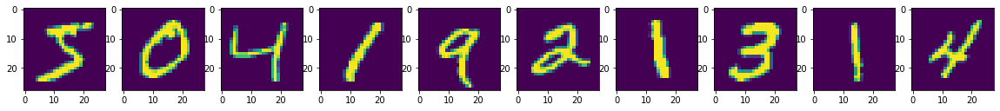

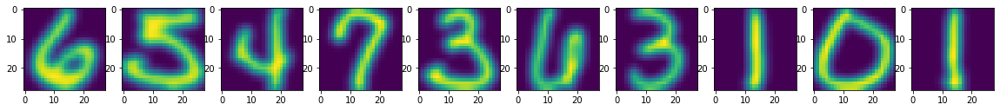

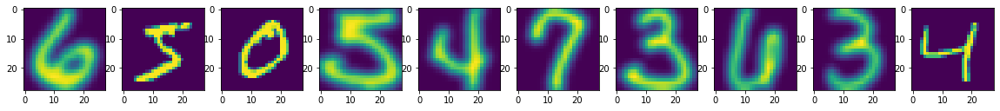

In [ ]:
import torchvision
from torchvision.datasets.utils import download_url
from torchvision import transforms
import itertools

def show_panel(arr, n=10, **kwargs):
  for i, ax in enumerate(plt.subplots(1, n, figsize=(2*n, 2))[1]):
    ax.imshow(arr[i, ..., 0], **kwargs)
  plt.show()

torchvision.datasets.mnist.MNIST.resources = [
    ("https://storage.googleapis.com/cvdf-datasets/mnist/train-images-idx3-ubyte.gz", "f68b3c2dcbeaaa9fbdd348bbdeb94873"),
    ("https://storage.googleapis.com/cvdf-datasets/mnist/train-labels-idx1-ubyte.gz", "d53e105ee54ea40749a09fcbcd1e9432"),
    ("https://storage.googleapis.com/cvdf-datasets/mnist/t10k-images-idx3-ubyte.gz", "9fb629c4189551a2d022fa330f9573f3"),
    ("https://storage.googleapis.com/cvdf-datasets/mnist/t10k-labels-idx1-ubyte.gz", "ec29112dd5afa0611ce80d1b7f02629c")
]

resize28x28 = transforms.Compose([transforms.Resize((28, 28)), transforms.ToTensor()])
usps_tv_dataset = torchvision.datasets.usps.USPS('.', download=True, transform=resize28x28)
usps_array = np.array([pair[0].numpy()[0] for pair in usps_tv_dataset])
mnist_tv_dataset = torchvision.datasets.mnist.MNIST('.', download=True, transform=resize28x28)
mnist_array = np.array([pair[0].numpy()[0] for pair in mnist_tv_dataset])
mnist_array, usps_array = mnist_array[..., None], usps_array[..., None]
# mnist_array, usps_array = [(x*2 - 1.0) for x in [mnist_array, usps_array]]
print([(x.shape, x.dtype, x.min(), x.max()) for x in [mnist_array, usps_array]])

show_panel(mnist_array)
show_panel(usps_array)

mnist_dataset = tf.data.Dataset.from_tensor_slices(mnist_array)
usps_dataset = tf.data.Dataset.from_tensor_slices(usps_array)
usps_repeat_count = int(len(mnist_array) / len(usps_array))
sample_from_datasets = [mnist_dataset, usps_dataset.repeat(usps_repeat_count)]
mixed_dataset = tf.data.experimental.sample_from_datasets(sample_from_datasets)

test_mixed_array = np.array(list(itertools.islice(mixed_dataset.as_numpy_iterator(), 10)))
show_panel(test_mixed_array)

train_dataset = mixed_dataset.skip(1024).shuffle(1024).batch(BATCH_SIZE)
test_dataset = mixed_dataset.take(1024).shuffle(1024).batch(BATCH_SIZE)

## The VAEGAN class is based heavily on [[this implementaiton]](https://colab.research.google.com/github/timsainb/tensorflow2-generative-models/blob/master/6.0-VAE-GAN-fashion-mnist.ipynb).

In [ ]:
class VAEGAN(tf.keras.Model):
    """a VAEGAN class for tensorflow
    
    Extends:
        tf.keras.Model
    """

    def __init__(self, **kwargs):
        super(VAEGAN, self).__init__()
        self.__dict__.update(kwargs)

        self.enc = tf.keras.Sequential(self.enc)
        self.dec = tf.keras.Sequential(self.dec)
        inputs, disc_l, outputs = self.vae_disc_function()
        self.disc = tf.keras.Model(inputs=[inputs], outputs=[outputs, disc_l])

        self.enc_optimizer = tf.keras.optimizers.Adam(self.lr_base_gen, beta_1=0.5)
        self.dec_optimizer = tf.keras.optimizers.Adam(self.lr_base_gen, beta_1=0.5)
        self.disc_optimizer = tf.keras.optimizers.Adam(self.get_lr_d, beta_1=0.5)

    def encode(self, x):
        mu, sigma = tf.split(self.enc(x), num_or_size_splits=2, axis=1)
        return mu, sigma

    def dist_encode(self, x):
        mu, sigma = self.encode(x)
        return ds.MultivariateNormalDiag(loc=mu, scale_diag=sigma)

    def get_lr_d(self):
        return self.lr_base_disc * self.D_prop

    def decode(self, z):
        return self.dec(z)

    def discriminate(self, x):
        return self.disc(x)

    def reconstruct(self, x):
        mean, _ = self.encode(x)
        return self.decode(mean)

    def reparameterize(self, mean, logvar):
        eps = tf.random.normal(shape=mean.shape)
        return eps * tf.exp(logvar * 0.5) + mean

    # @tf.function
    def compute_loss(self, x):
        # pass through network
        q_z = self.dist_encode(x)
        z = q_z.sample()
        p_z = ds.MultivariateNormalDiag(
            loc=[0.0] * z.shape[-1], scale_diag=[1.0] * z.shape[-1]
        )
        xg = self.decode(z)
        z_samp = tf.random.normal([x.shape[0], 1, 1, z.shape[-1]])
        xg_samp = self.decode(z_samp)
        d_xg, ld_xg = self.discriminate(xg)
        d_x, ld_x = self.discriminate(x)
        d_xg_samp, ld_xg_samp = self.discriminate(xg_samp)

        # GAN losses
        disc_real_loss = gan_loss(logits=d_x, is_real=True)
        disc_fake_loss = gan_loss(logits=d_xg_samp, is_real=False)
        gen_fake_loss = gan_loss(logits=d_xg_samp, is_real=True)

        discrim_layer_recon_loss = (
            tf.reduce_mean(tf.reduce_mean(tf.math.square(ld_x - ld_xg), axis=0))
            / self.recon_loss_div
        )

        self.D_prop = sigmoid(
            disc_fake_loss - gen_fake_loss, shift=0.0, mult=self.sig_mult
        )

        kl_div = ds.kl_divergence(q_z, p_z)
        latent_loss = tf.reduce_mean(tf.maximum(kl_div, 0)) / self.latent_loss_div

        return (
            self.D_prop,
            latent_loss,
            discrim_layer_recon_loss,
            gen_fake_loss,
            disc_fake_loss,
            disc_real_loss,
        )

    # @tf.function
    def compute_gradients(self, x):
        with tf.GradientTape() as enc_tape, tf.GradientTape() as dec_tape, tf.GradientTape() as disc_tape:
            (
                _,
                latent_loss,
                discrim_layer_recon_loss,
                gen_fake_loss,
                disc_fake_loss,
                disc_real_loss,
            ) = self.compute_loss(x)

            enc_loss = latent_loss + discrim_layer_recon_loss
            dec_loss = gen_fake_loss + discrim_layer_recon_loss
            disc_loss = disc_fake_loss + disc_real_loss

        enc_gradients = enc_tape.gradient(enc_loss, self.enc.trainable_variables)
        dec_gradients = dec_tape.gradient(dec_loss, self.dec.trainable_variables)
        disc_gradients = disc_tape.gradient(disc_loss, self.disc.trainable_variables)

        return enc_gradients, dec_gradients, disc_gradients

    @tf.function
    def apply_gradients(self, enc_gradients, dec_gradients, disc_gradients):
        self.enc_optimizer.apply_gradients(
            zip(enc_gradients, self.enc.trainable_variables)
        )
        self.dec_optimizer.apply_gradients(
            zip(dec_gradients, self.dec.trainable_variables)
        )
        self.disc_optimizer.apply_gradients(
            zip(disc_gradients, self.disc.trainable_variables)
        )

    def train(self, x):
        enc_gradients, dec_gradients, disc_gradients = self.compute_gradients(x)
        self.apply_gradients(enc_gradients, dec_gradients, disc_gradients)


def gan_loss(logits, is_real=True):
    """Computes standard gan loss between logits and labels
                
        Arguments:
            logits {[type]} -- output of discriminator
        
        Keyword Arguments:
            isreal {bool} -- whether labels should be 0 (fake) or 1 (real) (default: {True})
        """
    if is_real:
        labels = tf.ones_like(logits)
    else:
        labels = tf.zeros_like(logits)

    return tf.compat.v1.losses.sigmoid_cross_entropy(
        multi_class_labels=labels, logits=logits
    )


def sigmoid(x, shift=0.0, mult=20):
    """ squashes a value with a sigmoid
    """
    return tf.constant(1.0) / (
        tf.constant(1.0) + tf.exp(-tf.constant(1.0) * (x * mult))
    )

In [ ]:
N_Z = 32

In [ ]:
encoder = [
    tf.keras.layers.InputLayer(input_shape=DIMS),
    tf.keras.layers.Conv2D(
        filters=32, kernel_size=3, strides=(2, 2), activation="relu"
    ),
    tf.keras.layers.Conv2D(
        filters=64, kernel_size=3, strides=(2, 2), activation="relu"
    ),
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(units=N_Z*2),
]

decoder = [
    tf.keras.layers.Dense(units=7 * 7 * 64, activation="relu"),
    tf.keras.layers.Reshape(target_shape=(7, 7, 64)),
    tf.keras.layers.Conv2DTranspose(
        filters=64, kernel_size=3, strides=(2, 2), padding="SAME", activation="relu"
    ),
    tf.keras.layers.Conv2DTranspose(
        filters=32, kernel_size=3, strides=(2, 2), padding="SAME", activation="relu"
    ),
    tf.keras.layers.Conv2DTranspose(
        filters=1, kernel_size=3, strides=(1, 1), padding="SAME", activation="sigmoid"
    ),
]

def vaegan_discrim():
    inputs = tf.keras.layers.Input(shape=(28, 28, 1))
    conv1 = tf.keras.layers.Conv2D(
                filters=32, kernel_size=3, strides=(2, 2), activation="relu"
            )(inputs)
    conv2 = tf.keras.layers.Conv2D(
                filters=64, kernel_size=3, strides=(2, 2), activation="relu"
            )(conv1)
    flatten = tf.keras.layers.Flatten()(conv2)
    lastlayer = tf.keras.layers.Dense(units=512, activation="relu")(flatten)
    outputs = tf.keras.layers.Dense(units=1, activation = None)(lastlayer)
    return inputs, lastlayer, outputs

In [ ]:
gen_optimizer = tf.keras.optimizers.Adam(1e-3, beta_1=0.5)
disc_optimizer = tf.keras.optimizers.RMSprop(1e-3)

# model
model = VAEGAN(
    enc = encoder,
    dec = decoder,
    vae_disc_function = vaegan_discrim,
    lr_base_gen = 1e-3, # 
    lr_base_disc = 1e-4, # the discriminator's job is easier than the generators so make the learning rate lower
    latent_loss_div=1, # this variable will depend on your dataset - choose a number that will bring your latent loss to ~1-10
    sig_mult = 10, # how binary the discriminator's learning rate is shifted (we squash it with a sigmoid)
    recon_loss_div = .001, # this variable will depend on your dataset - choose a number that will bring your latent loss to ~1-10
)

In [ ]:
def plot_reconstruction(model, example_data, nex=14, zm=2):

    example_data_reconstructed = model.reconstruct(example_data)
    samples = model.decode(tf.random.normal(shape=(BATCH_SIZE, N_Z)))
    fig, axs = plt.subplots(ncols=nex, nrows=3, figsize=(zm * nex, zm * 3))
    for axi, (dat, lab) in enumerate(
        zip(
            [example_data, example_data_reconstructed, samples],
            ["data", "data recon", "samples"],
        )
    ):
        for ex in range(nex):
            axs[axi, ex].matshow(
                dat.numpy()[ex].squeeze(), cmap=plt.cm.Greys, vmin=0, vmax=1
            )
            axs[axi, ex].axes.get_xaxis().set_ticks([])
            axs[axi, ex].axes.get_yaxis().set_ticks([])
        axs[axi, 0].set_ylabel(lab)

    plt.show()
    
def plot_losses(losses):
    fig, axs =plt.subplots(ncols = 4, nrows = 1, figsize= (16,4))
    axs[0].plot(losses.latent_loss.values, label = 'latent_loss')
    axs[1].plot(losses.discrim_layer_recon_loss.values, label = 'discrim_layer_recon_loss')
    axs[2].plot(losses.disc_real_loss.values, label = 'disc_real_loss')
    axs[2].plot(losses.disc_fake_loss.values, label = 'disc_fake_loss')
    axs[2].plot(losses.gen_fake_loss.values, label = 'gen_fake_loss')
    axs[3].plot(losses.d_prop.values, label = 'd_prop')

    for ax in axs.flatten():
        ax.legend()
    plt.show()

In [ ]:
def batch(arr, batch_size):
  n_splits = max(len(arr)//batch_size, 1)
  return np.array_split(arr, n_splits, axis=0)

def batch_apply(fn, data, batch_size):
  return tf.concat([fn(x) for x in batch(data, batch_size)], axis=0)

In [ ]:
import os
save_path = '/scratch2/run/lrmf/vaegan/vaegan'

def save_model_and_outputs(model, name):
  mnist_codes = batch_apply(lambda x: model.encode(x)[0], mnist_array, 256)
  usps_codes = batch_apply(lambda x: model.encode(x)[0], usps_array, 256)

  print([x.shape for x in [mnist_codes, usps_codes]])

  tf.io.write_file(os.path.join(save_path, f'mnist_{name}.proto'), 
                  tf.io.serialize_tensor(mnist_codes))

  tf.io.write_file(os.path.join(save_path, f'usps_{name}.proto'), 
                  tf.io.serialize_tensor(usps_codes))

  model.save_weights(os.path.join(save_path, f'model_{name}/model.proto'))

def load_model_and_outputs(model, name):
  mnist_codes = tf.io.parse_tensor(
    tf.io.read_file(os.path.join(save_path, f'mnist_{name}.proto')), 
    tf.float32)
  
  usps_codes = tf.io.parse_tensor(
    tf.io.read_file(os.path.join(save_path, f'usps_{name}.proto')), 
    tf.float32)

  model.load_weights(os.path.join(save_path, f'model_{name}/model.proto'))
  return mnist_codes, usps_codes, model

mnist_codes, usps_codes, model = load_model_and_outputs(model, '16_ldiv4')

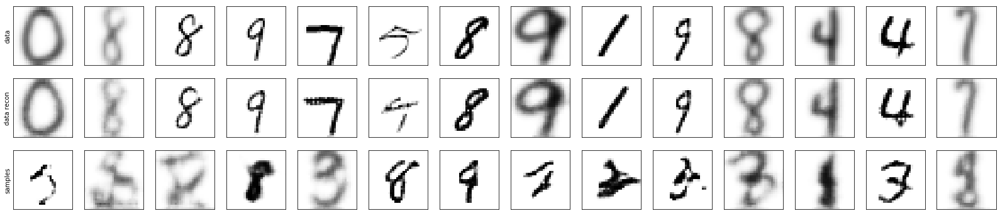

In [ ]:
plot_reconstruction(model, next(iter(train_dataset)))

## LRMF

In [ ]:
import time

tfd = tfp.distributions
tfb = tfp.bijectors

def fit_loss_iter(loss_fn, optimizer, batched_dataset, epochs=1000, update_tqdm_every=1.0, compile=True):
  def train_step(target_sample):
    with tf.GradientTape() as tape:
      loss = loss_fn(target_sample)
    variables = tape.watched_variables()
    grads = tape.gradient(loss, variables)
    optimizer.apply_gradients(zip(grads, variables))
    return loss

  train_step = tf.function(train_step) if compile else train_step

  yield None

  last_update_time = time.time()
  with tqdm(range(epochs)) as tqit:
    for epoch in tqit:
      for batch in batched_dataset:
        loss = train_step(batch)
        
        if time.time() - last_update_time > update_tqdm_every:
          tqit.set_postfix(loss=float(loss))
          last_update_time = time.time()
        
        yield loss

def fit_loss(loss_fn, optimizer, batched_dataset, epochs=1000):
  return list(fit_loss_iter(loss_fn, optimizer, batched_dataset, epochs))

def batch(arr, batch_size):
  n_splits = max(len(arr)//batch_size, 1)
  return np.array_split(arr, n_splits, axis=0)
  
def estimate_entropy(build_model, data, batch_size=100, epochs=50, lr=1e-4):
  model = build_model()
  optimizer = tf.keras.optimizers.Adam(learning_rate=lr)
  nll_loss = lambda x: -1 * tf.reduce_mean(model.log_prob(x))
  batched_data = batch(data, batch_size)
  fit_loss(nll_loss, optimizer, batched_data, epochs=epochs)
  ent = nll_loss(data)
  return model, ent

def batch_loss(model_ab, model_t, batch_a, batch_b):
  gen_t = model_t.bijector.forward(batch_b)
  logp_ab_a = tf.reduce_mean(model_ab.log_prob(batch_a))
  logp_ab_t = tf.reduce_mean(model_ab.log_prob(gen_t))
  ent_t = tf.reduce_mean(model_t.log_prob(gen_t))
  return ent_t - logp_ab_a - logp_ab_t

def estimate_loss_constant(build_model, data_a, data_b, batch_size=100, epochs=50, lr=1e-4):
  epochs_ab = (epochs, epochs) if isinstance(epochs, int) else epochs
  model_a, ent_a = estimate_entropy(build_model, data_a, batch_size, epochs_ab[0], lr)
  model_b, ent_b = estimate_entropy(build_model, data_b, batch_size, epochs_ab[1], lr)
  prior_b = np.mean(model_a.distribution.log_prob(data_b))
  const = prior_b + ent_b + ent_a
  print(prior_b, ent_b, ent_a)
  return model_a, model_b, const

def build_nvp(dim=2, levels=4, hidden=(512, 512), activation=tf.nn.relu):
  chain_bijectors = []
  for _ in range(levels):
    chain_bijectors.append(
      tfb.RealNVP(
            num_masked=dim//2,
            shift_and_log_scale_fn=tfb.real_nvp_default_template(
                hidden_layers=hidden, activation=activation))
    )
    # swap dimentions after every nvp transform
    chain_bijectors.append(tfb.Permute(list(reversed(range(dim)))))

  model = tfd.TransformedDistribution(
      distribution=tfd.MultivariateNormalDiag(loc=np.zeros(dim)),
      bijector=tfb.Chain(chain_bijectors))

  model.log_prob(model.sample())  # for some reason required for initialization
  return model

nvp = build_nvp()

Instructions for updating:
Use keras.layers.Dense instead.
Instructions for updating:
Please use `layer.__call__` method instead.
Instructions for updating:
`AffineScalar` bijector is deprecated; please use `tfb.Shift(loc)(tfb.Scale(...))` instead.


In [ ]:
data_a = tf.cast(mnist_codes, tf.float64)
data_b = tf.cast(usps_codes, tf.float64)

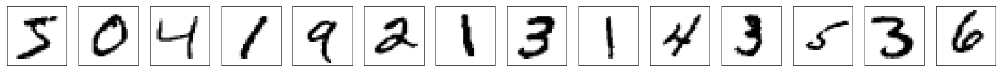


If you intended to run this layer in float32, you can safely ignore this warning. If in doubt, this warning is likely only an issue if you are porting a TensorFlow 1.X model to TensorFlow 2.

To change all layers to have dtype float64 by default, call `tf.keras.backend.set_floatx('float64')`. To change just this layer, pass dtype='float64' to the layer constructor. If you are the author of this layer, you can disable autocasting by passing autocast=False to the base Layer constructor.



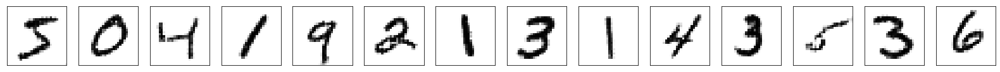

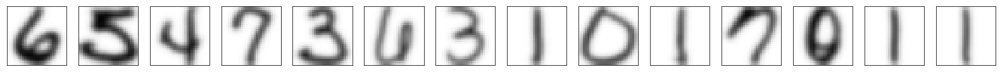

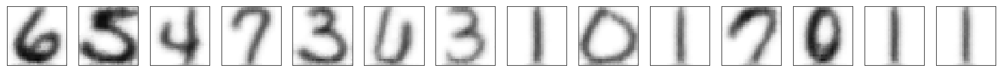

In [ ]:
def show_panel(samples, cmap='Greys', n=14, zm=2):
  fig, axes = plt.subplots(ncols=n, nrows=1, figsize=(zm * n, zm))
  for ax, x in zip(axes, samples):
    ax.matshow(x[..., 0], cmap=plt.cm.Greys, vmin=0, vmax=1)
    ax.axes.get_xaxis().set_ticks([])
    ax.axes.get_yaxis().set_ticks([])
  plt.show()

show_panel(mnist_array[:20])
show_panel(model.decode(data_a[:20]))
show_panel(usps_array[:20])
show_panel(model.decode(data_b[:20]))

In [ ]:
from functools import partial

build_nvp_dim = partial(build_nvp, dim=32, levels=4, hidden=(512, 512))

In [ ]:
# model_a, model_b, const = estimate_loss_constant(
#     build_nvp_dim, data_a, data_b, batch_size=256, epochs=100, lr=1e-4)
# const = tf.Variable(const)
# ckpt_a_b = tf.train.Checkpoint(m_a=model_a, m_b=model_b, const=const)
# ckpt_a_b_mng = tf.train.CheckpointManager(
#     ckpt_a_b, '/content/drive/My Drive/vaegan/flow_a_b_16', 1)
# ckpt_a_b_mng.save()

In [ ]:
def restore_flow_ab(build_model, path):
  model_a, model_b, const = build_model(), build_model(), tf.Variable(tf.convert_to_tensor(0.0, tf.float64))
  ckpt_a_b = tf.train.Checkpoint(m_a=model_a, m_b=model_b, const=const)
  ckpt_a_b_mng = tf.train.CheckpointManager(
      ckpt_a_b, path, 1)
  ckpt_a_b.restore(ckpt_a_b_mng.latest_checkpoint)
  return model_a, model_b, const

model_a, model_b, const = restore_flow_ab(
    build_nvp_dim, '/scratch2/run/lrmf/vaegan/vaegan/flow_a_b_16')

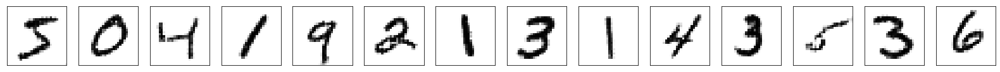

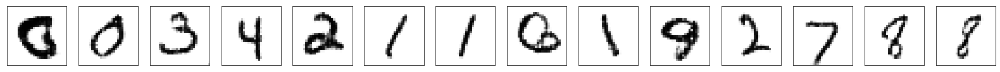

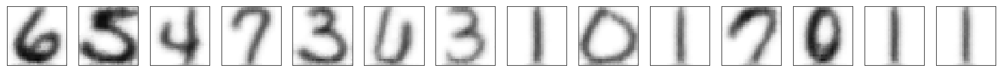

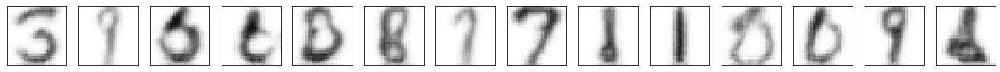

<tf.Variable 'Variable:0' shape=() dtype=float64, numpy=-20.68633121913629>


In [ ]:
gen_a = model_a.sample(20).numpy()
show_panel(model.decode(data_a[:20]))
show_panel(model.decode(gen_a))

gen_b = model_b.sample(20).numpy()
show_panel(model.decode(data_b[:20]))
show_panel(model.decode(gen_b))

print(const)

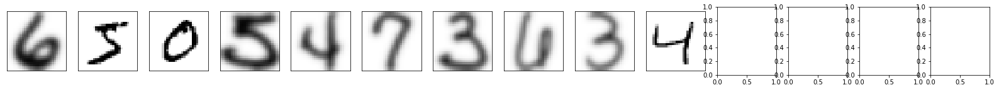

[1, 0, 0, 1, 1, 1, 1, 1, 1, 0]
1841/1841 [==============================] - 14s 8ms/step - loss: 0.0677 - accuracy: 0.9747


In [ ]:
tfpl = tfp.layers
tfk = tf.keras
tfkl = tf.keras.layers

gen_n = 1024

domain_dataset = tf.data.experimental.sample_from_datasets([
  tf.data.Dataset.zip((mnist_dataset, tf.data.Dataset.from_tensor_slices([0.0]).repeat())),
  tf.data.Dataset.zip((usps_dataset.repeat(8), tf.data.Dataset.from_tensor_slices([1.0]).repeat()))
])
imgs, clss = zip(*itertools.islice(domain_dataset, 10))
show_panel(np.array(imgs))
print(list(map(int, clss)))

rec_mnist_array = batch_apply(model.decode, mnist_codes, 256)
rec_usps_array = batch_apply(model.decode, usps_codes, 256)
rec_domain_dataset = tf.data.experimental.sample_from_datasets([
  tf.data.Dataset.zip((tf.data.Dataset.from_tensor_slices(rec_mnist_array), 
                       tf.data.Dataset.from_tensor_slices([0.0]).repeat())),
  tf.data.Dataset.zip((tf.data.Dataset.from_tensor_slices(rec_usps_array).repeat(8), 
                       tf.data.Dataset.from_tensor_slices([1.0]).repeat()))
])

gen_mnist_array = batch_apply(model.decode, model_a.sample(gen_n), 256)
gen_usps_array = batch_apply(model.decode, model_b.sample(gen_n), 256)
gen_domain_dataset = tf.data.experimental.sample_from_datasets([
  tf.data.Dataset.zip((tf.data.Dataset.from_tensor_slices(gen_mnist_array), 
                       tf.data.Dataset.from_tensor_slices([0.0]).repeat())),
  tf.data.Dataset.zip((tf.data.Dataset.from_tensor_slices(gen_usps_array), 
                       tf.data.Dataset.from_tensor_slices([1.0]).repeat()))
])

domain_clf = tfk.Sequential([
  tfkl.Conv2D(32, (3, 3), activation='relu', input_shape=(28, 28, 1)),
  tfkl.Conv2D(32, (3, 3), activation='relu'),
  tfkl.MaxPooling2D(pool_size=(2, 2)),
  tfkl.Dropout(0.25),
  tfkl.Flatten(),
  tfkl.Dense(10, activation='relu'),
  tfkl.Dropout(0.5),
  tfkl.Dense(1, activation='sigmoid')
])

opt = tfk.optimizers.Adam(learning_rate=1e-4)
domain_clf.compile(loss='binary_crossentropy', optimizer=opt, metrics=['accuracy'])
domain_clf.fit(domain_dataset.skip(512).batch(64), epochs=1)

In [ ]:
print(domain_clf.evaluate(domain_dataset.take(512).batch(64)))
print(domain_clf.evaluate(rec_domain_dataset.take(512).batch(64)))
print(domain_clf.evaluate(gen_domain_dataset.batch(64)))

      8/Unknown - 0s 16ms/step - loss: 6.3503e-04 - accuracy: 1.0000[0.0006350266027084217, 1.0]
      8/Unknown - 0s 6ms/step - loss: 3.3081e-04 - accuracy: 1.0000[0.00033081308788496244, 1.0]
     32/Unknown - 0s 5ms/step - loss: 1.1882e-04 - accuracy: 1.0000[0.00011882081793146426, 1.0]


In [ ]:
# gen_a_scores = domain_clf(gen_mnist_array).numpy()
# gen_b_scores = domain_clf(gen_usps_array).numpy()
# print(gen_a_scores.mean(), gen_a_scores.std())
# print(gen_b_scores.mean(), gen_b_scores.std())
# log_bins = np.logspace(np.log10(1e-8),np.log10(1), 50)
# plt.hist(gen_a_scores, density=False, label='MNIST', bins=log_bins)
# plt.hist(gen_b_scores, density=False, label='USPS', bins=log_bins)
# plt.gca().set_xscale("log")
# plt.legend()
# plt.show()

In [ ]:
def log_odds(model, data, eps=1e-30):
  p = model(data).numpy()
  return np.log(np.maximum(p, eps)) - np.log(np.maximum(1-p, eps))

def filter_finite(x):
  x = x[np.isfinite(x)]
  return x

(1024,) (1024,)
-16.952255 2.8882866
29.898092 27.123404
-24.059557 69.07755
-21.133327102661134 69.07755279541016
[-30.0, 70.0]


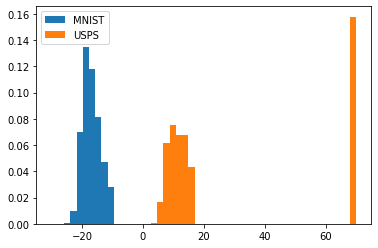

In [ ]:
gen_a_odds = filter_finite(log_odds(domain_clf, gen_mnist_array))
gen_b_odds = filter_finite(log_odds(domain_clf, gen_usps_array))
print(gen_a_odds.shape, gen_b_odds.shape)
print(gen_a_odds.mean(), gen_a_odds.std())
print(gen_b_odds.mean(), gen_b_odds.std())
limits = [np.floor(np.percentile(gen_a_odds, 5)/10)*10, 
          np.ceil(np.percentile(gen_b_odds, 95)/10)*10]
print(np.min(gen_a_odds), np.max(gen_b_odds))
print(np.percentile(gen_a_odds, 5), np.percentile(gen_b_odds, 95))
print(limits)
bins = np.linspace(*limits)
plt.hist(gen_a_odds, density=True, label='MNIST', bins=bins)
plt.hist(gen_b_odds, density=True, label='USPS', bins=bins)
# plt.gca().set_xscale("log")
plt.legend()
plt.show()

In [ ]:
def train_domain_clf_and_eval_odds(domain_a, domain_b, eval_arrays, epochs=10):
  fast_domain_dataset = tf.data.experimental.sample_from_datasets([
    tf.data.Dataset.zip((tf.data.Dataset.from_tensor_slices(domain_a), 
                        tf.data.Dataset.from_tensor_slices([0.0]).repeat())),
    tf.data.Dataset.zip((tf.data.Dataset.from_tensor_slices(domain_b), 
                        tf.data.Dataset.from_tensor_slices([1.0]).repeat()))
  ])

  fast_domain_clf = tfk.Sequential([
    tfkl.Conv2D(32, (3, 3), activation='relu', input_shape=(28, 28, 1)),
    tfkl.Conv2D(32, (3, 3), activation='relu'),
    tfkl.MaxPooling2D(pool_size=(2, 2)),
    tfkl.Dropout(0.25),
    tfkl.Flatten(),
    tfkl.Dense(10, activation='relu'),
    tfkl.Dropout(0.5),
    tfkl.Dense(1, activation='sigmoid')
  ])

  opt = tfk.optimizers.Adam(learning_rate=1e-4)
  fast_domain_clf.compile(loss='binary_crossentropy', optimizer=opt, metrics=['accuracy'])
  fast_domain_clf.fit(fast_domain_dataset.batch(64), epochs=epochs, verbose=0)

  odds = []
  for eval_arr in eval_arrays:
    odds.append(filter_finite(log_odds(fast_domain_clf, eval_arr)))

  return odds


def draw_odds(odds, labels, bins=None, bins_round=1):
  if bins is None:
    min_perc = np.min([np.percentile(odd_arr, 5) for odd_arr in odds])
    max_perc = np.max([np.percentile(odd_arr, 95) for odd_arr in odds])
    limits = [np.floor(min_perc/bins_round)*bins_round, 
              np.ceil(max_perc/bins_round)*bins_round]
    bins = np.linspace(*limits)
  
  for arr, label in zip(odds, labels):
    plt.hist(arr, density=True, label=label, bins=bins, alpha=0.7)
  plt.legend()
  plt.show()
  
  return bins

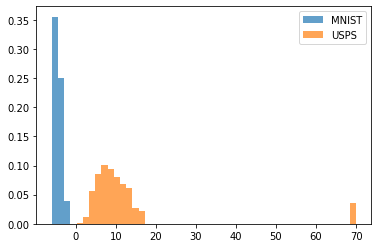

array([-6.        , -4.44897959, -2.89795918, -1.34693878,  0.20408163,
        1.75510204,  3.30612245,  4.85714286,  6.40816327,  7.95918367,
        9.51020408, 11.06122449, 12.6122449 , 14.16326531, 15.71428571,
       17.26530612, 18.81632653, 20.36734694, 21.91836735, 23.46938776,
       25.02040816, 26.57142857, 28.12244898, 29.67346939, 31.2244898 ,
       32.7755102 , 34.32653061, 35.87755102, 37.42857143, 38.97959184,
       40.53061224, 42.08163265, 43.63265306, 45.18367347, 46.73469388,
       48.28571429, 49.83673469, 51.3877551 , 52.93877551, 54.48979592,
       56.04081633, 57.59183673, 59.14285714, 60.69387755, 62.24489796,
       63.79591837, 65.34693878, 66.89795918, 68.44897959, 70.        ])

In [ ]:
odds = train_domain_clf_and_eval_odds(gen_mnist_array, gen_usps_array, [gen_mnist_array, gen_usps_array])
draw_odds(odds, ['MNIST', 'USPS', 'T(USPS)'], bins=None)

In [ ]:
def fit_model_to_prior(model, batch_size, n_samples, lr=1e-3):
  optimizer = tf.keras.optimizers.Adam(learning_rate=lr)
  nll_loss = lambda x: -1 * tf.reduce_mean(model.log_prob(x))
  n_repeats = n_samples // batch_size
  prior_data = [model.distribution.sample(batch_size) for _ in range(n_repeats)]
  train_it = fit_loss_iter(nll_loss, optimizer, prior_data, epochs=1)
  for loss_value in train_it:
    print(loss_value)

  print('-- finished pre-training model_t --')


In [ ]:
def fit_lrmf(build_model, data_a, data_b, const=None, 
                         epochs=1000, show_every=10, labels=None, names=None, 
                         batch_size=256, save_path=None, restore_on_start=True, 
                         keep_max=1, save_every=1000):
  
  model_ab = build_model()
  model_t = build_model()
  fit_model_to_prior(model_t, 256, 2560)

  optimizer = tf.keras.optimizers.Adam(learning_rate=1e-5)

  ckpt = None
  ckpt_mng = None
  if save_path is not None:
    const = const or tf.Variable(0.0, tf.float32)
    ckpt = tf.train.Checkpoint(m_ab=model_ab, m_t=model_t, opt=optimizer, 
                               const=const)
    ckpt_mng = tf.train.CheckpointManager(ckpt, save_path, keep_max)
    if restore_on_start:
      ckpt.restore(ckpt_mng.latest_checkpoint)

  losses = []
  accs = []
  labels = names or [None]*3
  print('using c(A, B) ', const)
  trans_loss_fn = lambda x: (batch_loss(model_ab, model_t, x[0], x[1]) - const)
  batched_data = list(zip(batch(data_a, batch_size), batch(data_b, batch_size)))
  train_iter = fit_loss_iter(trans_loss_fn, optimizer, batched_data, epochs=epochs, compile=True)
  re_bins = None

  for iter_i, loss in enumerate(train_iter):
    if iter_i % show_every != 0:
      continue
    
    print(iter_i, loss)

    if loss is not None:
      losses.append(loss)
      print(loss)

    gen_t = model_t.bijector.forward(data_b[:len(gen_a_scores)]).numpy()
    gen_t_imgs = model.decode(gen_t)
    show_panel(model.decode(data_b), cmap='Greys')
    show_panel(gen_t_imgs, cmap='Greys')

    gen_t_odds = filter_finite(log_odds(domain_clf, gen_t_imgs))
    draw_odds([gen_a_odds, gen_b_odds, gen_t_odds], labels, bins)

    retrain_eval_arrs = [gen_mnist_array, gen_usps_array, gen_t_imgs]
    re_odds = train_domain_clf_and_eval_odds(gen_mnist_array, gen_t_imgs, retrain_eval_arrs)
    re_bins = draw_odds(re_odds, ['MNIST', 'USPS', 'T(USPS)'], bins=re_bins)

    plt.plot(losses)
    plt.show()

    if loss is not None and tf.math.is_nan(loss):
      print('nan loss!')
      break

    if iter_i > 0 and iter_i % 1000 == 0 and ckpt_mng is not None:
      print('saving weights')
      ckpt_mng.save()

  return model_ab, model_t

None


tf.Tensor(49.04273673651409, shape=(), dtype=float64)
tf.Tensor(47.523091731705506, shape=(), dtype=float64)
tf.Tensor(48.51752062132045, shape=(), dtype=float64)
tf.Tensor(47.53674133982961, shape=(), dtype=float64)
tf.Tensor(47.07932021753203, shape=(), dtype=float64)
tf.Tensor(46.8047088986638, shape=(), dtype=float64)
tf.Tensor(46.43635913166583, shape=(), dtype=float64)
tf.Tensor(46.1560813224675, shape=(), dtype=float64)
tf.Tensor(46.42899531610947, shape=(), dtype=float64)
tf.Tensor(46.81657306548078, shape=(), dtype=float64)
-- finished pre-training model_t --
using c(A, B)  <tf.Variable 'Variable:0' shape=() dtype=float64, numpy=-20.417098053788617>
0 None


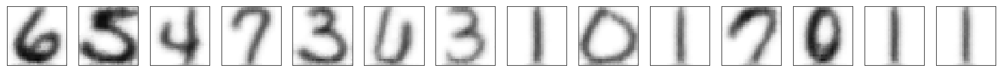

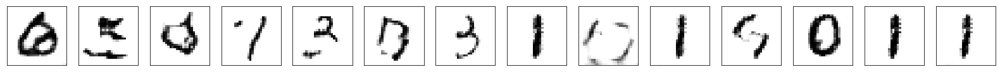

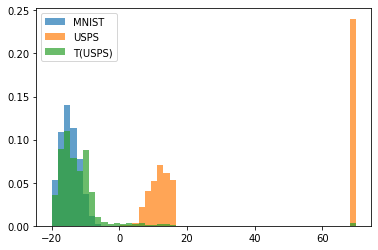

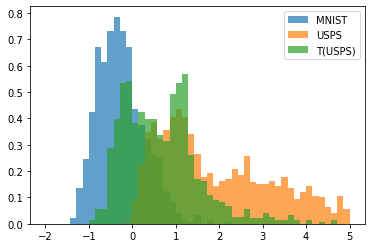

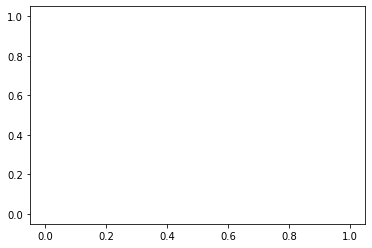

100 tf.Tensor(45.689155308875286, shape=(), dtype=float64)
tf.Tensor(45.689155308875286, shape=(), dtype=float64)


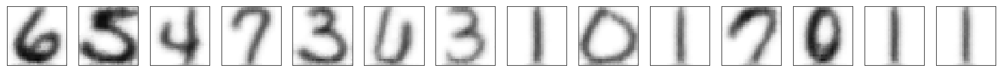

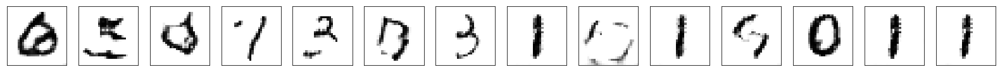

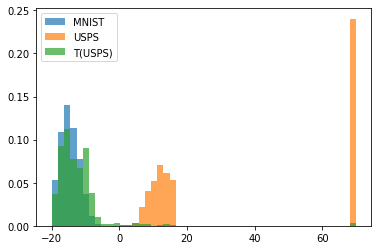

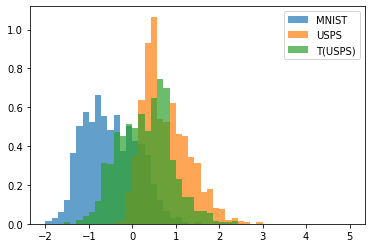

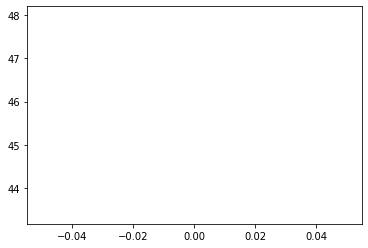

200 tf.Tensor(43.705147036630756, shape=(), dtype=float64)
tf.Tensor(43.705147036630756, shape=(), dtype=float64)


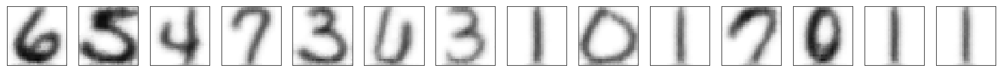

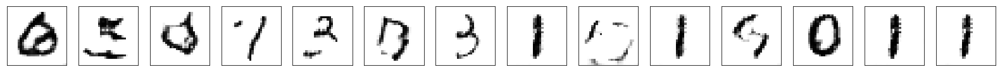

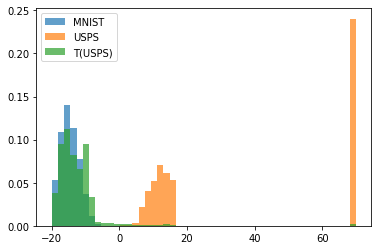

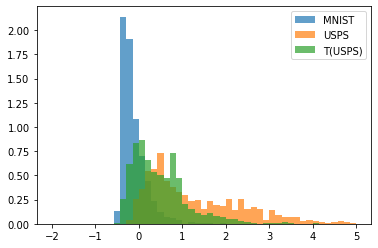

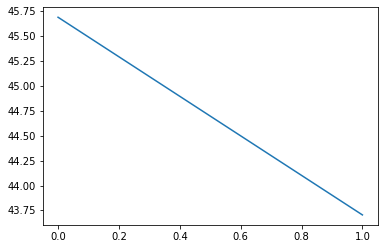

300 tf.Tensor(41.75967208031575, shape=(), dtype=float64)
tf.Tensor(41.75967208031575, shape=(), dtype=float64)


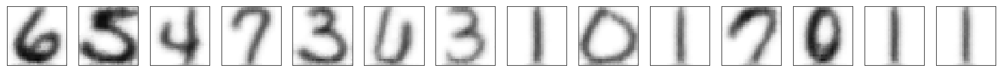

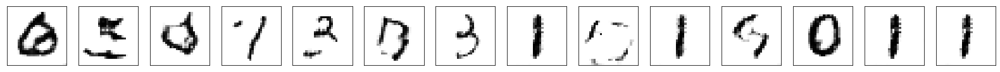

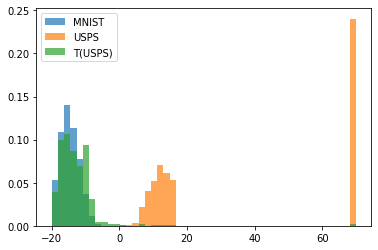

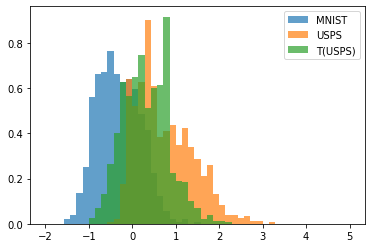

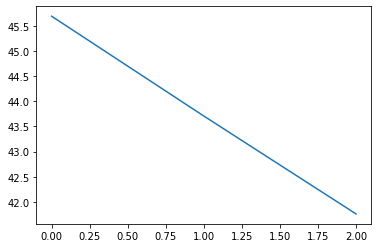

400 tf.Tensor(33.325732513534916, shape=(), dtype=float64)
tf.Tensor(33.325732513534916, shape=(), dtype=float64)


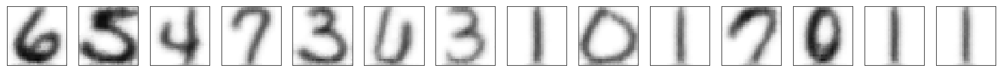

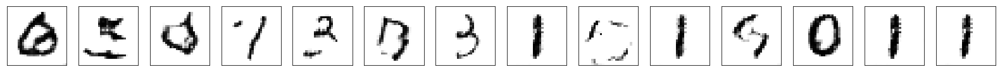

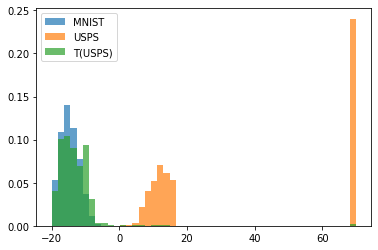

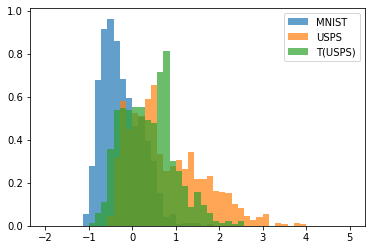

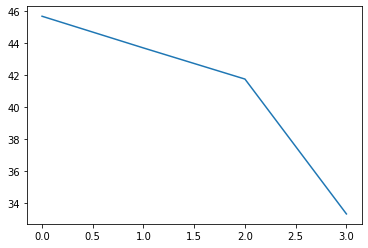

500 tf.Tensor(43.43058211526738, shape=(), dtype=float64)
tf.Tensor(43.43058211526738, shape=(), dtype=float64)


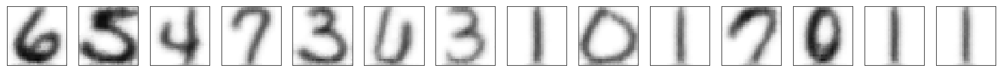

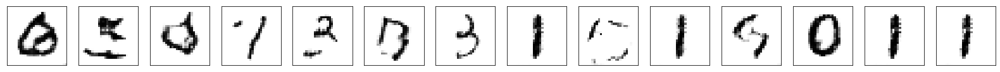

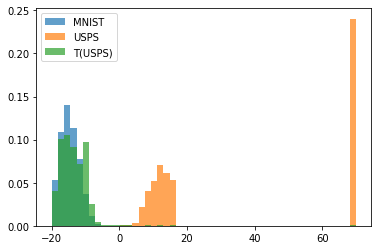

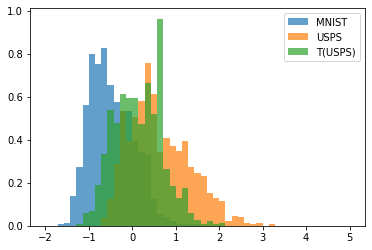

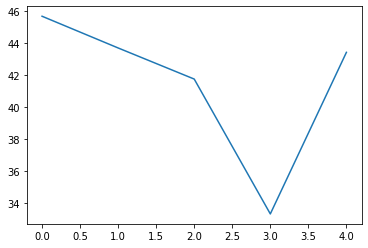

600 tf.Tensor(41.449554392878674, shape=(), dtype=float64)
tf.Tensor(41.449554392878674, shape=(), dtype=float64)


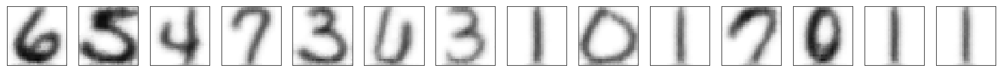

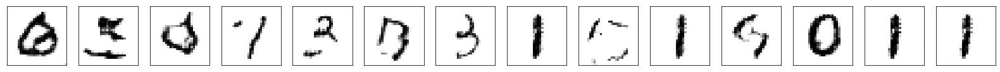

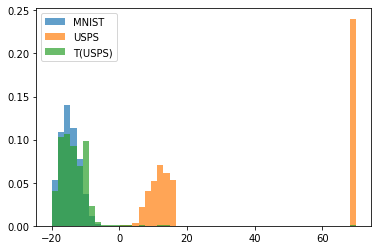

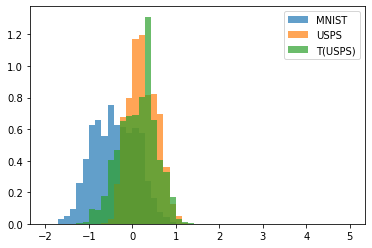

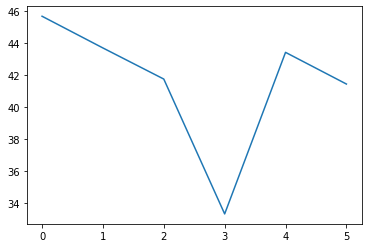

700 tf.Tensor(36.108912339973344, shape=(), dtype=float64)
tf.Tensor(36.108912339973344, shape=(), dtype=float64)


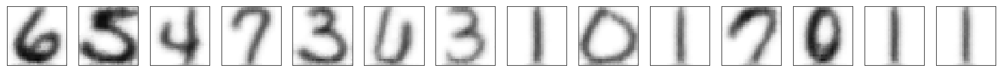

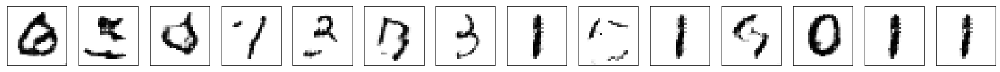

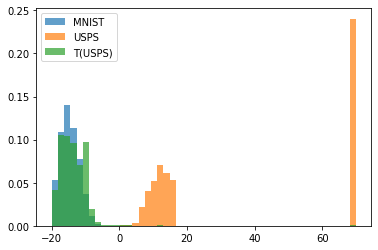

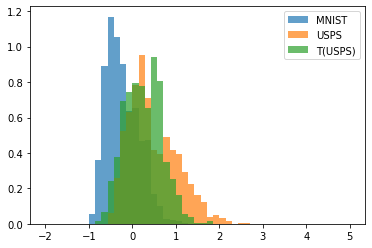

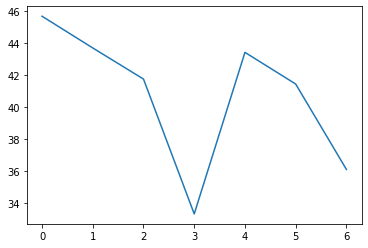

800 tf.Tensor(40.77980976656512, shape=(), dtype=float64)
tf.Tensor(40.77980976656512, shape=(), dtype=float64)


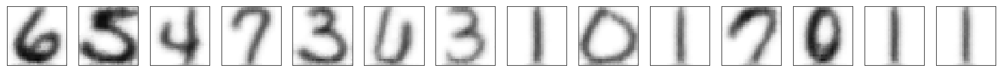

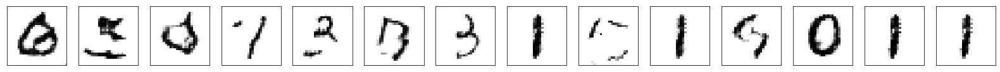

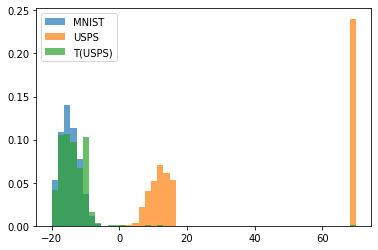

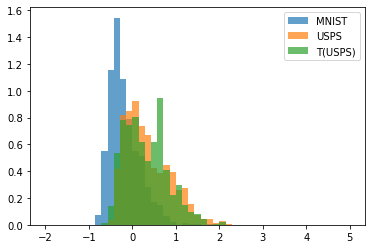

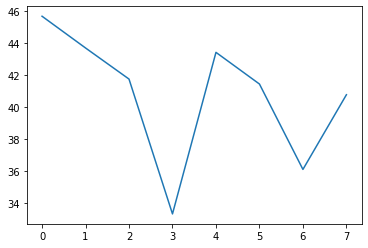

900 tf.Tensor(39.29296221210443, shape=(), dtype=float64)
tf.Tensor(39.29296221210443, shape=(), dtype=float64)


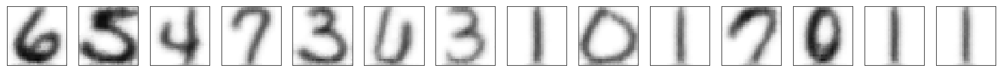

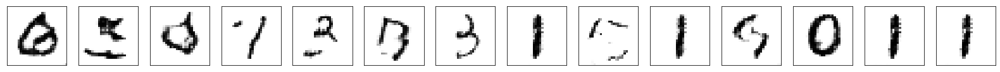

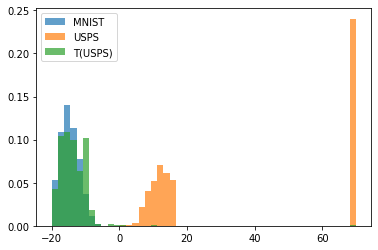

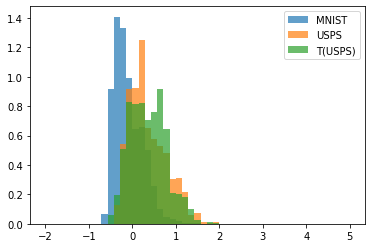

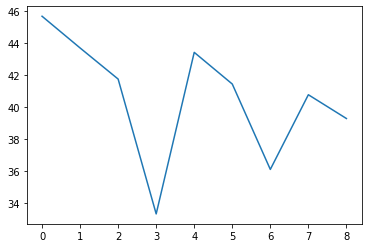

1000 tf.Tensor(37.20126512911429, shape=(), dtype=float64)
tf.Tensor(37.20126512911429, shape=(), dtype=float64)


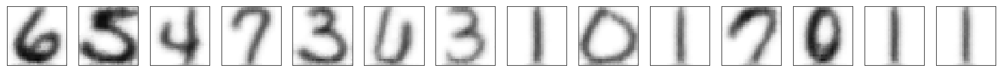

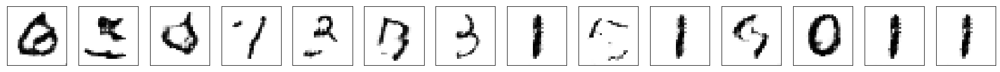

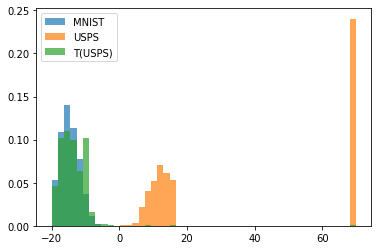

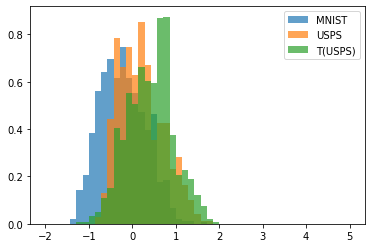

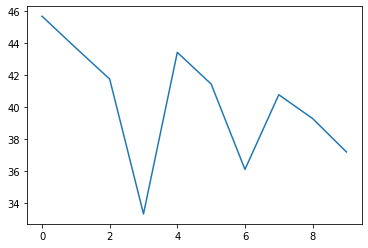

saving weights
1100 tf.Tensor(27.789914433239826, shape=(), dtype=float64)
tf.Tensor(27.789914433239826, shape=(), dtype=float64)


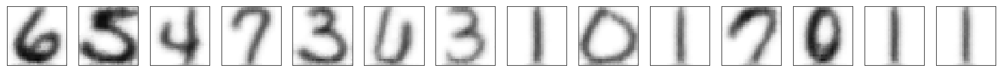

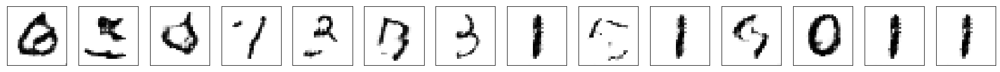

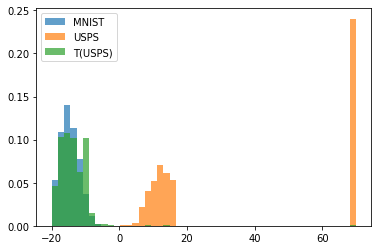

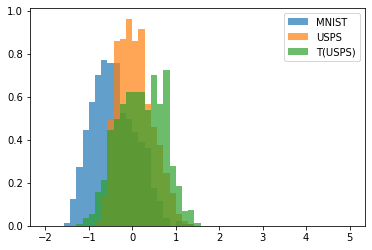

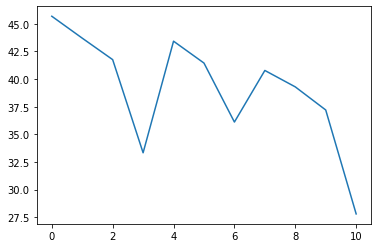

1200 tf.Tensor(39.12137677400757, shape=(), dtype=float64)
tf.Tensor(39.12137677400757, shape=(), dtype=float64)


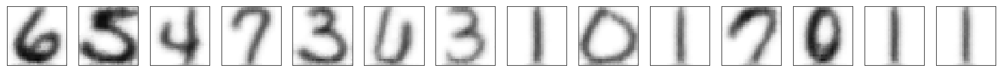

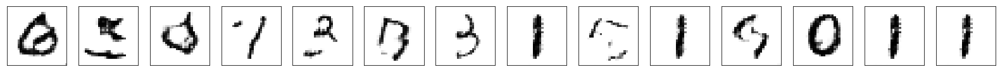

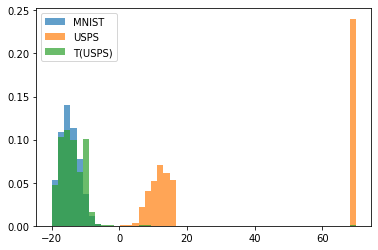

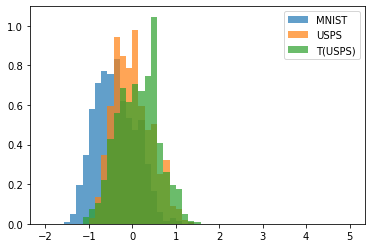

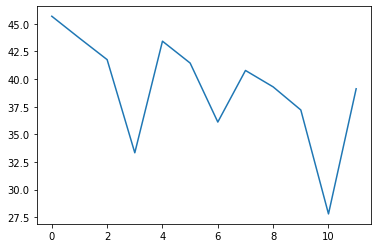

1300 tf.Tensor(37.60218764667984, shape=(), dtype=float64)
tf.Tensor(37.60218764667984, shape=(), dtype=float64)


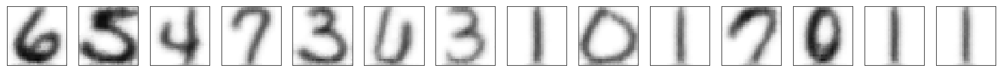

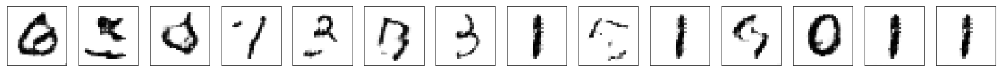

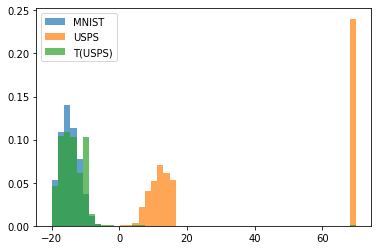

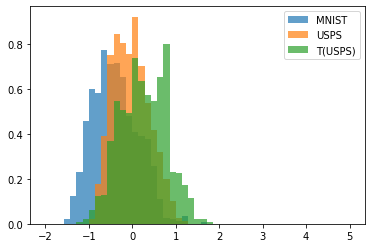

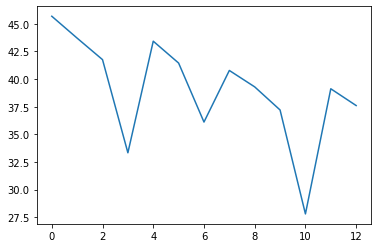

1400 tf.Tensor(32.35081638152866, shape=(), dtype=float64)
tf.Tensor(32.35081638152866, shape=(), dtype=float64)


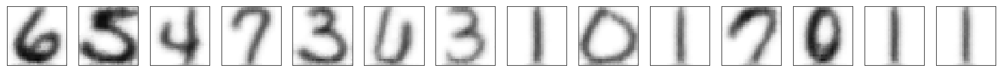

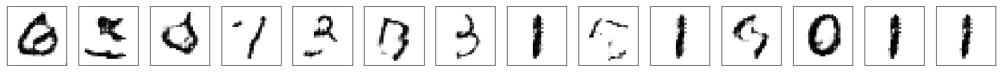

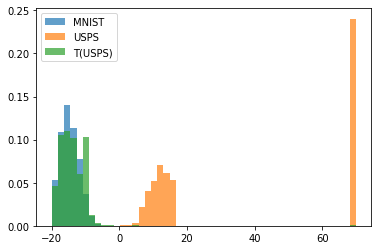

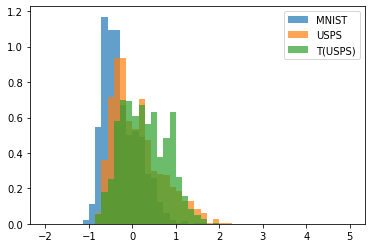

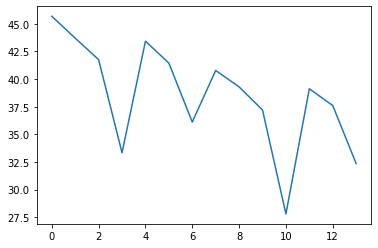

1500 tf.Tensor(37.06819956548276, shape=(), dtype=float64)
tf.Tensor(37.06819956548276, shape=(), dtype=float64)


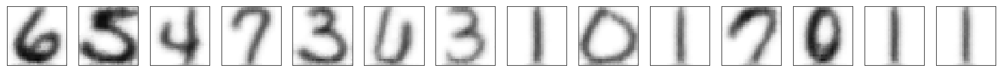

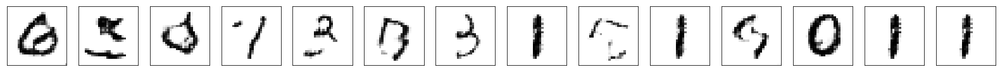

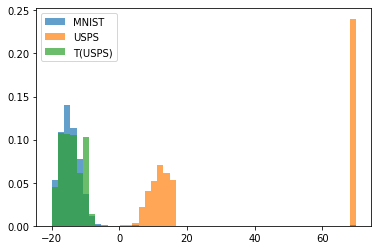

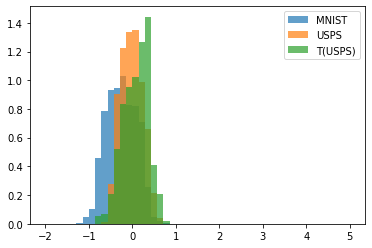

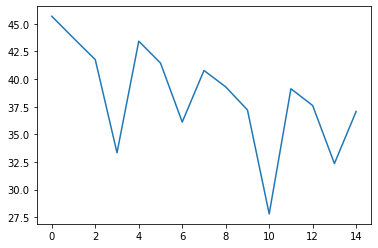

1600 tf.Tensor(35.80950969320432, shape=(), dtype=float64)
tf.Tensor(35.80950969320432, shape=(), dtype=float64)


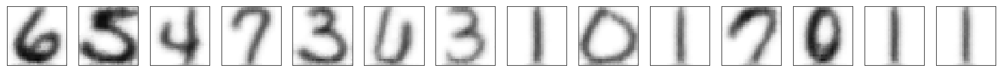

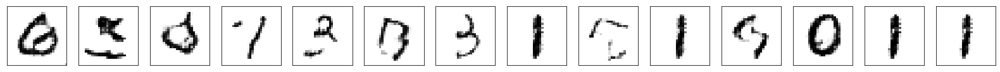

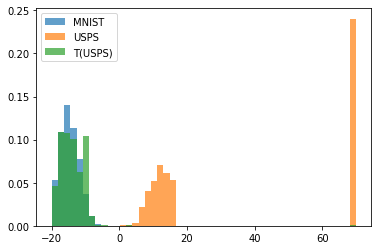

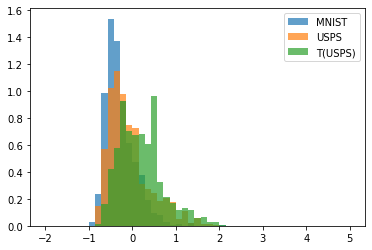

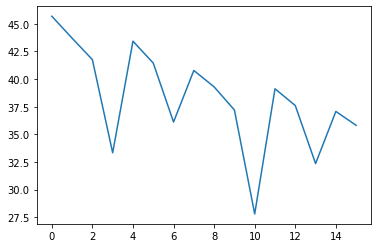

1700 tf.Tensor(33.806125030945296, shape=(), dtype=float64)
tf.Tensor(33.806125030945296, shape=(), dtype=float64)


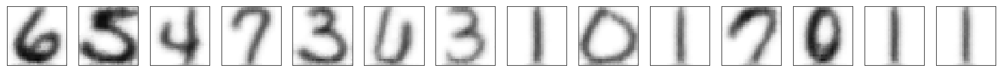

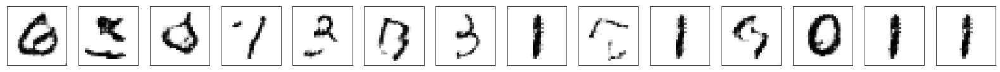

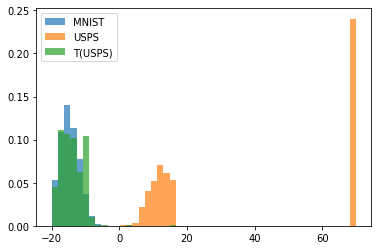

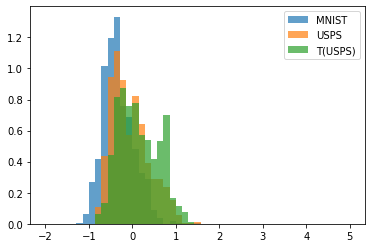

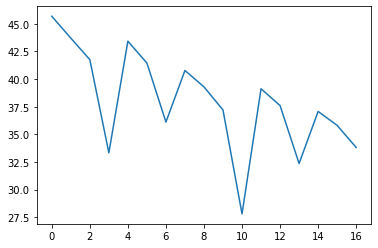

1800 tf.Tensor(23.76928591743924, shape=(), dtype=float64)
tf.Tensor(23.76928591743924, shape=(), dtype=float64)


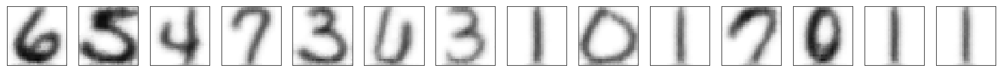

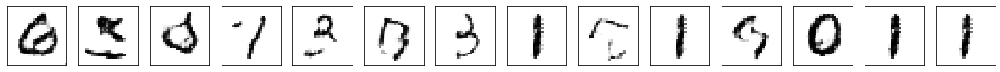

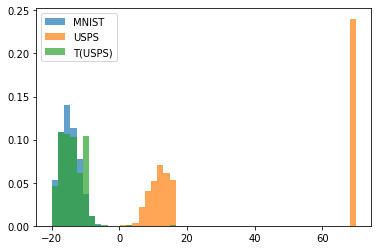

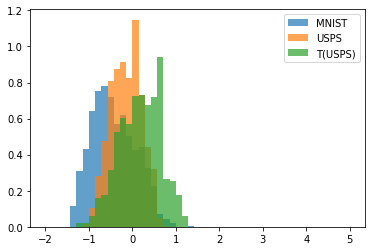

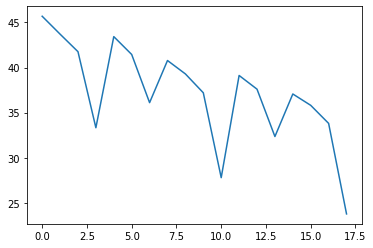

1900 tf.Tensor(35.846909903991495, shape=(), dtype=float64)
tf.Tensor(35.846909903991495, shape=(), dtype=float64)


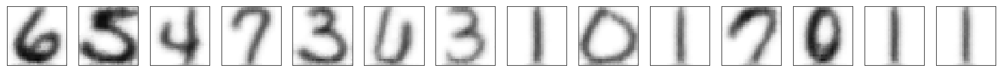

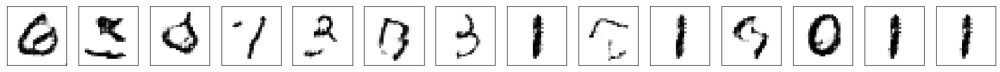

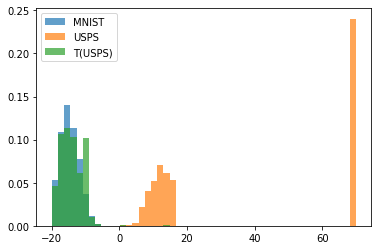

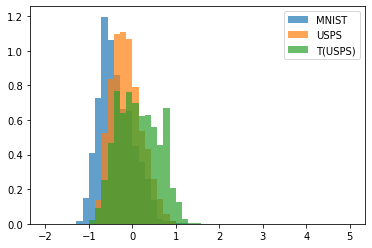

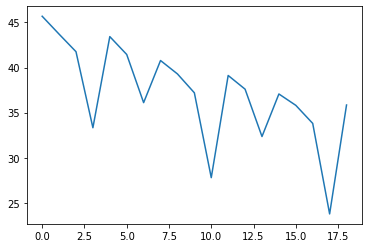

2000 tf.Tensor(34.59925111982579, shape=(), dtype=float64)
tf.Tensor(34.59925111982579, shape=(), dtype=float64)


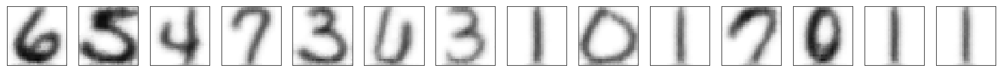

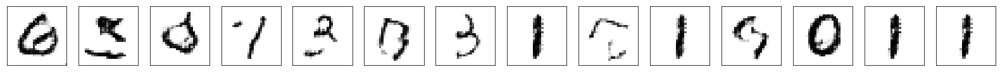

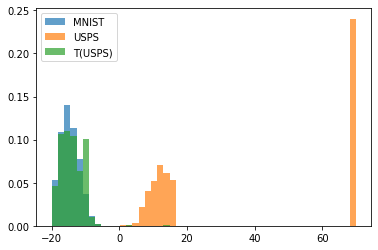

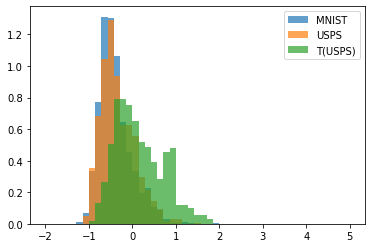

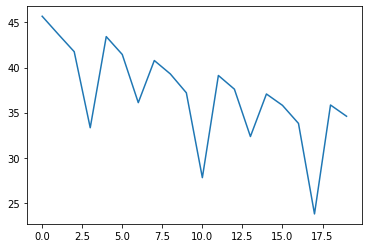

saving weights
2100 tf.Tensor(29.294759307538776, shape=(), dtype=float64)
tf.Tensor(29.294759307538776, shape=(), dtype=float64)


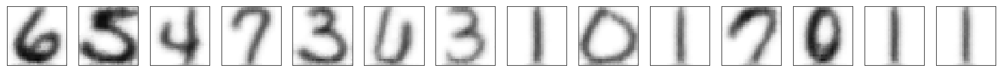

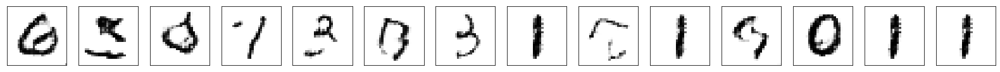

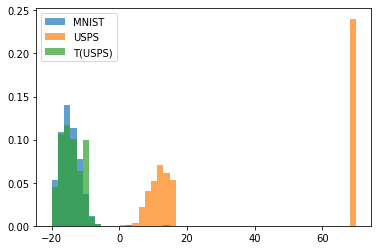

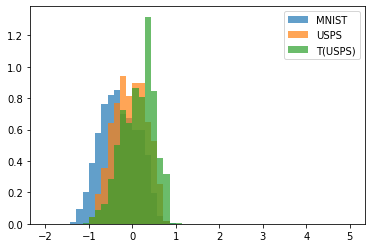

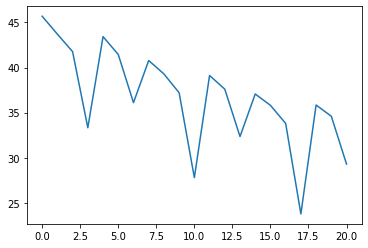

2200 tf.Tensor(33.99128702035845, shape=(), dtype=float64)
tf.Tensor(33.99128702035845, shape=(), dtype=float64)


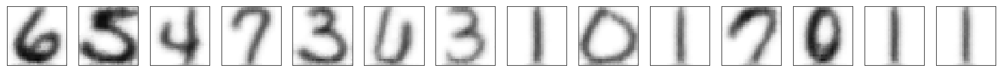

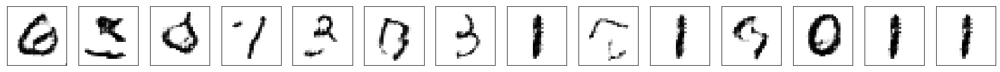

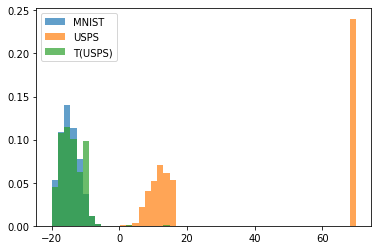

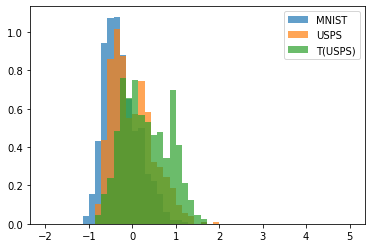

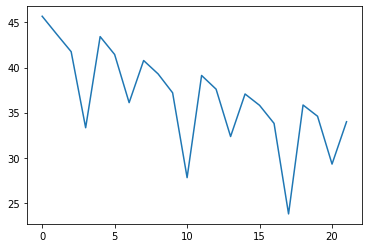

2300 tf.Tensor(32.88818890302009, shape=(), dtype=float64)
tf.Tensor(32.88818890302009, shape=(), dtype=float64)


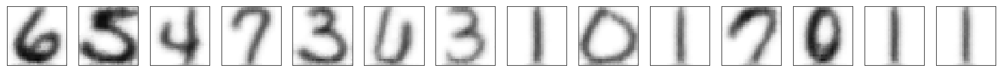

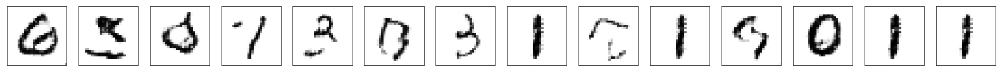

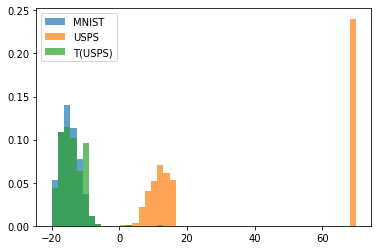

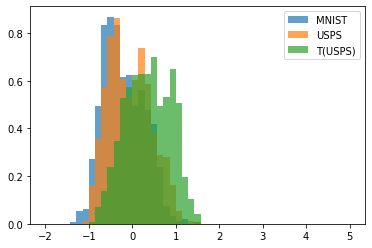

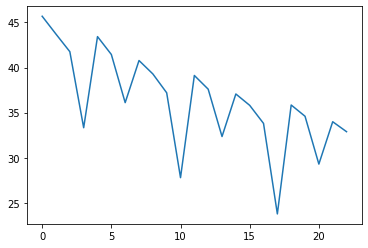

2400 tf.Tensor(30.91767453288761, shape=(), dtype=float64)
tf.Tensor(30.91767453288761, shape=(), dtype=float64)


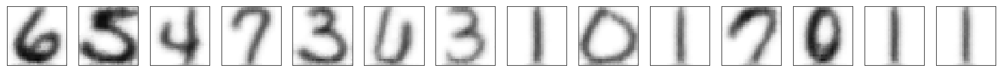

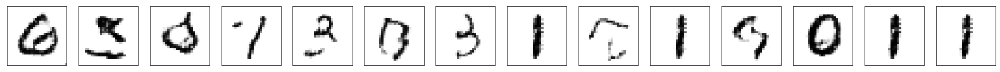

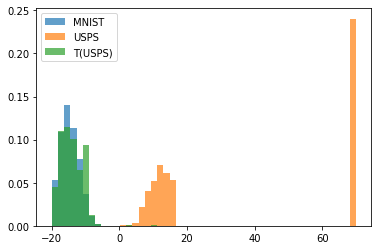

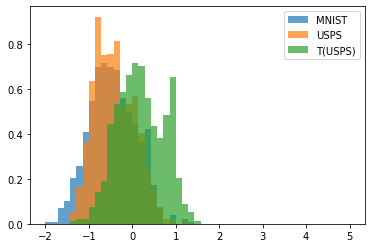

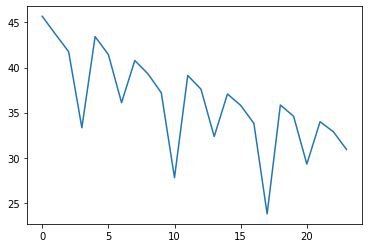

2500 tf.Tensor(20.71125620849121, shape=(), dtype=float64)
tf.Tensor(20.71125620849121, shape=(), dtype=float64)


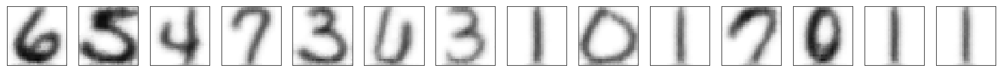

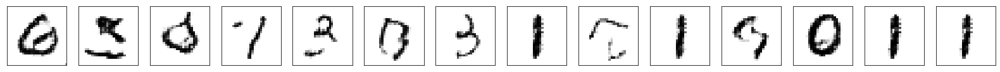

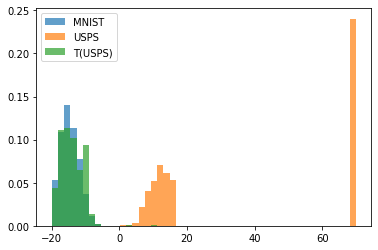

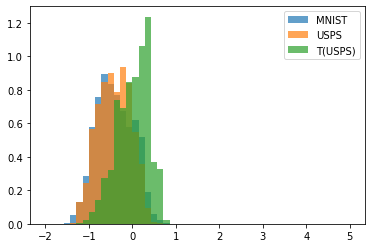

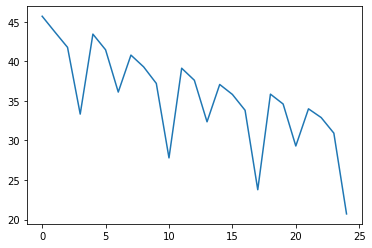

2600 tf.Tensor(33.15881560014893, shape=(), dtype=float64)
tf.Tensor(33.15881560014893, shape=(), dtype=float64)


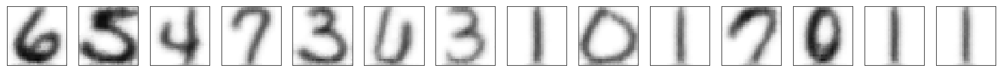

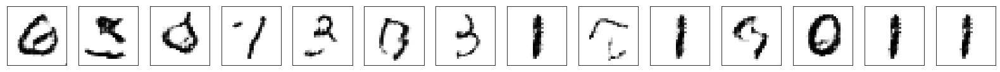

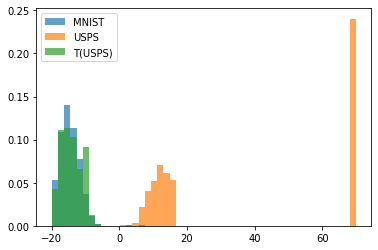

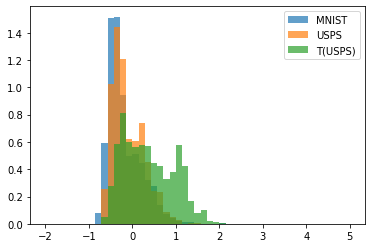

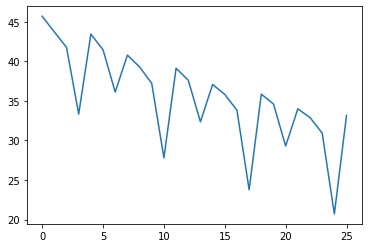

2700 tf.Tensor(31.99425023088793, shape=(), dtype=float64)
tf.Tensor(31.99425023088793, shape=(), dtype=float64)


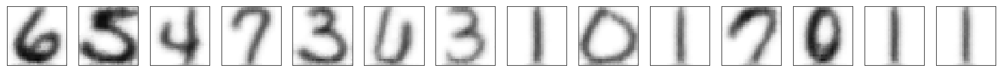

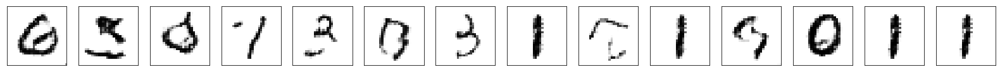

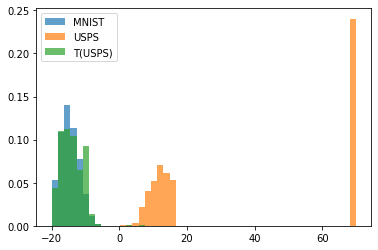

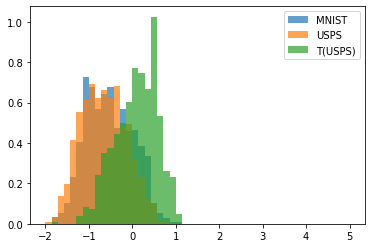

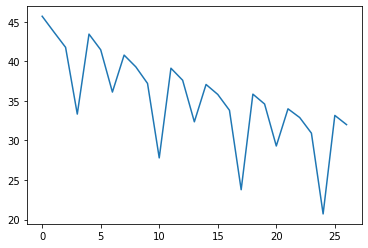

2800 tf.Tensor(26.68008473552635, shape=(), dtype=float64)
tf.Tensor(26.68008473552635, shape=(), dtype=float64)


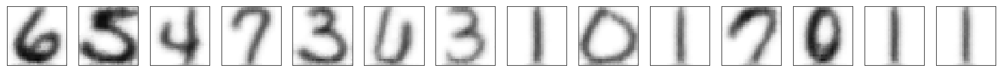

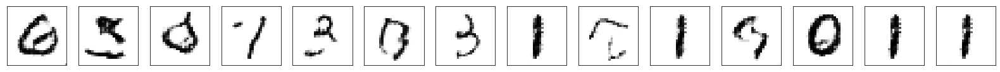

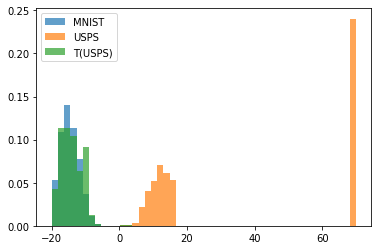

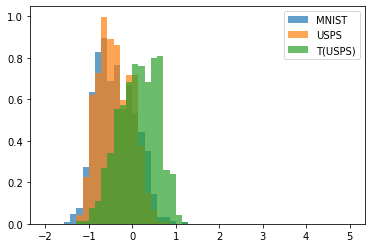

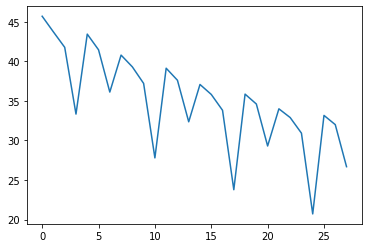

2900 tf.Tensor(31.496528067921545, shape=(), dtype=float64)
tf.Tensor(31.496528067921545, shape=(), dtype=float64)


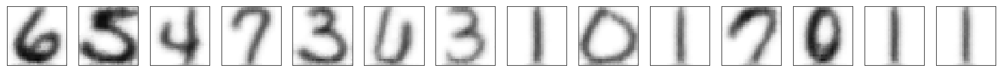

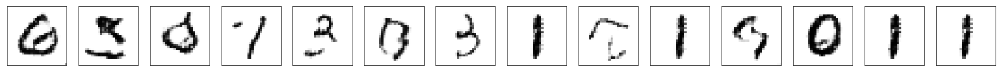

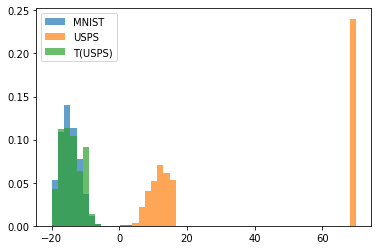

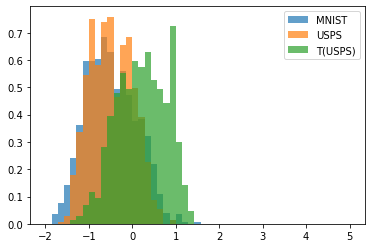

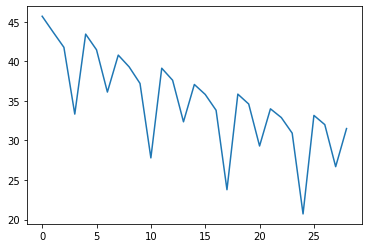

3000 tf.Tensor(30.30825173196593, shape=(), dtype=float64)
tf.Tensor(30.30825173196593, shape=(), dtype=float64)


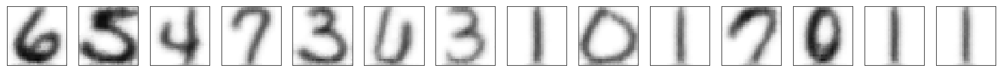

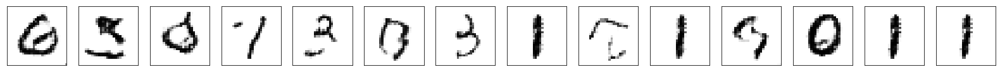

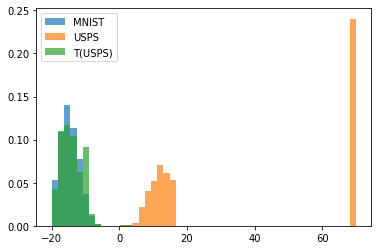

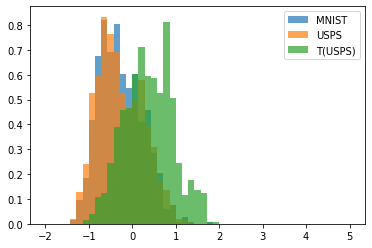

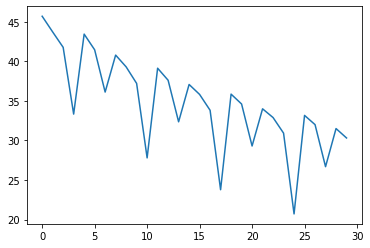

saving weights
3100 tf.Tensor(28.539946390145786, shape=(), dtype=float64)
tf.Tensor(28.539946390145786, shape=(), dtype=float64)


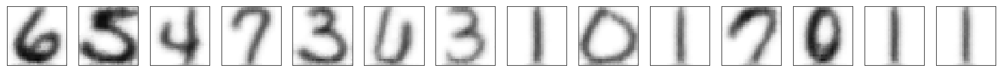

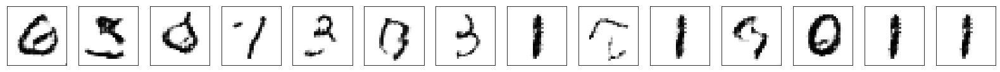

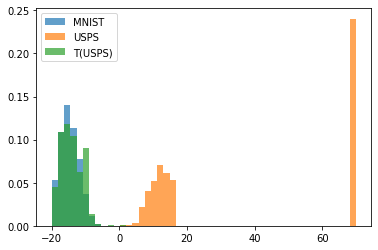

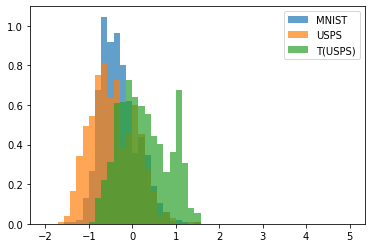

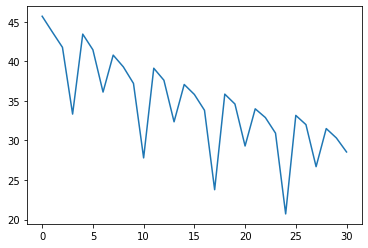

3200 tf.Tensor(17.880086665870852, shape=(), dtype=float64)
tf.Tensor(17.880086665870852, shape=(), dtype=float64)


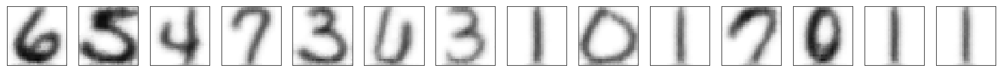

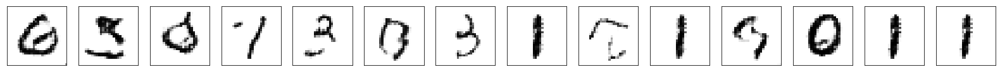

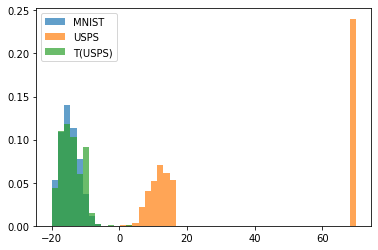

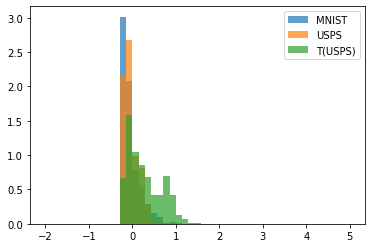

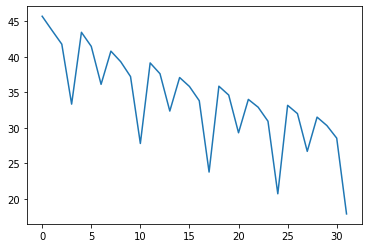

3300 tf.Tensor(30.698705333179674, shape=(), dtype=float64)
tf.Tensor(30.698705333179674, shape=(), dtype=float64)


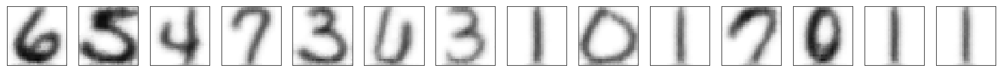

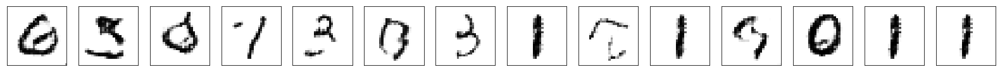

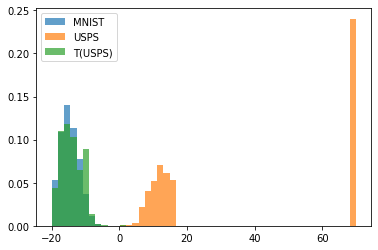

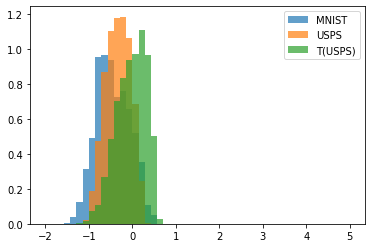

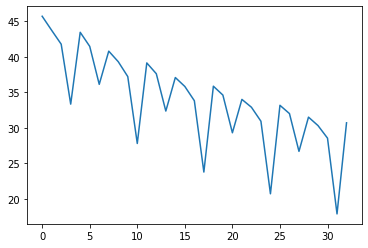

3400 tf.Tensor(29.788298675196636, shape=(), dtype=float64)
tf.Tensor(29.788298675196636, shape=(), dtype=float64)


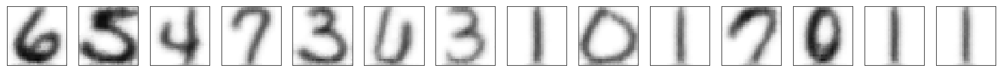

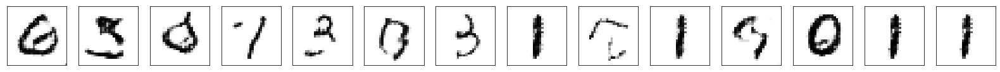

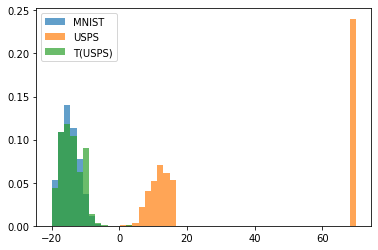

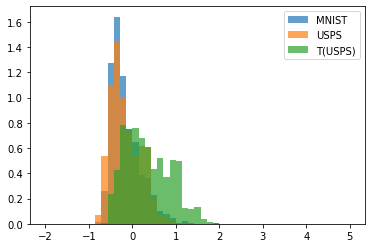

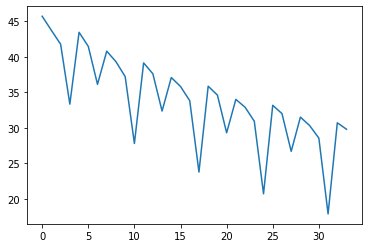

3500 tf.Tensor(24.467674508097772, shape=(), dtype=float64)
tf.Tensor(24.467674508097772, shape=(), dtype=float64)


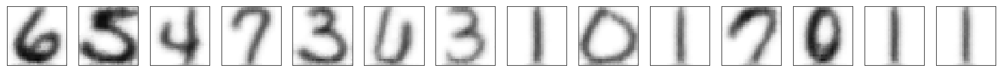

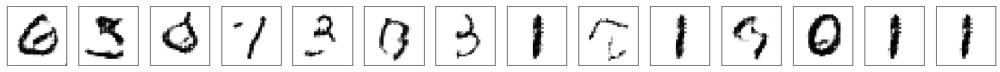

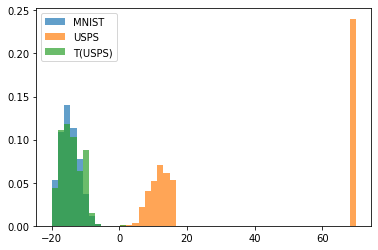

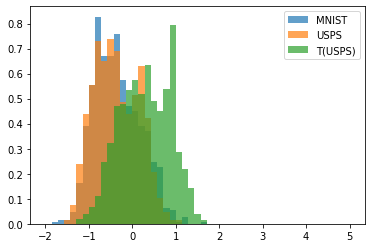

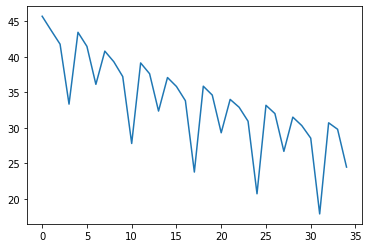

3600 tf.Tensor(29.18258689894857, shape=(), dtype=float64)
tf.Tensor(29.18258689894857, shape=(), dtype=float64)


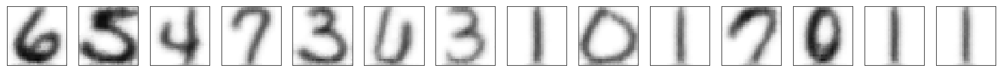

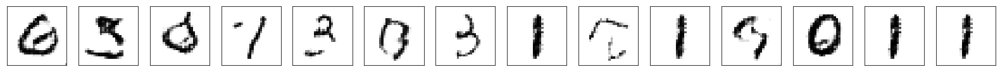

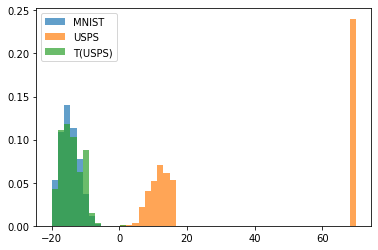

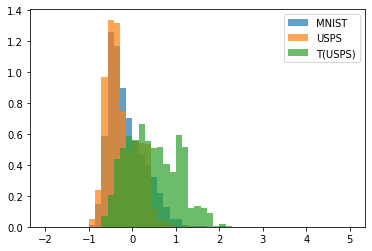

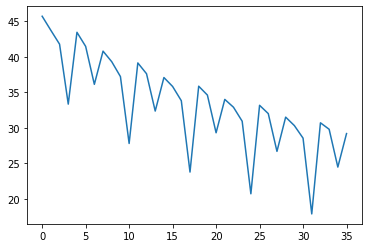

3700 tf.Tensor(28.15023079305758, shape=(), dtype=float64)
tf.Tensor(28.15023079305758, shape=(), dtype=float64)


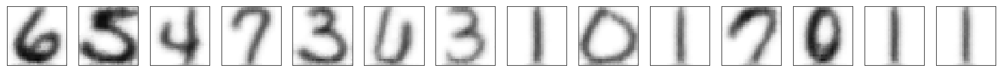

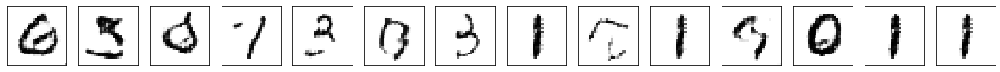

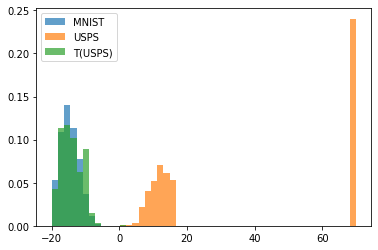

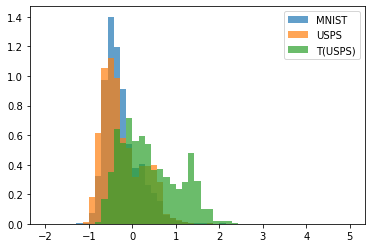

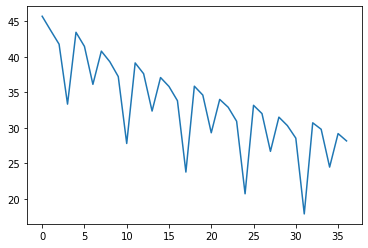

3800 tf.Tensor(26.379412003758667, shape=(), dtype=float64)
tf.Tensor(26.379412003758667, shape=(), dtype=float64)


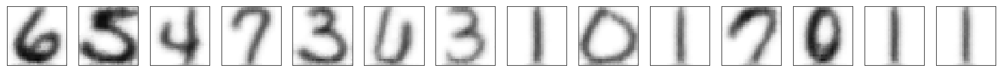

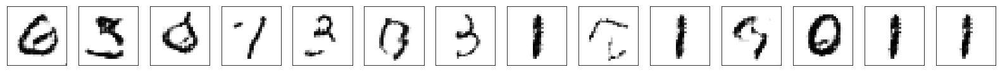

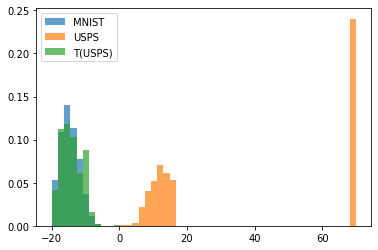

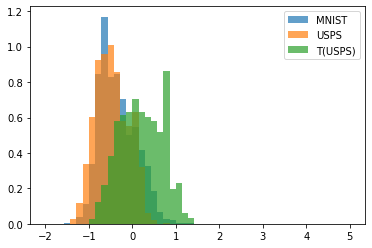

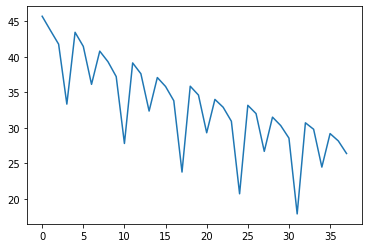

3900 tf.Tensor(15.609207378533462, shape=(), dtype=float64)
tf.Tensor(15.609207378533462, shape=(), dtype=float64)


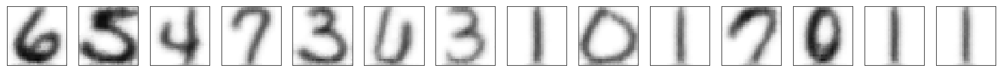

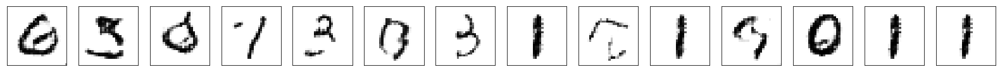

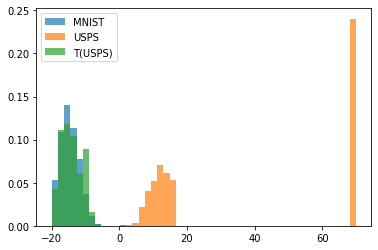

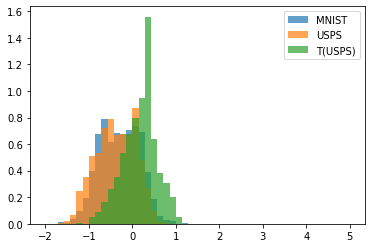

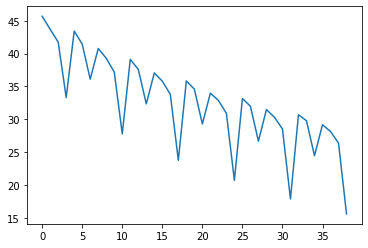

4000 tf.Tensor(28.911680028514134, shape=(), dtype=float64)
tf.Tensor(28.911680028514134, shape=(), dtype=float64)


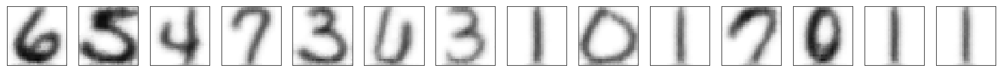

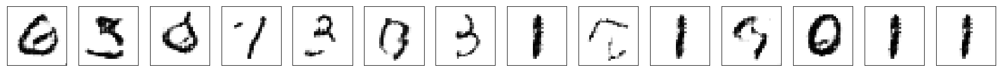

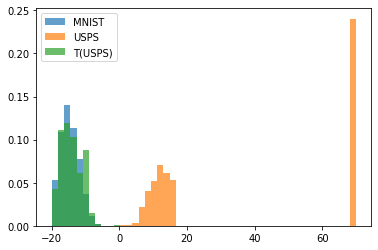

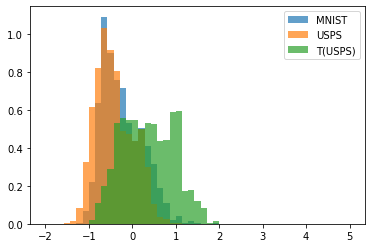

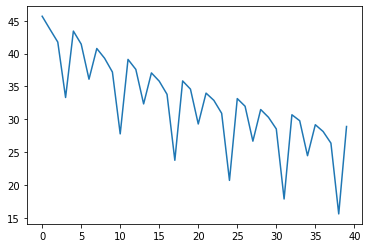

saving weights
4100 tf.Tensor(27.970285385330065, shape=(), dtype=float64)
tf.Tensor(27.970285385330065, shape=(), dtype=float64)


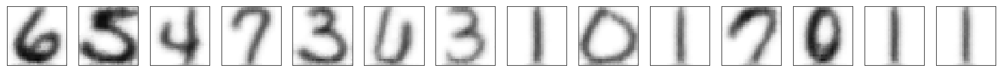

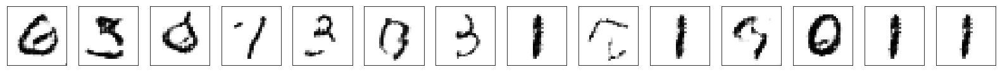

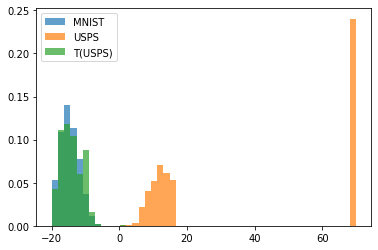

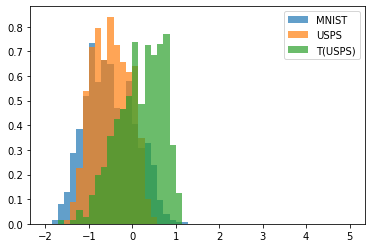

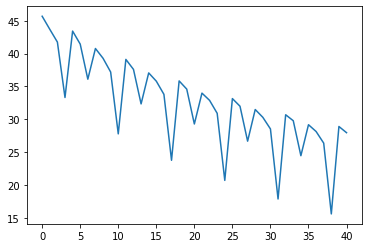

4200 tf.Tensor(22.56522062734858, shape=(), dtype=float64)
tf.Tensor(22.56522062734858, shape=(), dtype=float64)


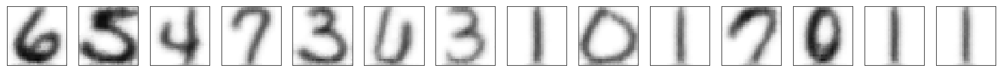

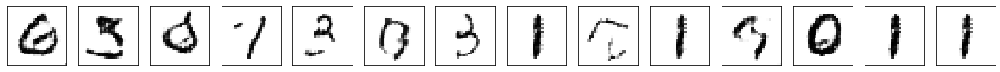

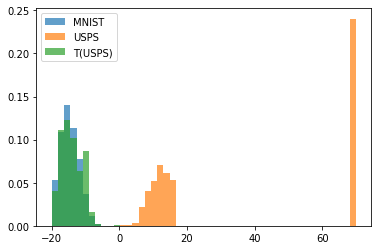

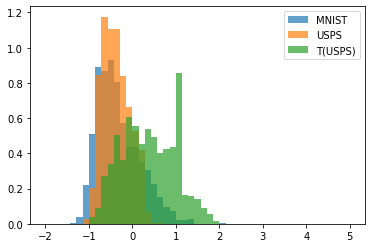

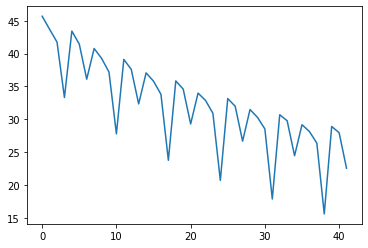

4300 tf.Tensor(27.418745214241675, shape=(), dtype=float64)
tf.Tensor(27.418745214241675, shape=(), dtype=float64)


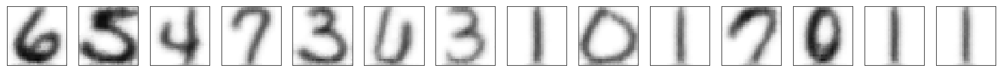

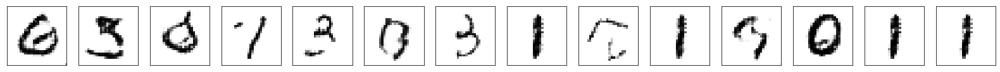

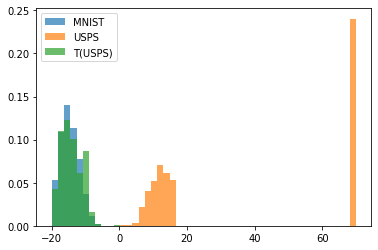

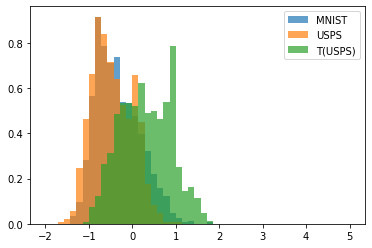

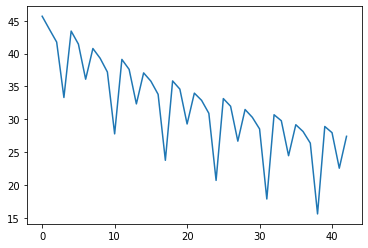

4400 tf.Tensor(26.227672321964683, shape=(), dtype=float64)
tf.Tensor(26.227672321964683, shape=(), dtype=float64)


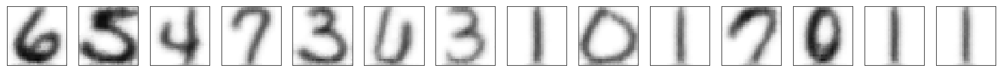

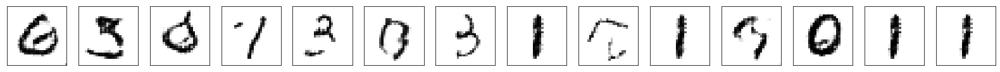

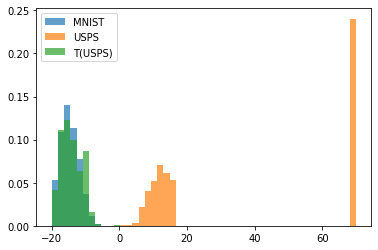

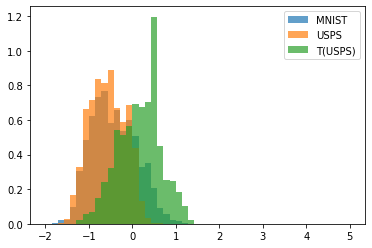

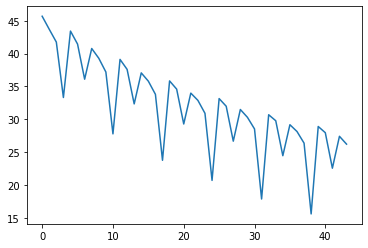

4500 tf.Tensor(24.704625504770675, shape=(), dtype=float64)
tf.Tensor(24.704625504770675, shape=(), dtype=float64)


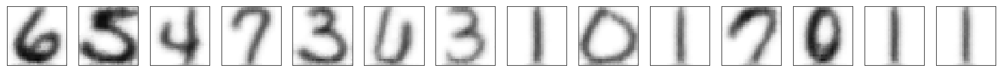

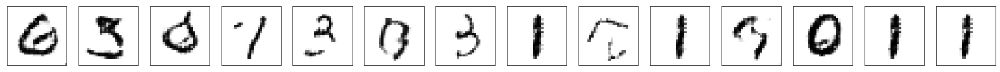

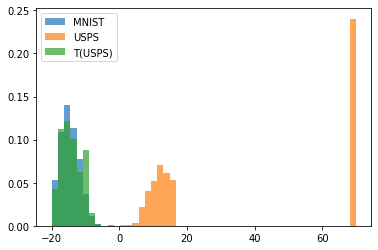

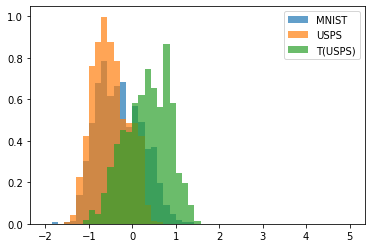

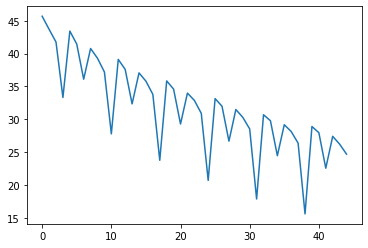

4600 tf.Tensor(13.915595121668858, shape=(), dtype=float64)
tf.Tensor(13.915595121668858, shape=(), dtype=float64)


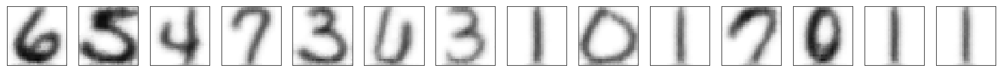

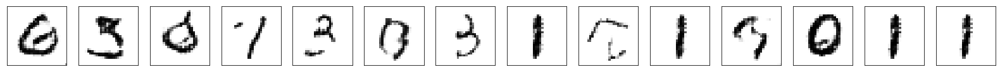

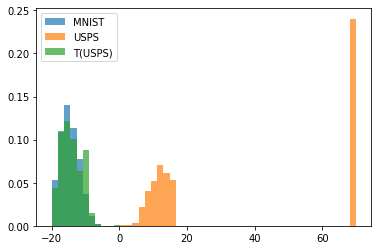

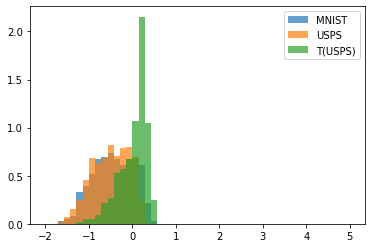

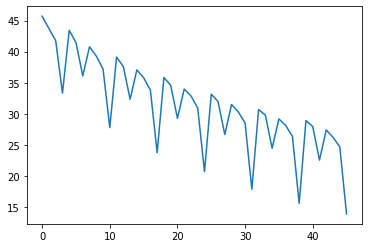

4700 tf.Tensor(26.9905315125659, shape=(), dtype=float64)
tf.Tensor(26.9905315125659, shape=(), dtype=float64)


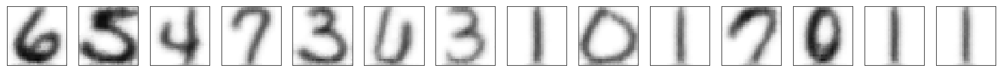

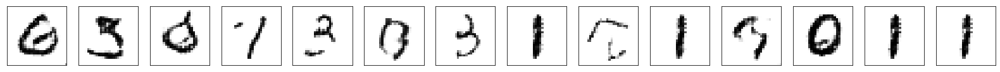

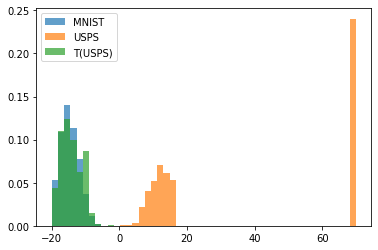

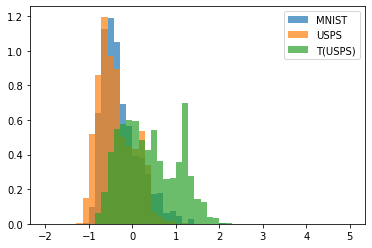

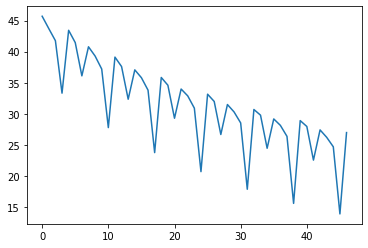

4800 tf.Tensor(26.315957411277353, shape=(), dtype=float64)
tf.Tensor(26.315957411277353, shape=(), dtype=float64)


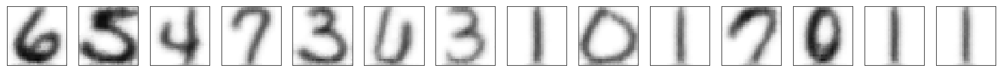

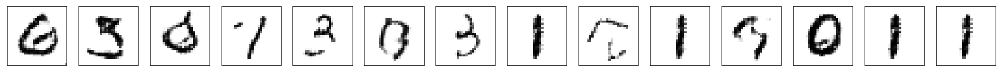

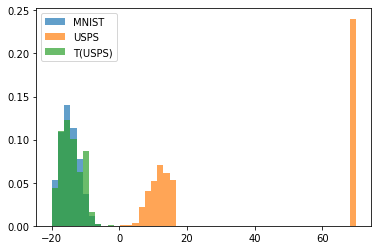

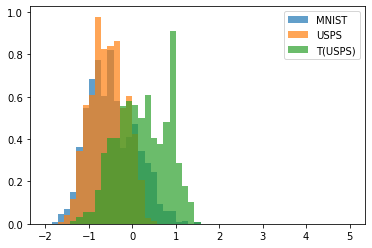

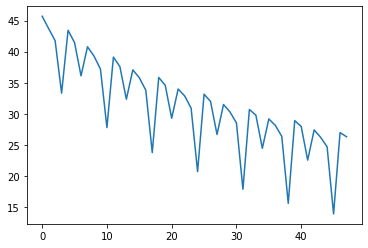

4900 tf.Tensor(20.9239077428034, shape=(), dtype=float64)
tf.Tensor(20.9239077428034, shape=(), dtype=float64)


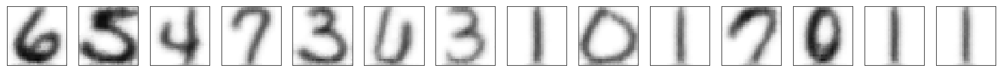

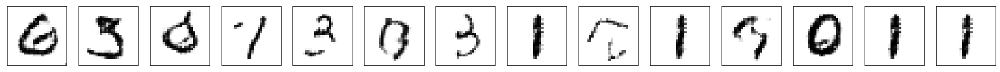

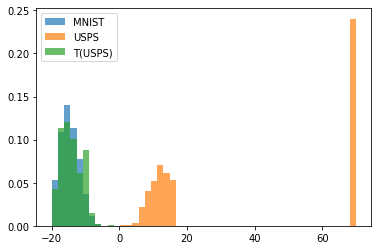

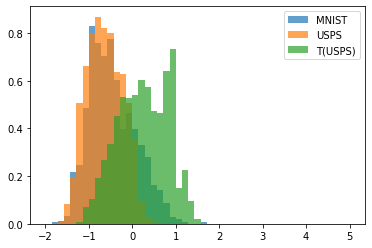

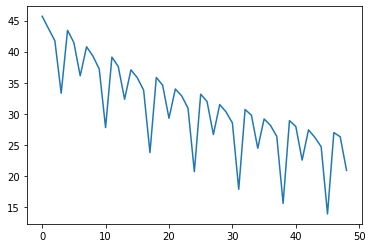

5000 tf.Tensor(25.55963311896093, shape=(), dtype=float64)
tf.Tensor(25.55963311896093, shape=(), dtype=float64)


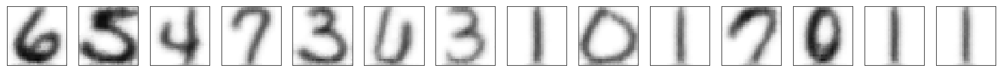

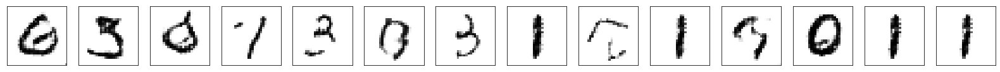

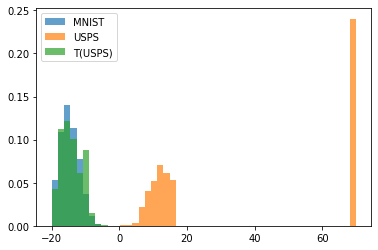

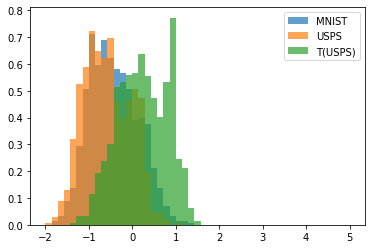

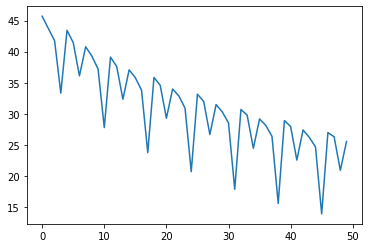

saving weights
5100 tf.Tensor(24.477188232244224, shape=(), dtype=float64)
tf.Tensor(24.477188232244224, shape=(), dtype=float64)


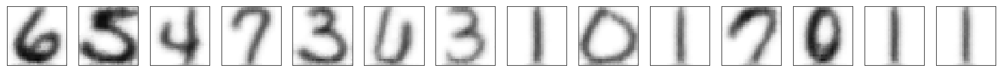

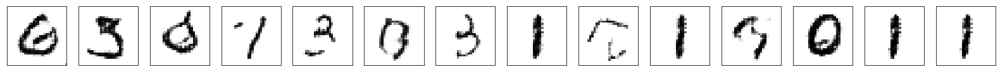

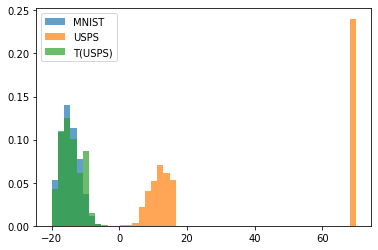

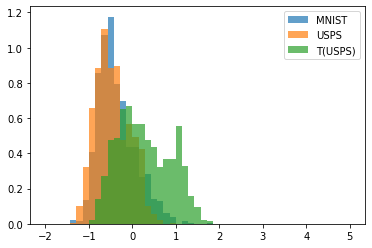

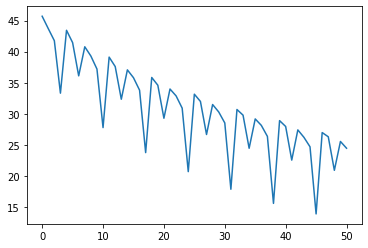

5200 tf.Tensor(22.94863831399712, shape=(), dtype=float64)
tf.Tensor(22.94863831399712, shape=(), dtype=float64)


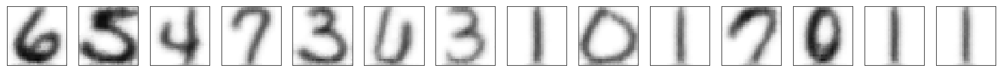

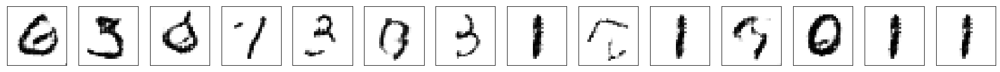

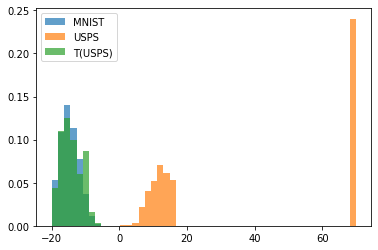

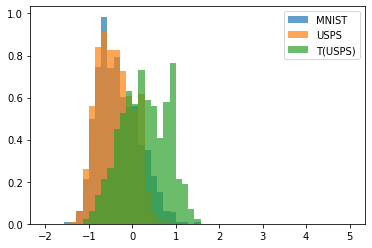

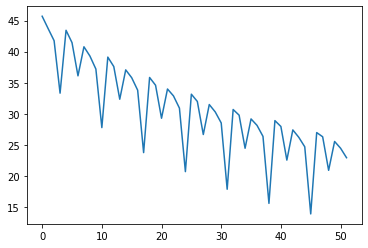

5300 tf.Tensor(11.745455544579748, shape=(), dtype=float64)
tf.Tensor(11.745455544579748, shape=(), dtype=float64)


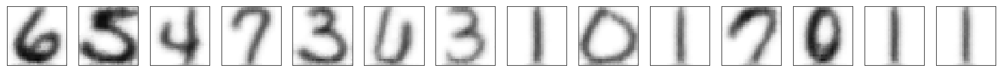

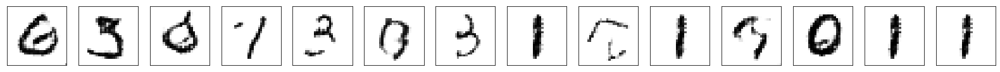

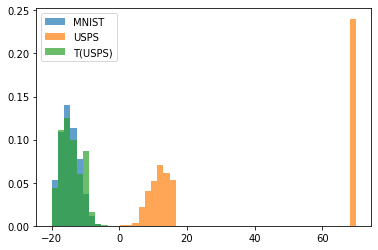

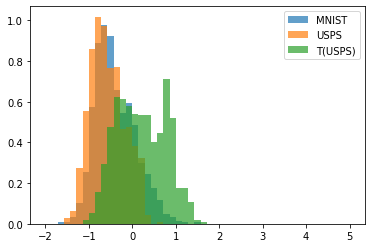

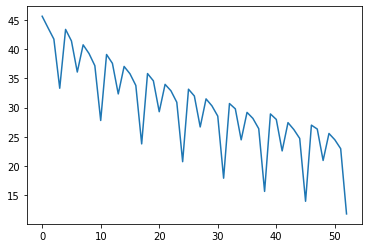

5400 tf.Tensor(25.44303224327915, shape=(), dtype=float64)
tf.Tensor(25.44303224327915, shape=(), dtype=float64)


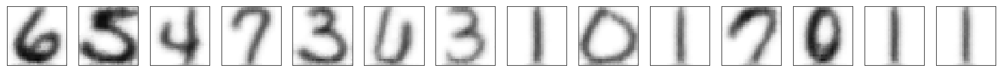

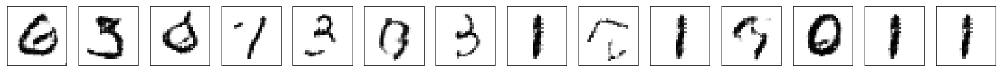

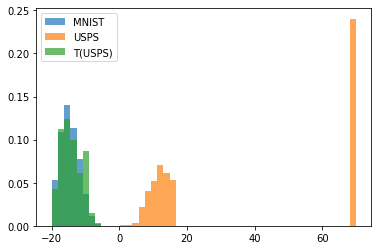

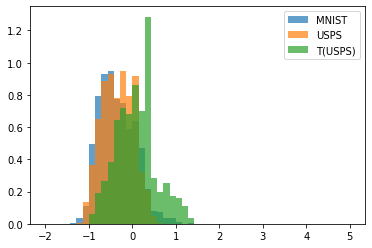

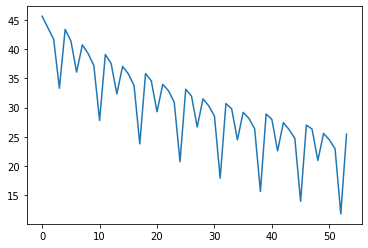

5500 tf.Tensor(24.811526116139916, shape=(), dtype=float64)
tf.Tensor(24.811526116139916, shape=(), dtype=float64)


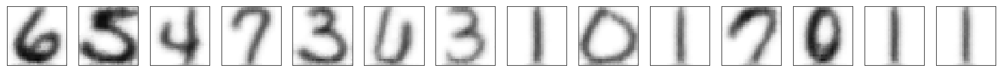

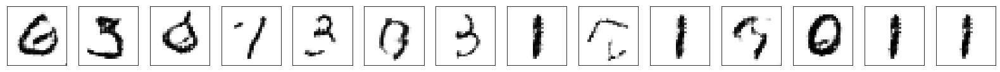

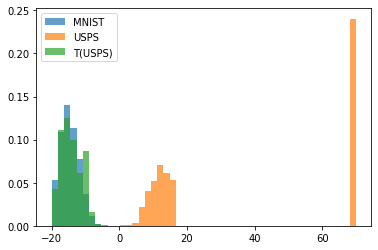

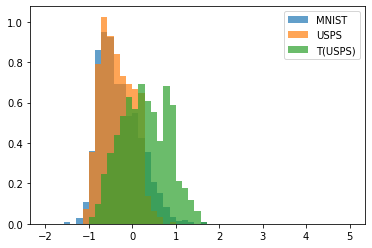

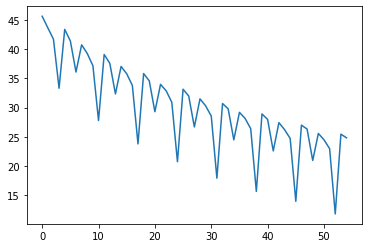

5600 tf.Tensor(19.21471659886371, shape=(), dtype=float64)
tf.Tensor(19.21471659886371, shape=(), dtype=float64)


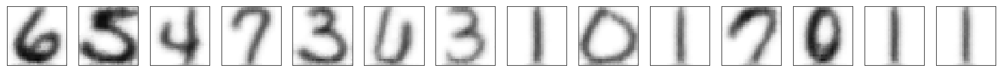

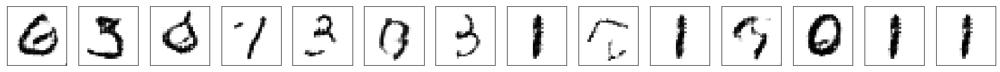

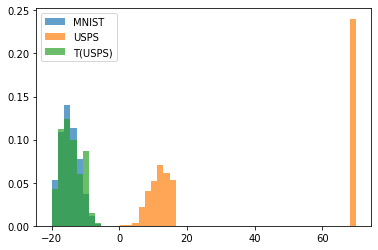

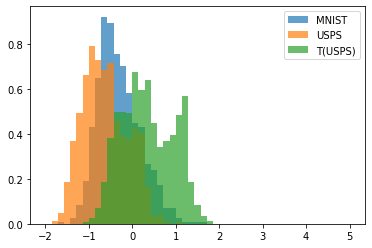

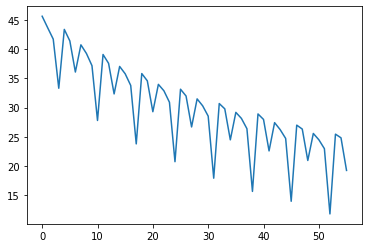

5700 tf.Tensor(23.93247640316027, shape=(), dtype=float64)
tf.Tensor(23.93247640316027, shape=(), dtype=float64)


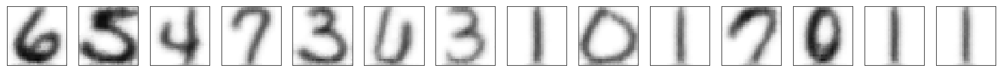

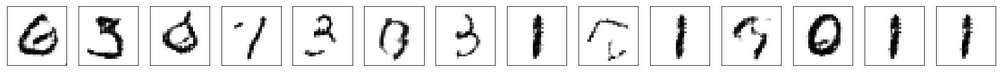

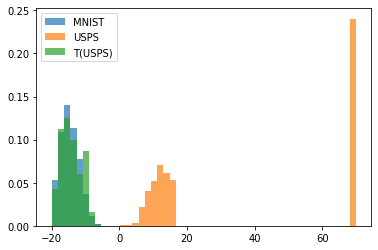

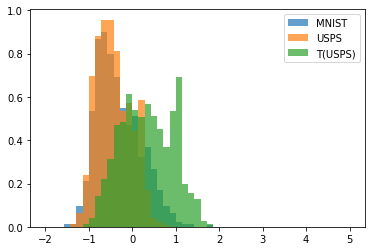

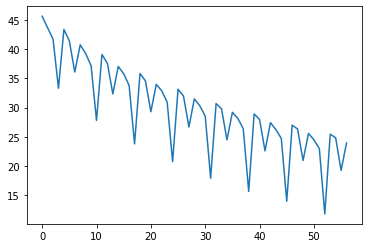

5800 tf.Tensor(22.917857446212963, shape=(), dtype=float64)
tf.Tensor(22.917857446212963, shape=(), dtype=float64)


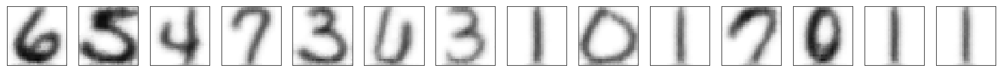

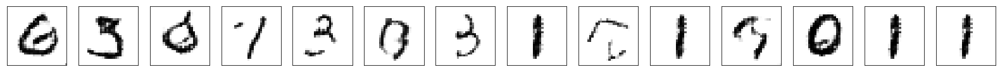

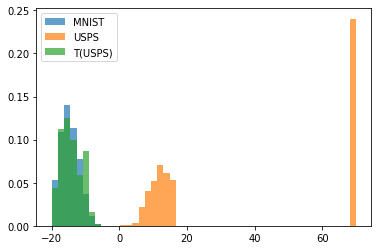

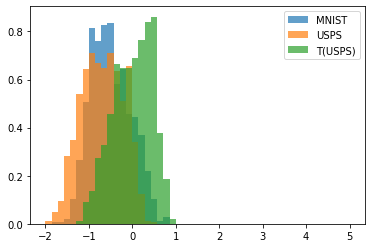

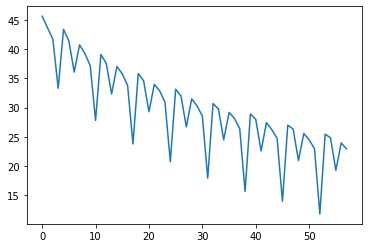

5900 tf.Tensor(21.7082406663759, shape=(), dtype=float64)
tf.Tensor(21.7082406663759, shape=(), dtype=float64)


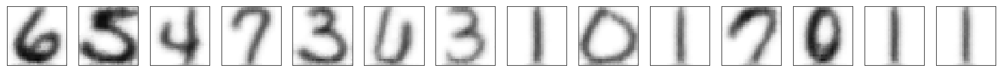

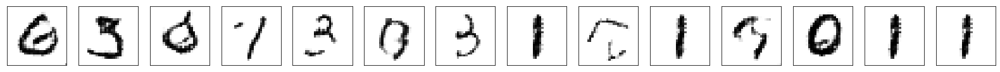

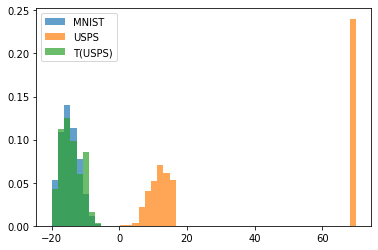

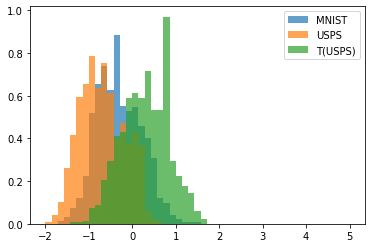

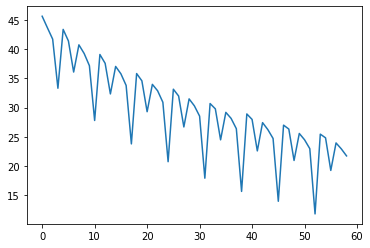

6000 tf.Tensor(10.263722303681945, shape=(), dtype=float64)
tf.Tensor(10.263722303681945, shape=(), dtype=float64)


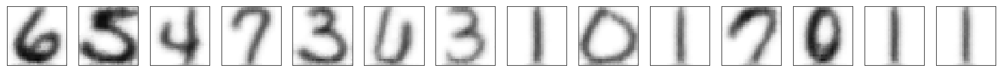

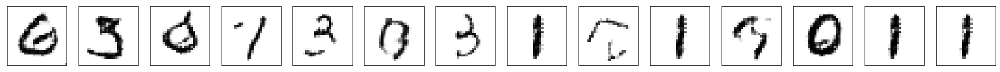

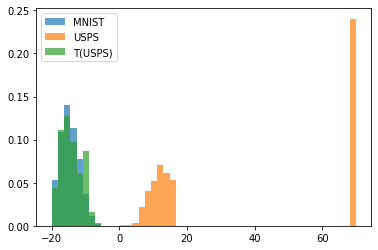

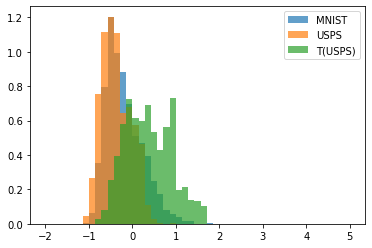

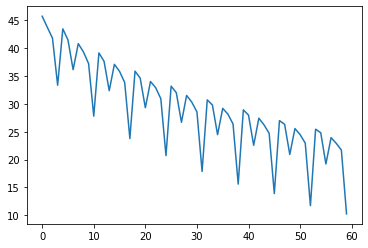

saving weights
6100 tf.Tensor(24.058625046657525, shape=(), dtype=float64)
tf.Tensor(24.058625046657525, shape=(), dtype=float64)


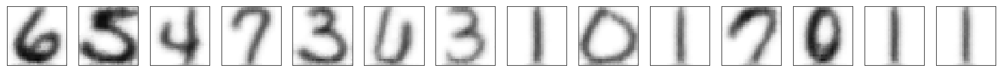

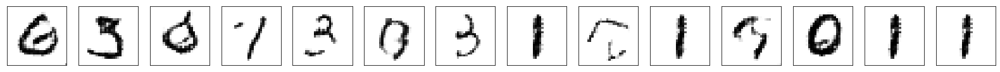

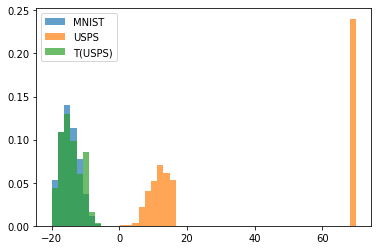

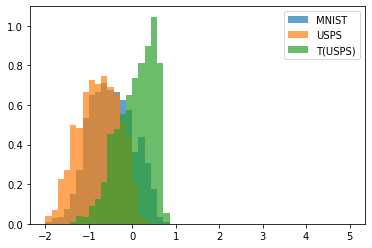

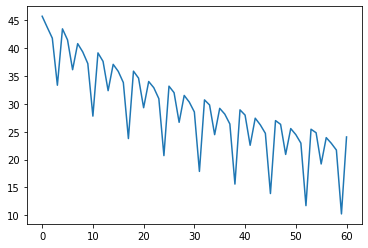

6200 tf.Tensor(23.442206758603056, shape=(), dtype=float64)
tf.Tensor(23.442206758603056, shape=(), dtype=float64)


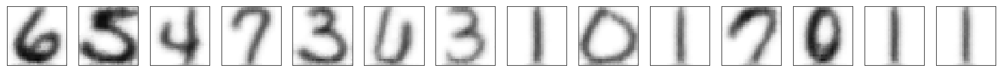

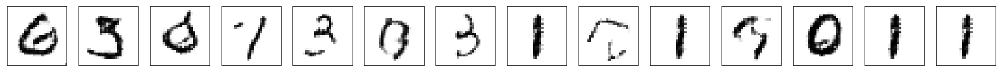

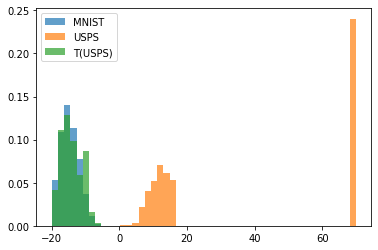

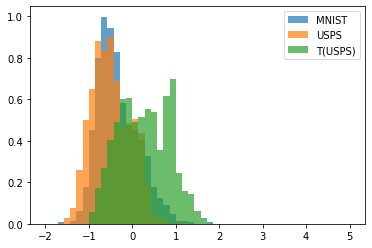

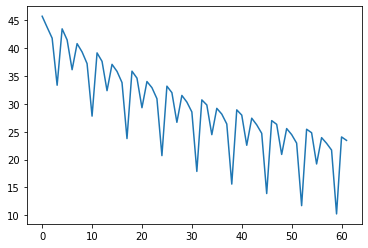

6300 tf.Tensor(17.90784250843526, shape=(), dtype=float64)
tf.Tensor(17.90784250843526, shape=(), dtype=float64)


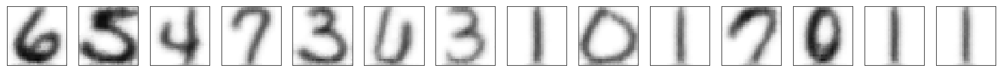

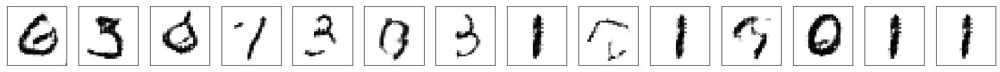

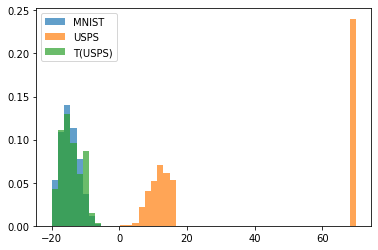

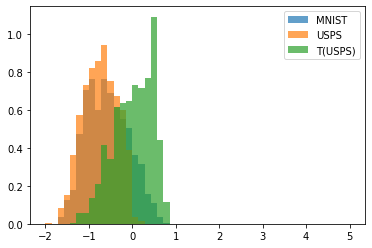

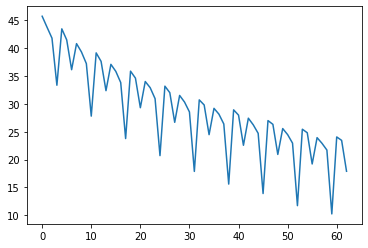

6400 tf.Tensor(22.49825564897677, shape=(), dtype=float64)
tf.Tensor(22.49825564897677, shape=(), dtype=float64)


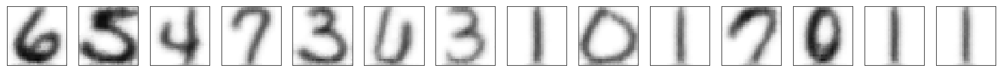

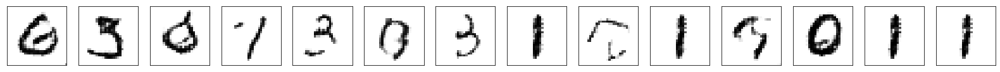

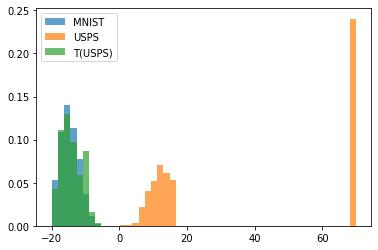

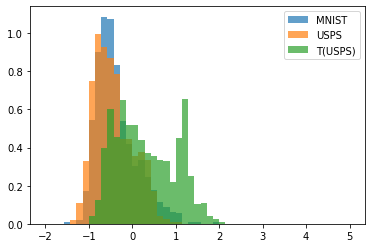

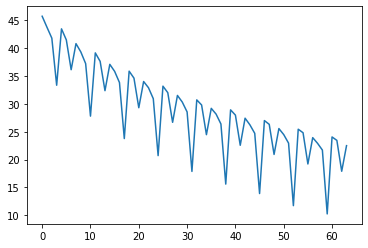

6500 tf.Tensor(21.506000090138272, shape=(), dtype=float64)
tf.Tensor(21.506000090138272, shape=(), dtype=float64)


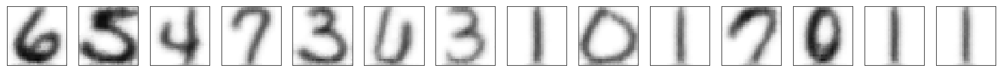

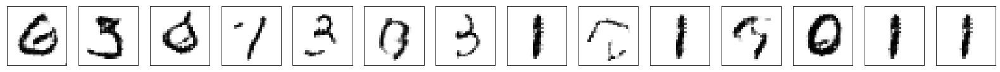

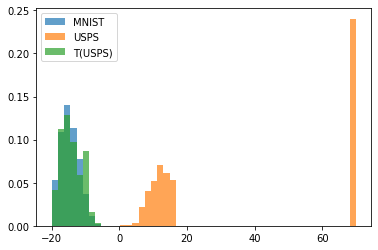

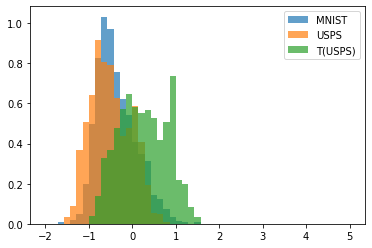

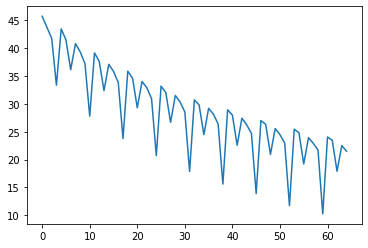

6600 tf.Tensor(20.282743501666012, shape=(), dtype=float64)
tf.Tensor(20.282743501666012, shape=(), dtype=float64)


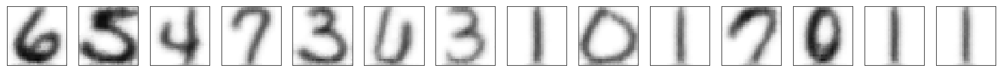

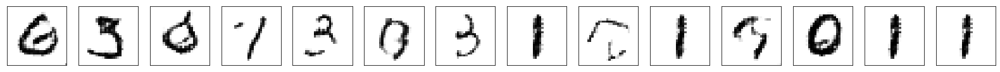

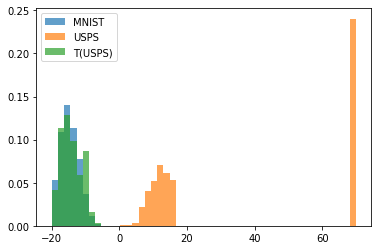

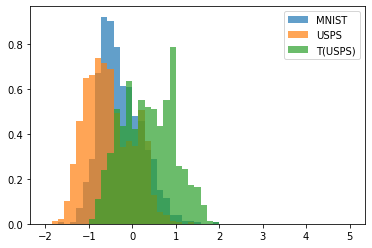

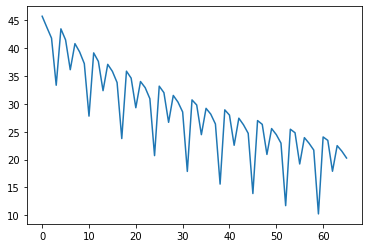

6700 tf.Tensor(8.631365742204803, shape=(), dtype=float64)
tf.Tensor(8.631365742204803, shape=(), dtype=float64)


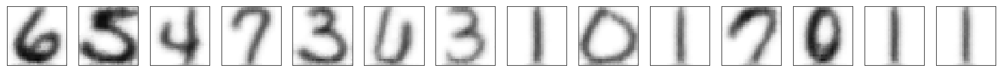

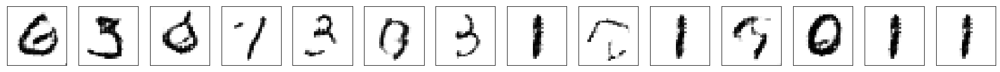

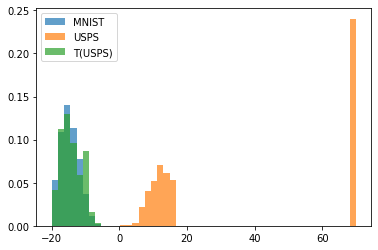

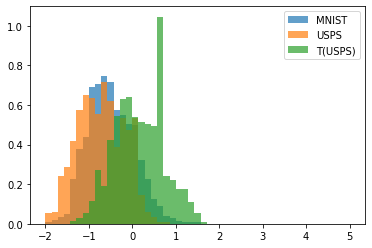

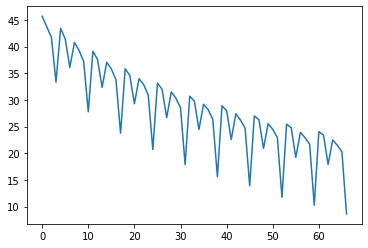

6800 tf.Tensor(22.746069881899558, shape=(), dtype=float64)
tf.Tensor(22.746069881899558, shape=(), dtype=float64)


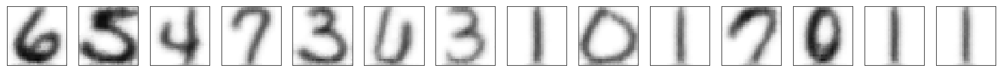

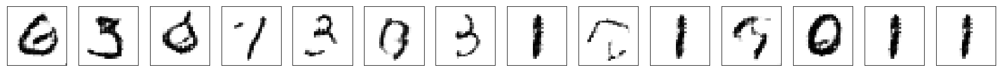

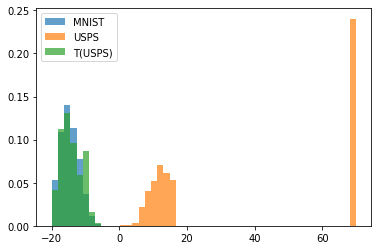

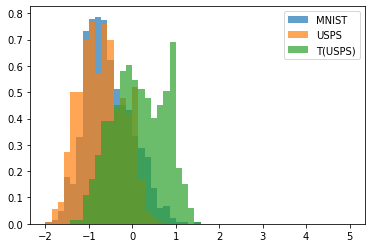

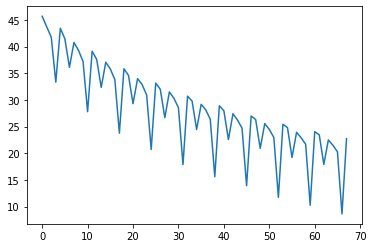

6900 tf.Tensor(22.30327197506454, shape=(), dtype=float64)
tf.Tensor(22.30327197506454, shape=(), dtype=float64)


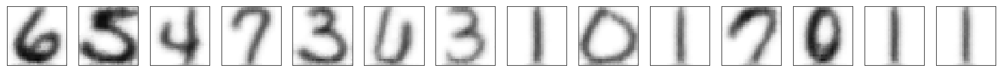

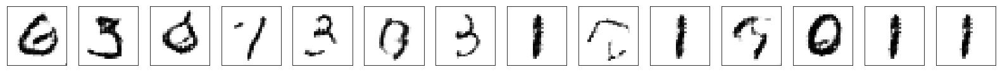

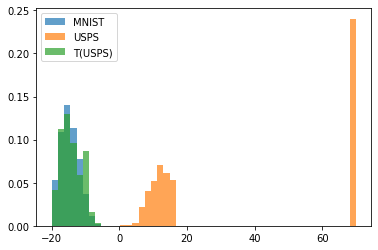

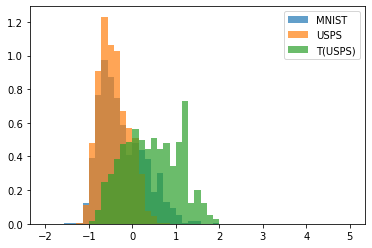

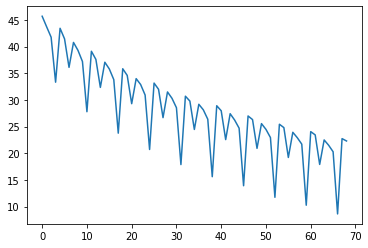

7000 tf.Tensor(16.583255067103813, shape=(), dtype=float64)
tf.Tensor(16.583255067103813, shape=(), dtype=float64)


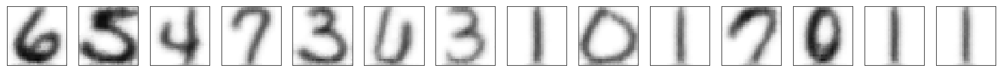

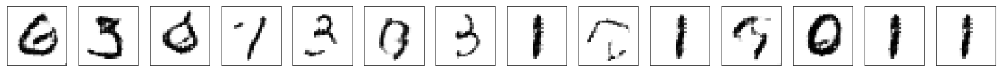

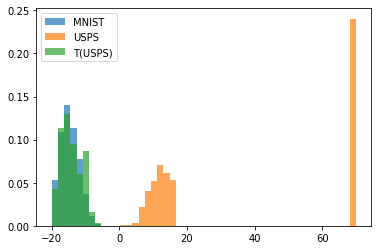

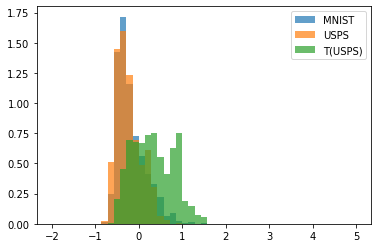

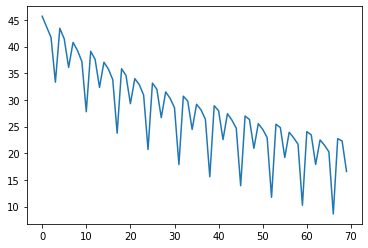

saving weights
7100 tf.Tensor(21.245031755019752, shape=(), dtype=float64)
tf.Tensor(21.245031755019752, shape=(), dtype=float64)


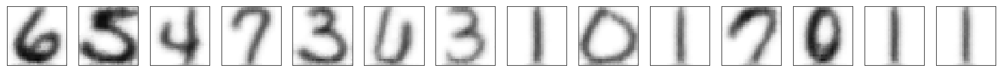

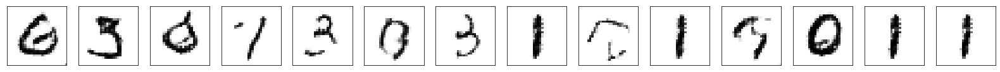

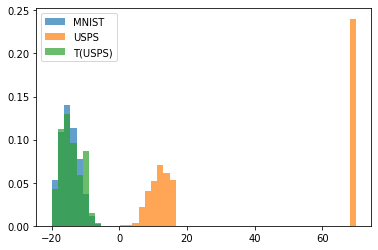

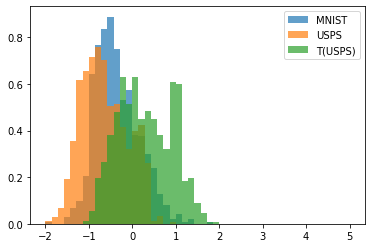

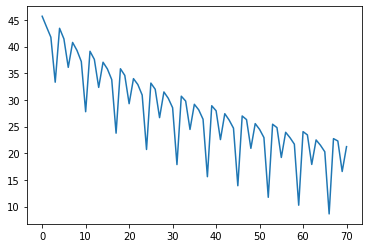

7200 tf.Tensor(20.29538408129367, shape=(), dtype=float64)
tf.Tensor(20.29538408129367, shape=(), dtype=float64)


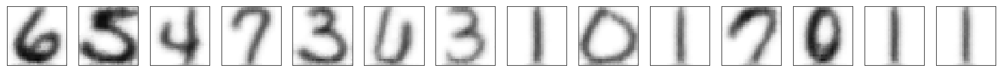

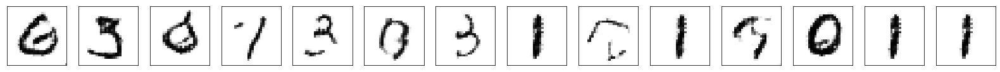

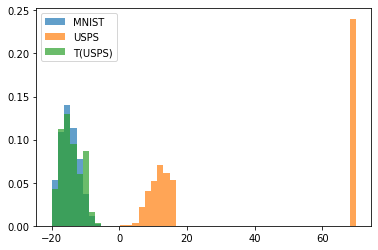

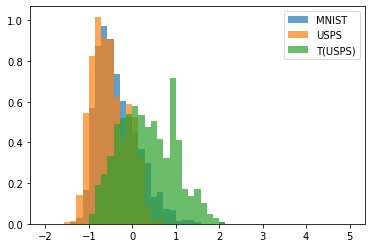

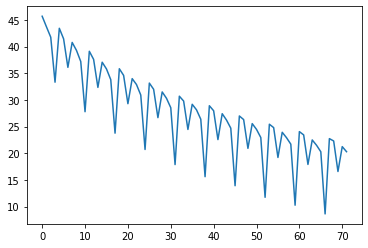

7300 tf.Tensor(19.00088325319211, shape=(), dtype=float64)
tf.Tensor(19.00088325319211, shape=(), dtype=float64)


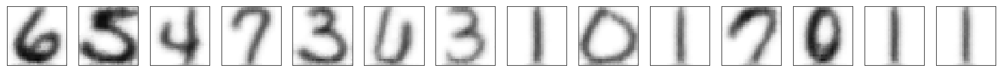

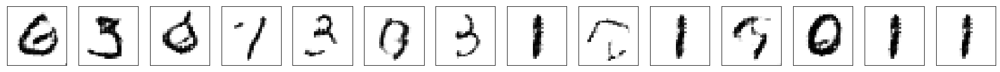

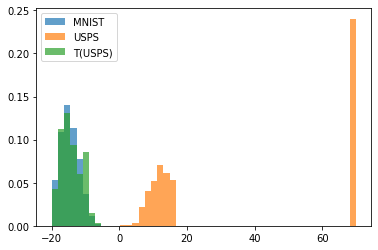

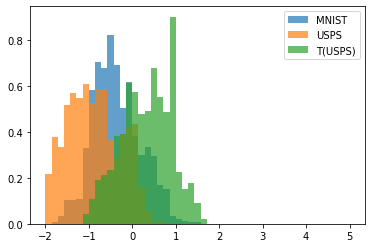

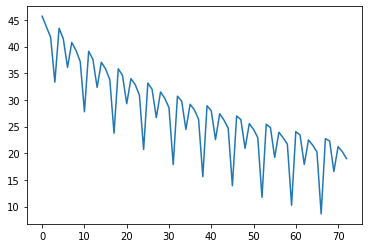

7400 tf.Tensor(7.579417763109099, shape=(), dtype=float64)
tf.Tensor(7.579417763109099, shape=(), dtype=float64)


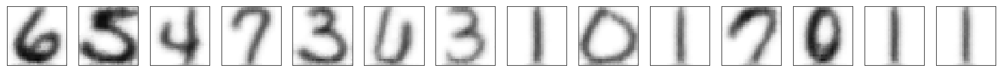

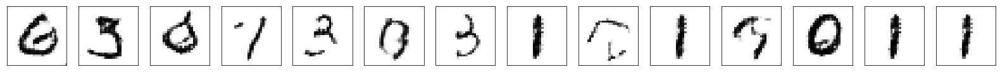

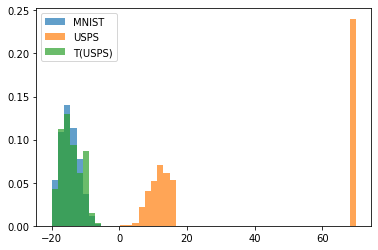

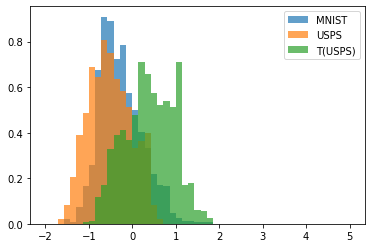

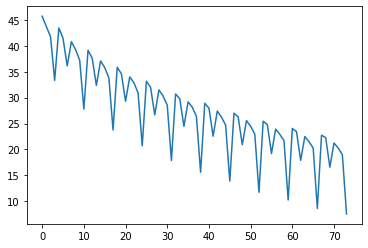

7500 tf.Tensor(21.55179010373798, shape=(), dtype=float64)
tf.Tensor(21.55179010373798, shape=(), dtype=float64)


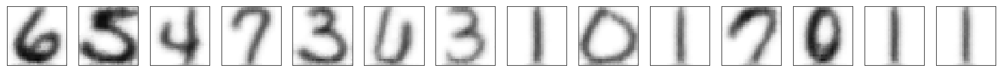

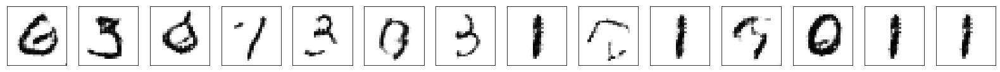

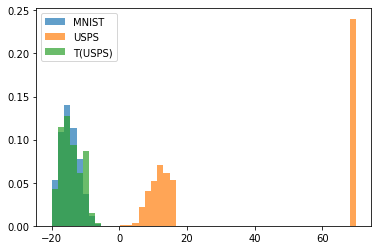

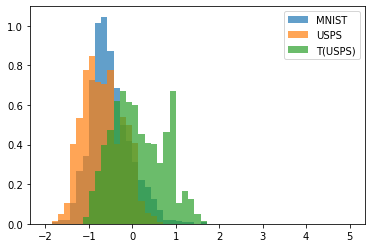

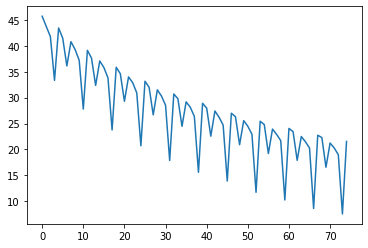

7600 tf.Tensor(21.07041927099791, shape=(), dtype=float64)
tf.Tensor(21.07041927099791, shape=(), dtype=float64)


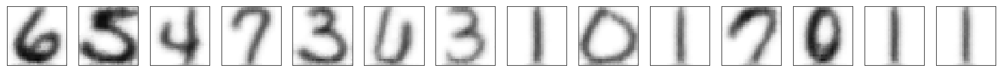

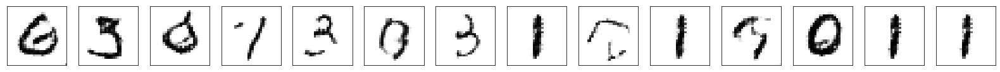

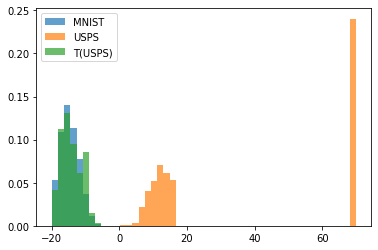

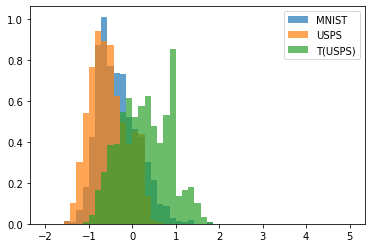

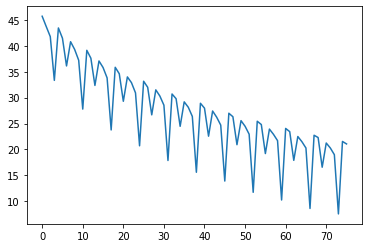

7700 tf.Tensor(15.341696960497757, shape=(), dtype=float64)
tf.Tensor(15.341696960497757, shape=(), dtype=float64)


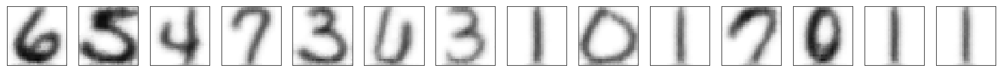

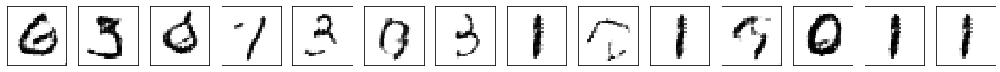

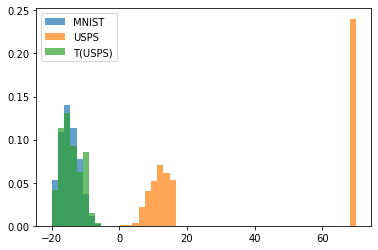

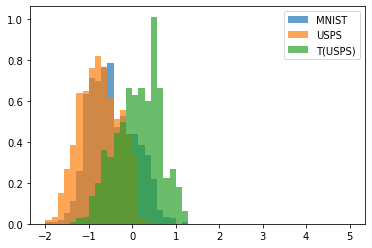

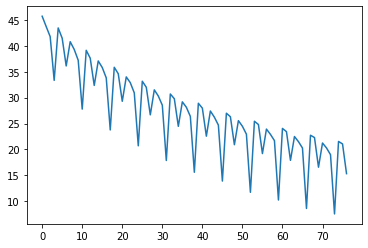

7800 tf.Tensor(20.073683979404354, shape=(), dtype=float64)
tf.Tensor(20.073683979404354, shape=(), dtype=float64)


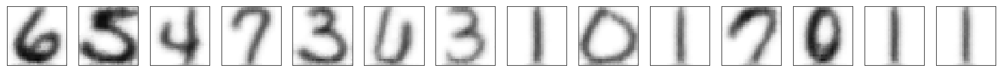

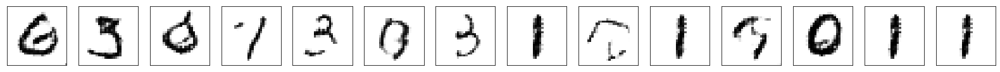

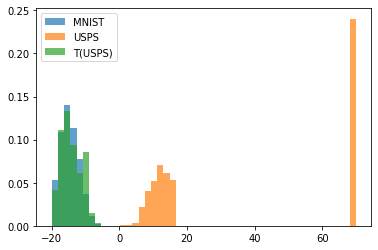

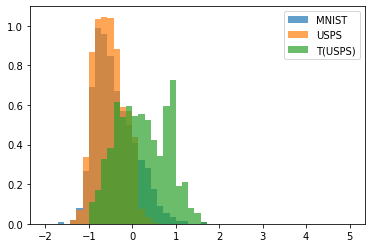

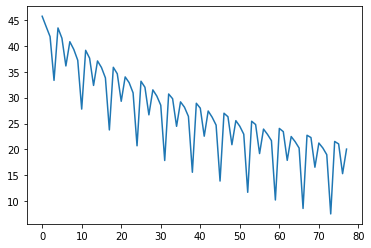

7900 tf.Tensor(19.02519572473367, shape=(), dtype=float64)
tf.Tensor(19.02519572473367, shape=(), dtype=float64)


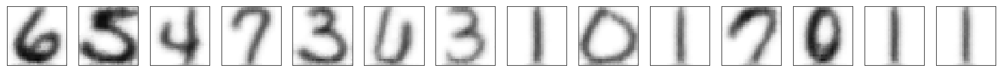

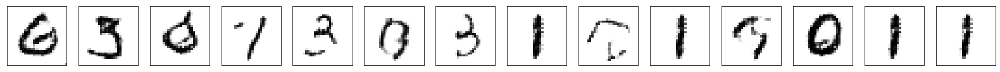

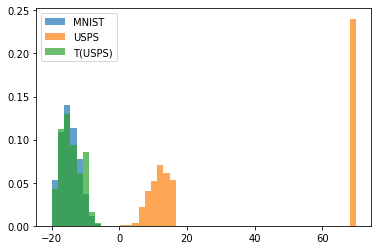

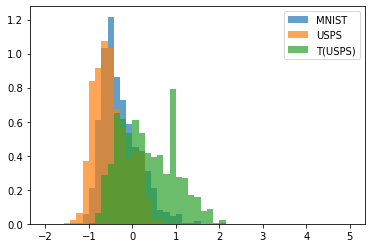

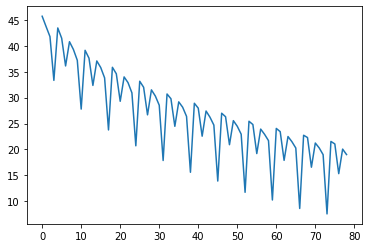

8000 tf.Tensor(18.011267584060487, shape=(), dtype=float64)
tf.Tensor(18.011267584060487, shape=(), dtype=float64)


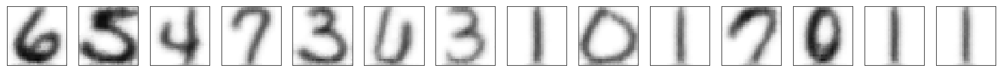

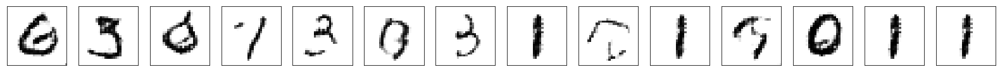

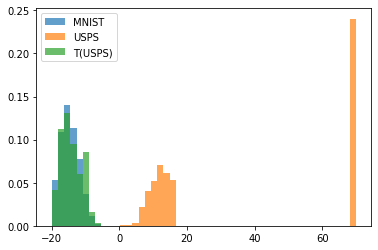

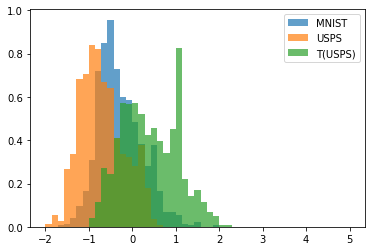

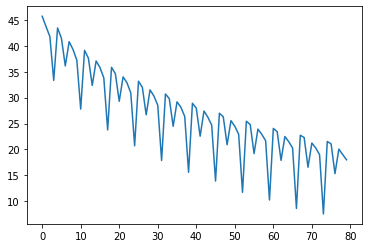

saving weights
8100 tf.Tensor(6.644540199080609, shape=(), dtype=float64)
tf.Tensor(6.644540199080609, shape=(), dtype=float64)


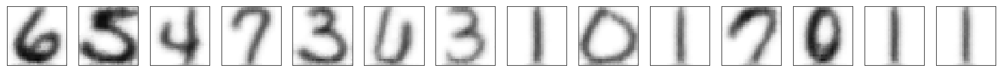

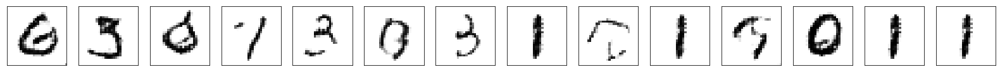

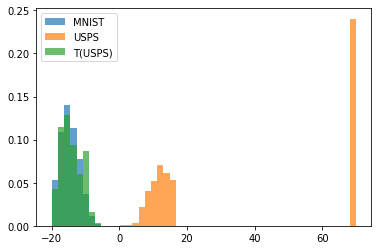

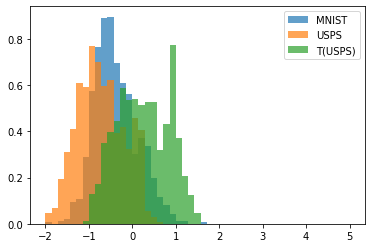

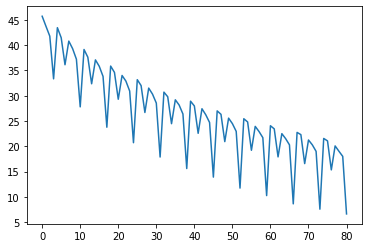

8200 tf.Tensor(20.60912229354423, shape=(), dtype=float64)
tf.Tensor(20.60912229354423, shape=(), dtype=float64)


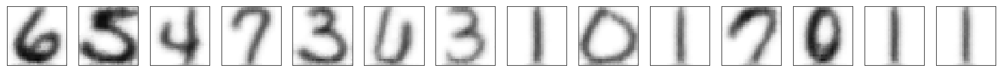

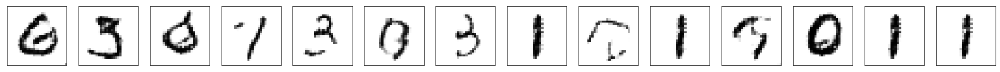

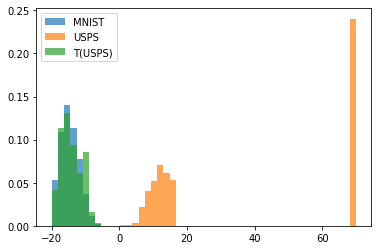

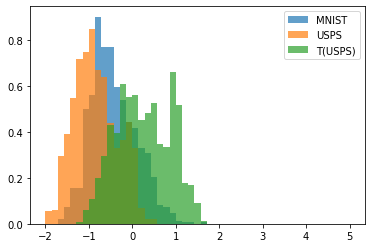

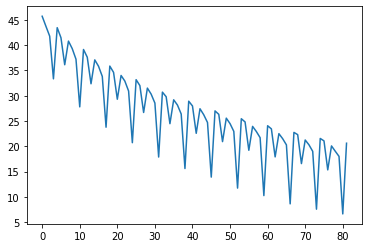

8300 tf.Tensor(20.069607170688222, shape=(), dtype=float64)
tf.Tensor(20.069607170688222, shape=(), dtype=float64)


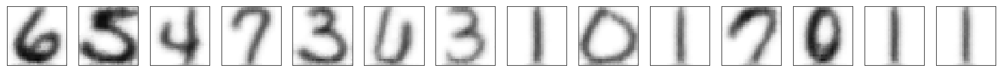

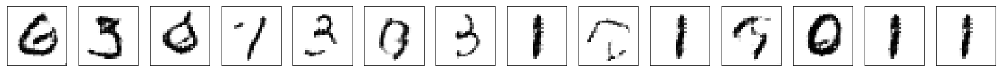

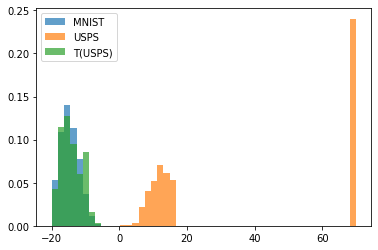

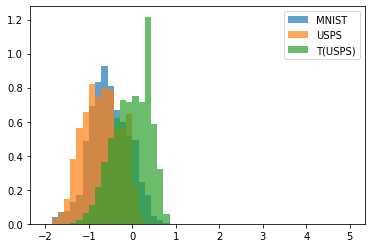

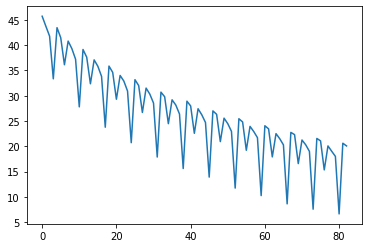

8400 tf.Tensor(14.276210464831546, shape=(), dtype=float64)
tf.Tensor(14.276210464831546, shape=(), dtype=float64)


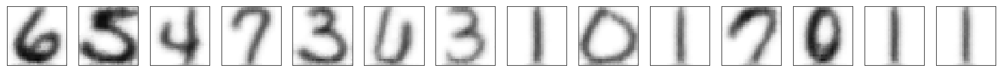

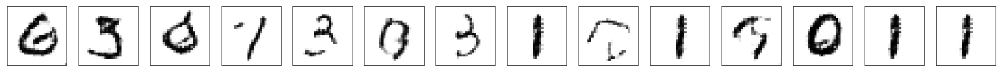

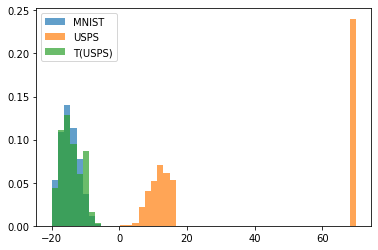

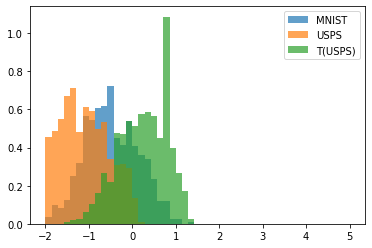

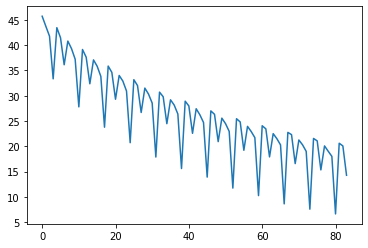

8500 tf.Tensor(18.995672101705, shape=(), dtype=float64)
tf.Tensor(18.995672101705, shape=(), dtype=float64)


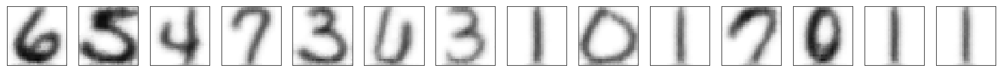

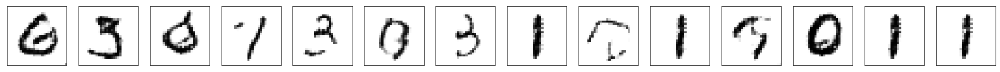

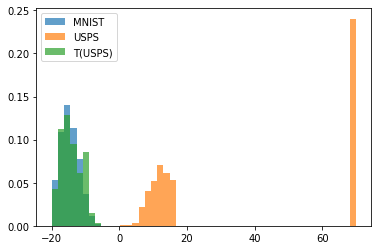

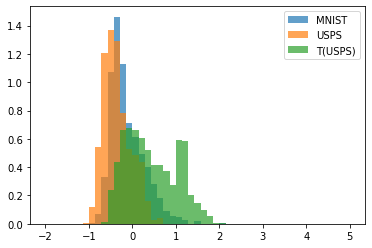

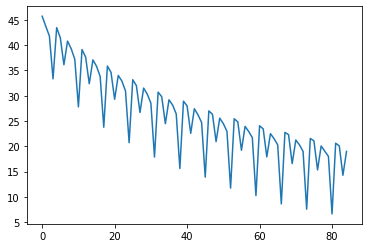

8600 tf.Tensor(17.89583230578289, shape=(), dtype=float64)
tf.Tensor(17.89583230578289, shape=(), dtype=float64)


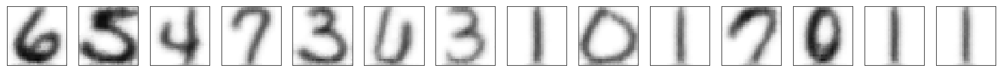

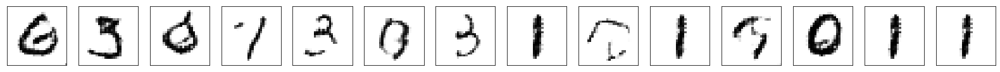

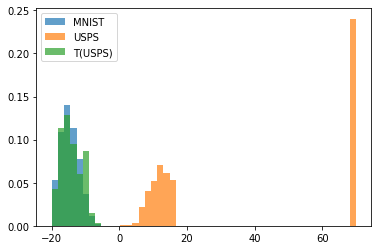

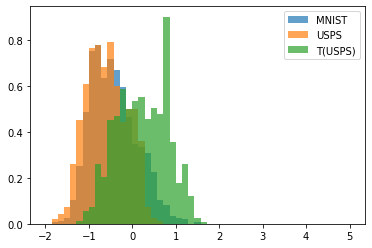

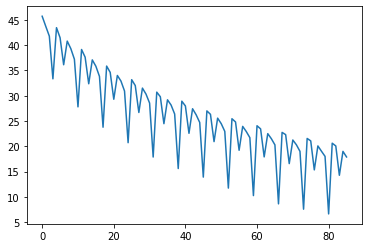

8700 tf.Tensor(16.88380173641403, shape=(), dtype=float64)
tf.Tensor(16.88380173641403, shape=(), dtype=float64)


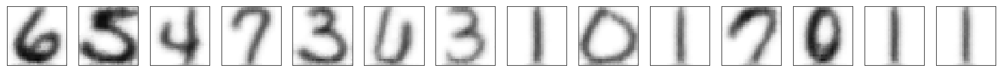

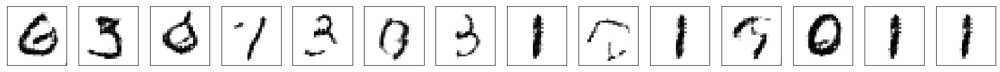

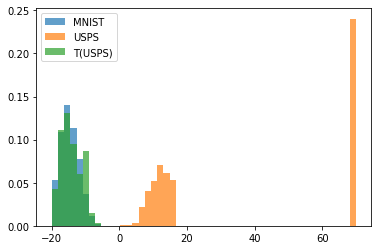

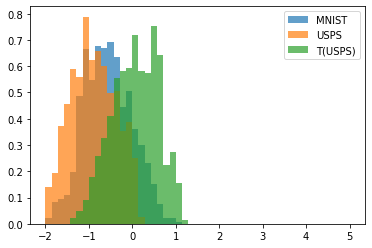

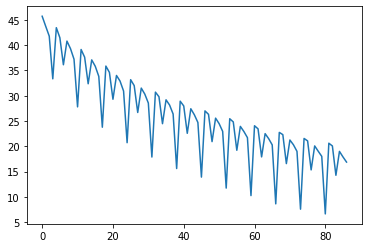

8800 tf.Tensor(5.329465941855599, shape=(), dtype=float64)
tf.Tensor(5.329465941855599, shape=(), dtype=float64)


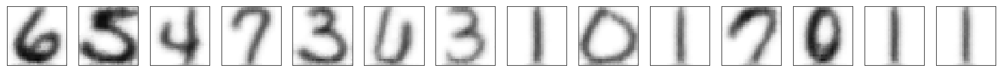

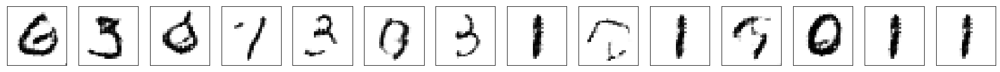

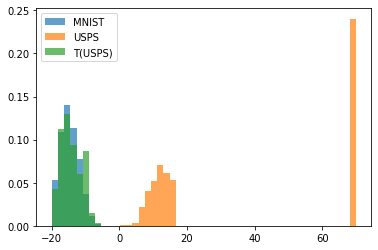

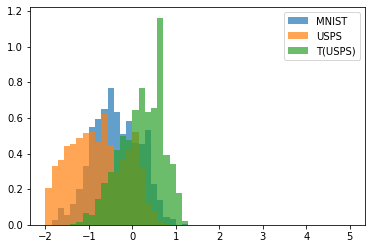

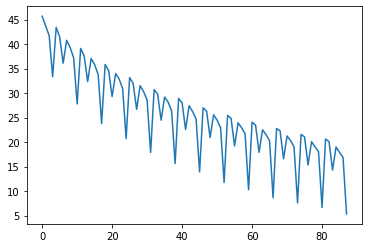

8900 tf.Tensor(19.734419120008898, shape=(), dtype=float64)
tf.Tensor(19.734419120008898, shape=(), dtype=float64)


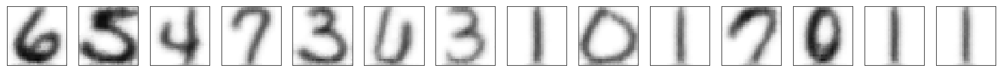

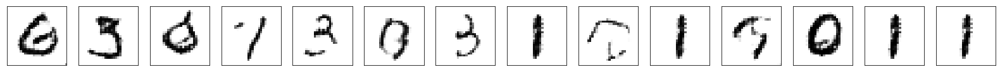

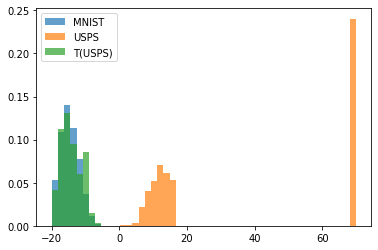

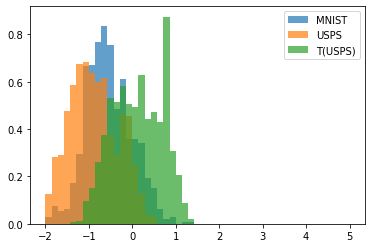

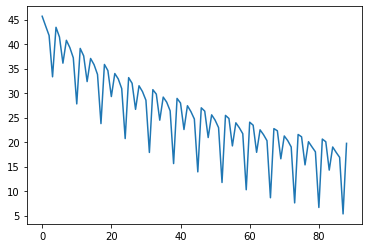

9000 tf.Tensor(19.08418371021655, shape=(), dtype=float64)
tf.Tensor(19.08418371021655, shape=(), dtype=float64)


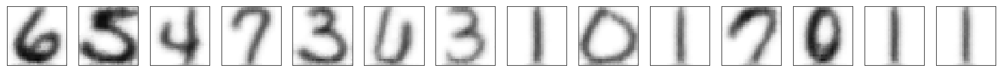

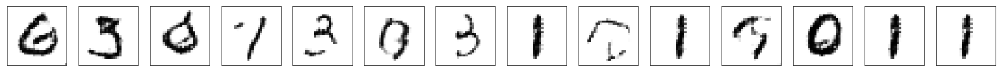

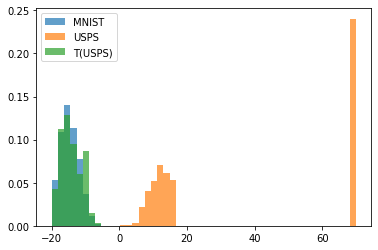

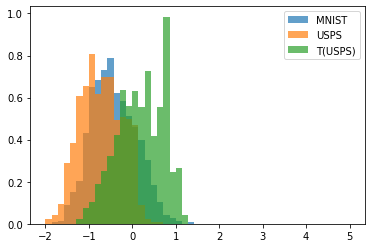

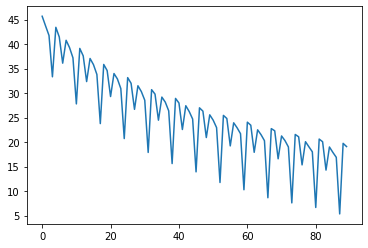

saving weights
9100 tf.Tensor(13.284692443356228, shape=(), dtype=float64)
tf.Tensor(13.284692443356228, shape=(), dtype=float64)


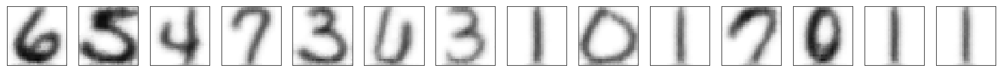

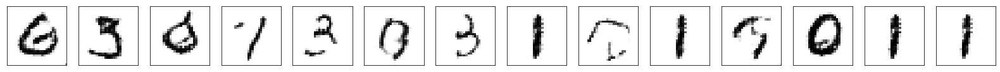

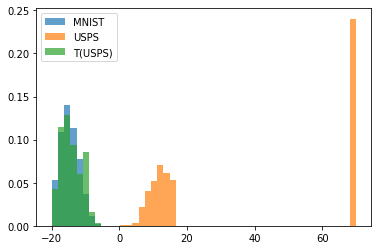

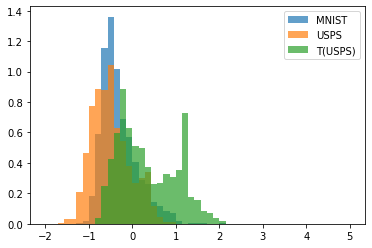

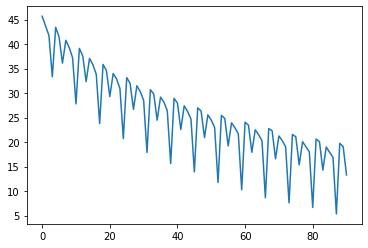

9200 tf.Tensor(18.002809067221314, shape=(), dtype=float64)
tf.Tensor(18.002809067221314, shape=(), dtype=float64)


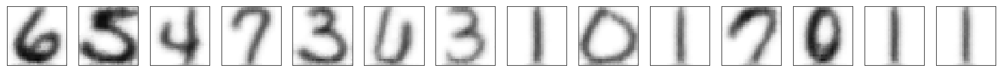

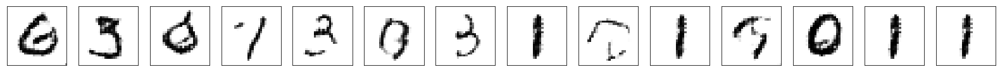

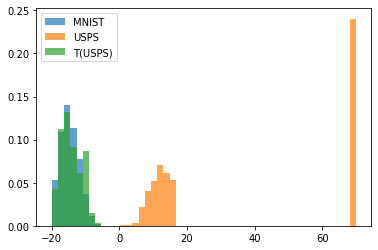

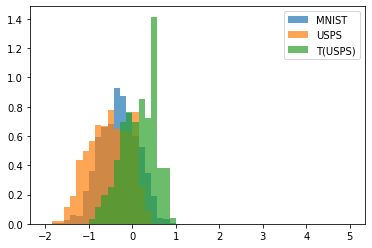

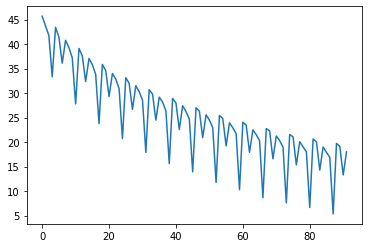

9300 tf.Tensor(16.851310772933637, shape=(), dtype=float64)
tf.Tensor(16.851310772933637, shape=(), dtype=float64)


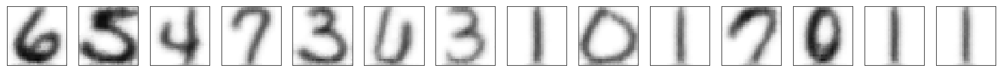

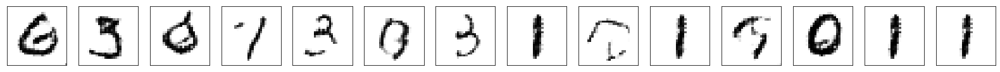

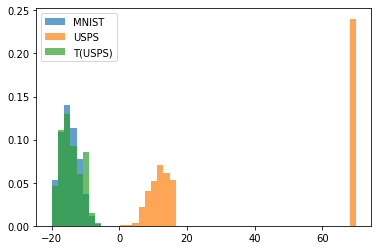

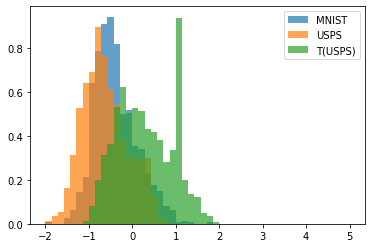

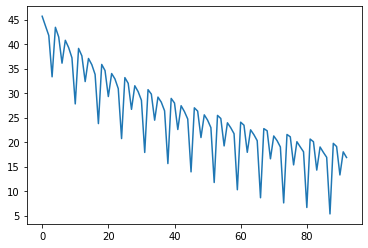

9400 tf.Tensor(16.06087326915653, shape=(), dtype=float64)
tf.Tensor(16.06087326915653, shape=(), dtype=float64)


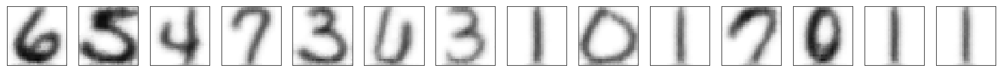

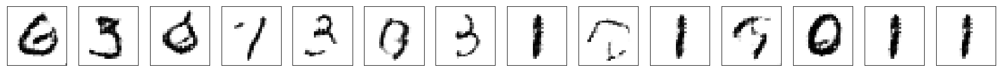

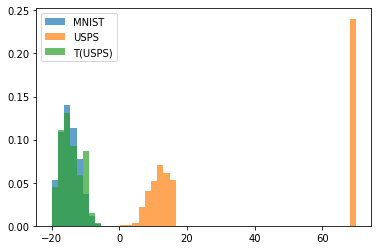

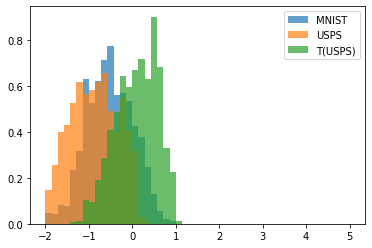

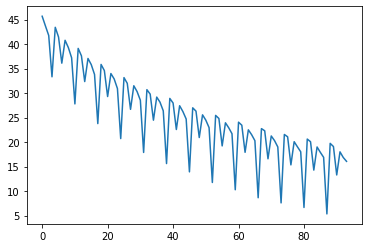

9500 tf.Tensor(4.051096155772978, shape=(), dtype=float64)
tf.Tensor(4.051096155772978, shape=(), dtype=float64)


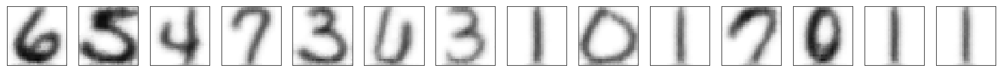

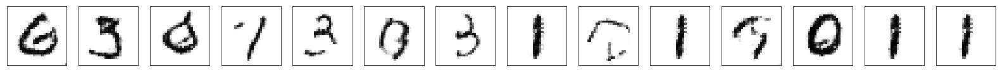

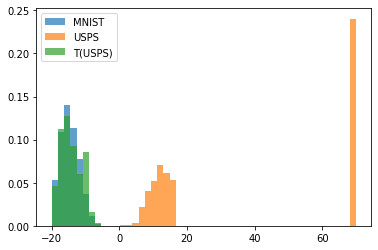

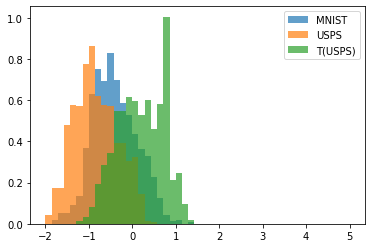

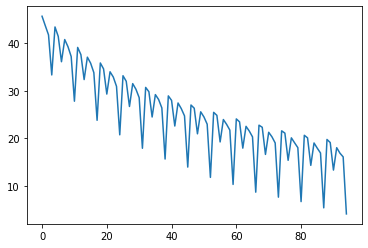

9600 tf.Tensor(18.671203045116286, shape=(), dtype=float64)
tf.Tensor(18.671203045116286, shape=(), dtype=float64)


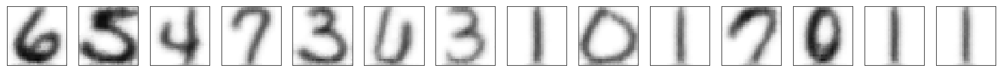

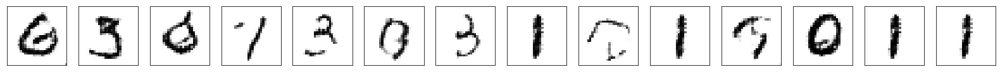

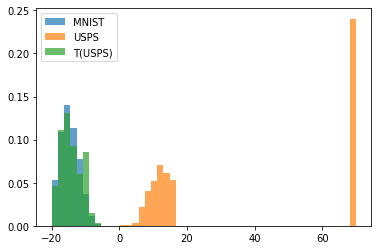

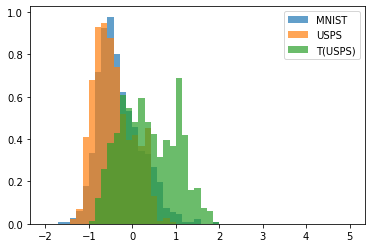

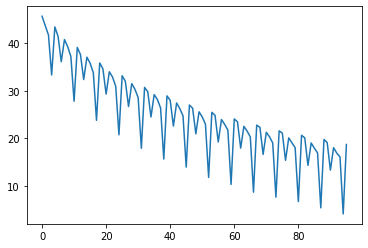

9700 tf.Tensor(18.16339294047291, shape=(), dtype=float64)
tf.Tensor(18.16339294047291, shape=(), dtype=float64)


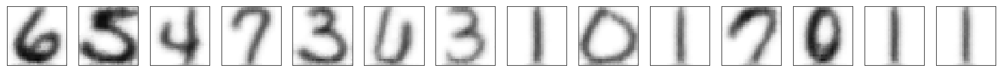

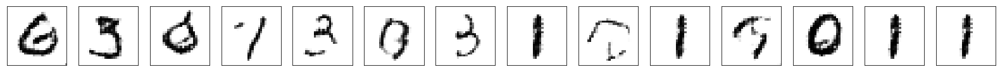

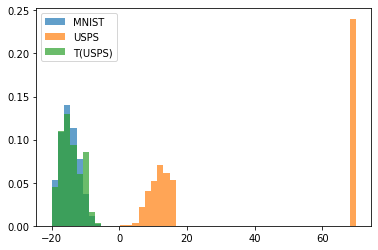

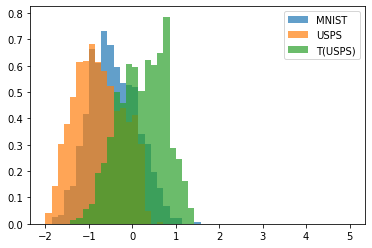

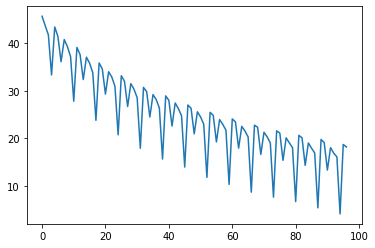

9800 tf.Tensor(12.513059313736765, shape=(), dtype=float64)
tf.Tensor(12.513059313736765, shape=(), dtype=float64)


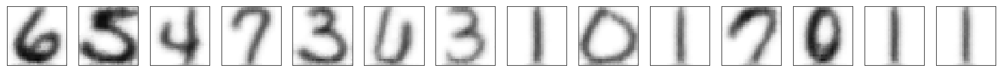

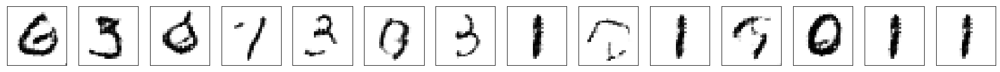

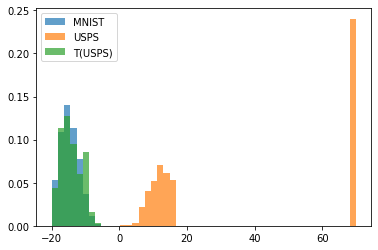

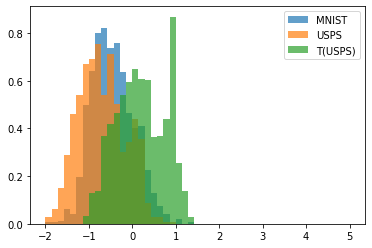

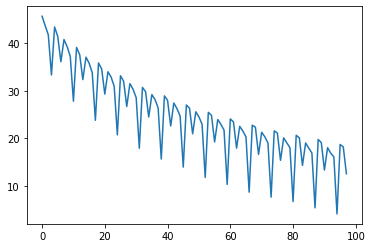

9900 tf.Tensor(17.185119605070216, shape=(), dtype=float64)
tf.Tensor(17.185119605070216, shape=(), dtype=float64)


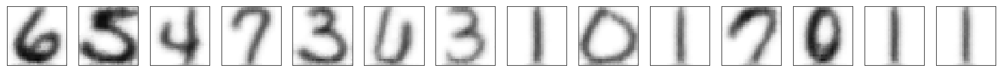

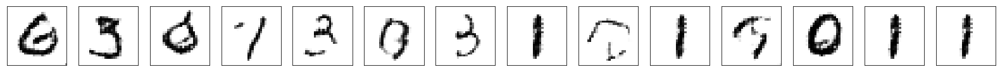

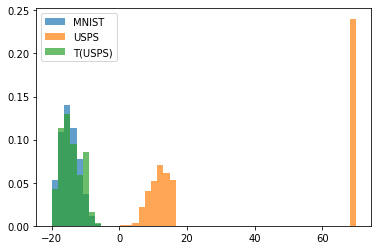

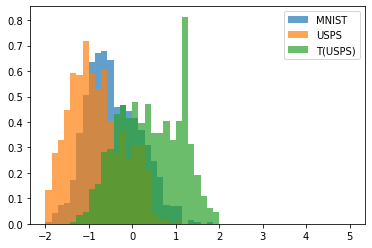

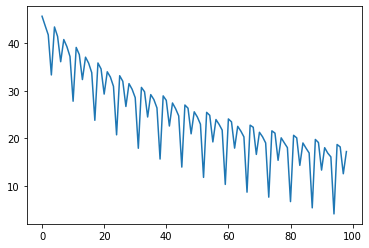

10000 tf.Tensor(16.100016992341068, shape=(), dtype=float64)
tf.Tensor(16.100016992341068, shape=(), dtype=float64)


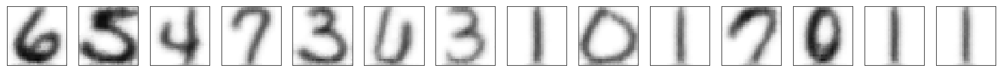

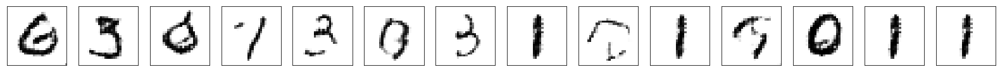

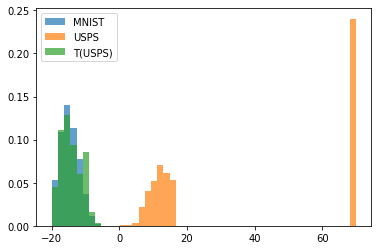

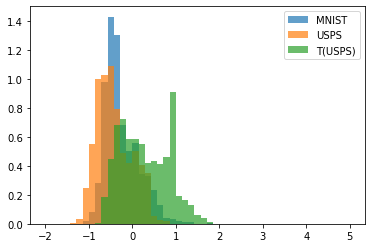

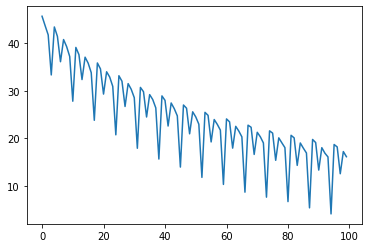

saving weights
10100 tf.Tensor(15.243234710659927, shape=(), dtype=float64)
tf.Tensor(15.243234710659927, shape=(), dtype=float64)


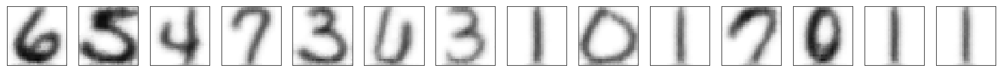

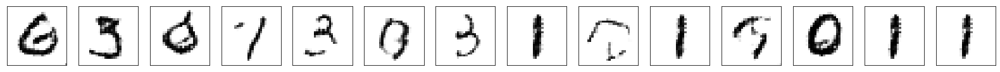

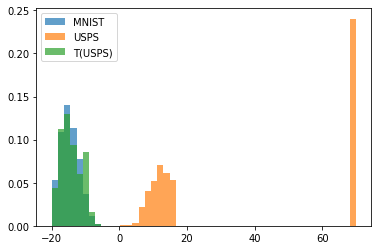

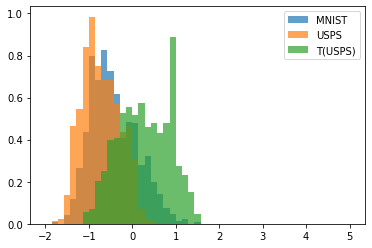

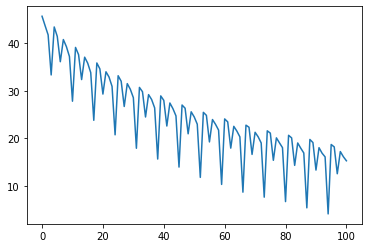

10200 tf.Tensor(3.4008295551518515, shape=(), dtype=float64)
tf.Tensor(3.4008295551518515, shape=(), dtype=float64)


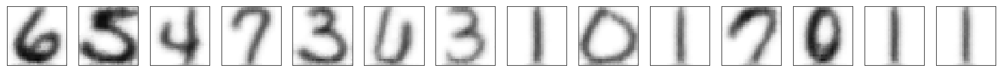

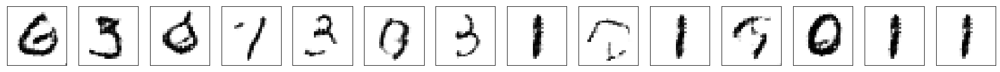

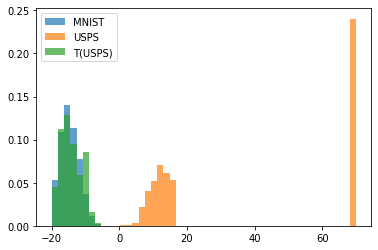

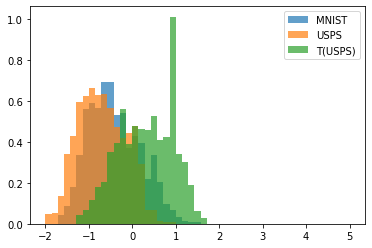

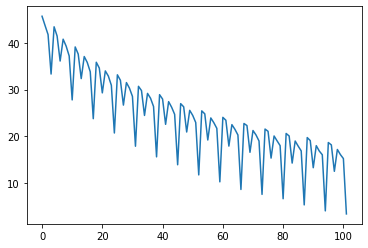

10300 tf.Tensor(17.827727285222792, shape=(), dtype=float64)
tf.Tensor(17.827727285222792, shape=(), dtype=float64)


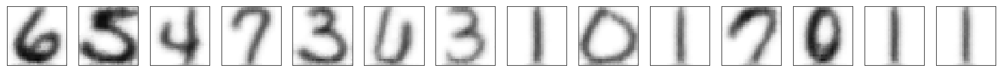

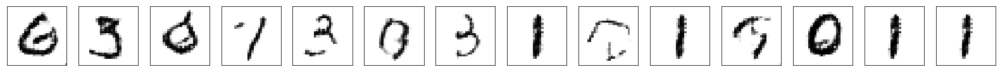

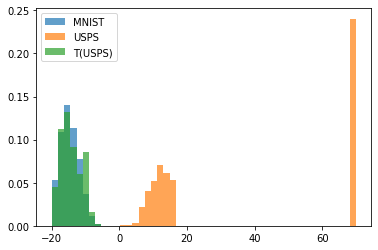

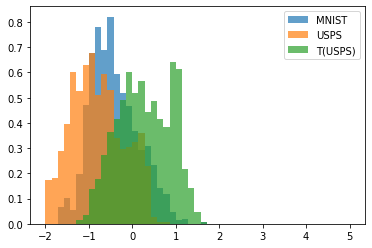

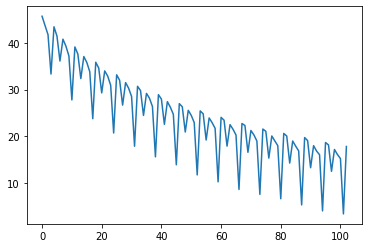

10400 tf.Tensor(17.478376972120437, shape=(), dtype=float64)
tf.Tensor(17.478376972120437, shape=(), dtype=float64)


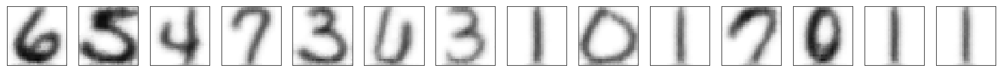

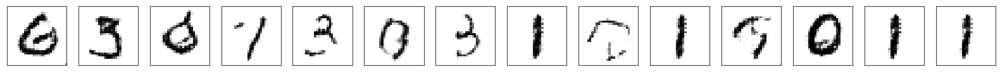

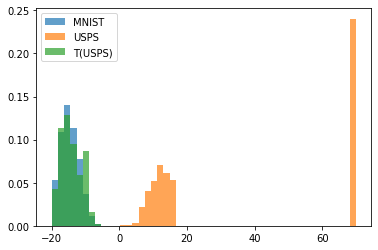

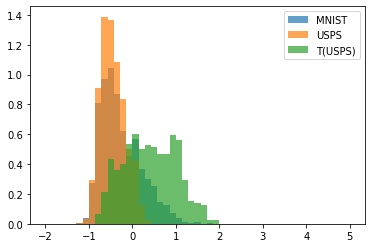

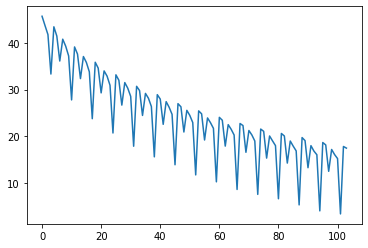

10500 tf.Tensor(11.691509355263737, shape=(), dtype=float64)
tf.Tensor(11.691509355263737, shape=(), dtype=float64)


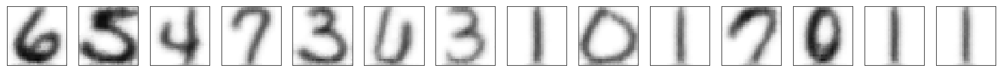

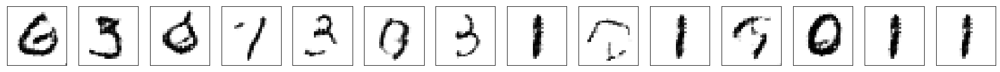

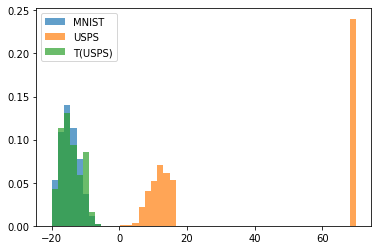

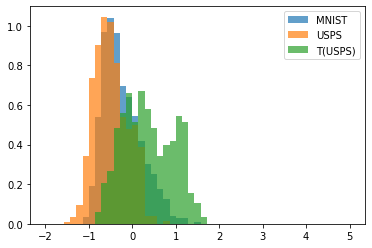

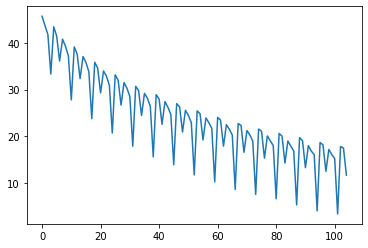

10600 tf.Tensor(16.435259732294117, shape=(), dtype=float64)
tf.Tensor(16.435259732294117, shape=(), dtype=float64)


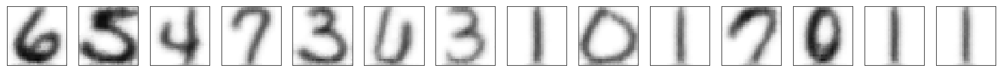

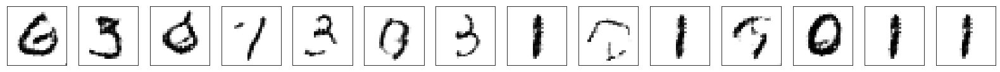

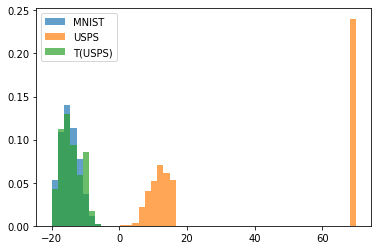

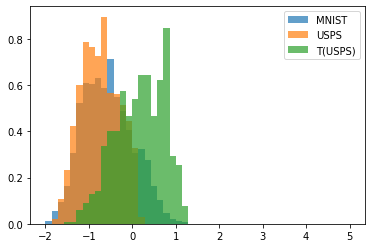

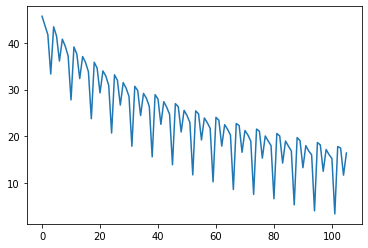

10700 tf.Tensor(15.108671151518003, shape=(), dtype=float64)
tf.Tensor(15.108671151518003, shape=(), dtype=float64)


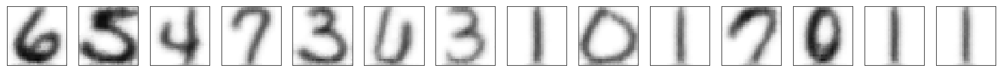

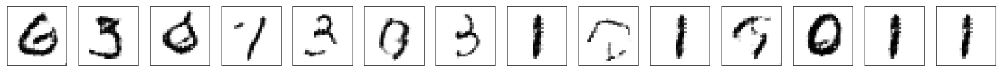

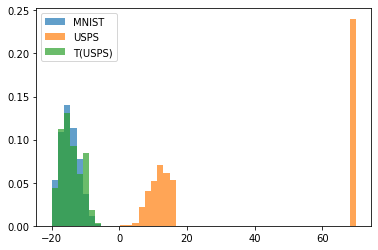

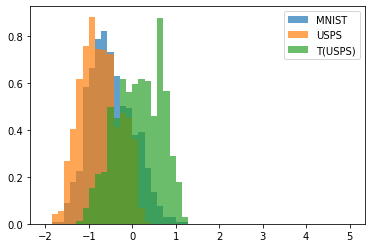

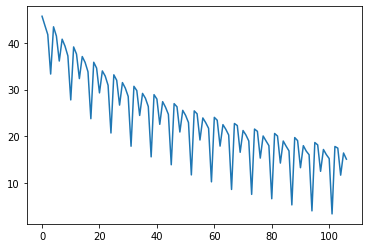

10800 tf.Tensor(14.173446414608556, shape=(), dtype=float64)
tf.Tensor(14.173446414608556, shape=(), dtype=float64)


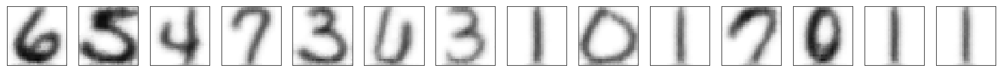

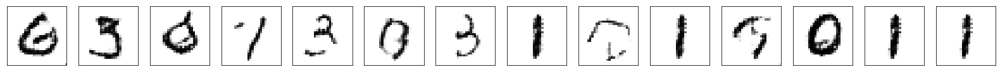

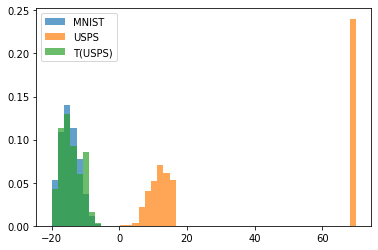

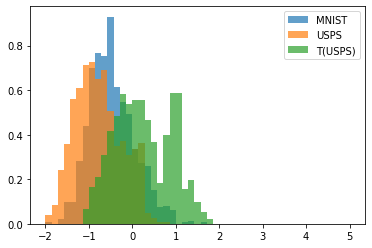

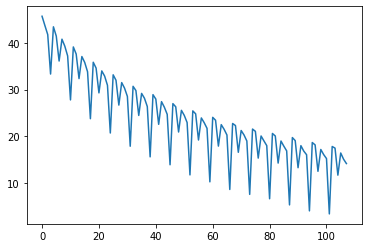

10900 tf.Tensor(2.2408966224320075, shape=(), dtype=float64)
tf.Tensor(2.2408966224320075, shape=(), dtype=float64)


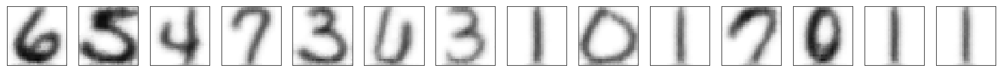

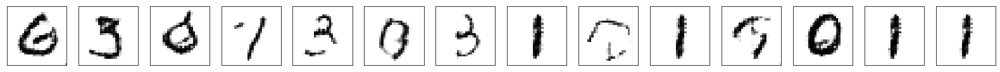

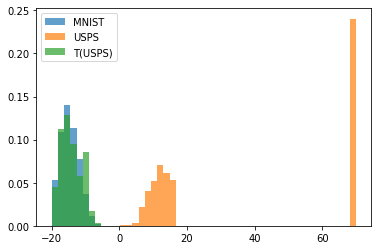

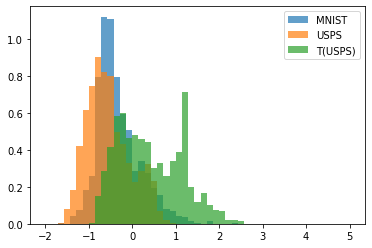

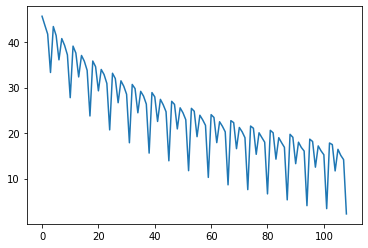

11000 tf.Tensor(17.045903076540068, shape=(), dtype=float64)
tf.Tensor(17.045903076540068, shape=(), dtype=float64)


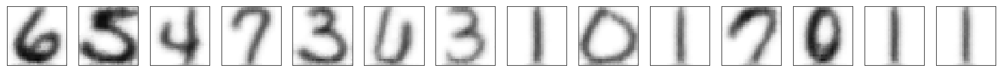

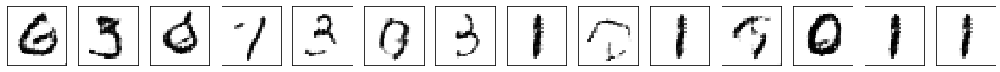

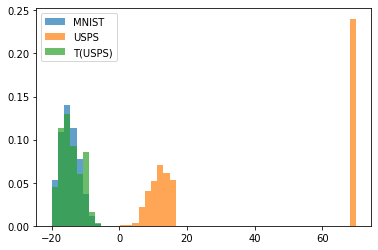

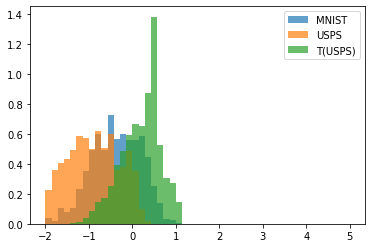

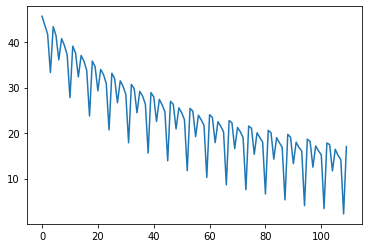

saving weights
11100 tf.Tensor(16.5406730111387, shape=(), dtype=float64)
tf.Tensor(16.5406730111387, shape=(), dtype=float64)


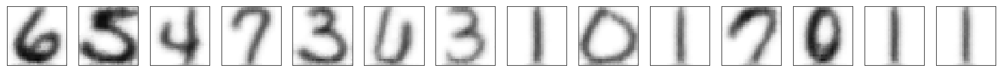

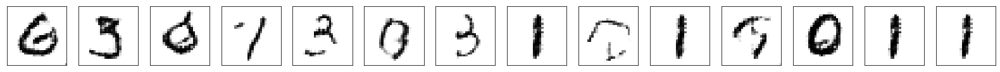

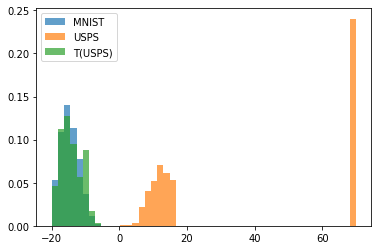

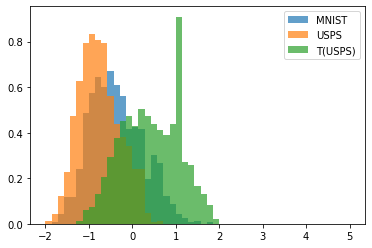

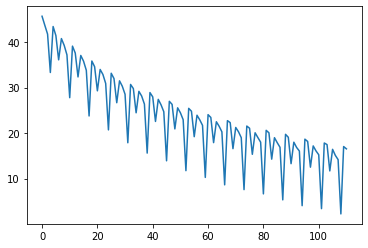

11200 tf.Tensor(10.791924367562572, shape=(), dtype=float64)
tf.Tensor(10.791924367562572, shape=(), dtype=float64)


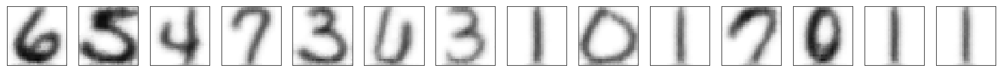

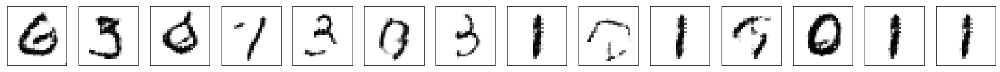

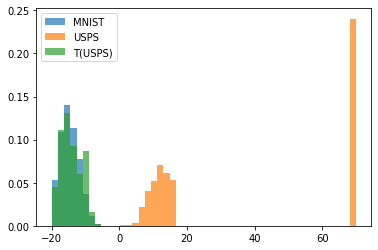

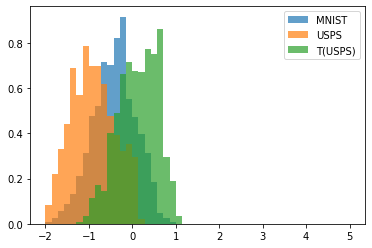

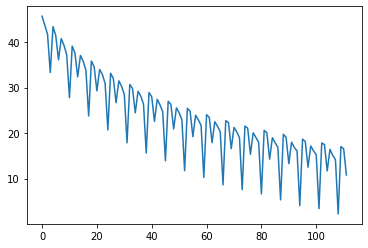

11300 tf.Tensor(15.65053901729587, shape=(), dtype=float64)
tf.Tensor(15.65053901729587, shape=(), dtype=float64)


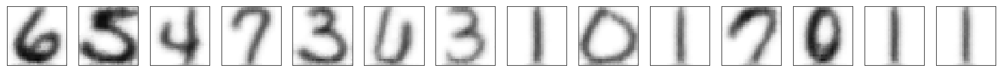

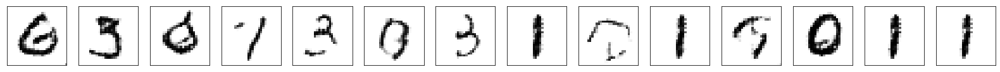

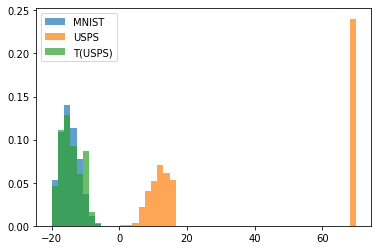

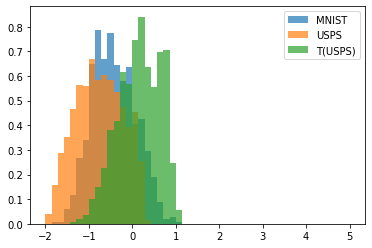

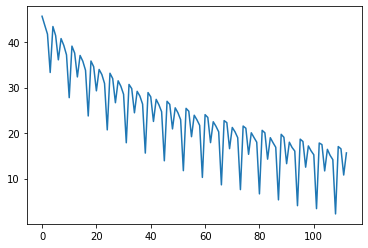

11400 tf.Tensor(14.139267830343776, shape=(), dtype=float64)
tf.Tensor(14.139267830343776, shape=(), dtype=float64)


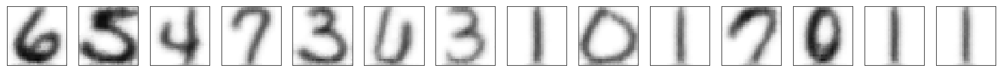

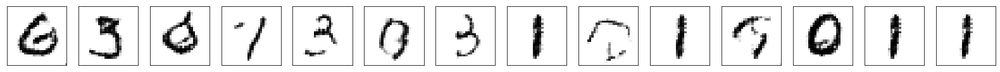

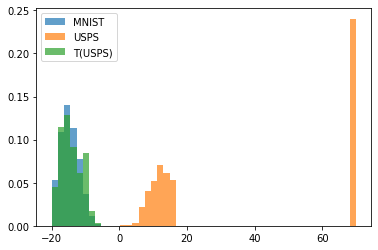

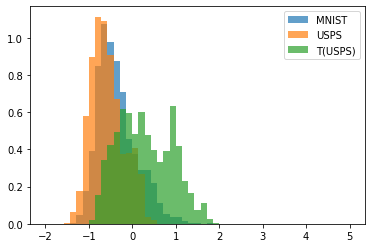

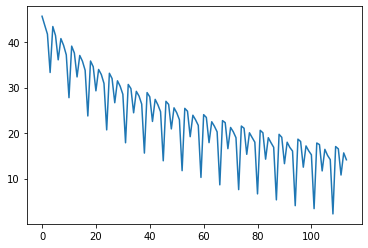

11500 tf.Tensor(14.234382654890116, shape=(), dtype=float64)
tf.Tensor(14.234382654890116, shape=(), dtype=float64)


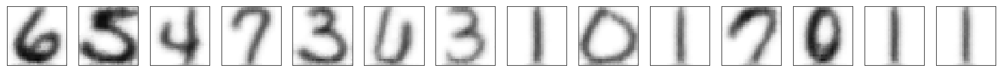

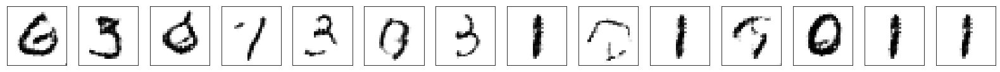

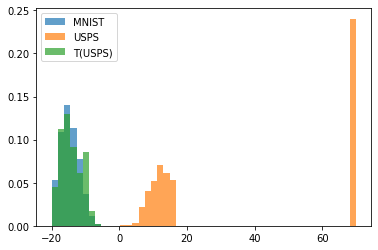

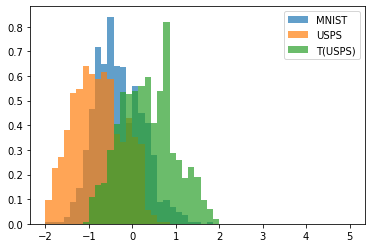

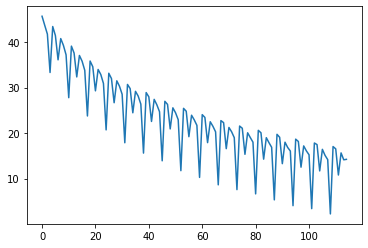

11600 tf.Tensor(1.8067033404682817, shape=(), dtype=float64)
tf.Tensor(1.8067033404682817, shape=(), dtype=float64)


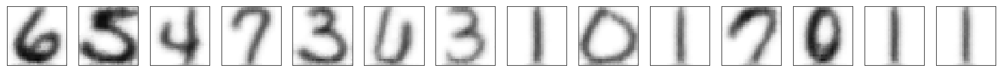

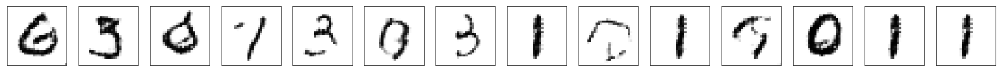

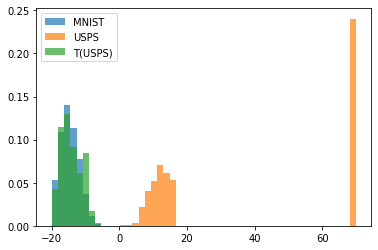

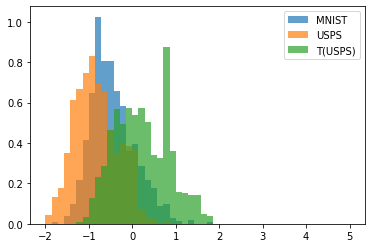

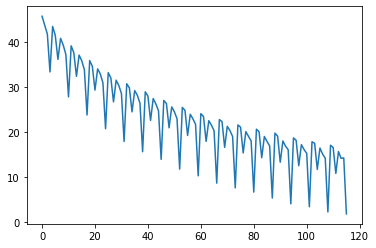

11700 tf.Tensor(16.528241536889617, shape=(), dtype=float64)
tf.Tensor(16.528241536889617, shape=(), dtype=float64)


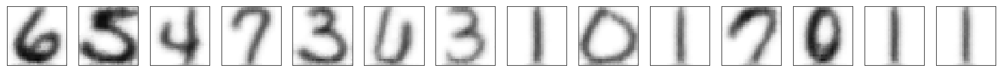

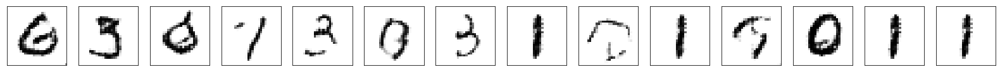

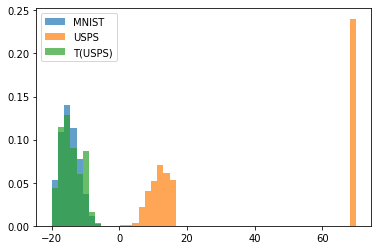

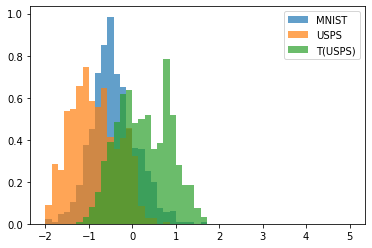

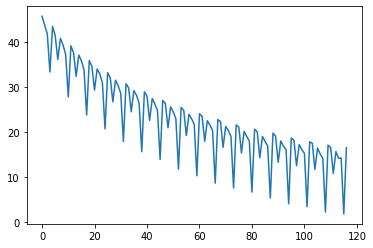

11800 tf.Tensor(15.8829876796038, shape=(), dtype=float64)
tf.Tensor(15.8829876796038, shape=(), dtype=float64)


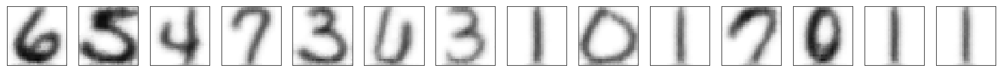

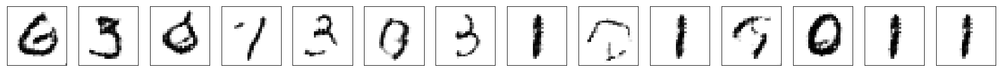

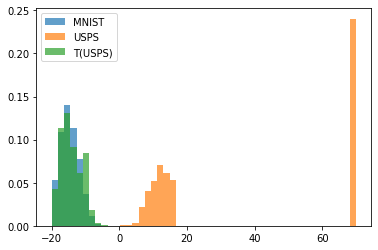

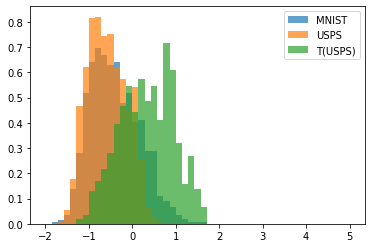

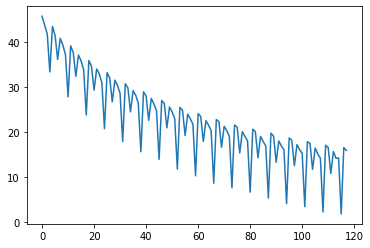

11900 tf.Tensor(10.08006167286635, shape=(), dtype=float64)
tf.Tensor(10.08006167286635, shape=(), dtype=float64)


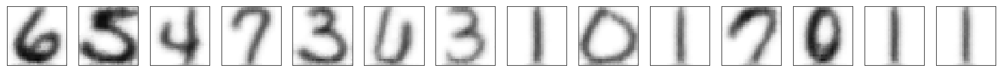

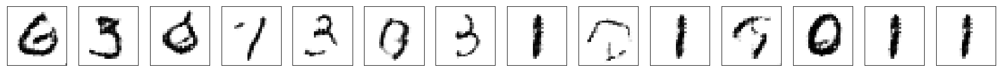

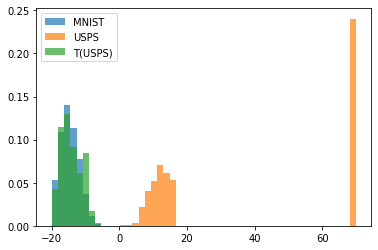

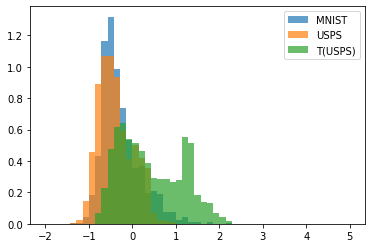

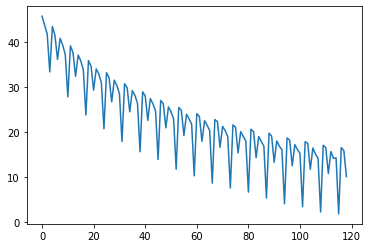

12000 tf.Tensor(14.849426768681084, shape=(), dtype=float64)
tf.Tensor(14.849426768681084, shape=(), dtype=float64)


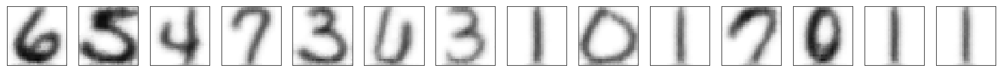

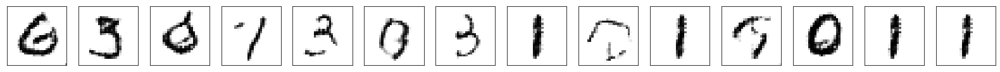

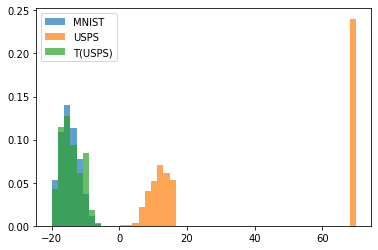

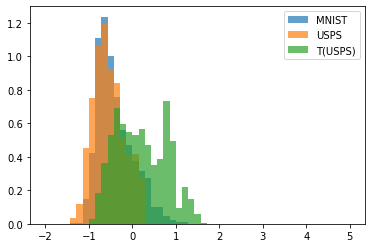

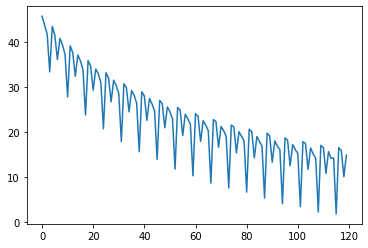

saving weights
12100 tf.Tensor(13.372159740841226, shape=(), dtype=float64)
tf.Tensor(13.372159740841226, shape=(), dtype=float64)


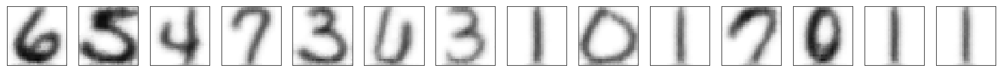

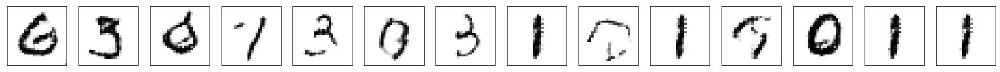

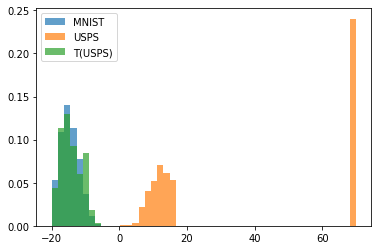

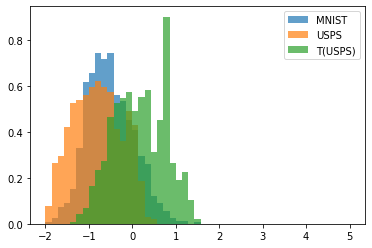

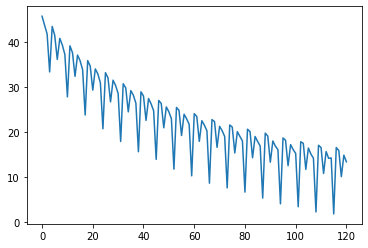

12200 tf.Tensor(13.303731529714664, shape=(), dtype=float64)
tf.Tensor(13.303731529714664, shape=(), dtype=float64)


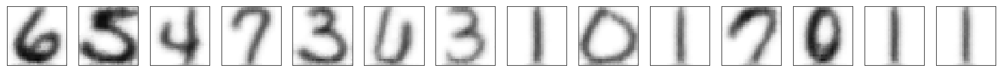

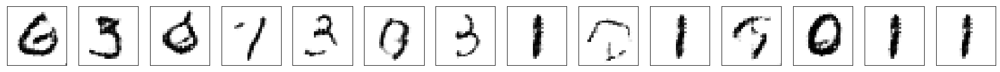

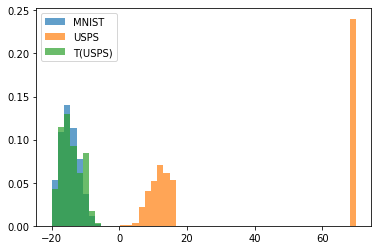

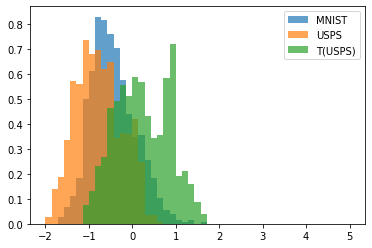

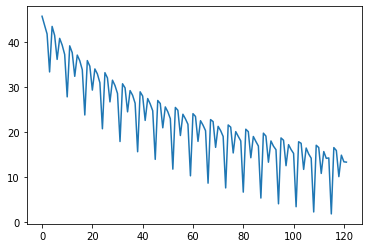

12300 tf.Tensor(1.0988810531977684, shape=(), dtype=float64)
tf.Tensor(1.0988810531977684, shape=(), dtype=float64)


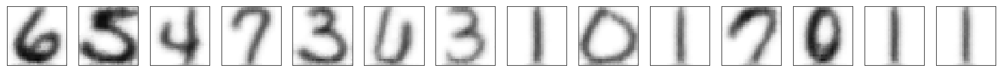

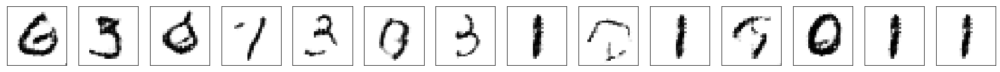

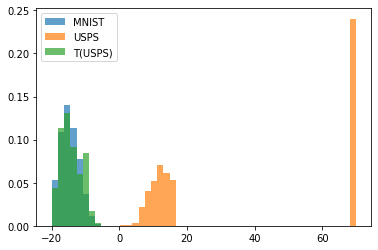

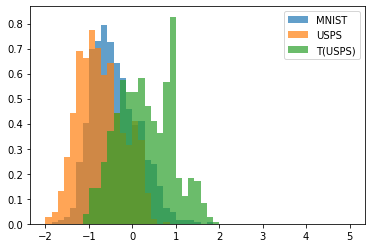

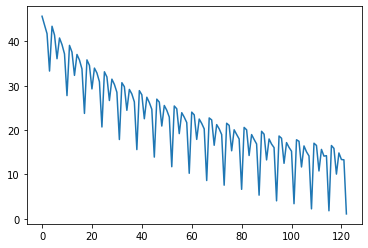

12400 tf.Tensor(15.605317856208071, shape=(), dtype=float64)
tf.Tensor(15.605317856208071, shape=(), dtype=float64)


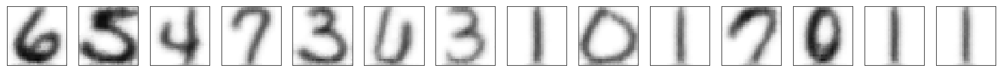

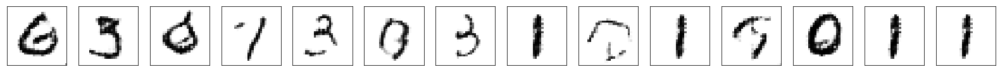

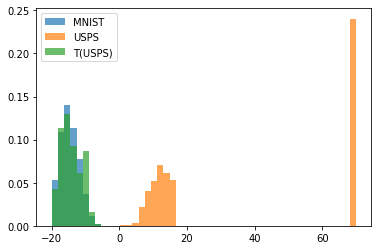

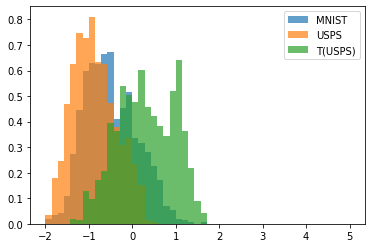

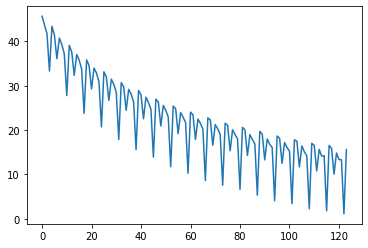

12500 tf.Tensor(15.380387121169306, shape=(), dtype=float64)
tf.Tensor(15.380387121169306, shape=(), dtype=float64)


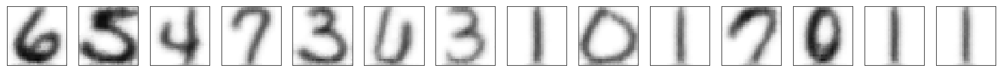

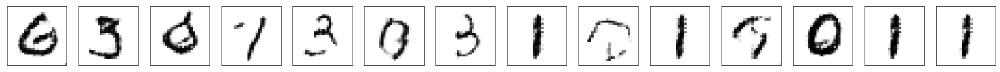

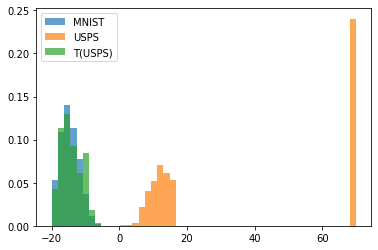

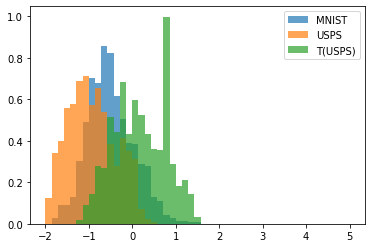

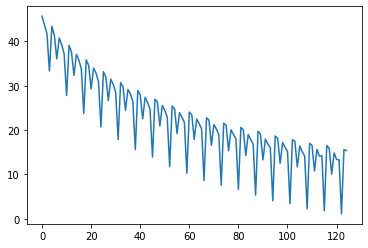

12600 tf.Tensor(9.301896585250063, shape=(), dtype=float64)
tf.Tensor(9.301896585250063, shape=(), dtype=float64)


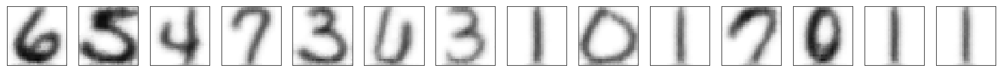

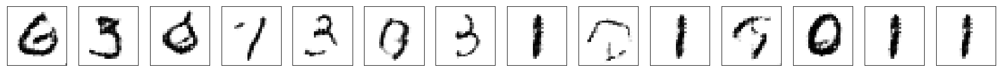

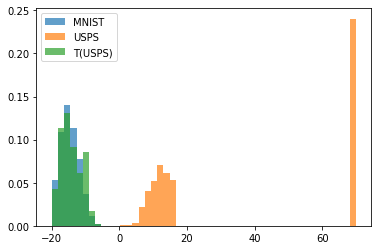

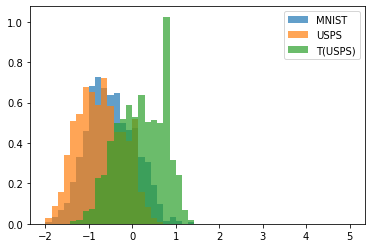

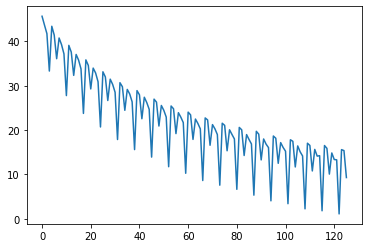

12700 tf.Tensor(14.119534398201573, shape=(), dtype=float64)
tf.Tensor(14.119534398201573, shape=(), dtype=float64)


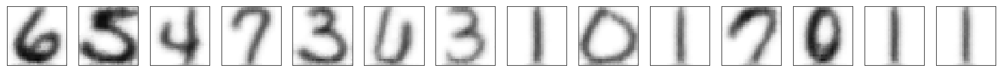

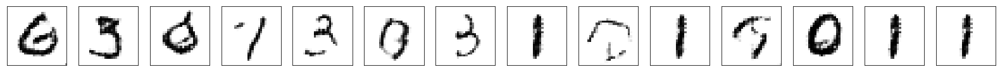

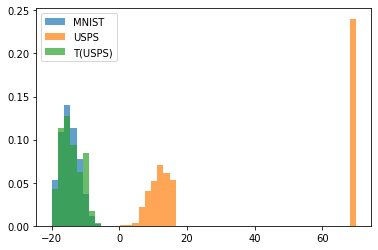

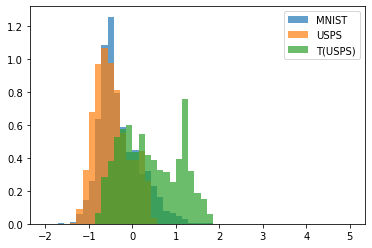

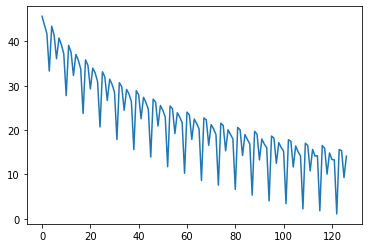

12800 tf.Tensor(12.672259598562281, shape=(), dtype=float64)
tf.Tensor(12.672259598562281, shape=(), dtype=float64)


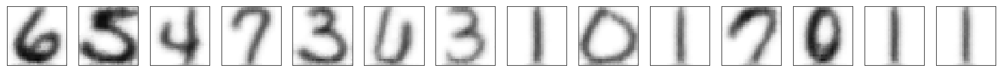

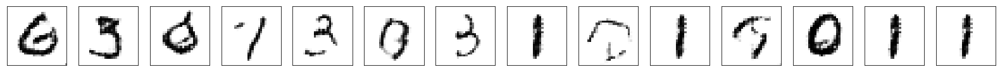

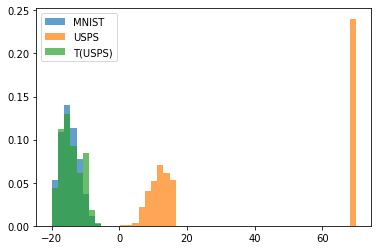

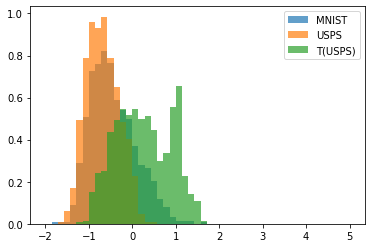

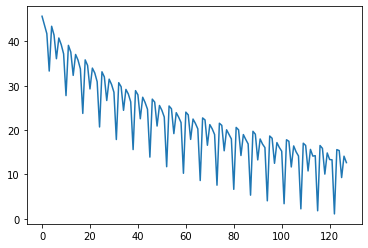

12900 tf.Tensor(12.037412746832246, shape=(), dtype=float64)
tf.Tensor(12.037412746832246, shape=(), dtype=float64)


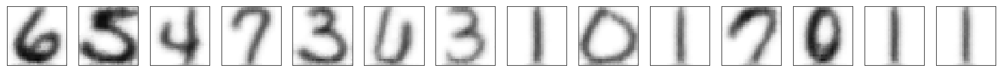

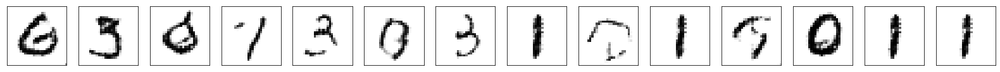

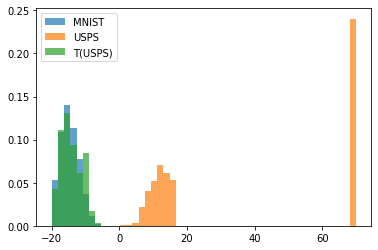

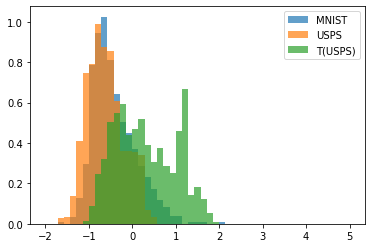

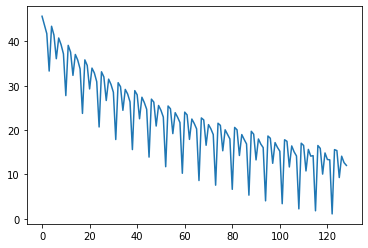

13000 tf.Tensor(0.5124467041154759, shape=(), dtype=float64)
tf.Tensor(0.5124467041154759, shape=(), dtype=float64)


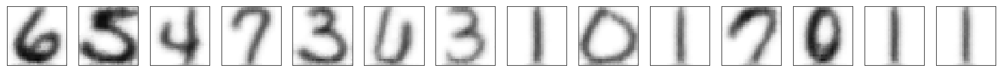

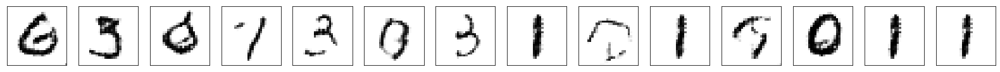

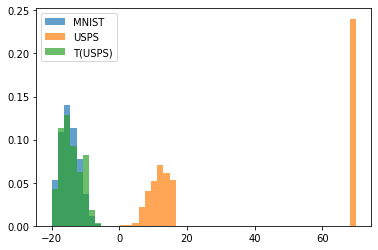

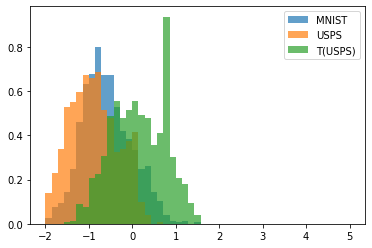

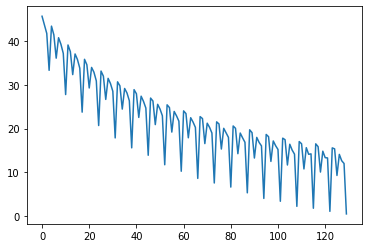

saving weights
13100 tf.Tensor(14.791796061728366, shape=(), dtype=float64)
tf.Tensor(14.791796061728366, shape=(), dtype=float64)


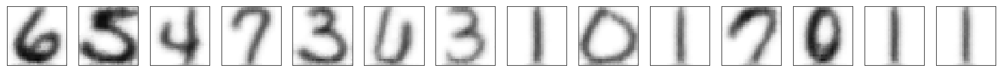

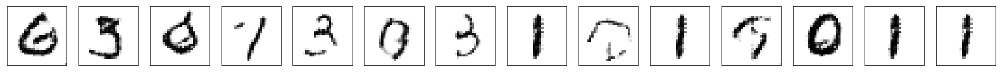

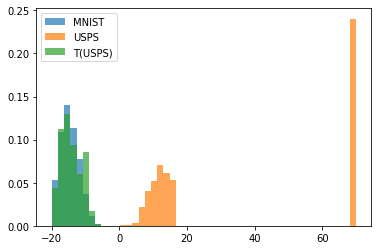

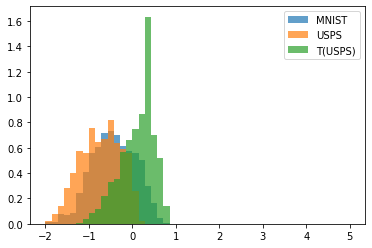

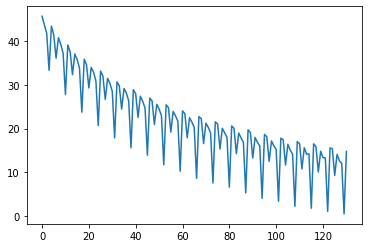

13200 tf.Tensor(14.271991001659405, shape=(), dtype=float64)
tf.Tensor(14.271991001659405, shape=(), dtype=float64)


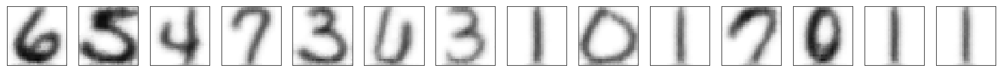

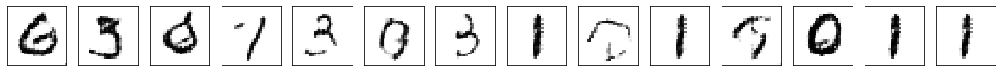

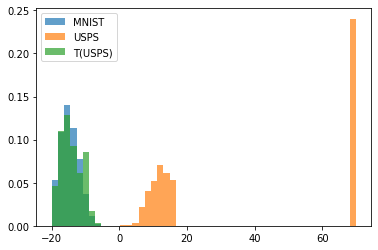

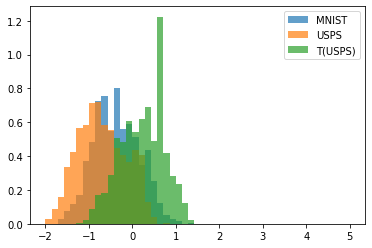

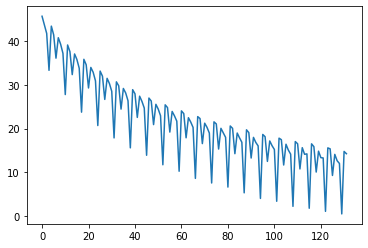

13300 tf.Tensor(8.555110960528538, shape=(), dtype=float64)
tf.Tensor(8.555110960528538, shape=(), dtype=float64)


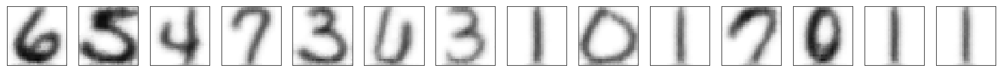

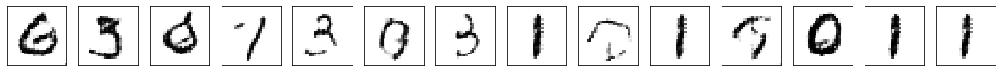

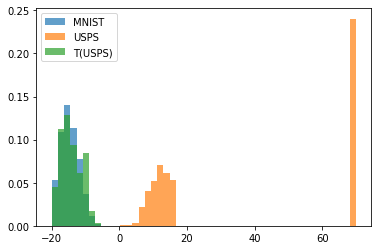

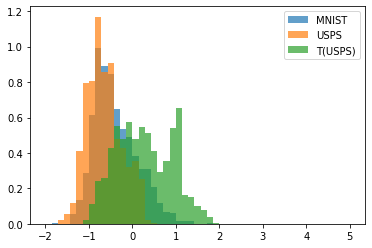

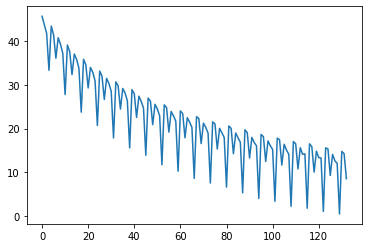

13400 tf.Tensor(13.740353421237408, shape=(), dtype=float64)
tf.Tensor(13.740353421237408, shape=(), dtype=float64)


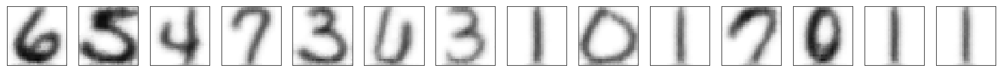

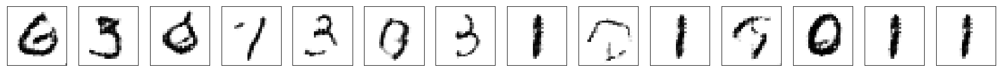

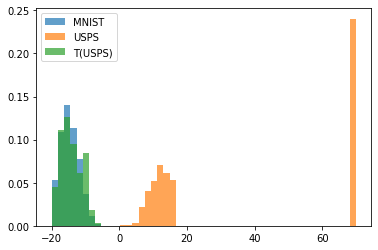

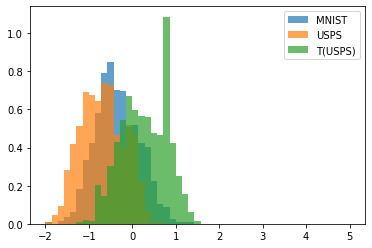

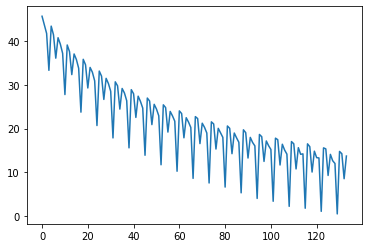

13500 tf.Tensor(12.35830119285384, shape=(), dtype=float64)
tf.Tensor(12.35830119285384, shape=(), dtype=float64)


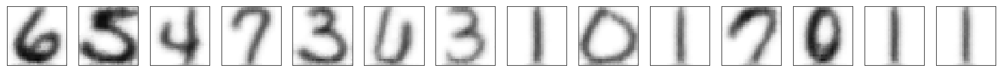

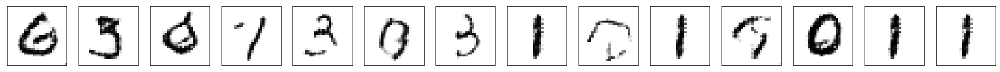

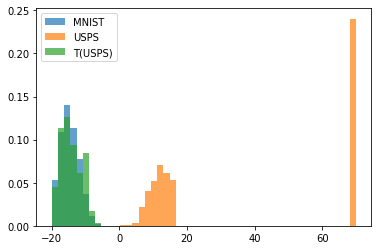

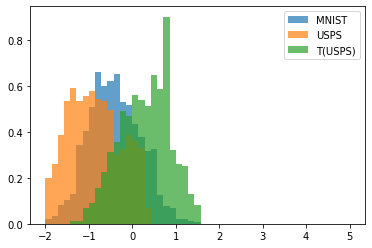

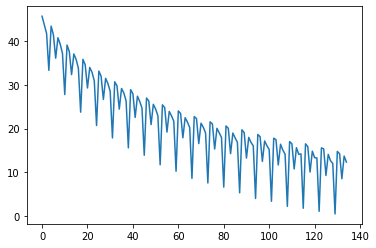

13600 tf.Tensor(11.939123744733603, shape=(), dtype=float64)
tf.Tensor(11.939123744733603, shape=(), dtype=float64)


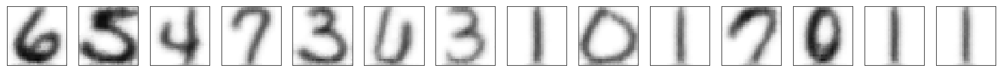

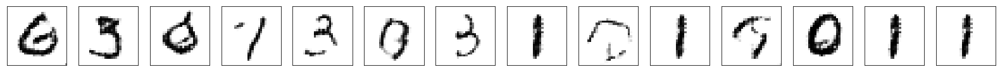

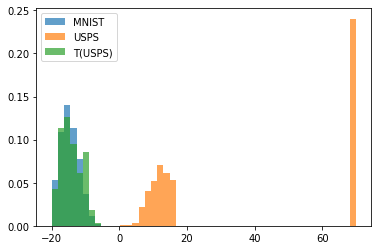

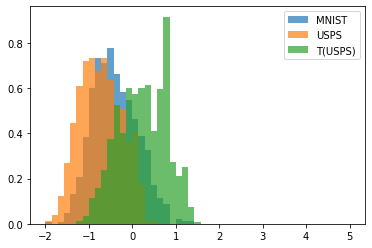

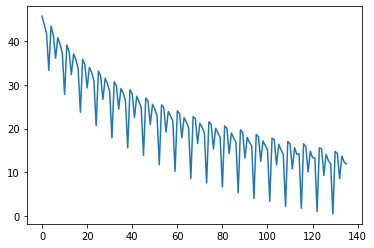

13700 tf.Tensor(-0.4360768504184698, shape=(), dtype=float64)
tf.Tensor(-0.4360768504184698, shape=(), dtype=float64)


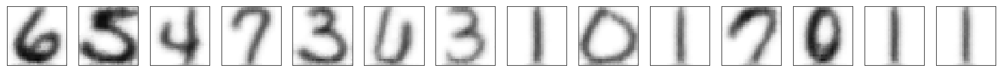

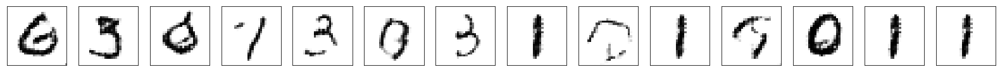

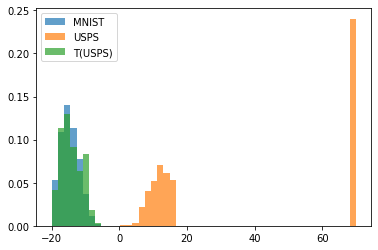

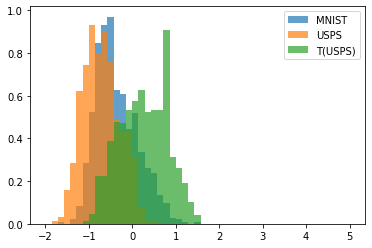

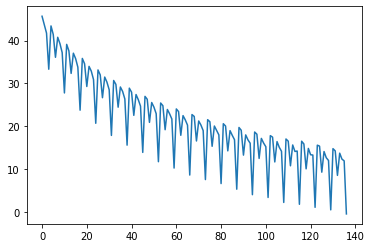

13800 tf.Tensor(14.201225362554663, shape=(), dtype=float64)
tf.Tensor(14.201225362554663, shape=(), dtype=float64)


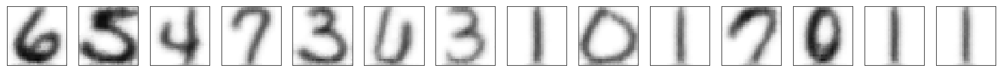

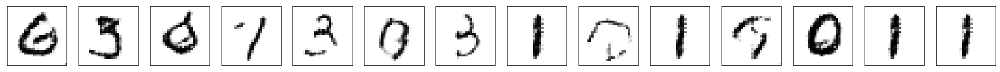

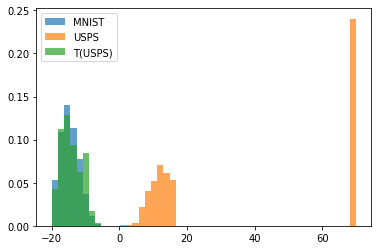

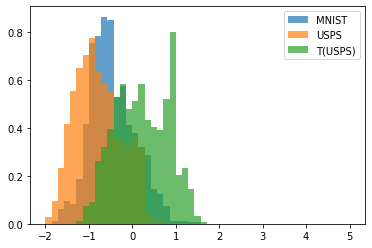

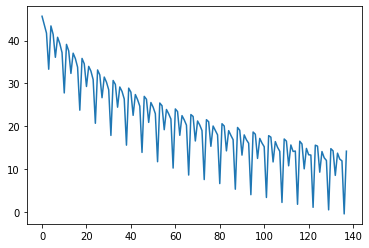

13900 tf.Tensor(13.832401377183078, shape=(), dtype=float64)
tf.Tensor(13.832401377183078, shape=(), dtype=float64)


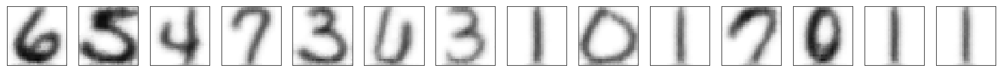

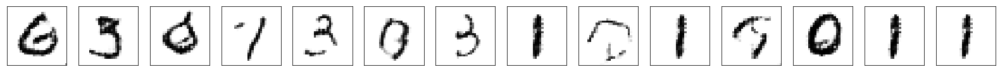

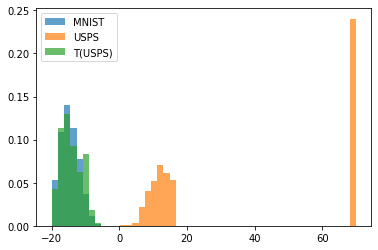

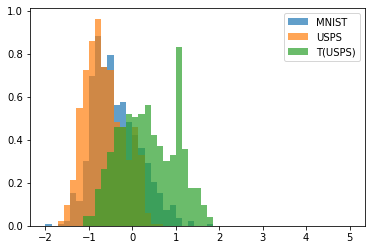

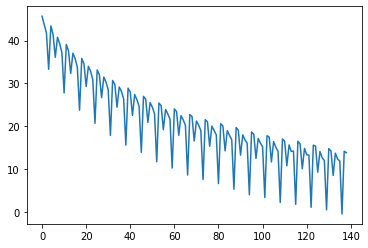

14000 tf.Tensor(8.648988542075891, shape=(), dtype=float64)
tf.Tensor(8.648988542075891, shape=(), dtype=float64)


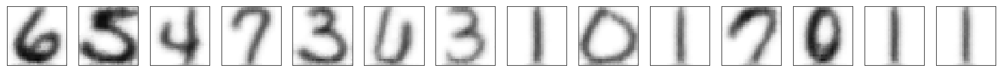

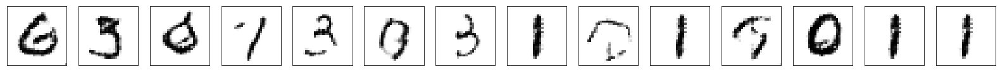

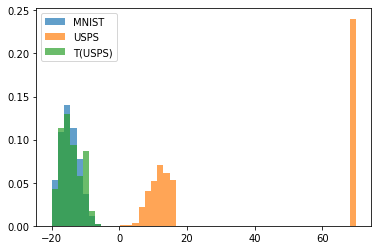

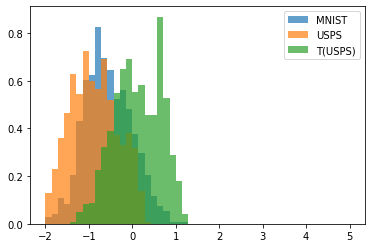

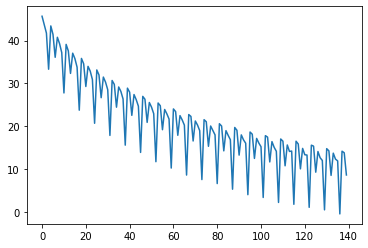

saving weights
14100 tf.Tensor(13.221714426511266, shape=(), dtype=float64)
tf.Tensor(13.221714426511266, shape=(), dtype=float64)


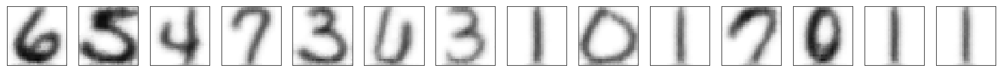

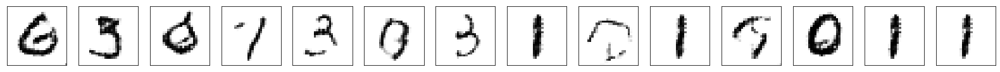

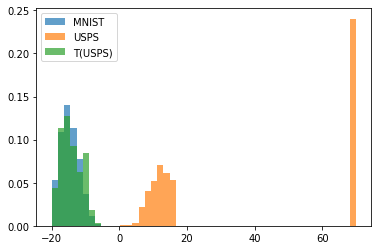

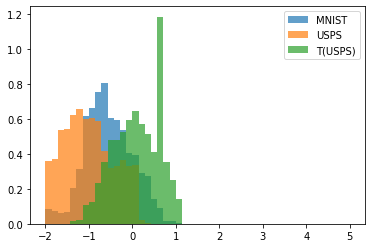

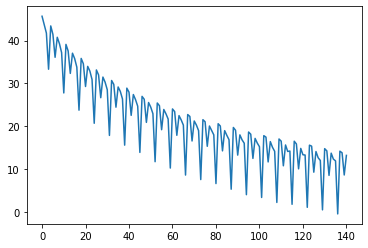

14200 tf.Tensor(11.454912839986672, shape=(), dtype=float64)
tf.Tensor(11.454912839986672, shape=(), dtype=float64)


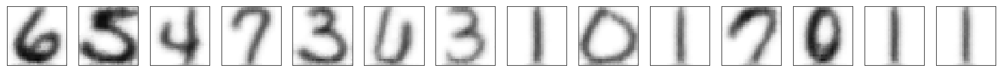

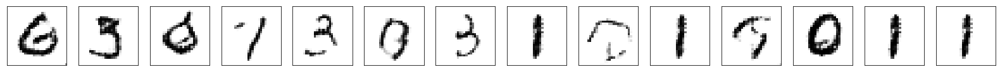

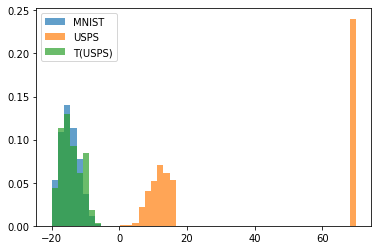

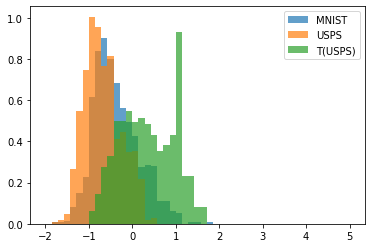

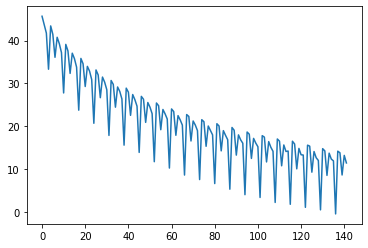

14300 tf.Tensor(11.271780315029964, shape=(), dtype=float64)
tf.Tensor(11.271780315029964, shape=(), dtype=float64)


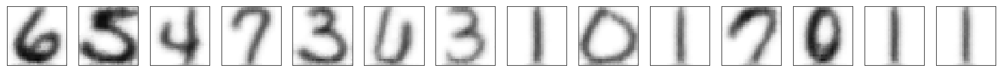

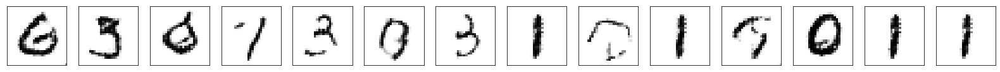

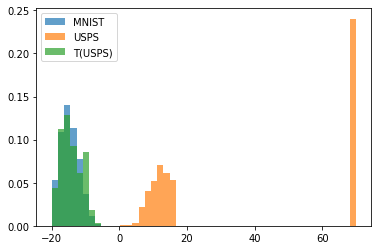

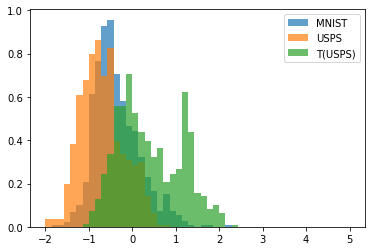

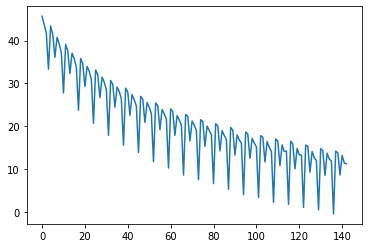

14400 tf.Tensor(-0.6091838141997137, shape=(), dtype=float64)
tf.Tensor(-0.6091838141997137, shape=(), dtype=float64)


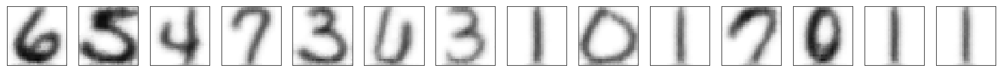

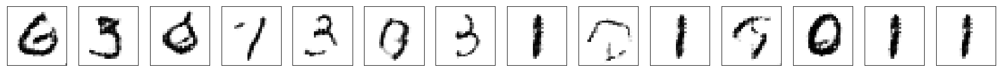

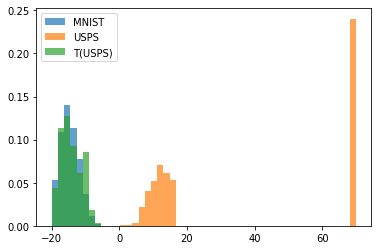

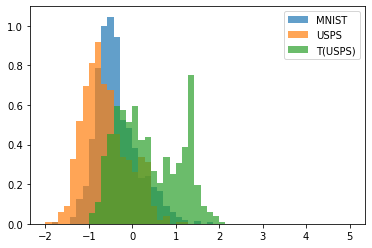

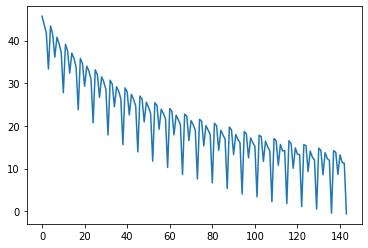

14500 tf.Tensor(13.862052911165087, shape=(), dtype=float64)
tf.Tensor(13.862052911165087, shape=(), dtype=float64)


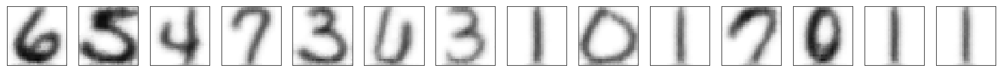

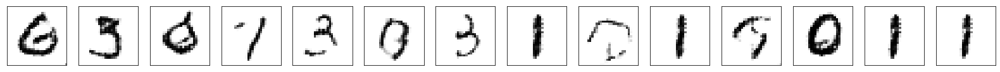

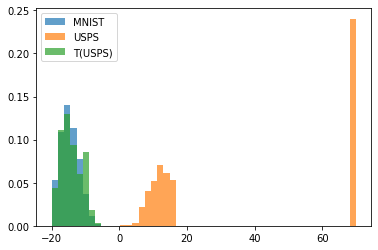

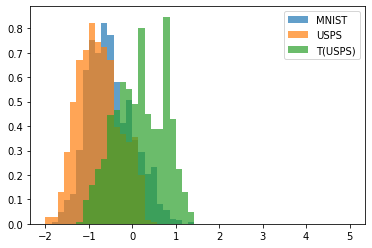

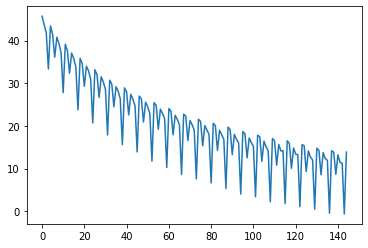

14600 tf.Tensor(13.153268145812696, shape=(), dtype=float64)
tf.Tensor(13.153268145812696, shape=(), dtype=float64)


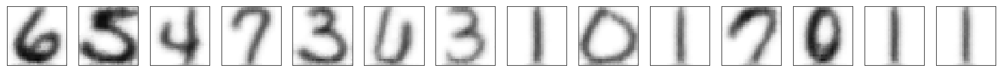

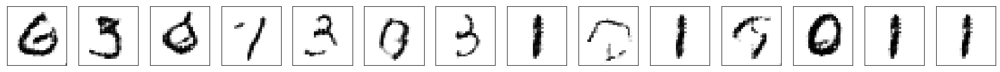

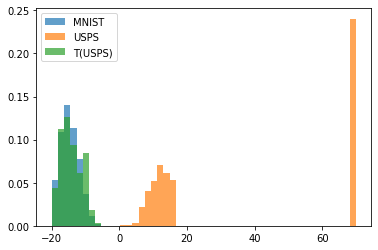

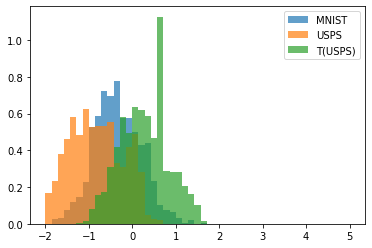

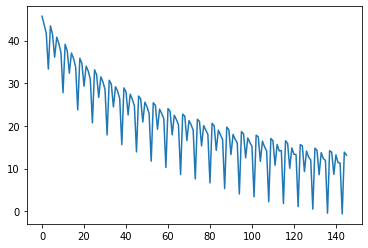

14700 tf.Tensor(7.317218419668524, shape=(), dtype=float64)
tf.Tensor(7.317218419668524, shape=(), dtype=float64)


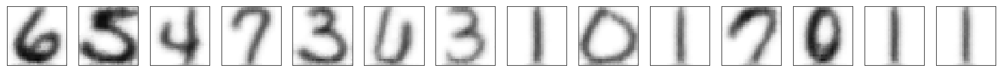

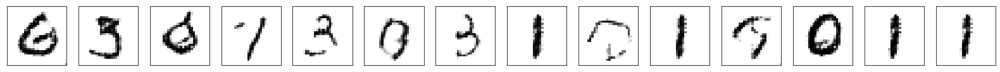

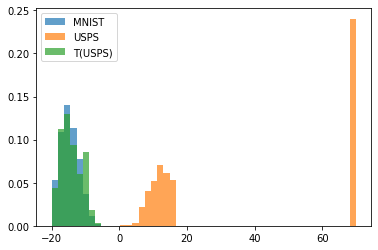

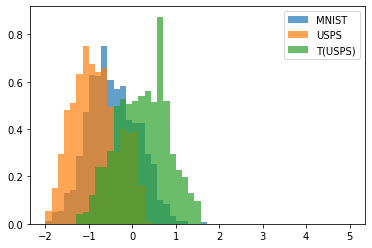

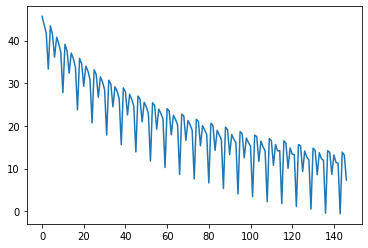

14800 tf.Tensor(12.132083262776547, shape=(), dtype=float64)
tf.Tensor(12.132083262776547, shape=(), dtype=float64)


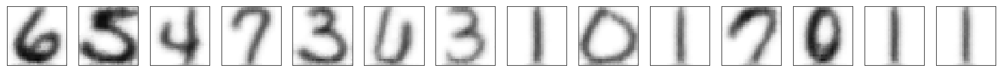

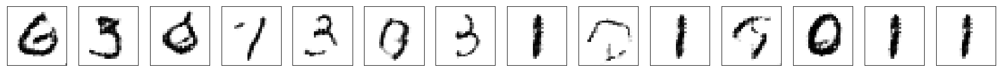

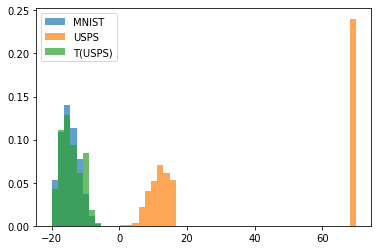

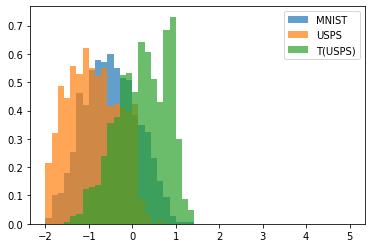

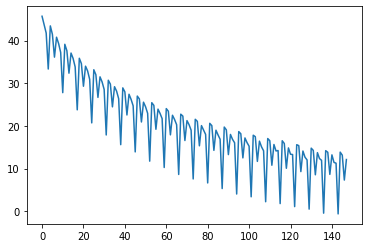

14900 tf.Tensor(10.510741898550819, shape=(), dtype=float64)
tf.Tensor(10.510741898550819, shape=(), dtype=float64)


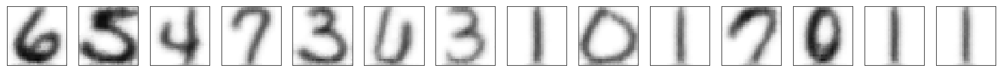

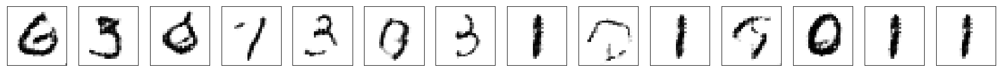

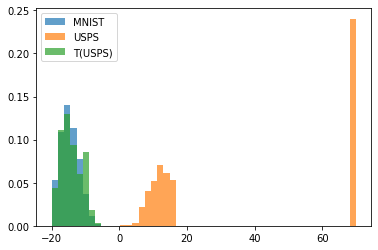

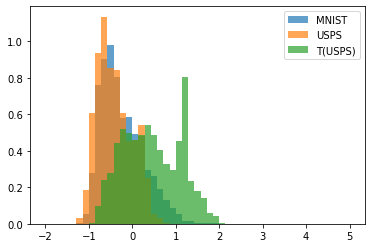

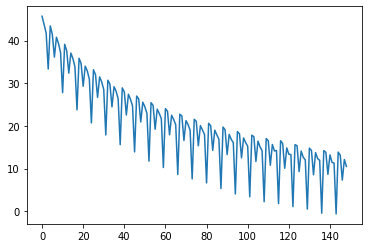

15000 tf.Tensor(10.279372371262909, shape=(), dtype=float64)
tf.Tensor(10.279372371262909, shape=(), dtype=float64)


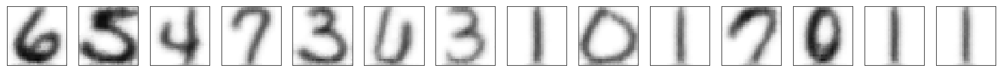

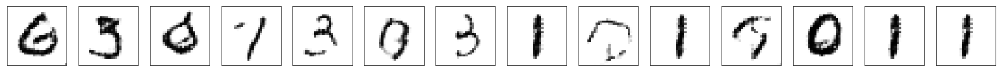

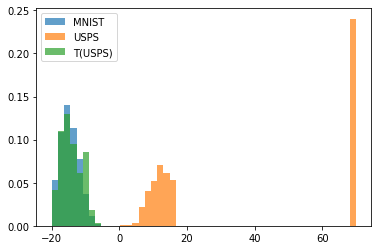

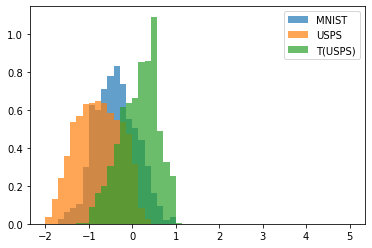

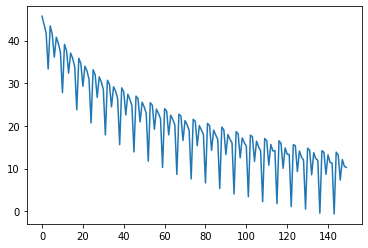

saving weights
15100 tf.Tensor(-1.7277210022117444, shape=(), dtype=float64)
tf.Tensor(-1.7277210022117444, shape=(), dtype=float64)


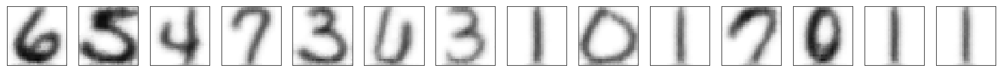

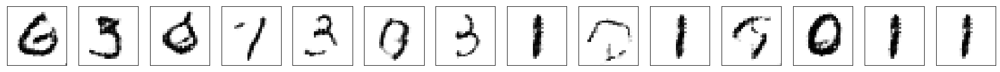

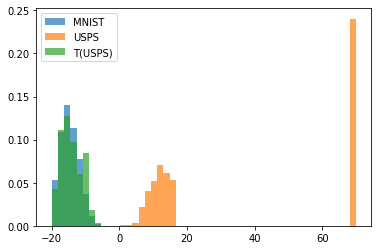

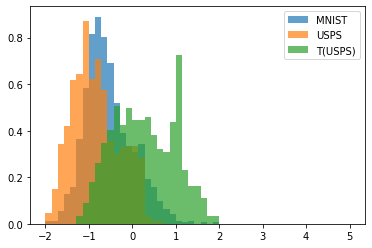

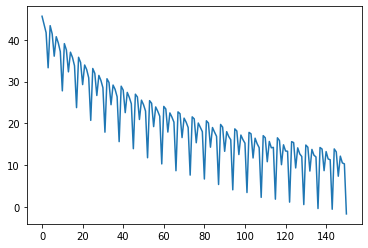

15200 tf.Tensor(13.250204664734369, shape=(), dtype=float64)
tf.Tensor(13.250204664734369, shape=(), dtype=float64)


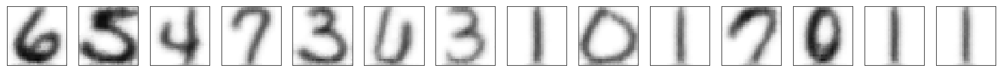

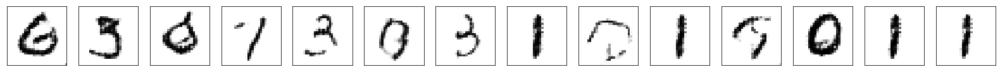

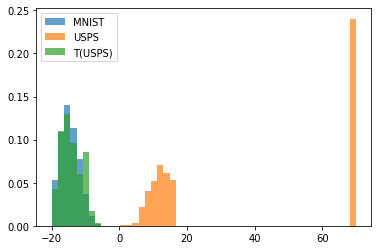

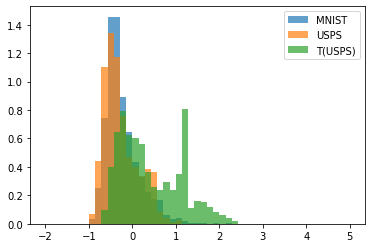

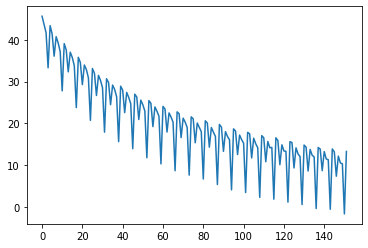

15300 tf.Tensor(12.97882126859772, shape=(), dtype=float64)
tf.Tensor(12.97882126859772, shape=(), dtype=float64)


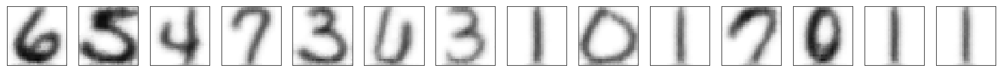

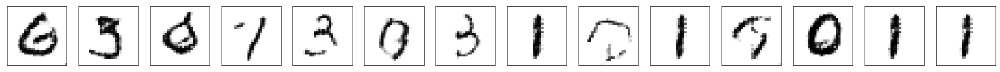

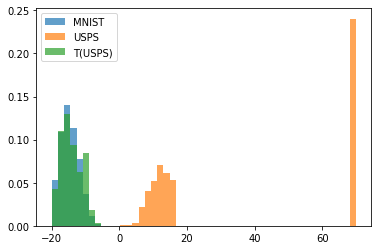

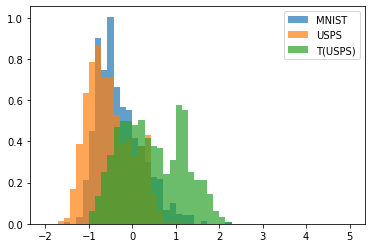

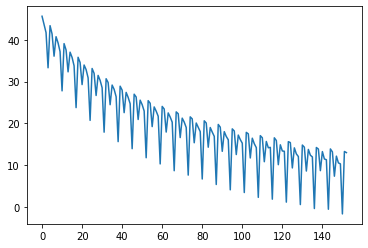

15400 tf.Tensor(6.975996919955392, shape=(), dtype=float64)
tf.Tensor(6.975996919955392, shape=(), dtype=float64)


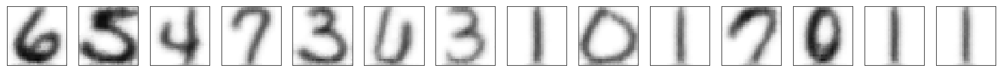

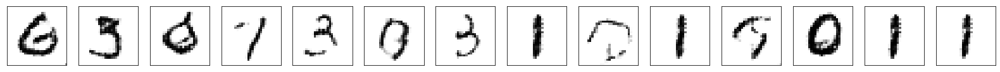

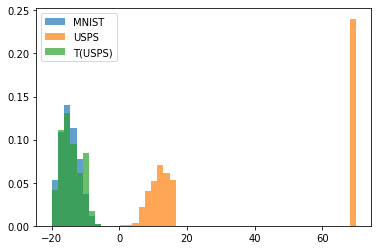

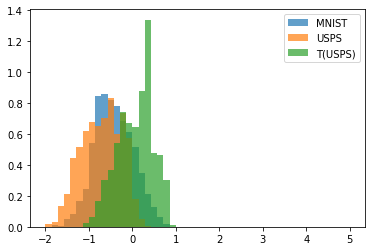

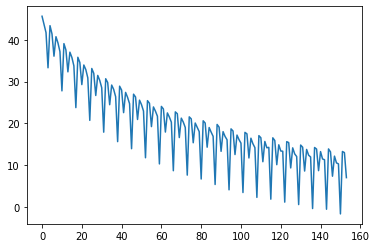

15500 tf.Tensor(11.80502358805295, shape=(), dtype=float64)
tf.Tensor(11.80502358805295, shape=(), dtype=float64)


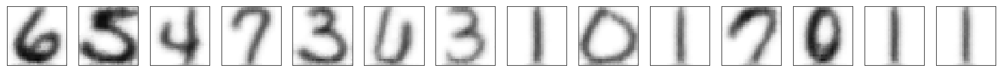

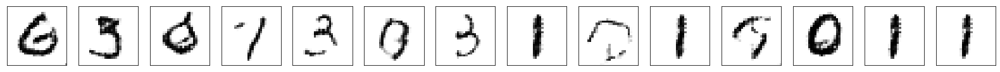

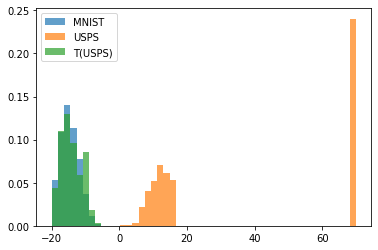

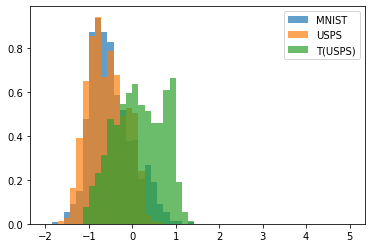

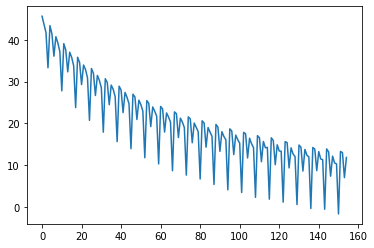

15600 tf.Tensor(10.127530648387584, shape=(), dtype=float64)
tf.Tensor(10.127530648387584, shape=(), dtype=float64)


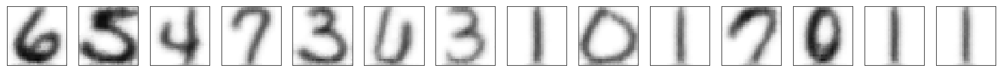

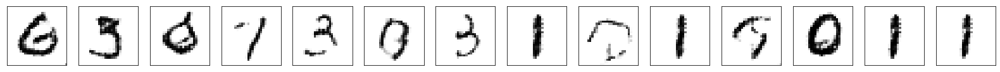

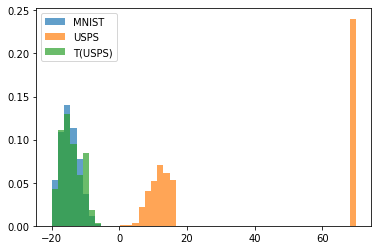

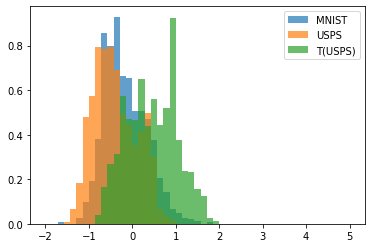

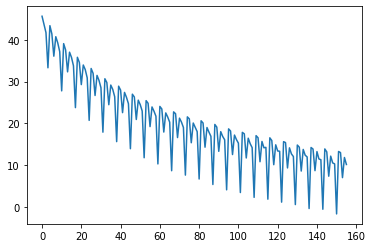

15700 tf.Tensor(9.638566995909791, shape=(), dtype=float64)
tf.Tensor(9.638566995909791, shape=(), dtype=float64)


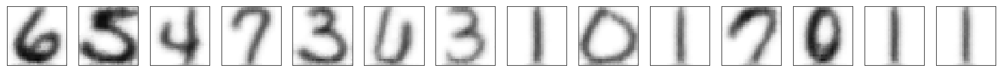

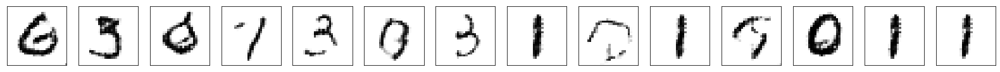

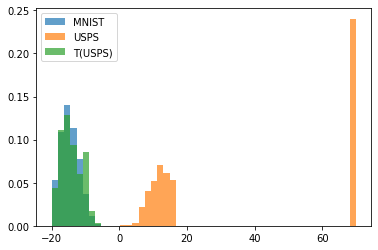

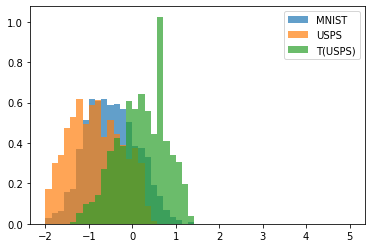

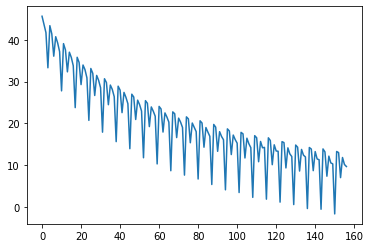

15800 tf.Tensor(-2.0902651332887388, shape=(), dtype=float64)
tf.Tensor(-2.0902651332887388, shape=(), dtype=float64)


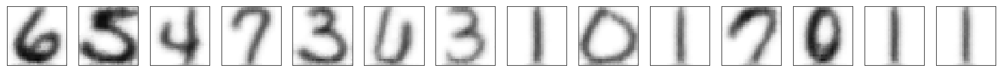

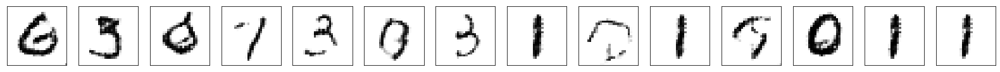

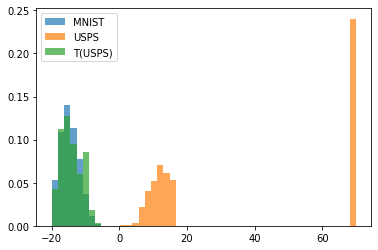

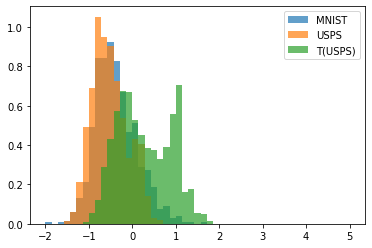

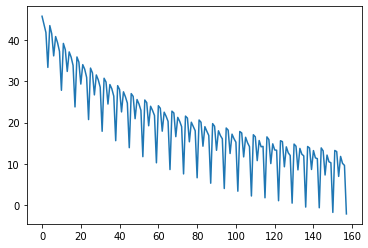

15900 tf.Tensor(12.488628274184741, shape=(), dtype=float64)
tf.Tensor(12.488628274184741, shape=(), dtype=float64)


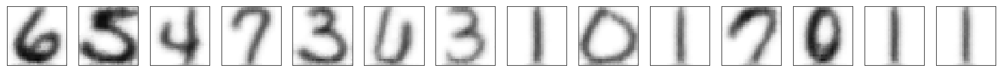

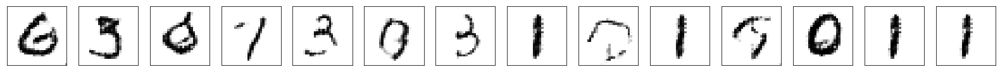

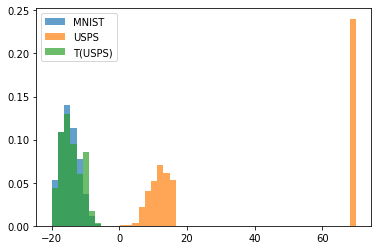

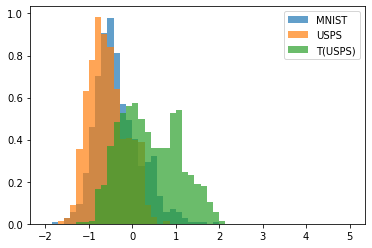

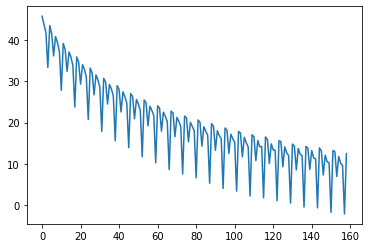

16000 tf.Tensor(12.07190702602357, shape=(), dtype=float64)
tf.Tensor(12.07190702602357, shape=(), dtype=float64)


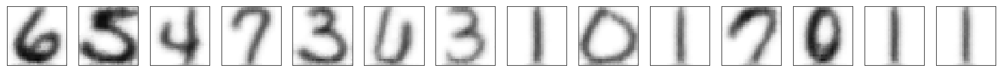

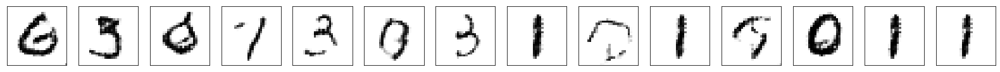

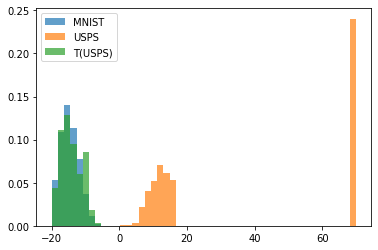

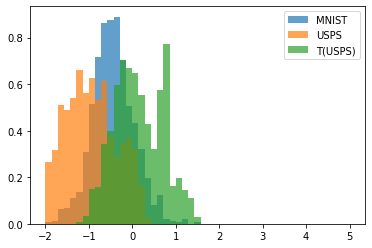

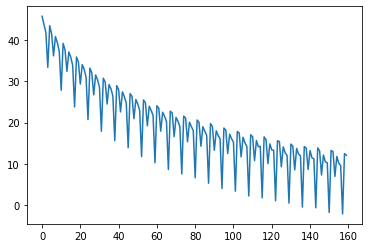

saving weights
16100 tf.Tensor(6.290067369364955, shape=(), dtype=float64)
tf.Tensor(6.290067369364955, shape=(), dtype=float64)


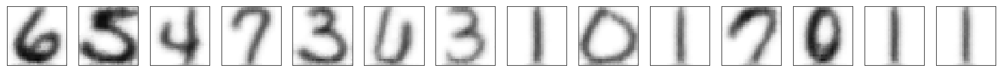

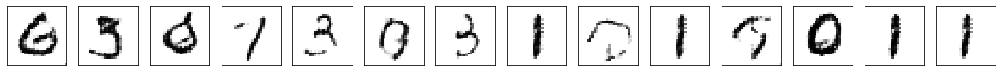

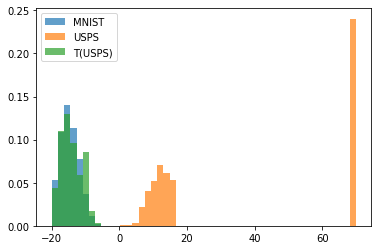

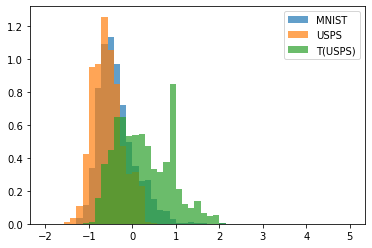

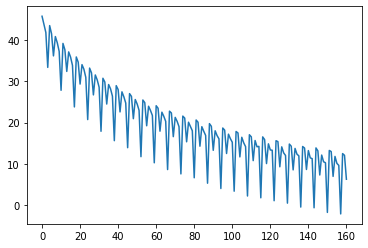

16200 tf.Tensor(10.973052927925863, shape=(), dtype=float64)
tf.Tensor(10.973052927925863, shape=(), dtype=float64)


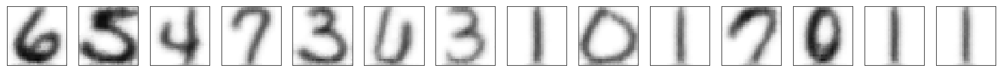

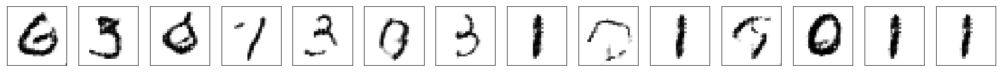

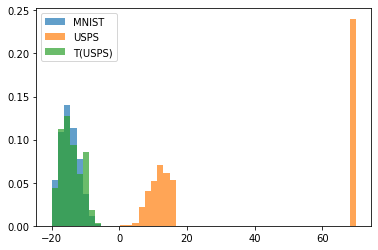

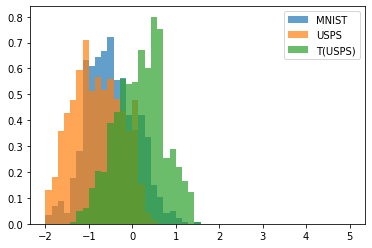

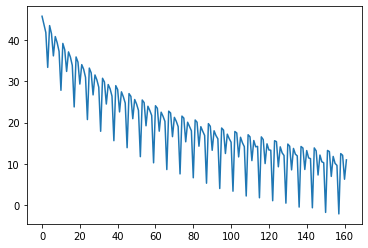

16300 tf.Tensor(9.400889268538094, shape=(), dtype=float64)
tf.Tensor(9.400889268538094, shape=(), dtype=float64)


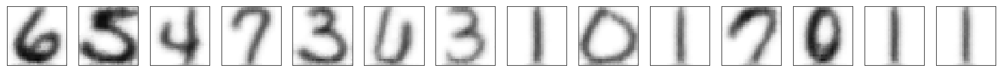

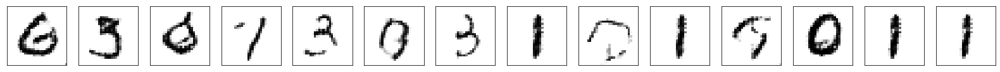

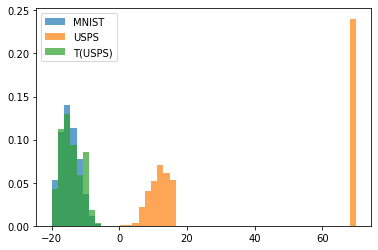

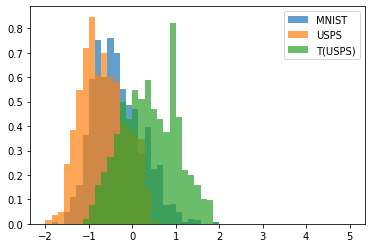

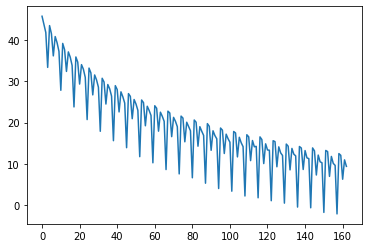

16400 tf.Tensor(9.57513923431354, shape=(), dtype=float64)
tf.Tensor(9.57513923431354, shape=(), dtype=float64)


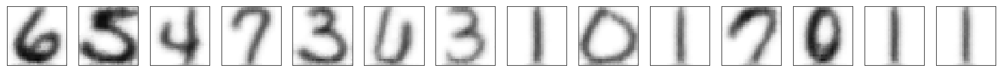

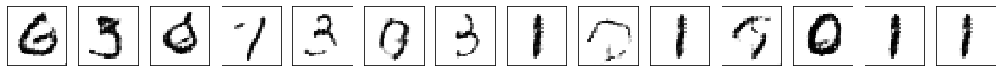

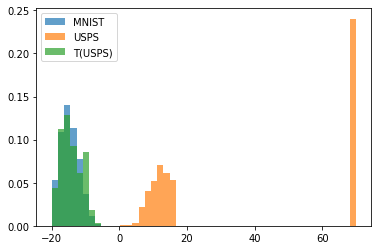

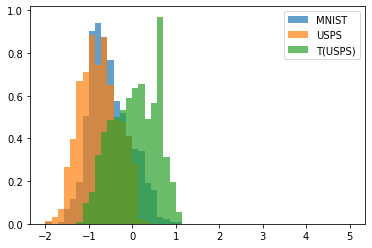

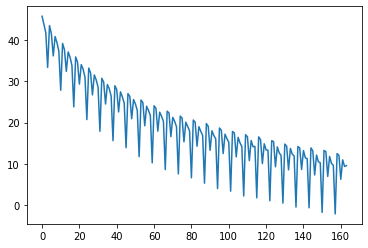

16500 tf.Tensor(-1.7642531187359296, shape=(), dtype=float64)
tf.Tensor(-1.7642531187359296, shape=(), dtype=float64)


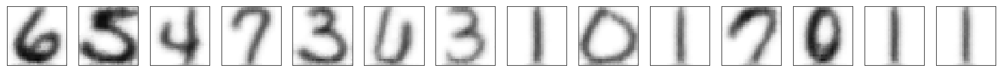

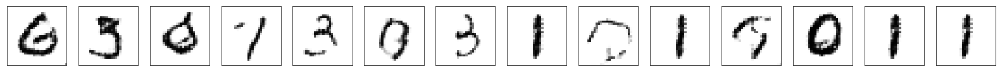

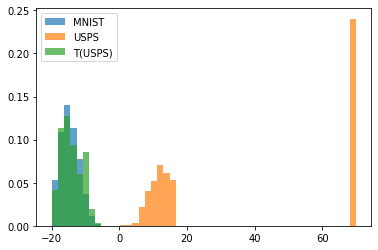

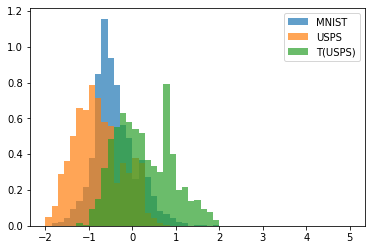

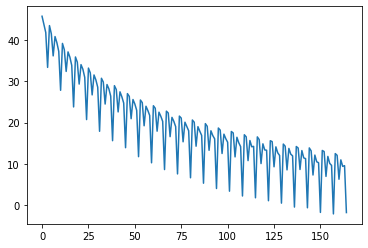

16600 tf.Tensor(12.211380664480895, shape=(), dtype=float64)
tf.Tensor(12.211380664480895, shape=(), dtype=float64)


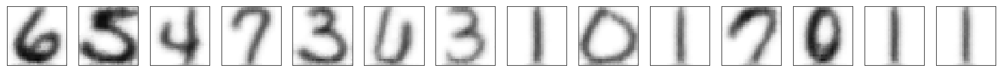

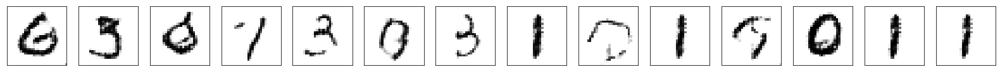

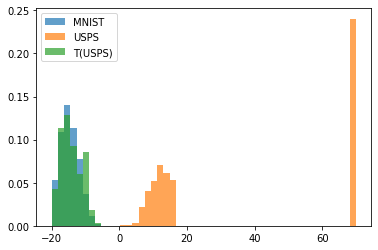

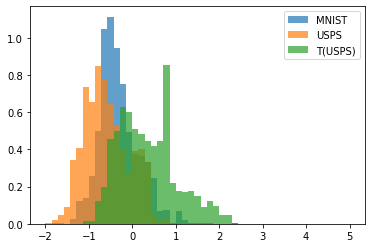

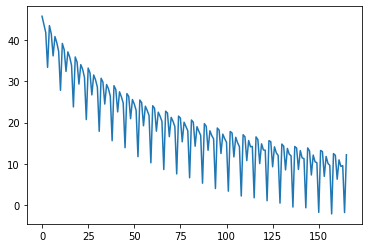

16700 tf.Tensor(11.505914946701864, shape=(), dtype=float64)
tf.Tensor(11.505914946701864, shape=(), dtype=float64)


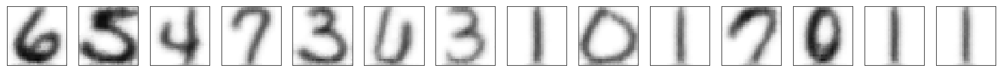

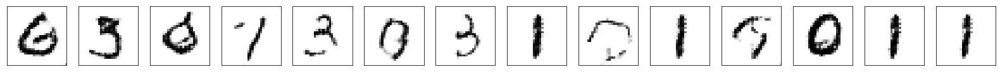

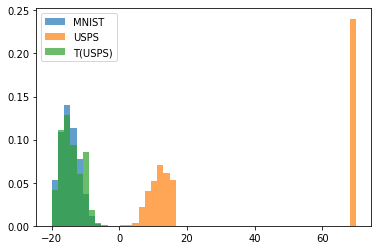

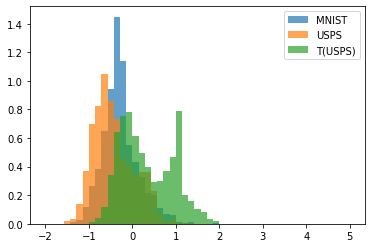

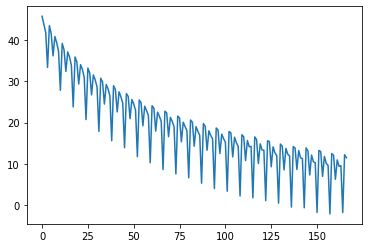

16800 tf.Tensor(5.558840610826, shape=(), dtype=float64)
tf.Tensor(5.558840610826, shape=(), dtype=float64)


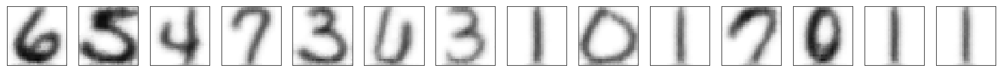

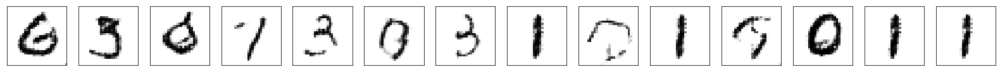

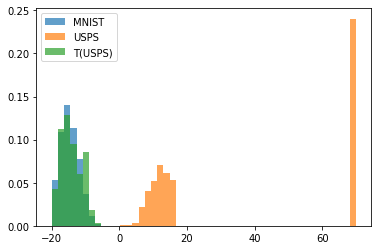

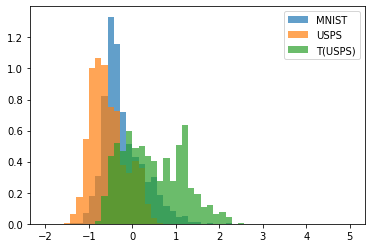

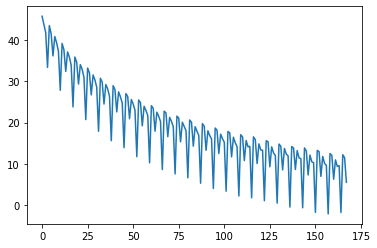

16900 tf.Tensor(10.77107049650327, shape=(), dtype=float64)
tf.Tensor(10.77107049650327, shape=(), dtype=float64)


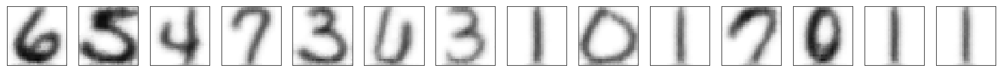

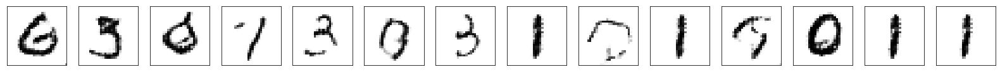

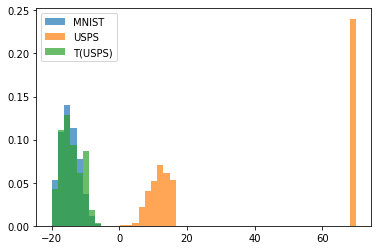

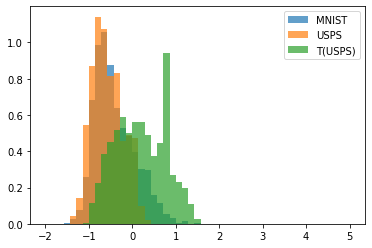

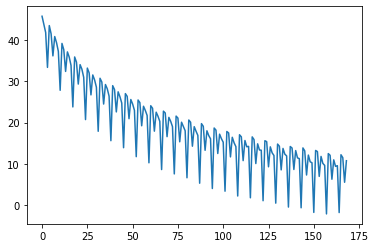

17000 tf.Tensor(8.970904277266978, shape=(), dtype=float64)
tf.Tensor(8.970904277266978, shape=(), dtype=float64)


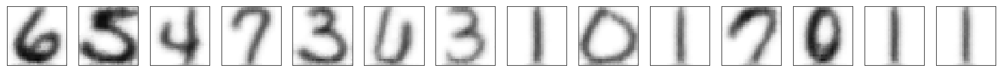

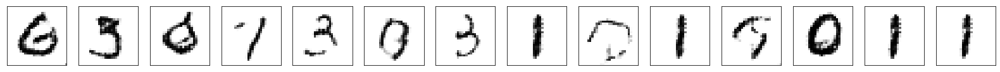

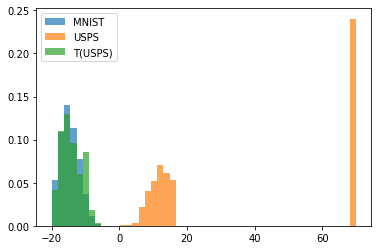

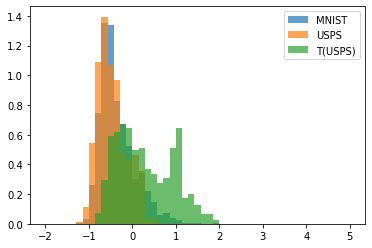

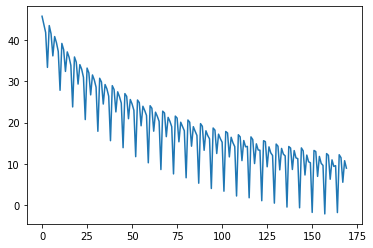

saving weights
17100 tf.Tensor(8.916983099746922, shape=(), dtype=float64)
tf.Tensor(8.916983099746922, shape=(), dtype=float64)


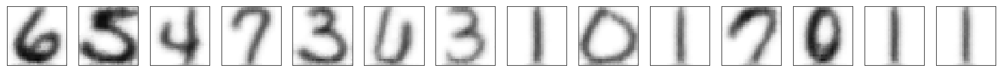

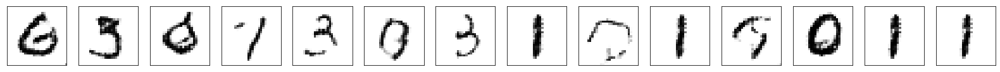

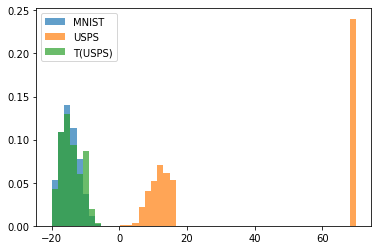

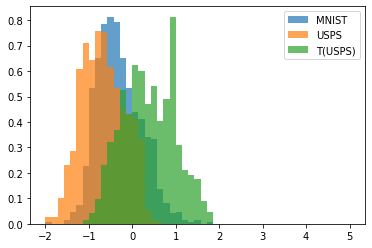

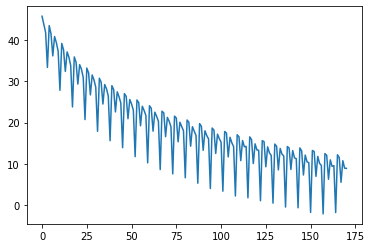

17200 tf.Tensor(-3.6218595192609513, shape=(), dtype=float64)
tf.Tensor(-3.6218595192609513, shape=(), dtype=float64)


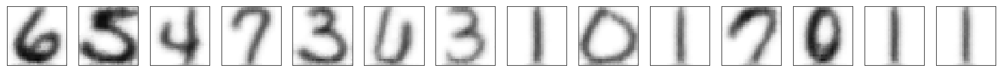

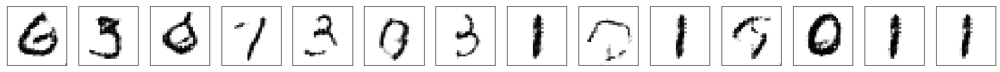

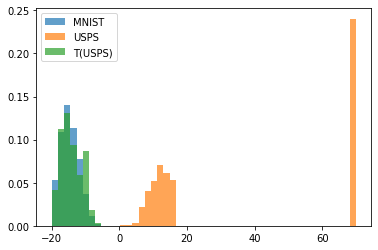

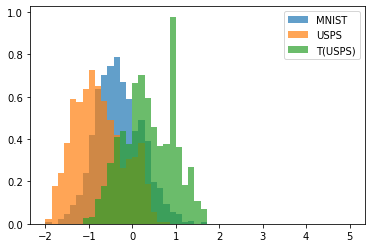

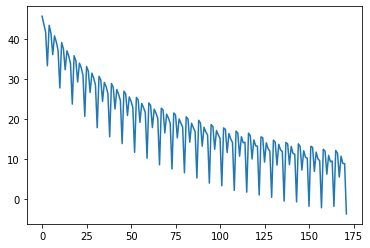

17300 tf.Tensor(11.398856817875757, shape=(), dtype=float64)
tf.Tensor(11.398856817875757, shape=(), dtype=float64)


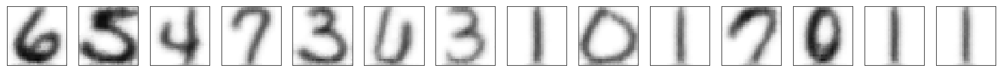

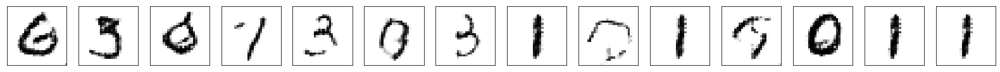

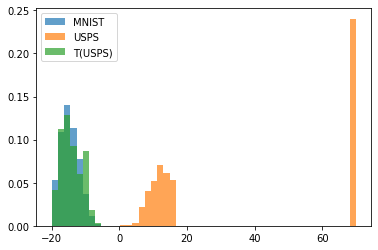

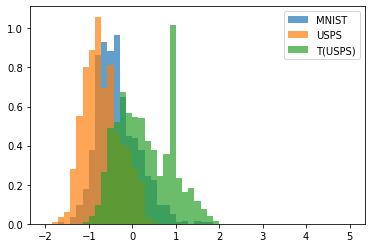

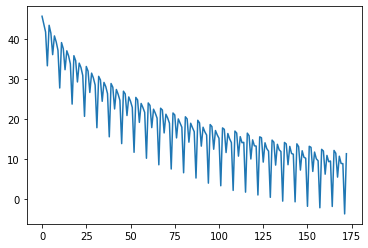

17400 tf.Tensor(11.099837567100096, shape=(), dtype=float64)
tf.Tensor(11.099837567100096, shape=(), dtype=float64)


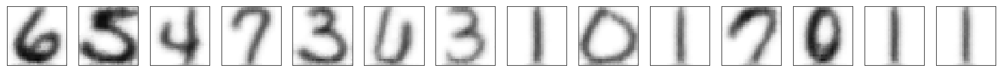

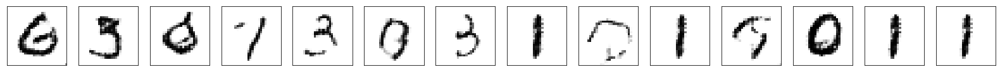

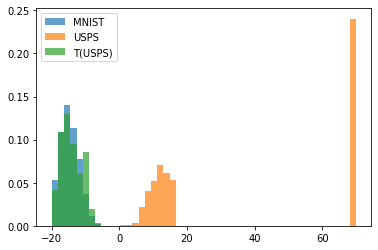

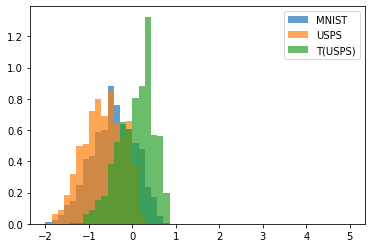

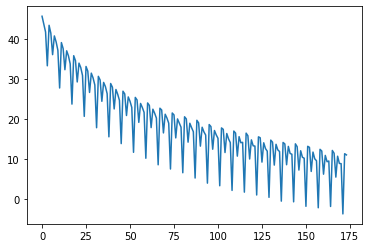

17500 tf.Tensor(5.367359250898545, shape=(), dtype=float64)
tf.Tensor(5.367359250898545, shape=(), dtype=float64)


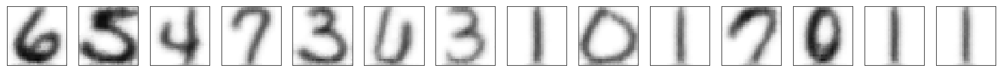

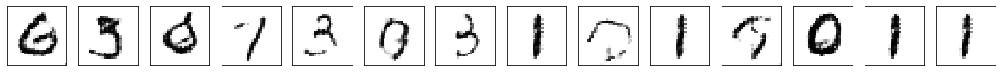

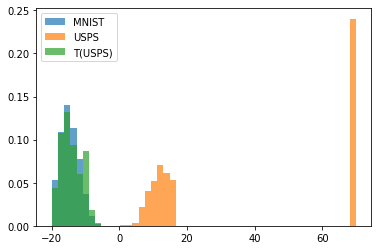

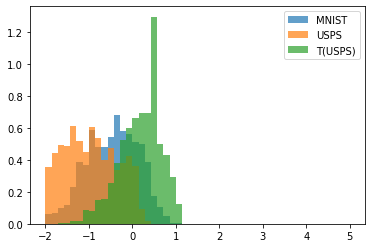

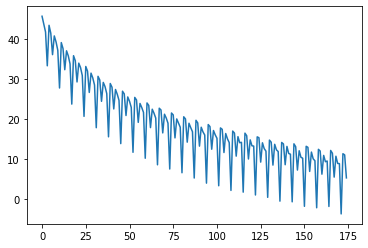

17600 tf.Tensor(10.181694721924128, shape=(), dtype=float64)
tf.Tensor(10.181694721924128, shape=(), dtype=float64)


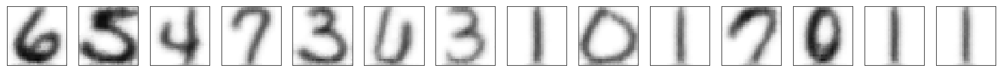

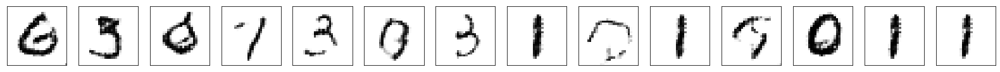

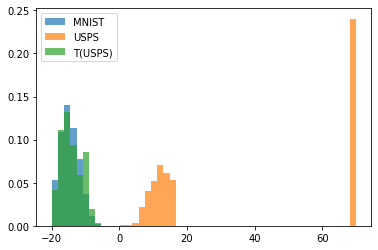

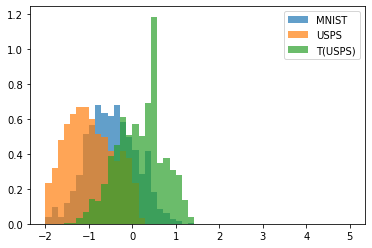

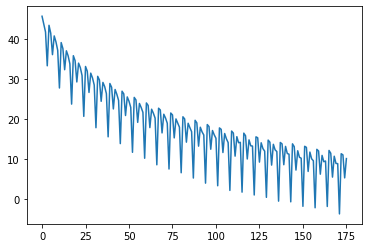

17700 tf.Tensor(8.460967608824106, shape=(), dtype=float64)
tf.Tensor(8.460967608824106, shape=(), dtype=float64)


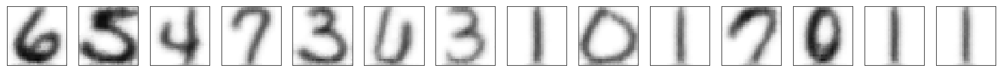

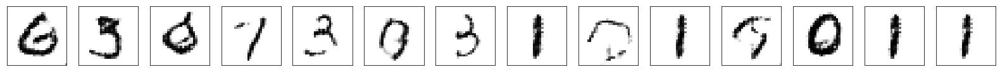

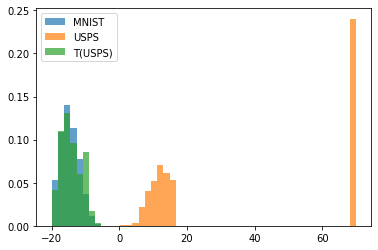

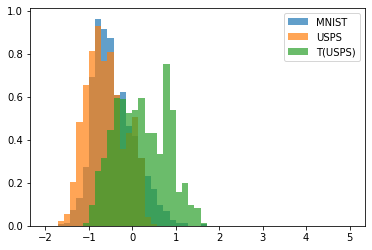

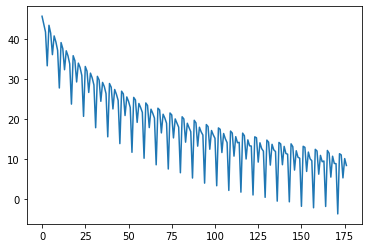

17800 tf.Tensor(8.776509903845199, shape=(), dtype=float64)
tf.Tensor(8.776509903845199, shape=(), dtype=float64)


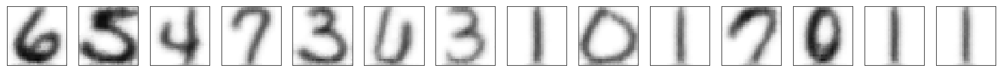

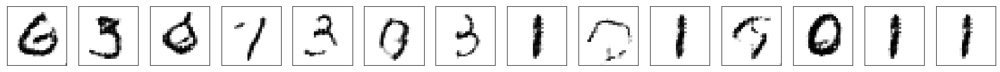

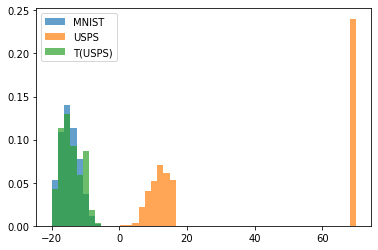

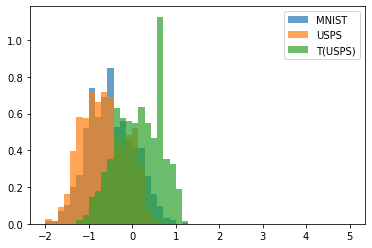

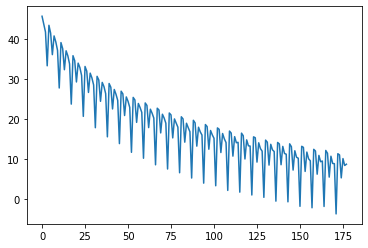

17900 tf.Tensor(-3.4825107623468377, shape=(), dtype=float64)
tf.Tensor(-3.4825107623468377, shape=(), dtype=float64)


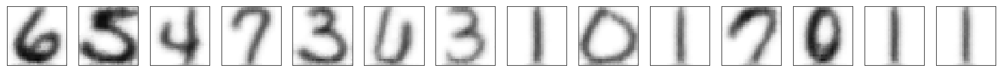

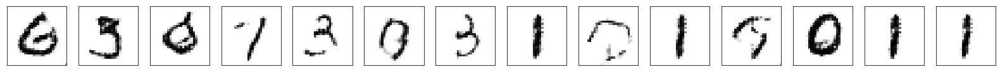

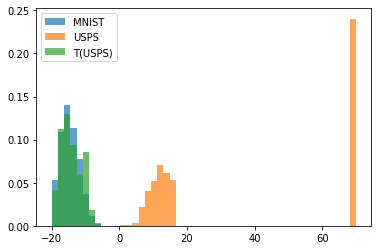

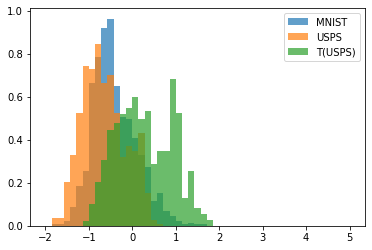

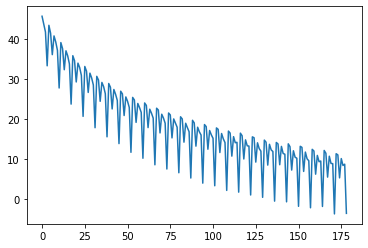

18000 tf.Tensor(11.89553010817334, shape=(), dtype=float64)
tf.Tensor(11.89553010817334, shape=(), dtype=float64)


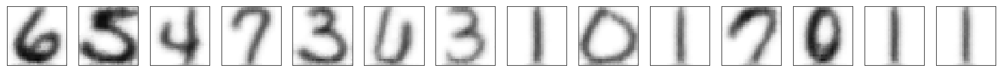

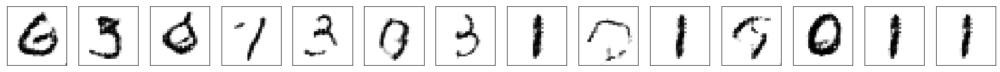

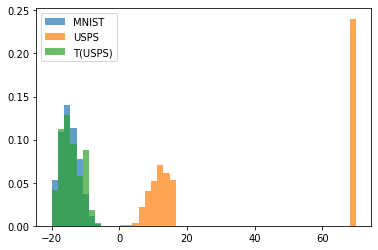

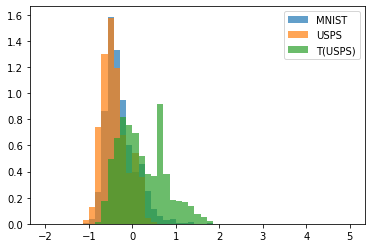

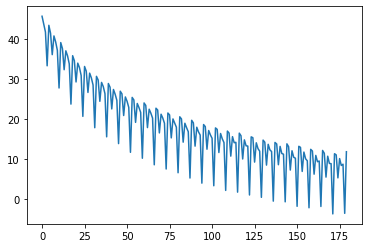

saving weights
18100 tf.Tensor(10.57523843024413, shape=(), dtype=float64)
tf.Tensor(10.57523843024413, shape=(), dtype=float64)


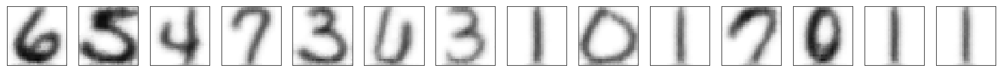

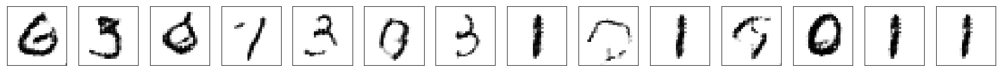

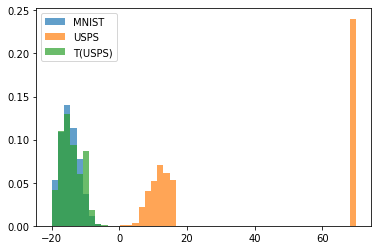

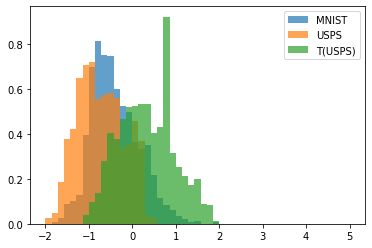

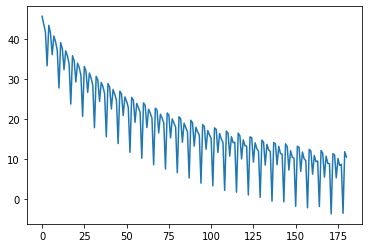

18200 tf.Tensor(4.772796425112016, shape=(), dtype=float64)
tf.Tensor(4.772796425112016, shape=(), dtype=float64)


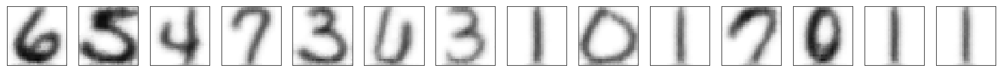

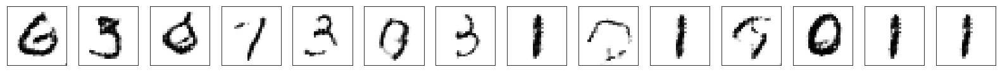

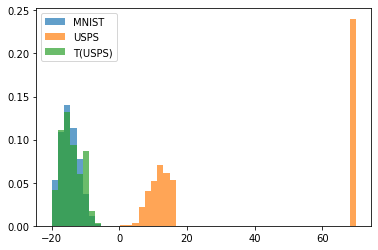

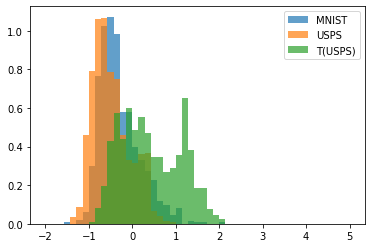

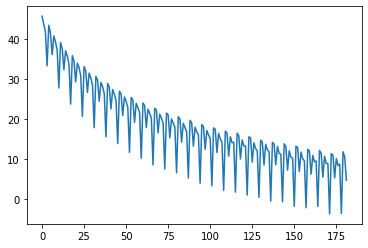

18300 tf.Tensor(9.858270489997736, shape=(), dtype=float64)
tf.Tensor(9.858270489997736, shape=(), dtype=float64)


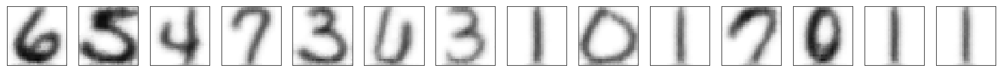

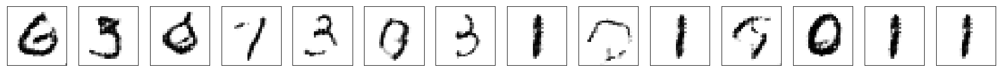

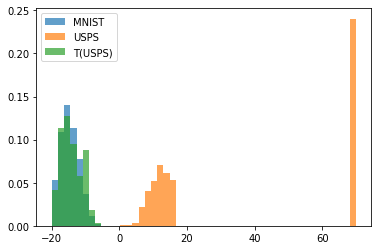

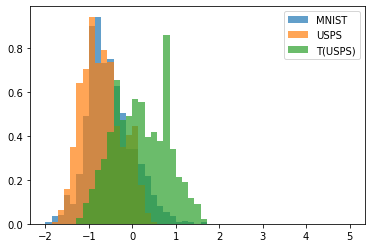

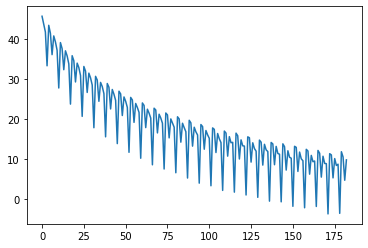

18400 tf.Tensor(7.885847472889395, shape=(), dtype=float64)
tf.Tensor(7.885847472889395, shape=(), dtype=float64)


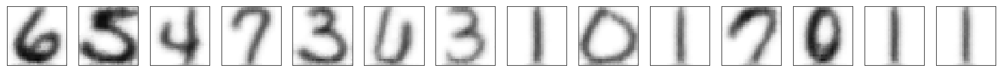

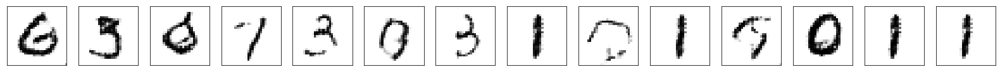

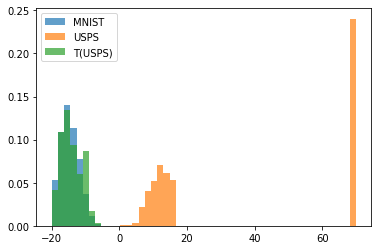

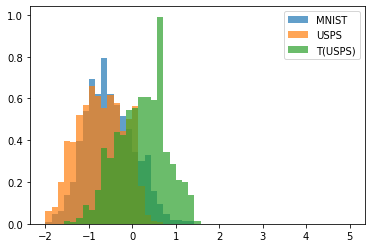

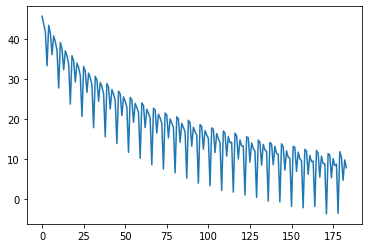

18500 tf.Tensor(7.687087513340469, shape=(), dtype=float64)
tf.Tensor(7.687087513340469, shape=(), dtype=float64)


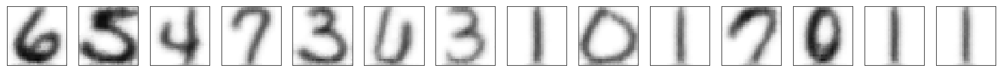

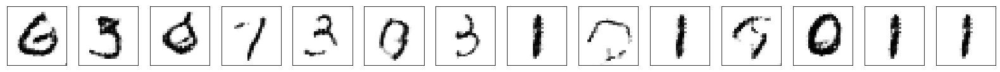

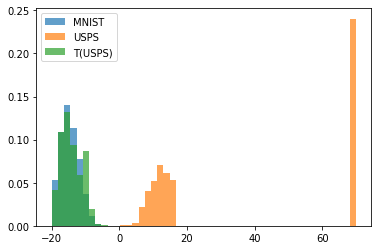

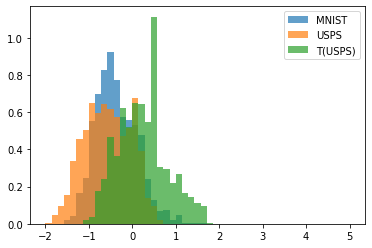

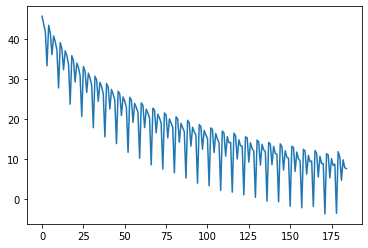

18600 tf.Tensor(-4.32039832362997, shape=(), dtype=float64)
tf.Tensor(-4.32039832362997, shape=(), dtype=float64)


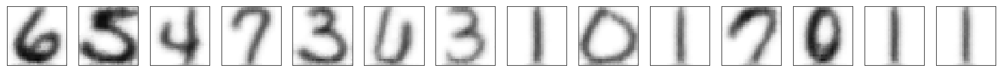

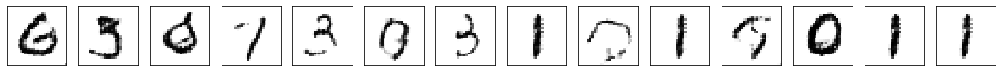

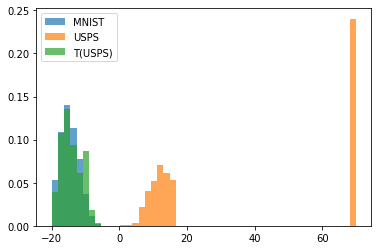

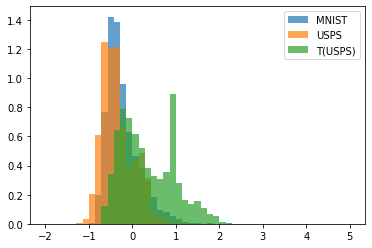

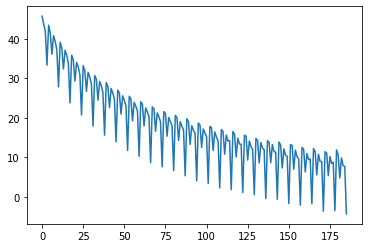

18700 tf.Tensor(10.880889374274581, shape=(), dtype=float64)
tf.Tensor(10.880889374274581, shape=(), dtype=float64)


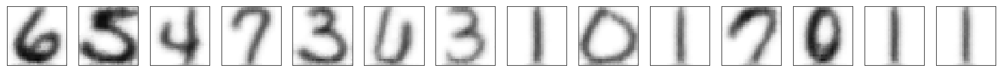

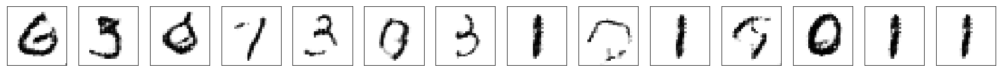

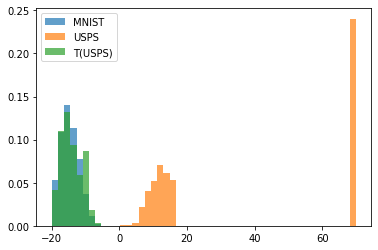

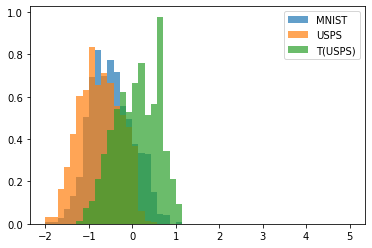

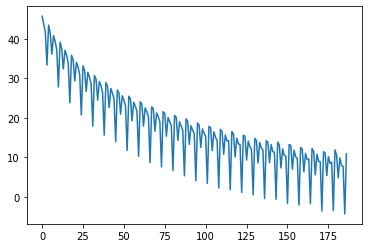

18800 tf.Tensor(10.173462204713108, shape=(), dtype=float64)
tf.Tensor(10.173462204713108, shape=(), dtype=float64)


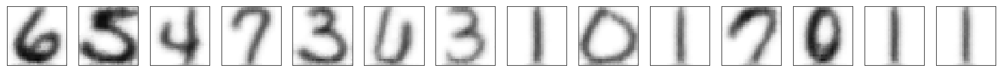

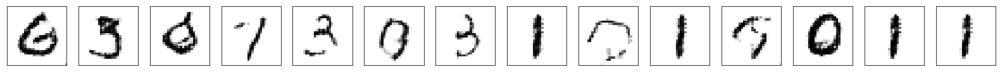

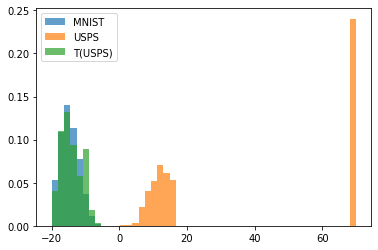

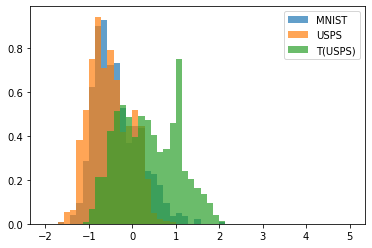

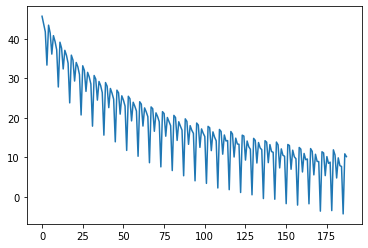

18900 tf.Tensor(4.206953327207408, shape=(), dtype=float64)
tf.Tensor(4.206953327207408, shape=(), dtype=float64)


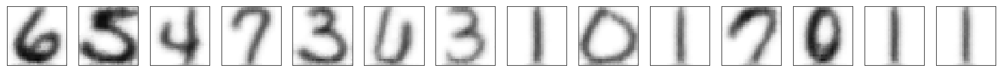

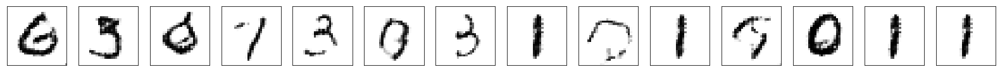

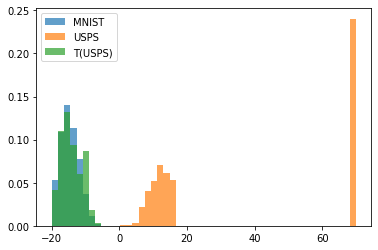

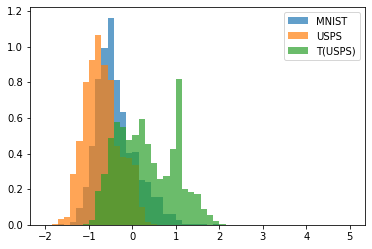

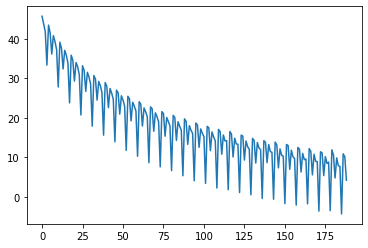

19000 tf.Tensor(9.329578419660091, shape=(), dtype=float64)
tf.Tensor(9.329578419660091, shape=(), dtype=float64)


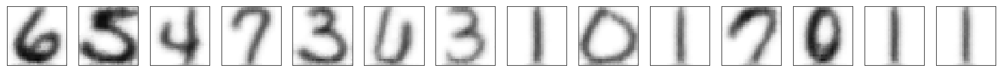

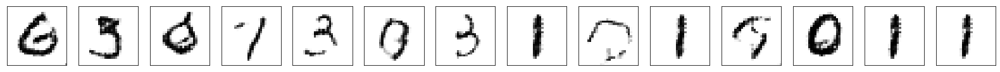

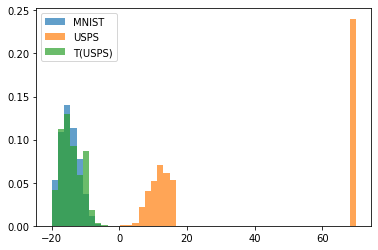

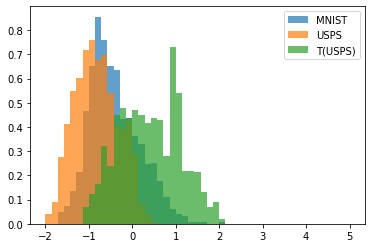

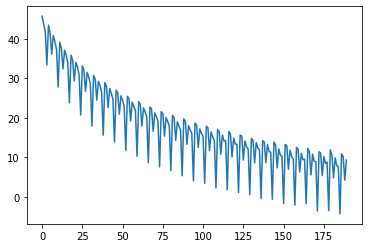

saving weights
19100 tf.Tensor(7.37917705325772, shape=(), dtype=float64)
tf.Tensor(7.37917705325772, shape=(), dtype=float64)


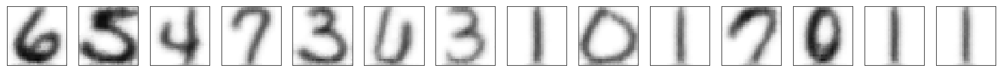

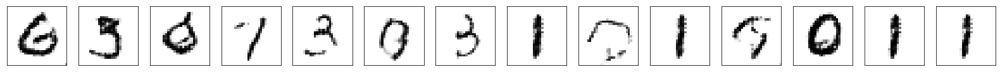

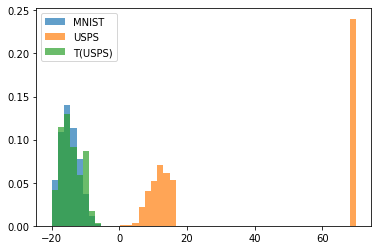

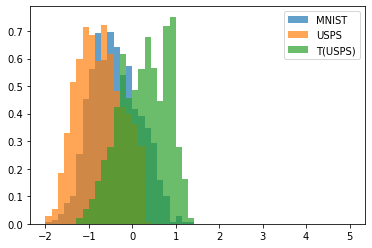

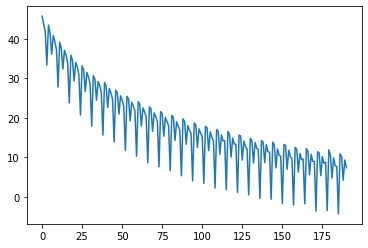

19200 tf.Tensor(7.1581408129150645, shape=(), dtype=float64)
tf.Tensor(7.1581408129150645, shape=(), dtype=float64)


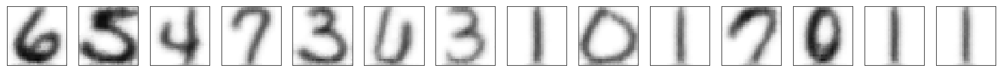

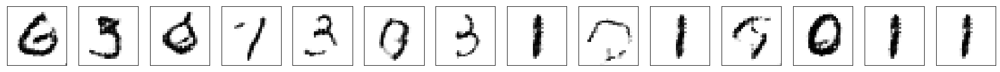

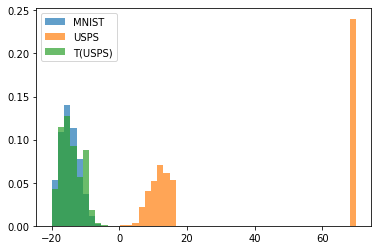

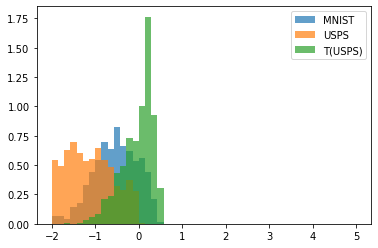

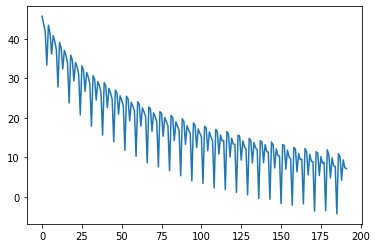

19300 tf.Tensor(-4.471479997882472, shape=(), dtype=float64)
tf.Tensor(-4.471479997882472, shape=(), dtype=float64)


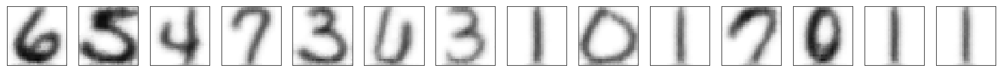

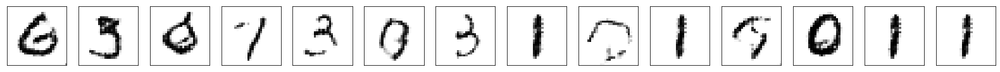

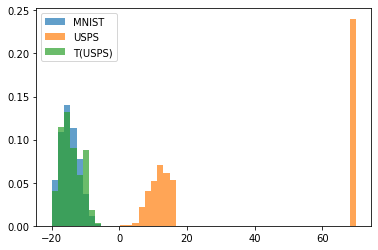

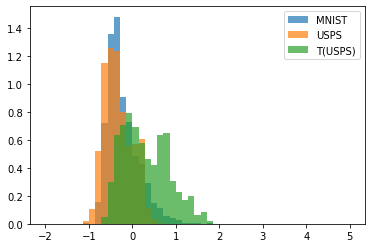

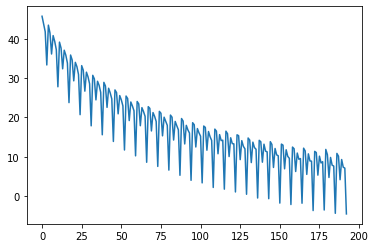

19400 tf.Tensor(10.220384754507286, shape=(), dtype=float64)
tf.Tensor(10.220384754507286, shape=(), dtype=float64)


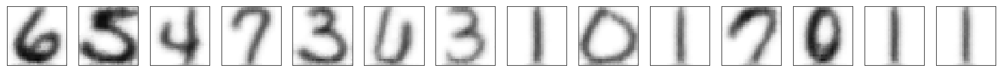

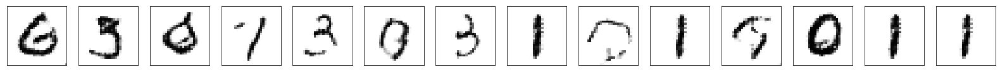

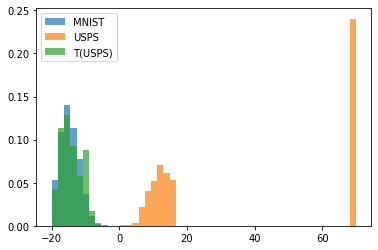

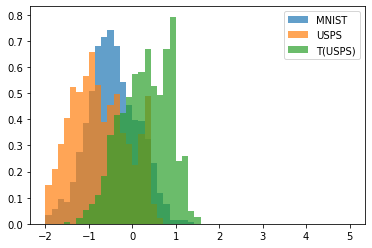

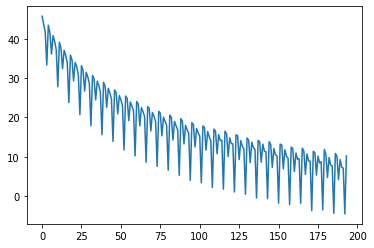

19500 tf.Tensor(9.483213187480356, shape=(), dtype=float64)
tf.Tensor(9.483213187480356, shape=(), dtype=float64)


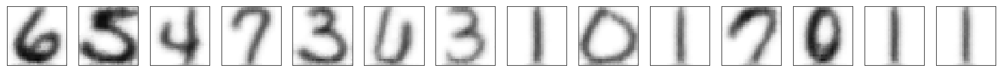

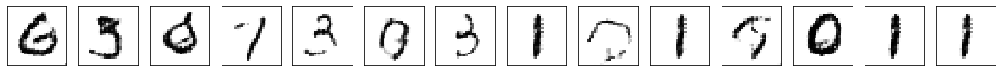

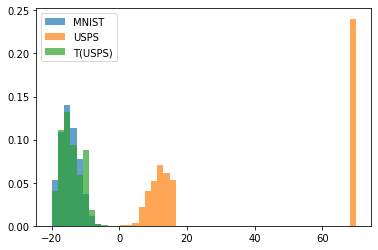

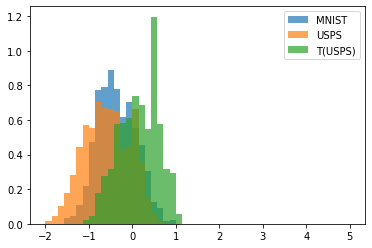

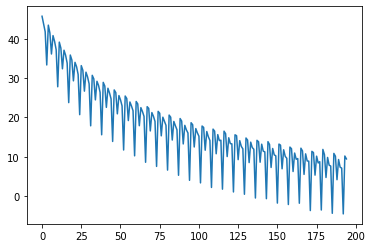

19600 tf.Tensor(3.483481782778881, shape=(), dtype=float64)
tf.Tensor(3.483481782778881, shape=(), dtype=float64)


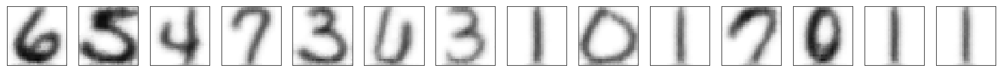

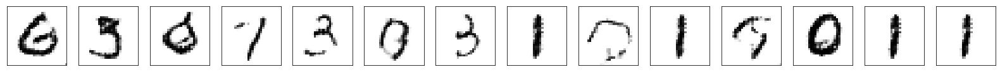

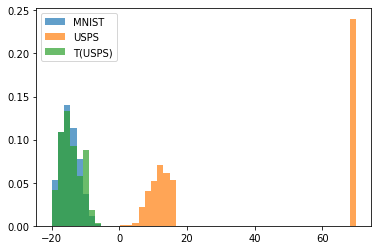

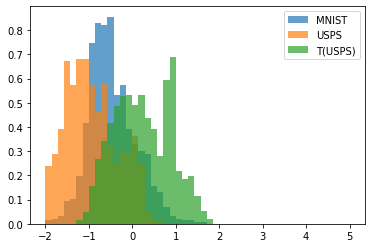

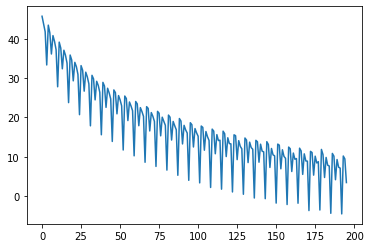

19700 tf.Tensor(8.411006319932447, shape=(), dtype=float64)
tf.Tensor(8.411006319932447, shape=(), dtype=float64)


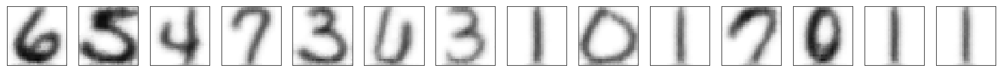

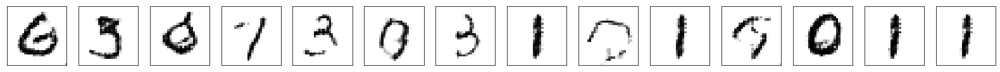

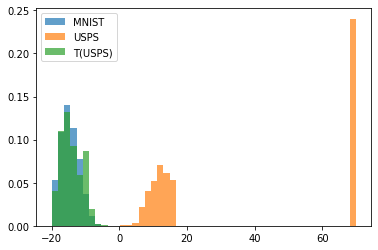

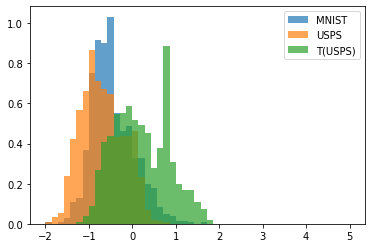

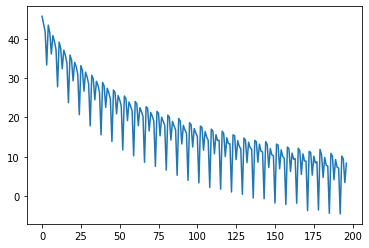

19800 tf.Tensor(6.904347042176951, shape=(), dtype=float64)
tf.Tensor(6.904347042176951, shape=(), dtype=float64)


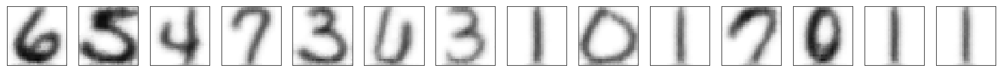

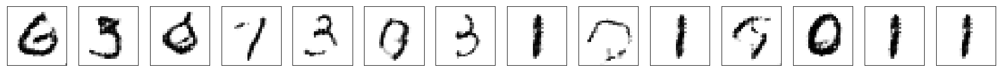

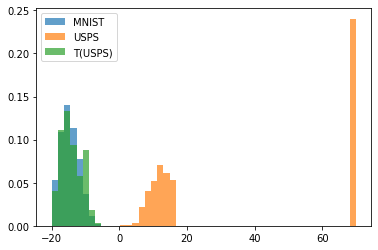

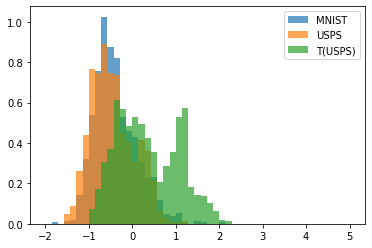

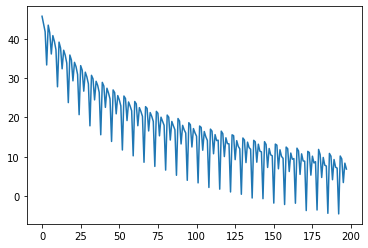

19900 tf.Tensor(6.4328467870610275, shape=(), dtype=float64)
tf.Tensor(6.4328467870610275, shape=(), dtype=float64)


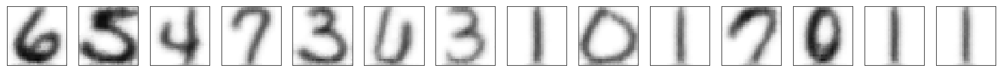

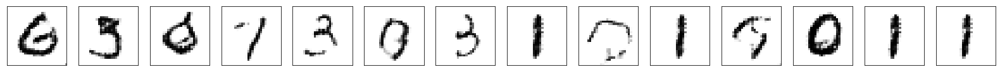

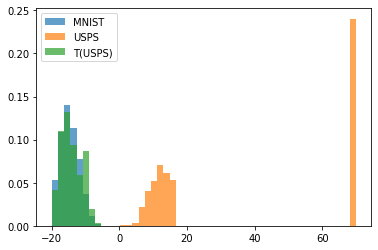

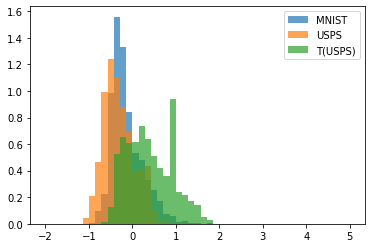

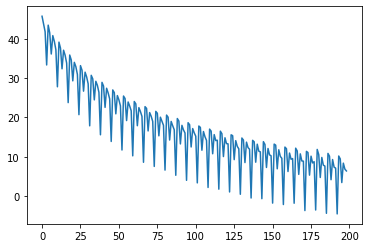

20000 tf.Tensor(-4.468173388224621, shape=(), dtype=float64)
tf.Tensor(-4.468173388224621, shape=(), dtype=float64)


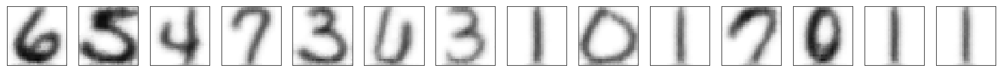

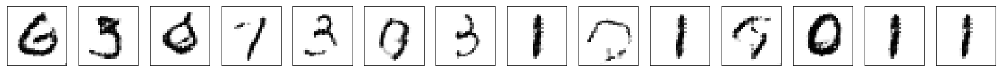

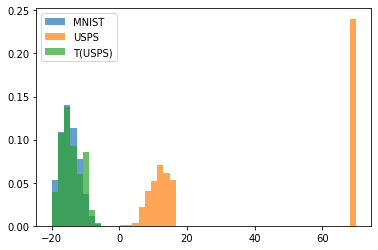

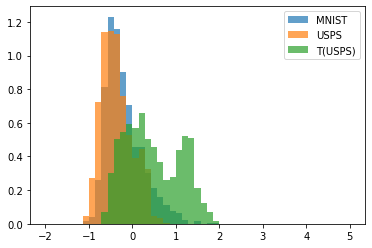

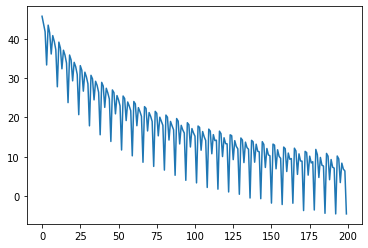

saving weights
20100 tf.Tensor(10.175197080905022, shape=(), dtype=float64)
tf.Tensor(10.175197080905022, shape=(), dtype=float64)


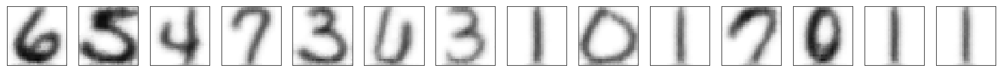

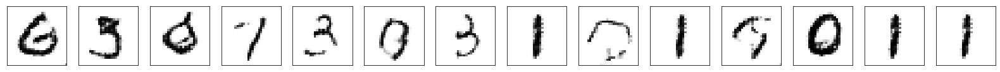

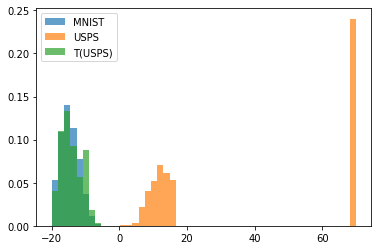

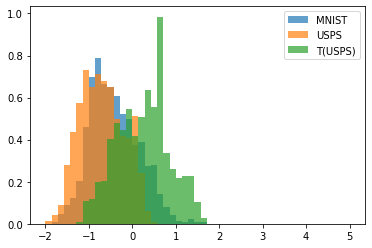

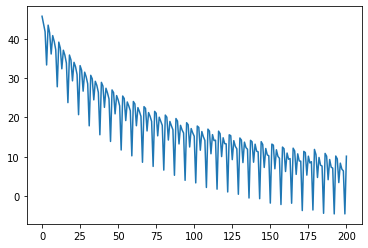

20200 tf.Tensor(9.54768264521973, shape=(), dtype=float64)
tf.Tensor(9.54768264521973, shape=(), dtype=float64)


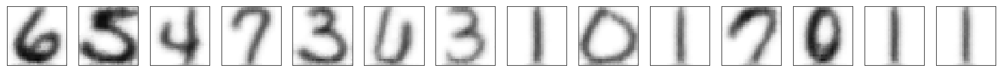

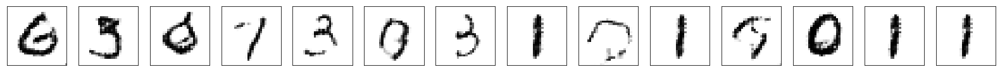

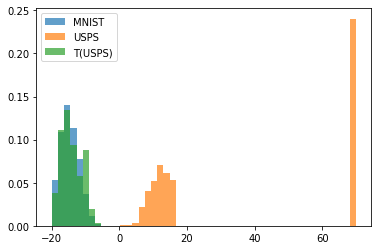

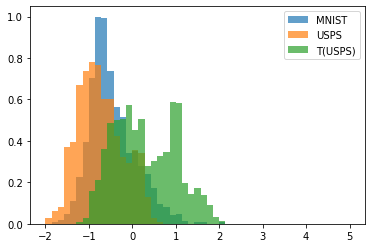

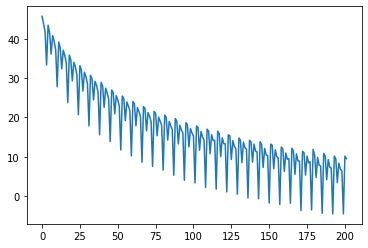

20300 tf.Tensor(3.983020511479861, shape=(), dtype=float64)
tf.Tensor(3.983020511479861, shape=(), dtype=float64)


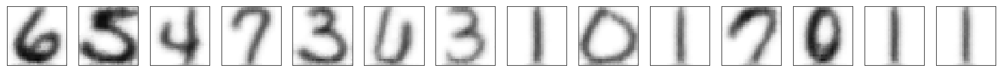

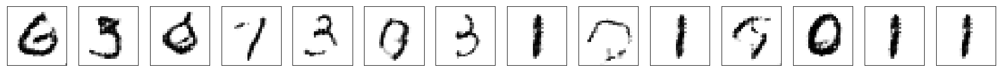

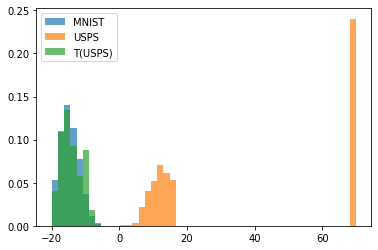

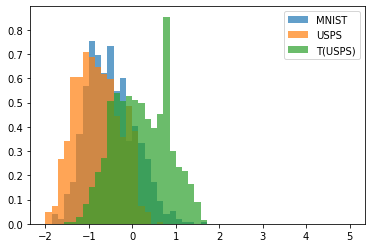

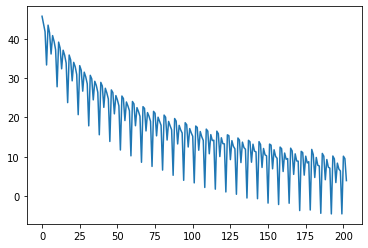

20400 tf.Tensor(8.848882488003913, shape=(), dtype=float64)
tf.Tensor(8.848882488003913, shape=(), dtype=float64)


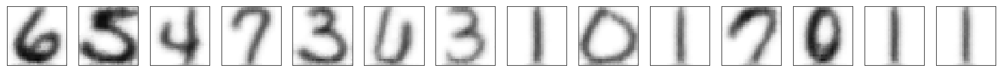

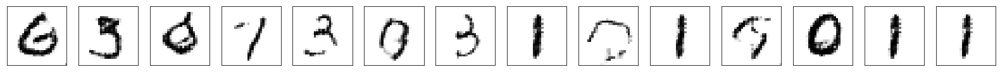

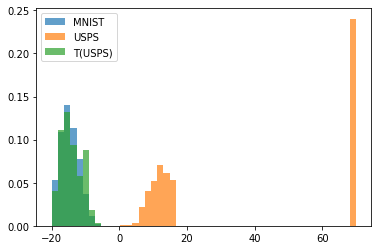

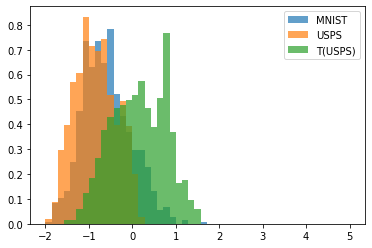

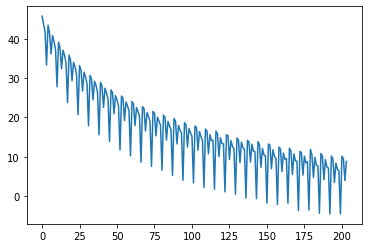

20500 tf.Tensor(6.38857653062189, shape=(), dtype=float64)
tf.Tensor(6.38857653062189, shape=(), dtype=float64)


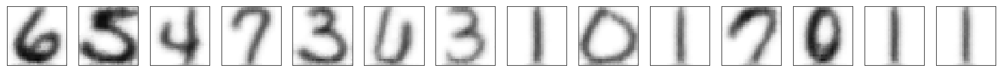

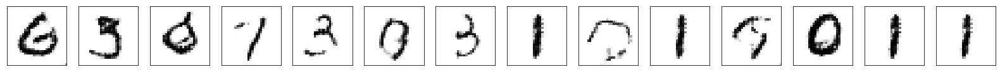

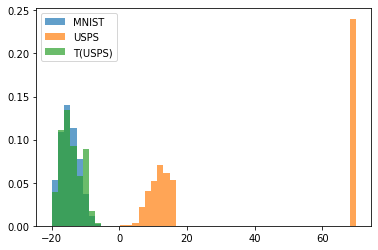

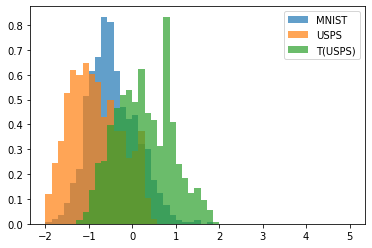

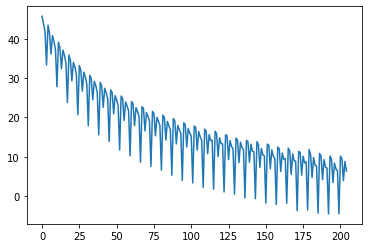

20600 tf.Tensor(6.637454892716189, shape=(), dtype=float64)
tf.Tensor(6.637454892716189, shape=(), dtype=float64)


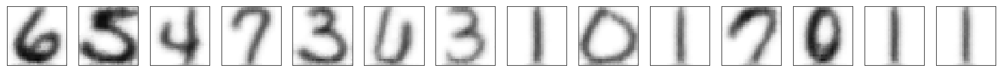

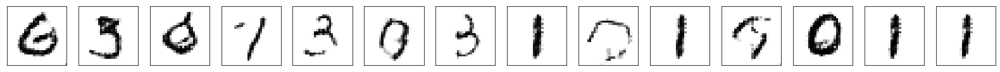

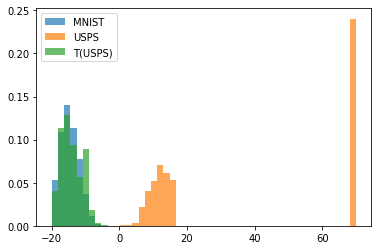

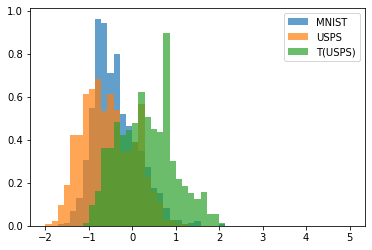

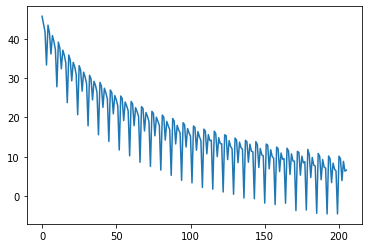

20700 tf.Tensor(-5.966350373752899, shape=(), dtype=float64)
tf.Tensor(-5.966350373752899, shape=(), dtype=float64)


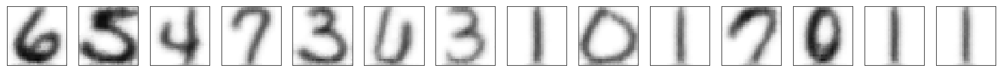

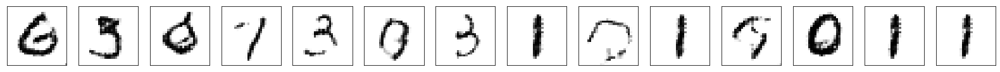

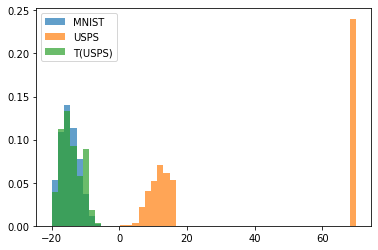

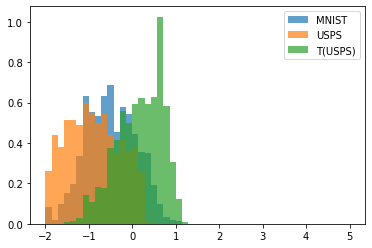

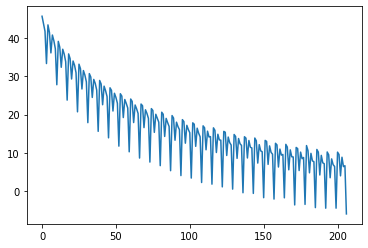

20800 tf.Tensor(9.175233465784796, shape=(), dtype=float64)
tf.Tensor(9.175233465784796, shape=(), dtype=float64)


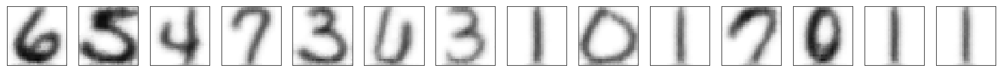

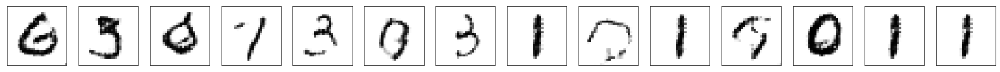

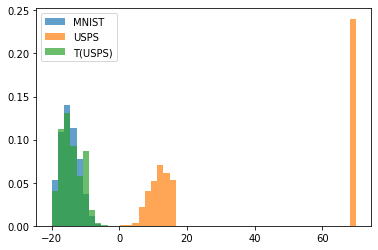

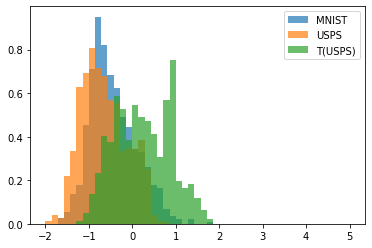

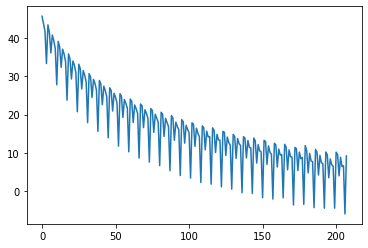

20900 tf.Tensor(8.99518802622585, shape=(), dtype=float64)
tf.Tensor(8.99518802622585, shape=(), dtype=float64)


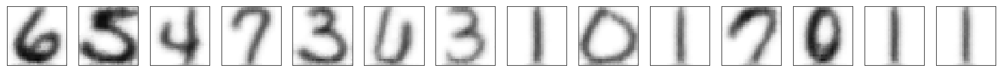

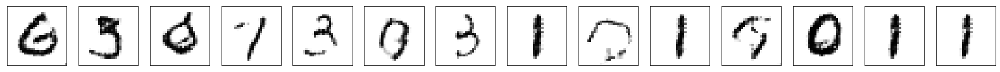

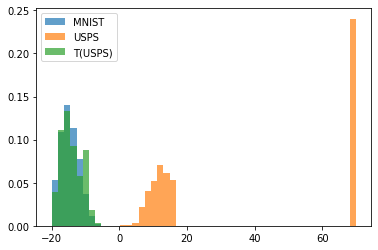

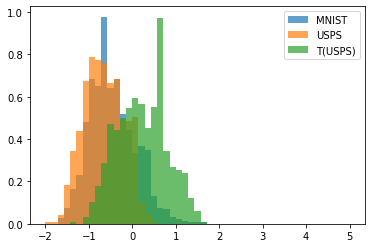

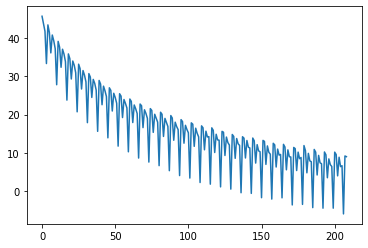

21000 tf.Tensor(3.0930376021075787, shape=(), dtype=float64)
tf.Tensor(3.0930376021075787, shape=(), dtype=float64)


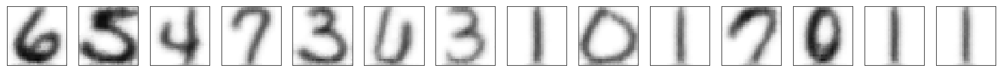

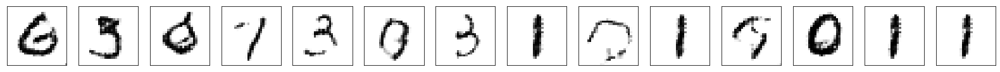

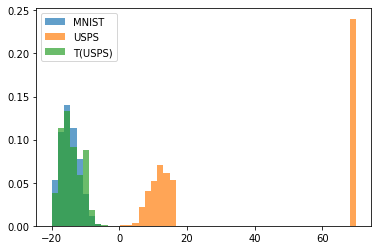

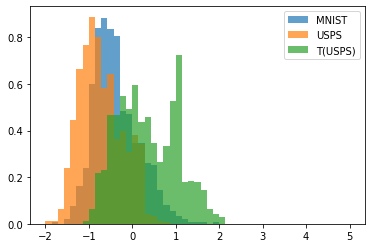

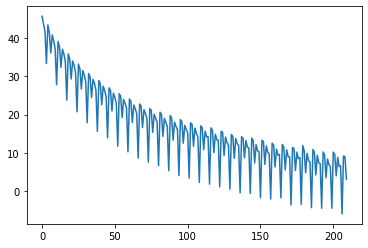

saving weights
21100 tf.Tensor(7.8098785555258985, shape=(), dtype=float64)
tf.Tensor(7.8098785555258985, shape=(), dtype=float64)


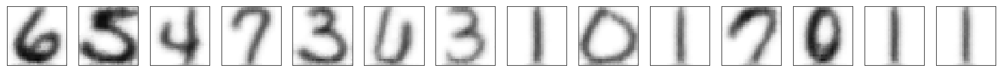

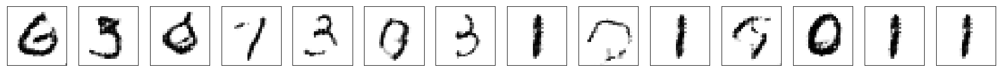

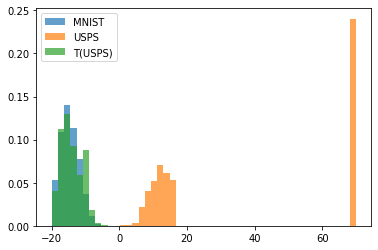

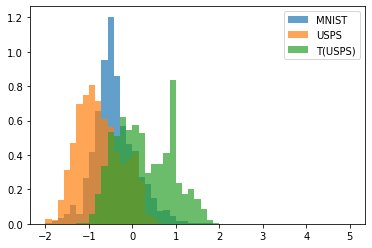

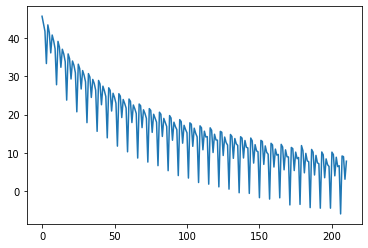

21200 tf.Tensor(6.274981891982176, shape=(), dtype=float64)
tf.Tensor(6.274981891982176, shape=(), dtype=float64)


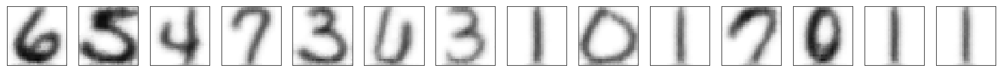

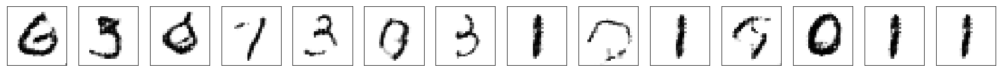

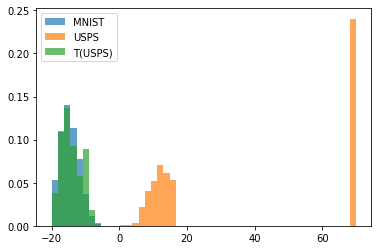

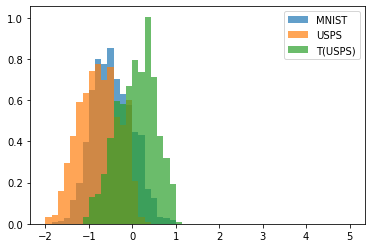

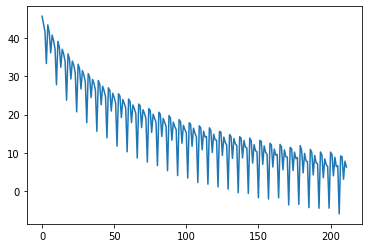

21300 tf.Tensor(6.6122945030469396, shape=(), dtype=float64)
tf.Tensor(6.6122945030469396, shape=(), dtype=float64)


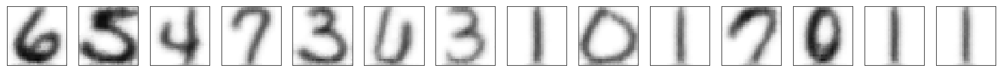

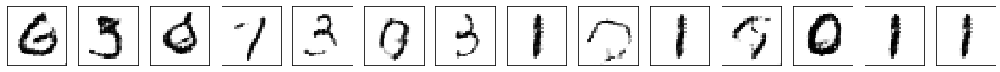

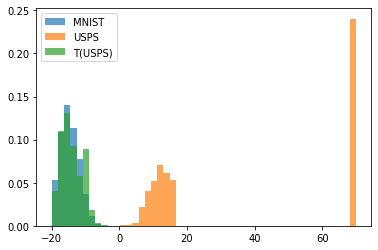

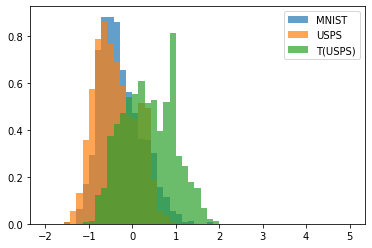

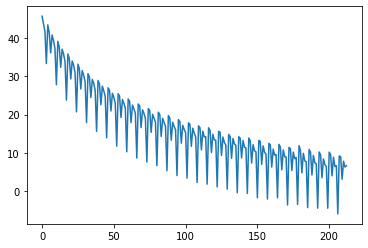

21400 tf.Tensor(-5.60984635803127, shape=(), dtype=float64)
tf.Tensor(-5.60984635803127, shape=(), dtype=float64)


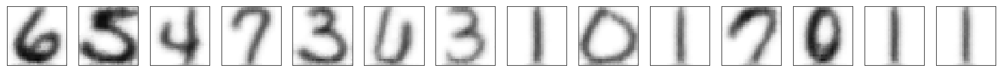

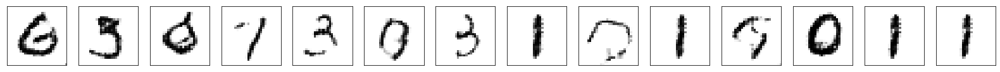

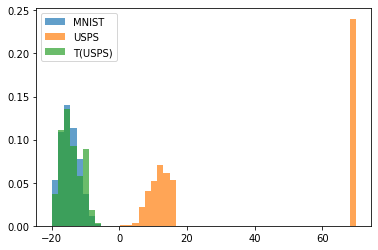

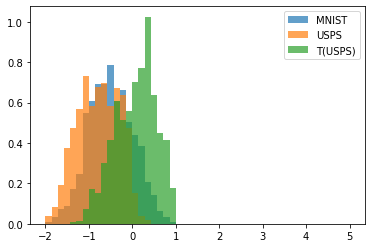

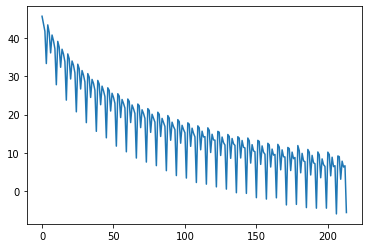

21500 tf.Tensor(9.186433257128261, shape=(), dtype=float64)
tf.Tensor(9.186433257128261, shape=(), dtype=float64)


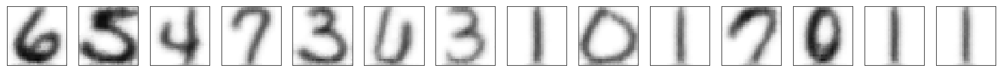

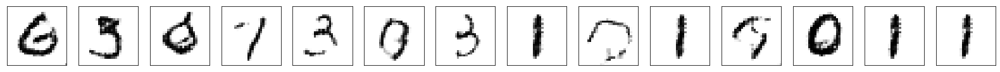

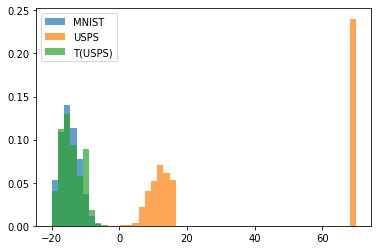

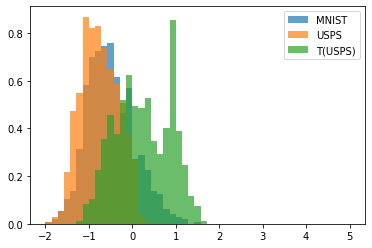

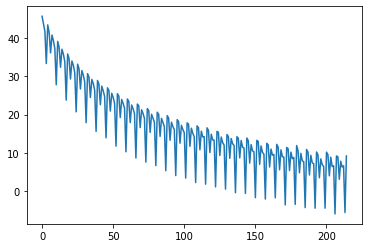

21600 tf.Tensor(8.504134546404089, shape=(), dtype=float64)
tf.Tensor(8.504134546404089, shape=(), dtype=float64)


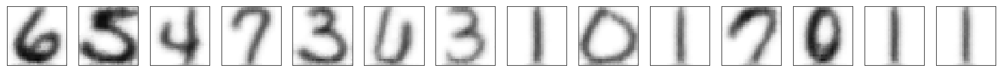

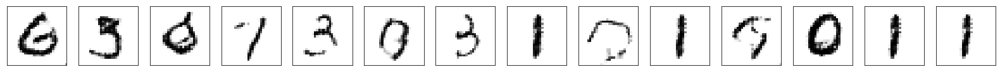

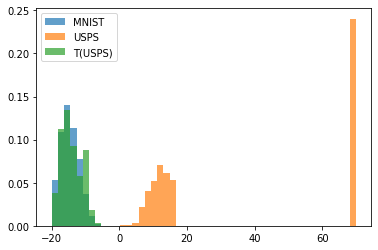

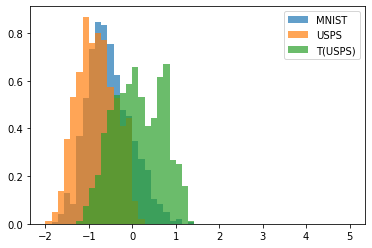

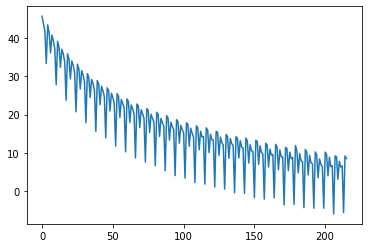

21700 tf.Tensor(2.289913035038019, shape=(), dtype=float64)
tf.Tensor(2.289913035038019, shape=(), dtype=float64)


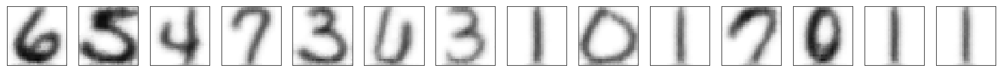

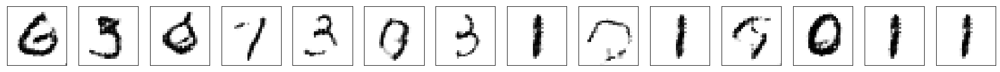

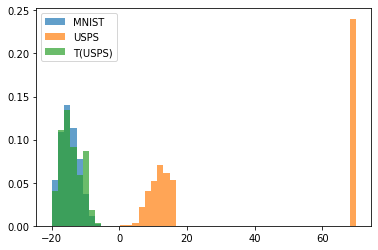

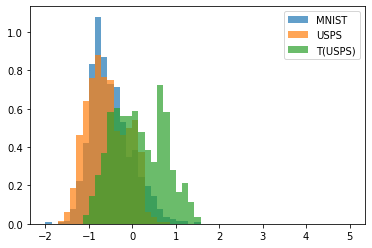

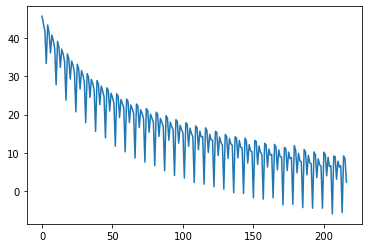

21800 tf.Tensor(7.340405692088307, shape=(), dtype=float64)
tf.Tensor(7.340405692088307, shape=(), dtype=float64)


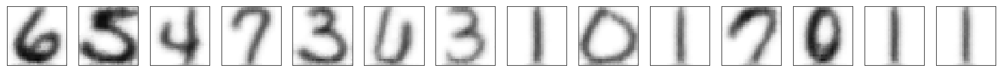

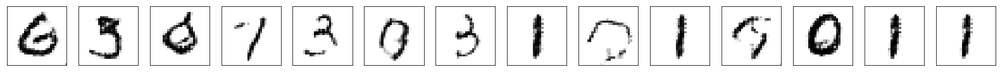

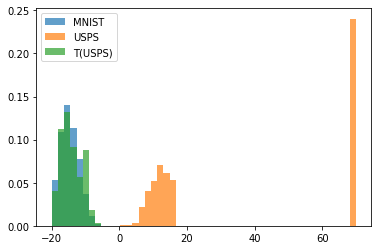

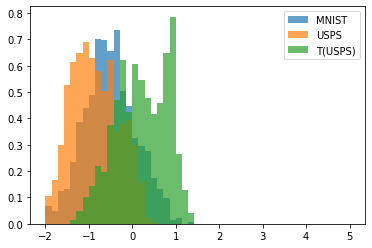

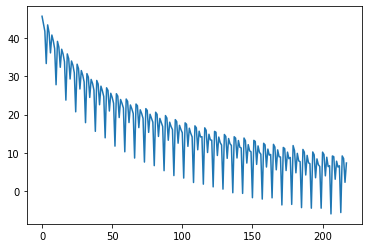

21900 tf.Tensor(5.771878325436404, shape=(), dtype=float64)
tf.Tensor(5.771878325436404, shape=(), dtype=float64)


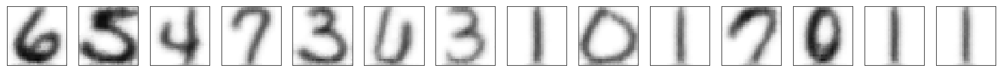

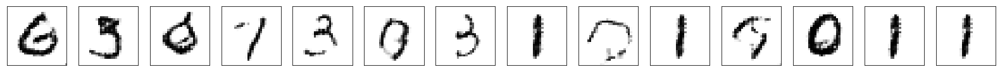

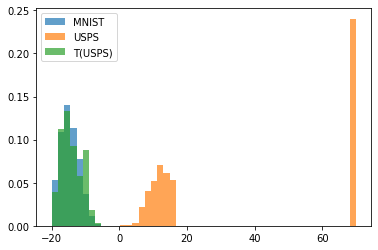

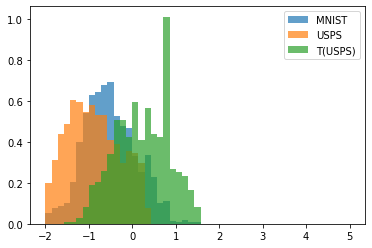

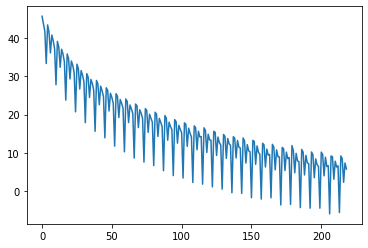

22000 tf.Tensor(5.4448302650104985, shape=(), dtype=float64)
tf.Tensor(5.4448302650104985, shape=(), dtype=float64)


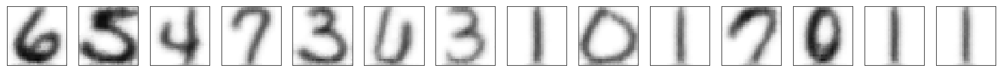

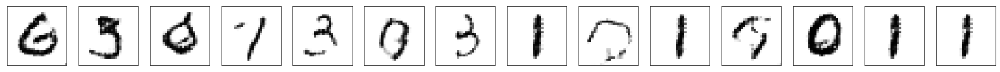

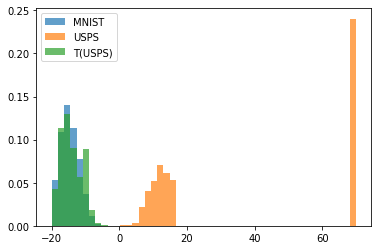

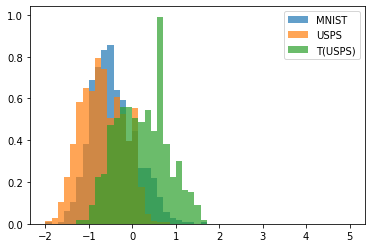

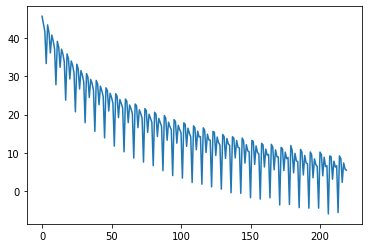

saving weights
22100 tf.Tensor(-6.379572634254767, shape=(), dtype=float64)
tf.Tensor(-6.379572634254767, shape=(), dtype=float64)


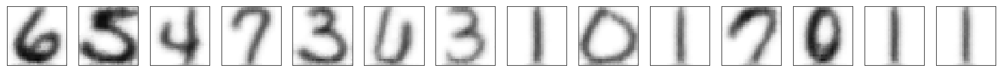

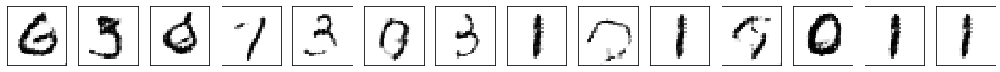

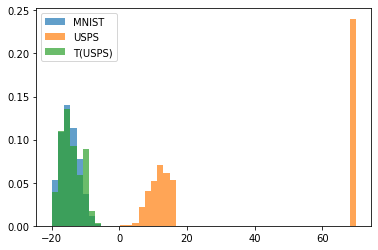

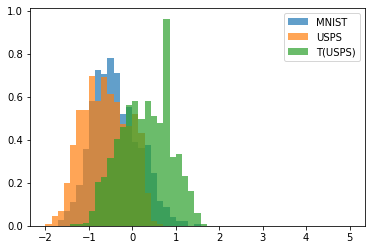

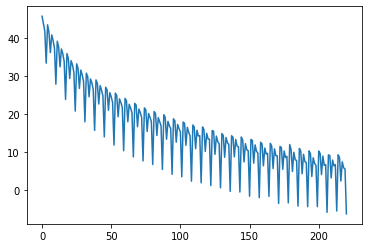

22200 tf.Tensor(9.246106599073073, shape=(), dtype=float64)
tf.Tensor(9.246106599073073, shape=(), dtype=float64)


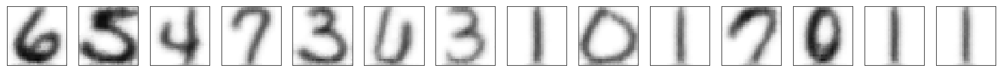

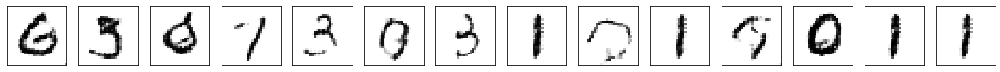

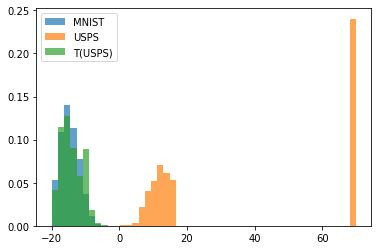

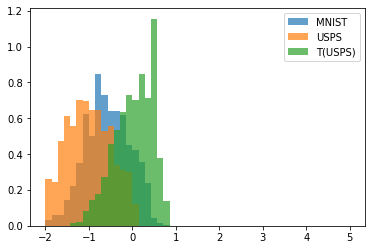

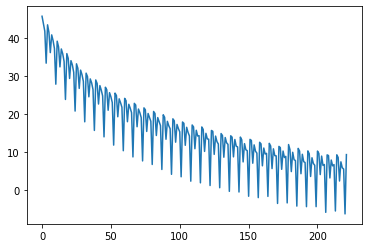

22300 tf.Tensor(8.92820889944107, shape=(), dtype=float64)
tf.Tensor(8.92820889944107, shape=(), dtype=float64)


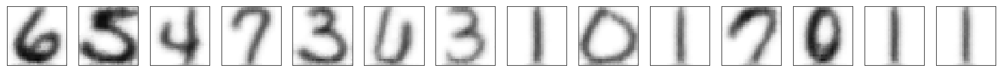

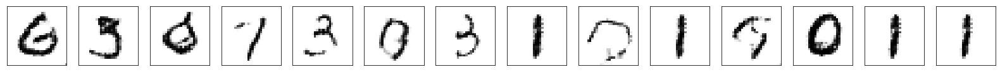

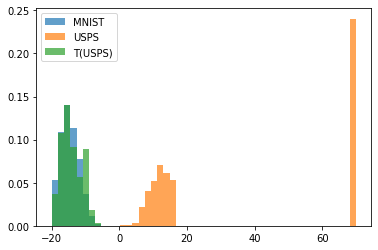

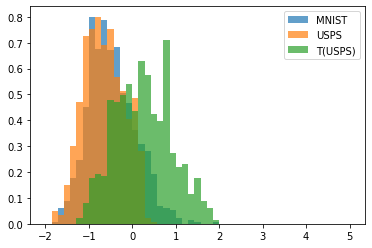

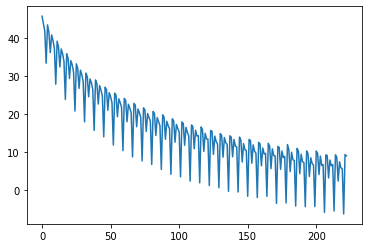

22400 tf.Tensor(2.8801639499459277, shape=(), dtype=float64)
tf.Tensor(2.8801639499459277, shape=(), dtype=float64)


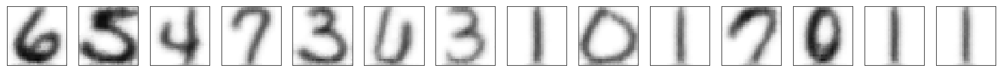

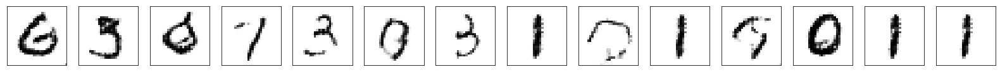

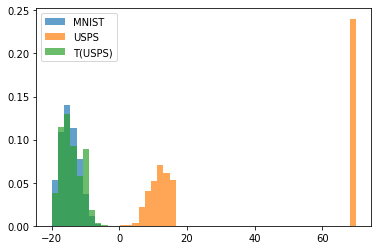

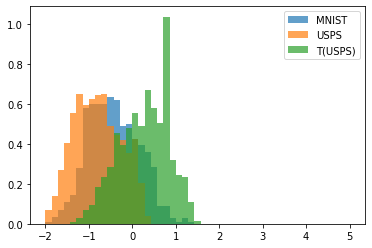

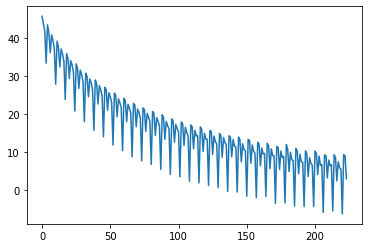

22500 tf.Tensor(7.613649576983299, shape=(), dtype=float64)
tf.Tensor(7.613649576983299, shape=(), dtype=float64)


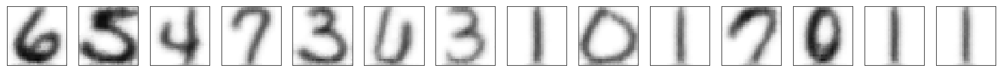

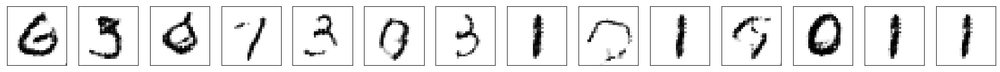

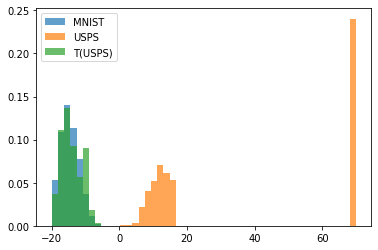

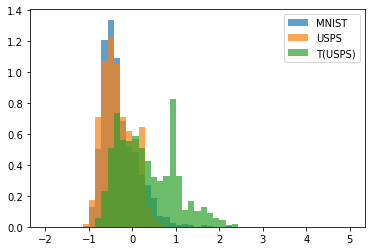

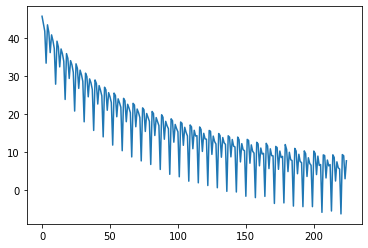

22600 tf.Tensor(5.329719841129862, shape=(), dtype=float64)
tf.Tensor(5.329719841129862, shape=(), dtype=float64)


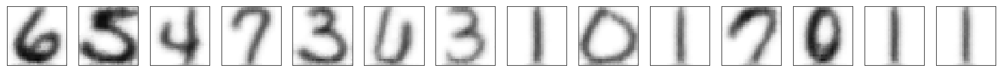

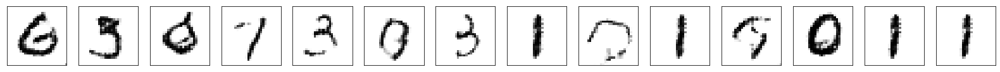

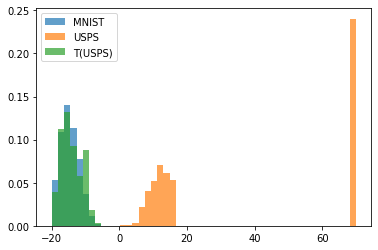

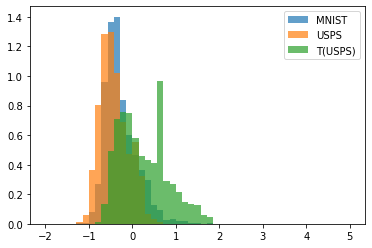

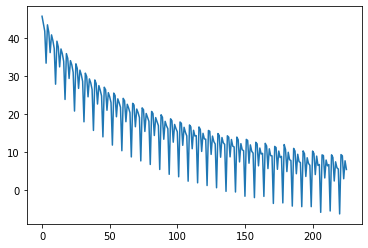

22700 tf.Tensor(5.95961965628204, shape=(), dtype=float64)
tf.Tensor(5.95961965628204, shape=(), dtype=float64)


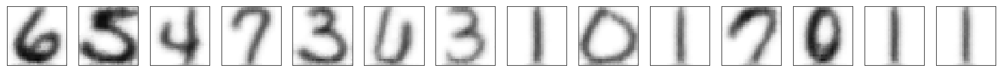

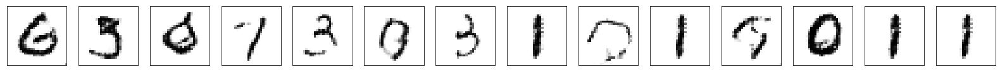

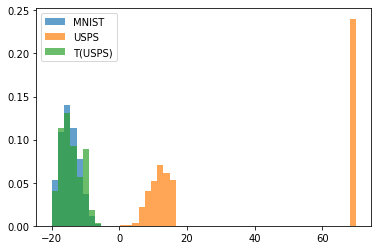

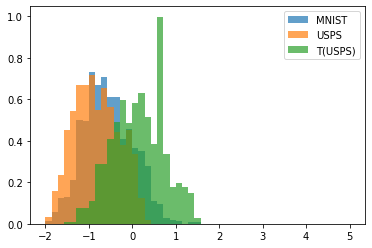

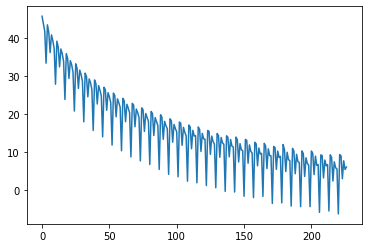

22800 tf.Tensor(-6.109100408490303, shape=(), dtype=float64)
tf.Tensor(-6.109100408490303, shape=(), dtype=float64)


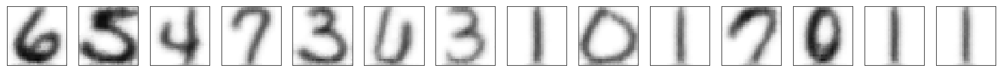

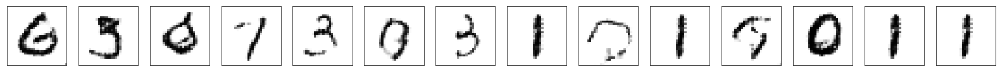

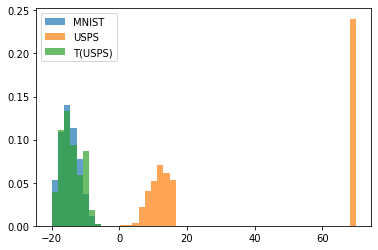

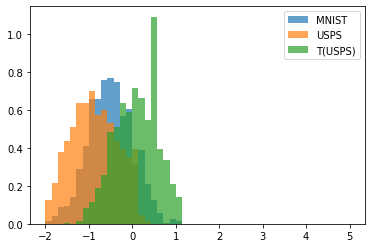

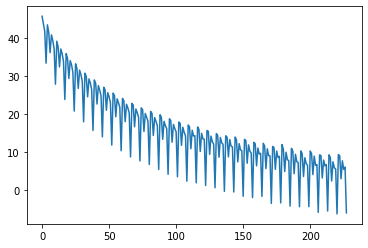

22900 tf.Tensor(8.49094054422244, shape=(), dtype=float64)
tf.Tensor(8.49094054422244, shape=(), dtype=float64)


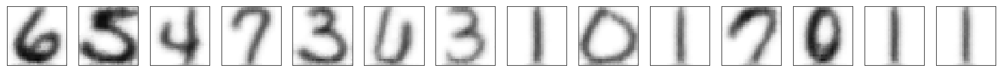

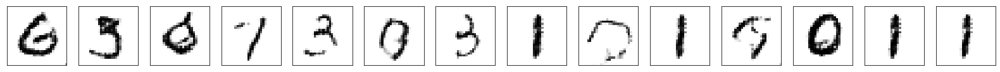

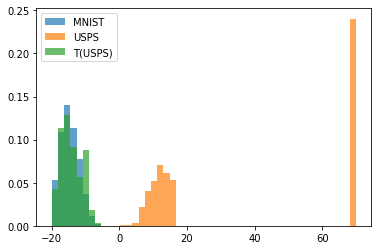

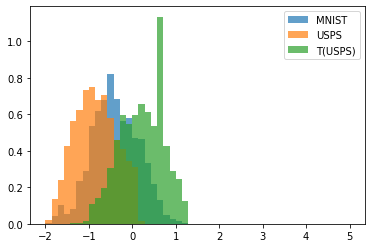

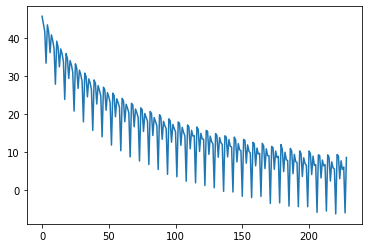

23000 tf.Tensor(8.450345369868074, shape=(), dtype=float64)
tf.Tensor(8.450345369868074, shape=(), dtype=float64)


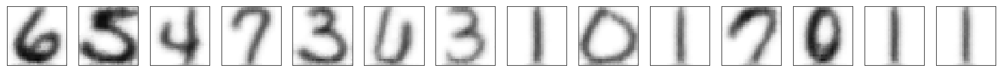

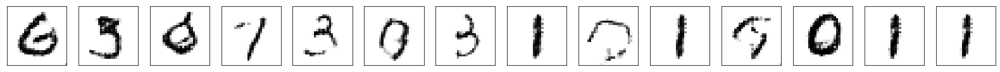

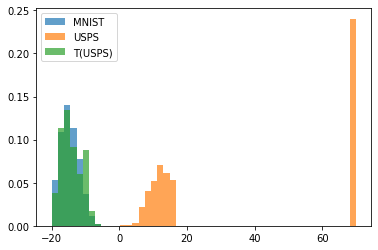

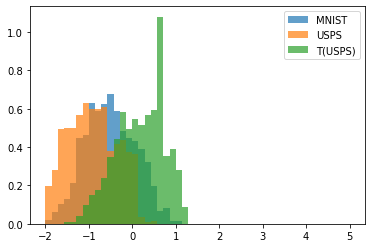

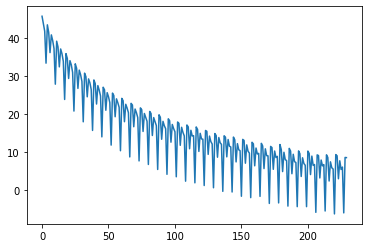

saving weights
23100 tf.Tensor(2.994950087669867, shape=(), dtype=float64)
tf.Tensor(2.994950087669867, shape=(), dtype=float64)


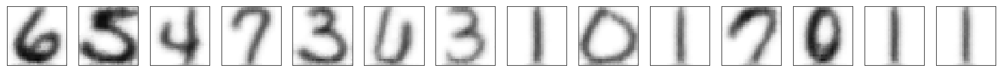

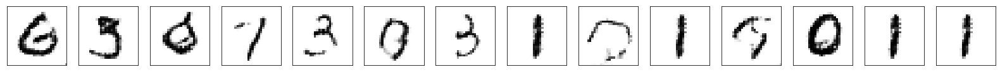

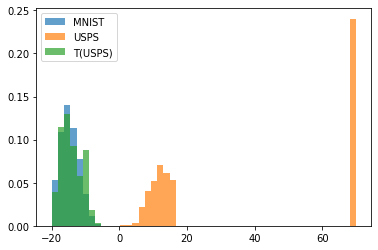

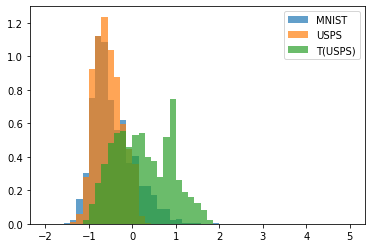

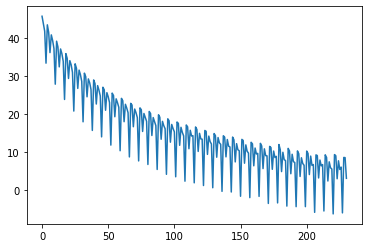

23200 tf.Tensor(7.513948392067682, shape=(), dtype=float64)
tf.Tensor(7.513948392067682, shape=(), dtype=float64)


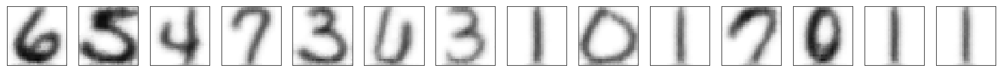

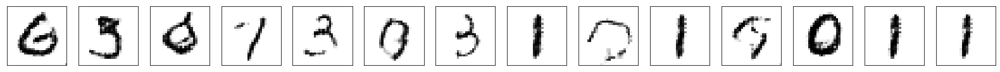

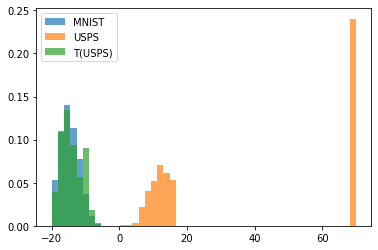

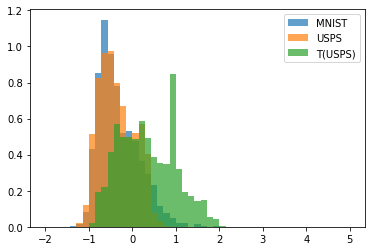

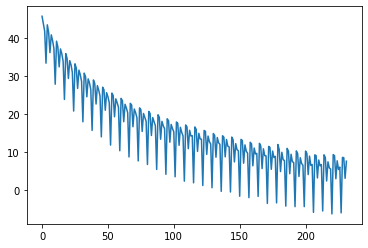

23300 tf.Tensor(5.01346306977608, shape=(), dtype=float64)
tf.Tensor(5.01346306977608, shape=(), dtype=float64)


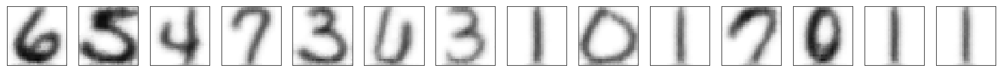

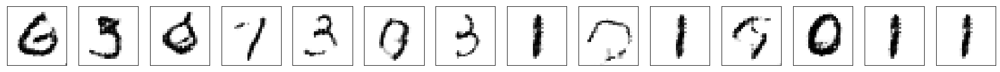

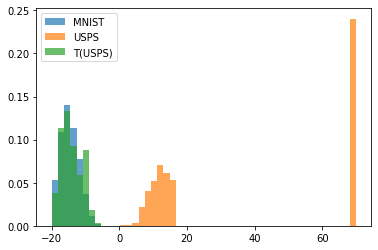

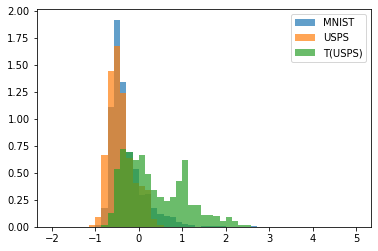

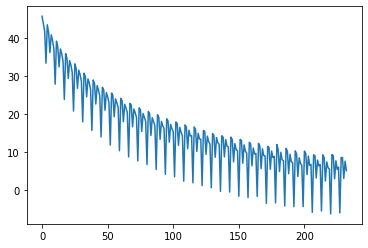

23400 tf.Tensor(4.901808226194795, shape=(), dtype=float64)
tf.Tensor(4.901808226194795, shape=(), dtype=float64)


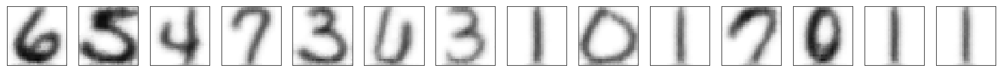

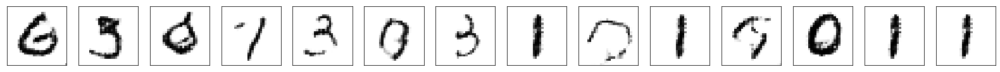

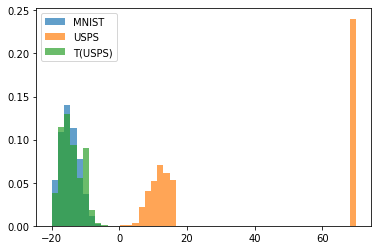

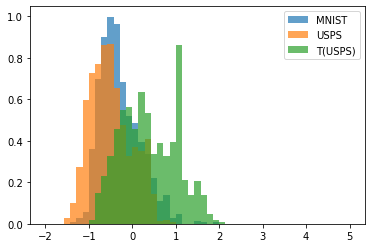

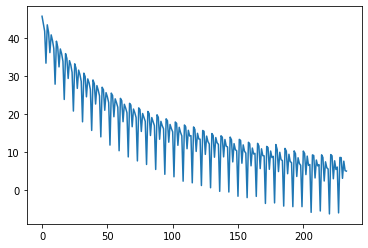

23500 tf.Tensor(-7.615752147883917, shape=(), dtype=float64)
tf.Tensor(-7.615752147883917, shape=(), dtype=float64)


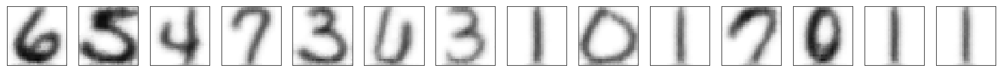

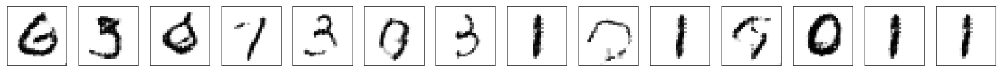

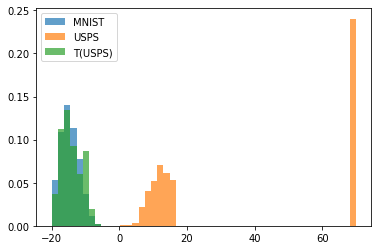

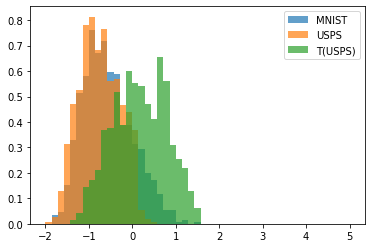

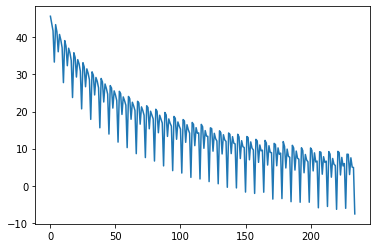

23600 tf.Tensor(7.776388476983097, shape=(), dtype=float64)
tf.Tensor(7.776388476983097, shape=(), dtype=float64)


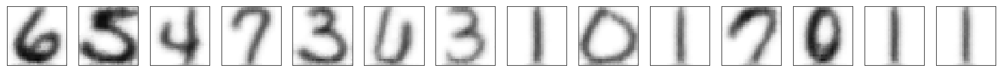

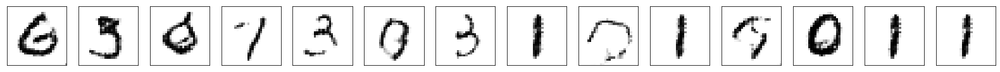

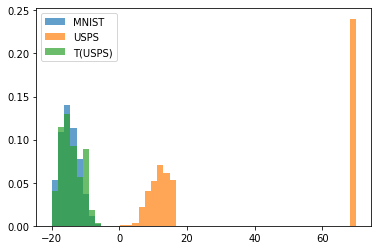

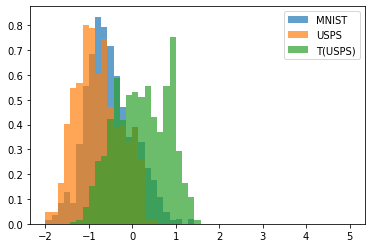

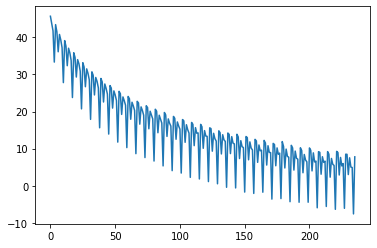

23700 tf.Tensor(7.580288896236759, shape=(), dtype=float64)
tf.Tensor(7.580288896236759, shape=(), dtype=float64)


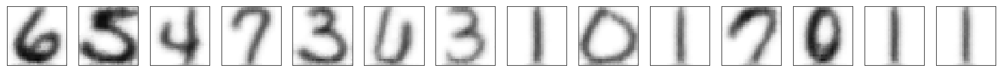

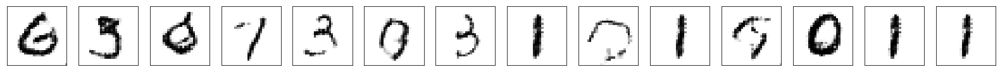

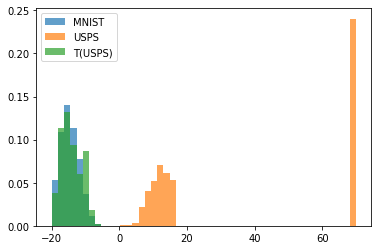

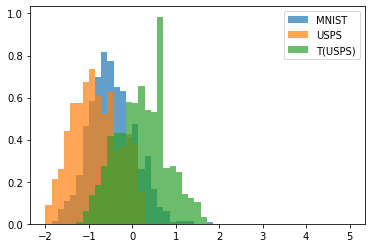

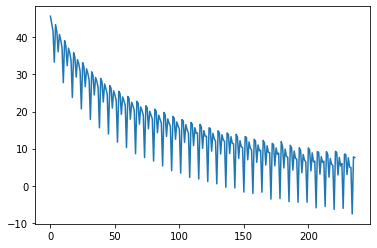

23800 tf.Tensor(1.561723219386959, shape=(), dtype=float64)
tf.Tensor(1.561723219386959, shape=(), dtype=float64)


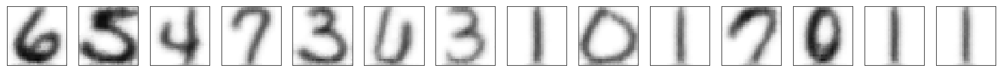

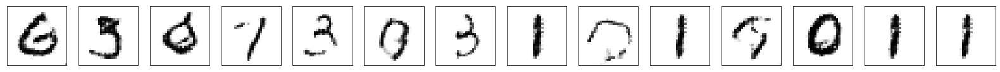

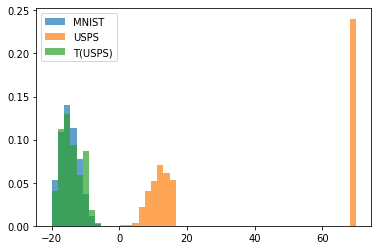

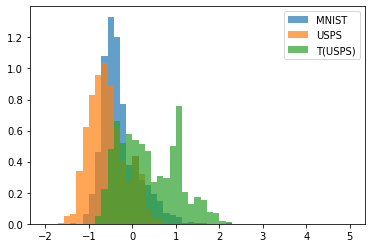

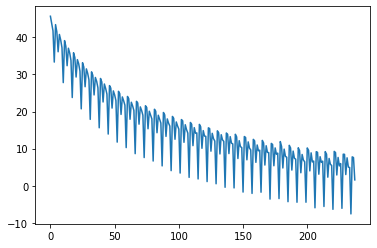

23900 tf.Tensor(6.85657089768533, shape=(), dtype=float64)
tf.Tensor(6.85657089768533, shape=(), dtype=float64)


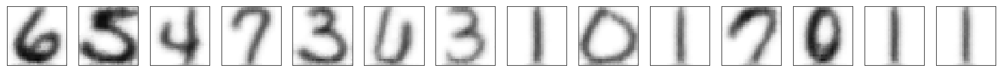

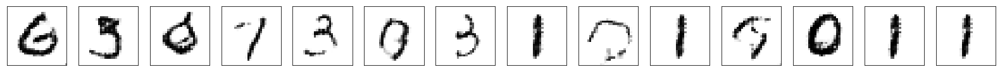

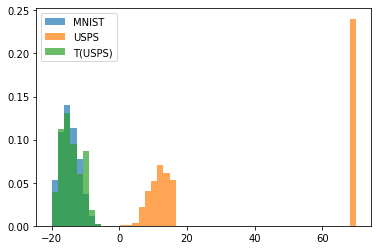

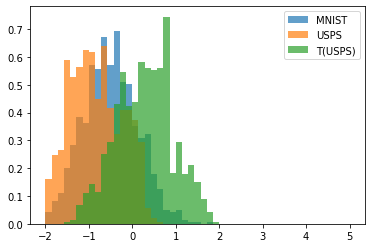

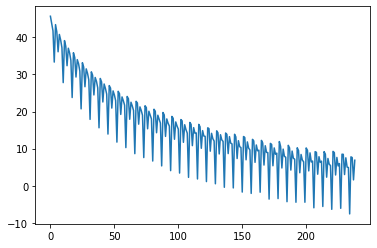

24000 tf.Tensor(5.232527743005171, shape=(), dtype=float64)
tf.Tensor(5.232527743005171, shape=(), dtype=float64)


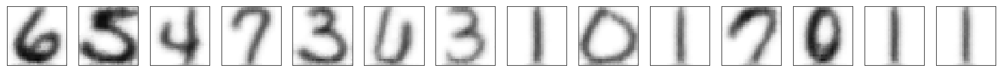

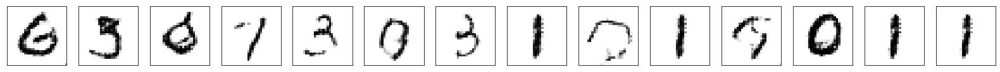

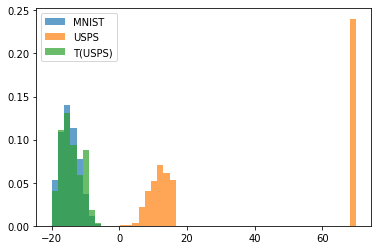

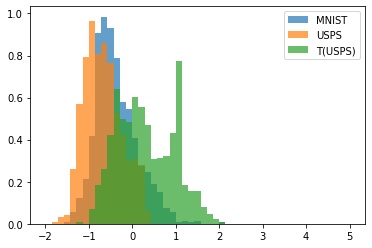

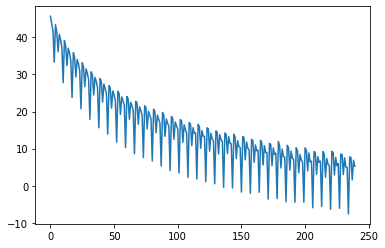

saving weights
24100 tf.Tensor(5.449437312451508, shape=(), dtype=float64)
tf.Tensor(5.449437312451508, shape=(), dtype=float64)


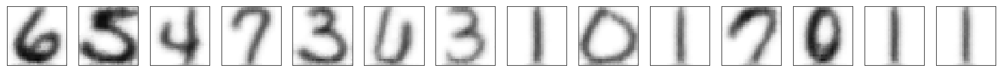

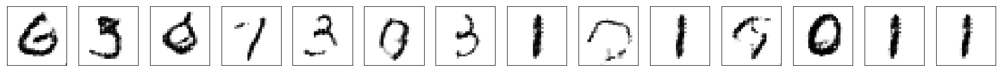

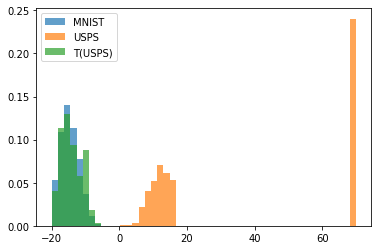

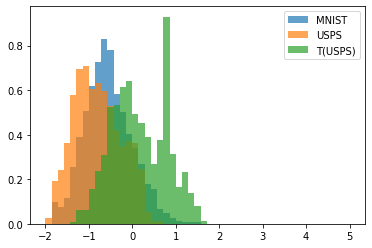

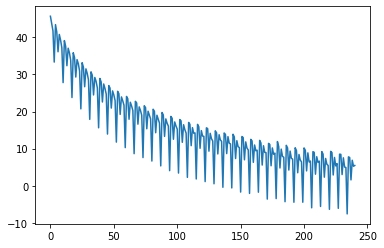

24200 tf.Tensor(-7.321733968018371, shape=(), dtype=float64)
tf.Tensor(-7.321733968018371, shape=(), dtype=float64)


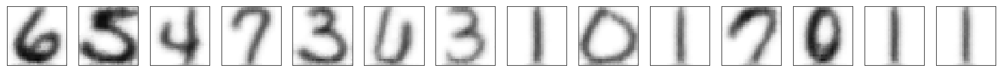

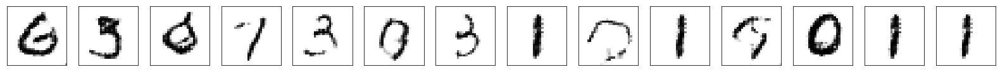

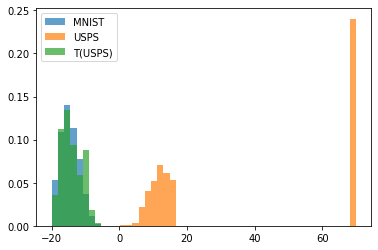

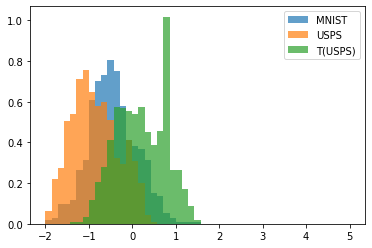

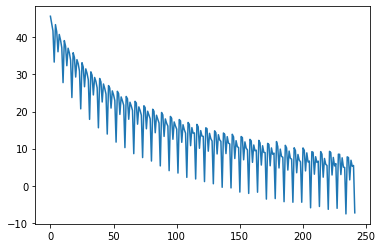

24300 tf.Tensor(7.546939089724763, shape=(), dtype=float64)
tf.Tensor(7.546939089724763, shape=(), dtype=float64)


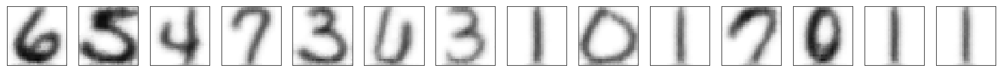

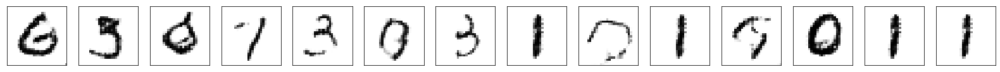

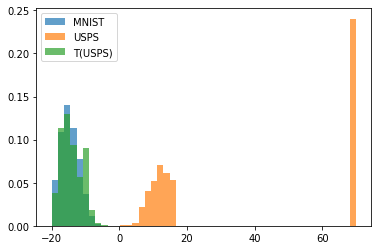

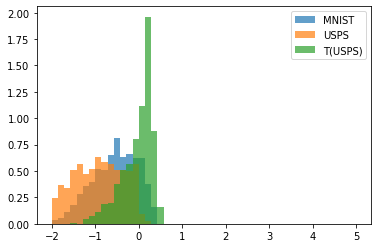

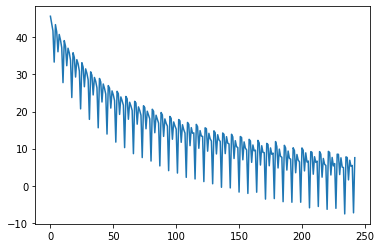

24400 tf.Tensor(6.960244367007142, shape=(), dtype=float64)
tf.Tensor(6.960244367007142, shape=(), dtype=float64)


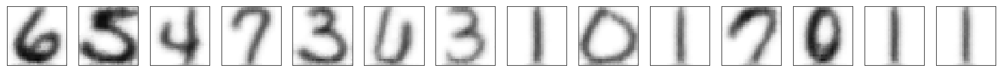

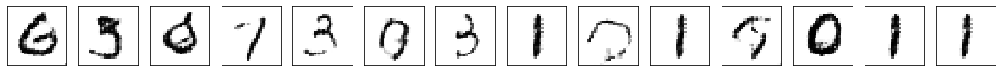

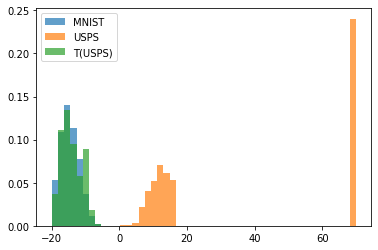

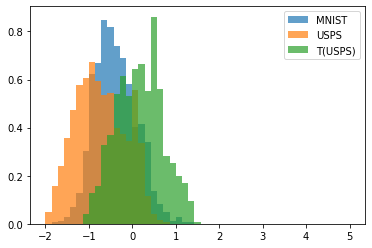

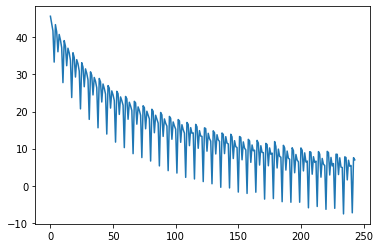

24500 tf.Tensor(1.0332688697569594, shape=(), dtype=float64)
tf.Tensor(1.0332688697569594, shape=(), dtype=float64)


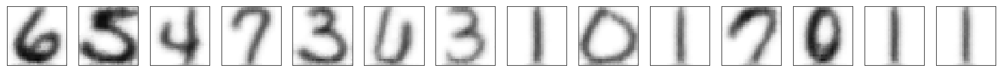

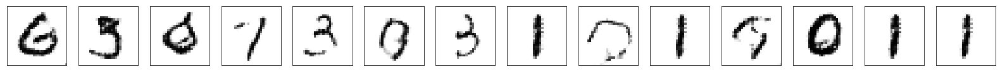

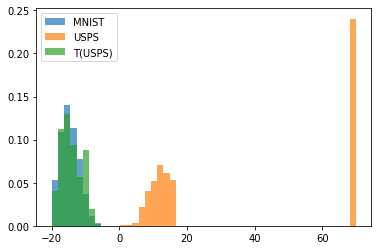

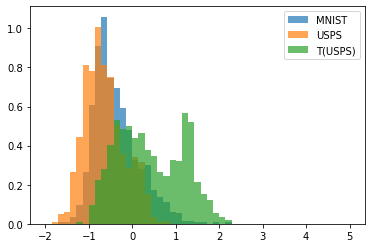

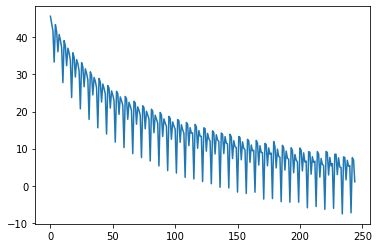

24600 tf.Tensor(7.113452771239679, shape=(), dtype=float64)
tf.Tensor(7.113452771239679, shape=(), dtype=float64)


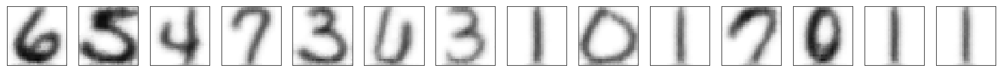

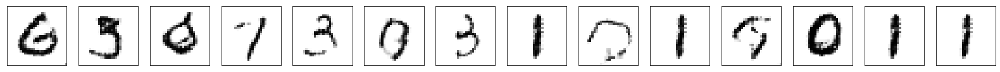

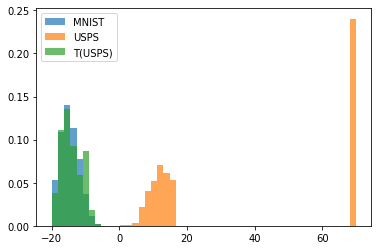

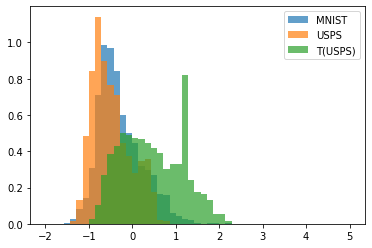

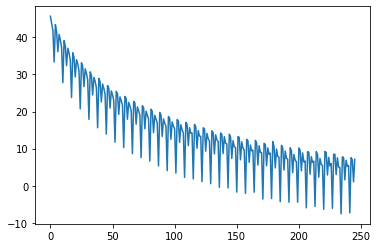

24700 tf.Tensor(5.052894175165083, shape=(), dtype=float64)
tf.Tensor(5.052894175165083, shape=(), dtype=float64)


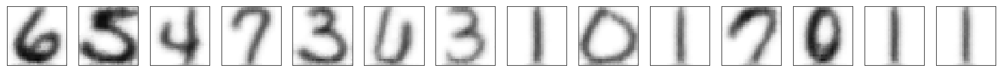

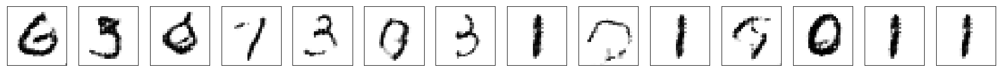

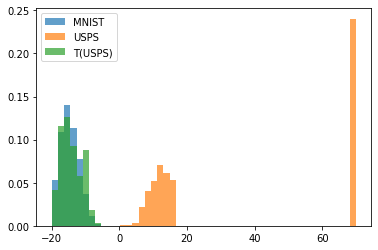

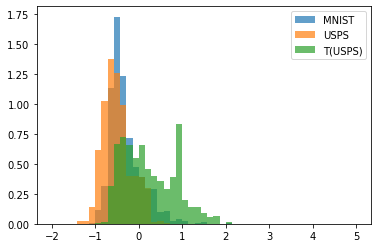

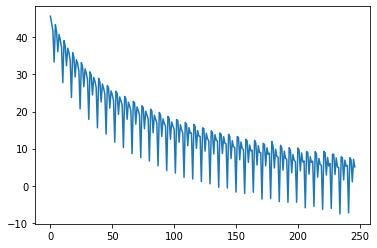

24800 tf.Tensor(6.044980648053368, shape=(), dtype=float64)
tf.Tensor(6.044980648053368, shape=(), dtype=float64)


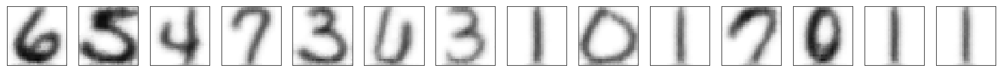

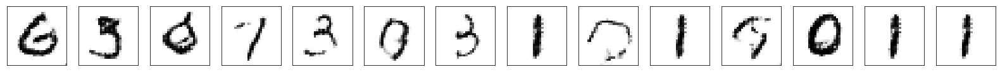

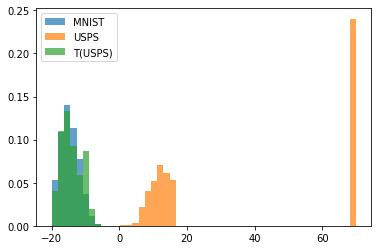

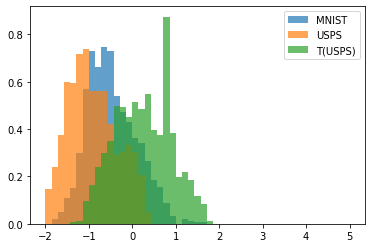

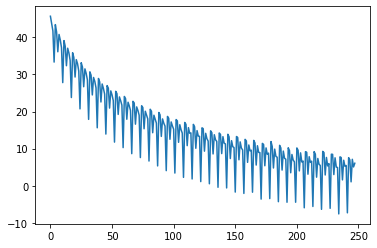

24900 tf.Tensor(-5.612077654650754, shape=(), dtype=float64)
tf.Tensor(-5.612077654650754, shape=(), dtype=float64)


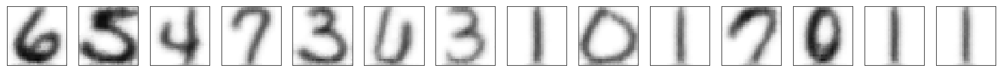

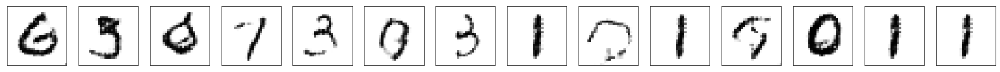

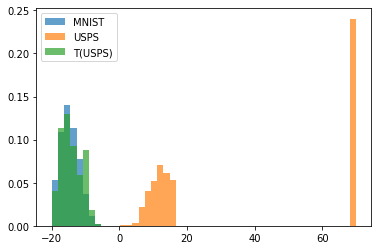

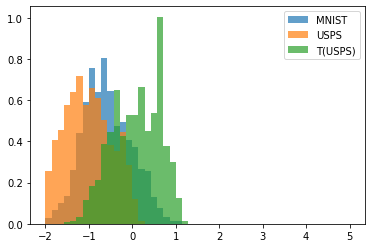

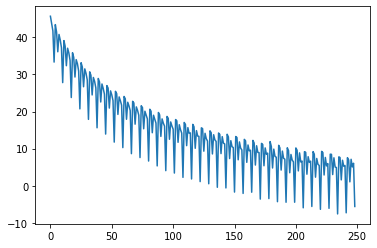

25000 tf.Tensor(7.834344998739546, shape=(), dtype=float64)
tf.Tensor(7.834344998739546, shape=(), dtype=float64)


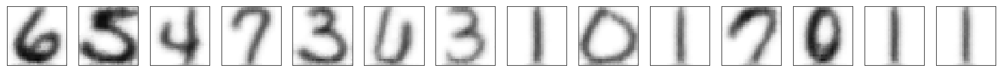

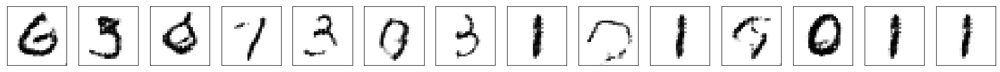

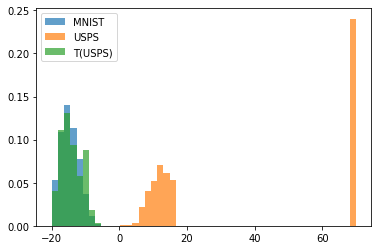

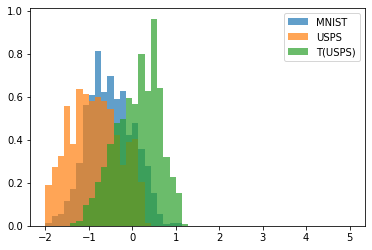

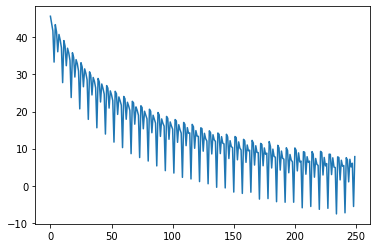

saving weights
25100 tf.Tensor(6.901615907294328, shape=(), dtype=float64)
tf.Tensor(6.901615907294328, shape=(), dtype=float64)


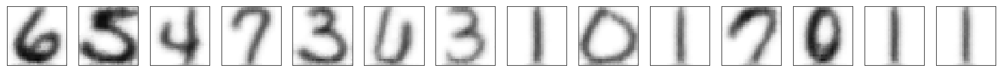

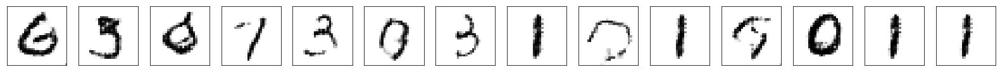

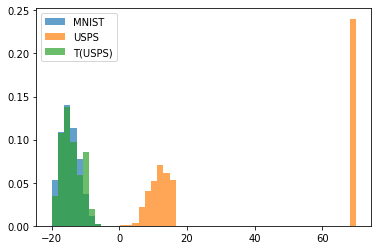

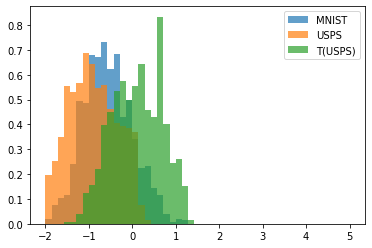

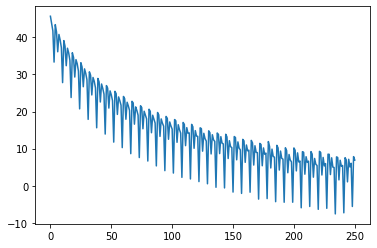

25200 tf.Tensor(1.0151002115336603, shape=(), dtype=float64)
tf.Tensor(1.0151002115336603, shape=(), dtype=float64)


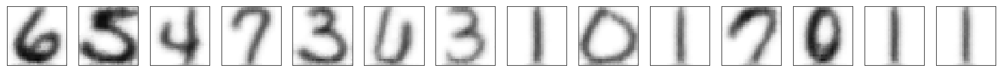

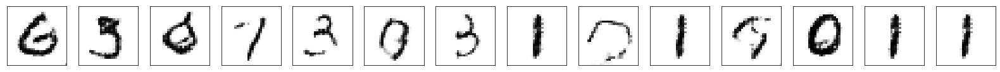

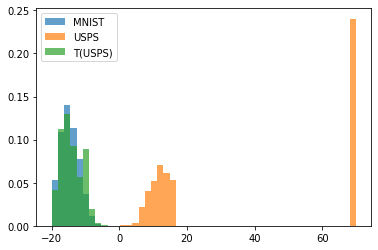

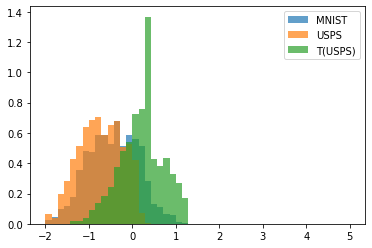

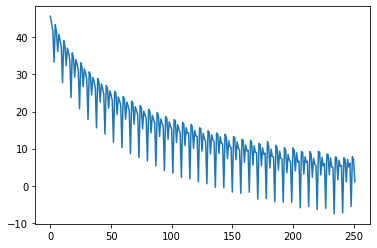

25300 tf.Tensor(5.996230598945566, shape=(), dtype=float64)
tf.Tensor(5.996230598945566, shape=(), dtype=float64)


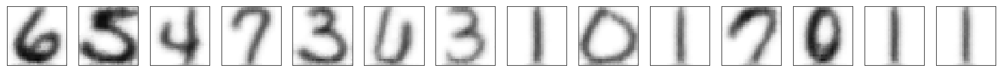

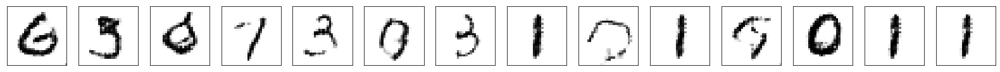

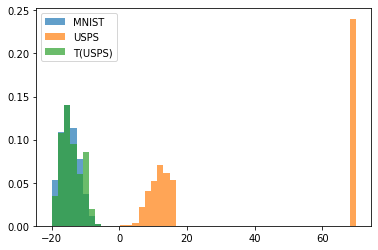

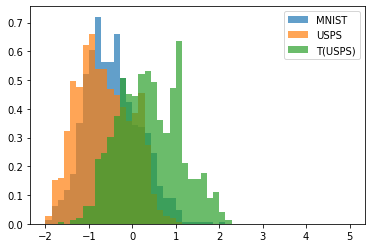

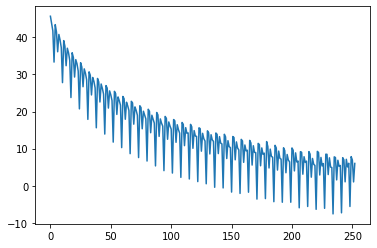

25400 tf.Tensor(4.10282101292772, shape=(), dtype=float64)
tf.Tensor(4.10282101292772, shape=(), dtype=float64)


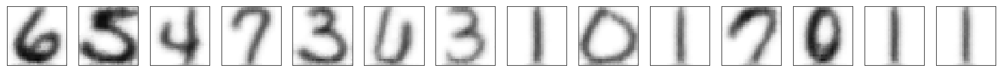

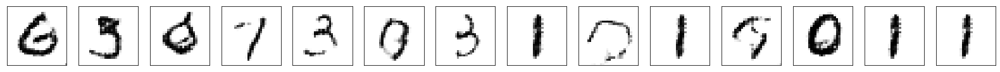

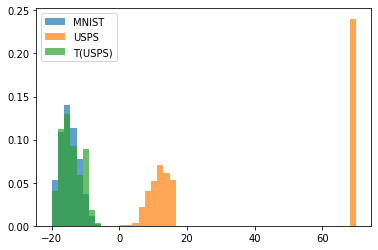

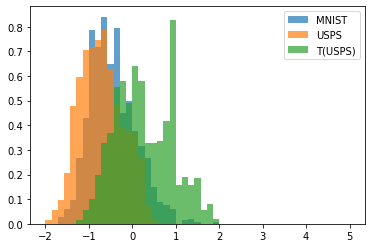

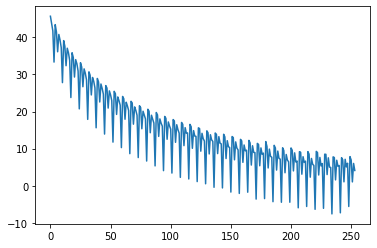

25500 tf.Tensor(3.997431047107895, shape=(), dtype=float64)
tf.Tensor(3.997431047107895, shape=(), dtype=float64)


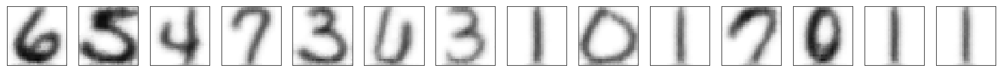

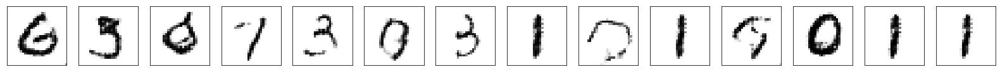

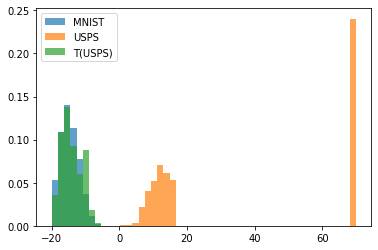

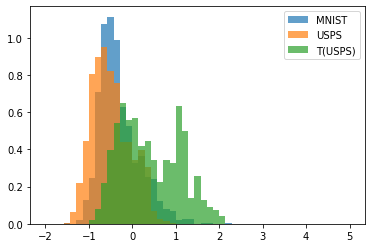

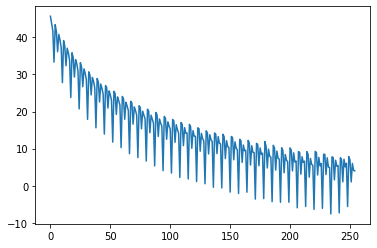

25600 tf.Tensor(-8.427684088696914, shape=(), dtype=float64)
tf.Tensor(-8.427684088696914, shape=(), dtype=float64)


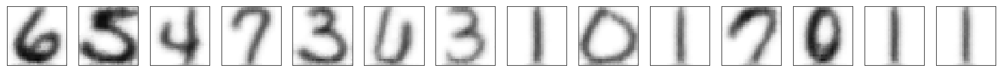

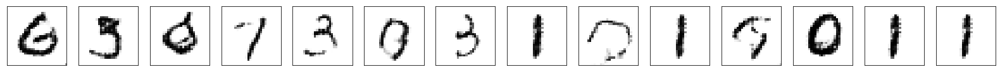

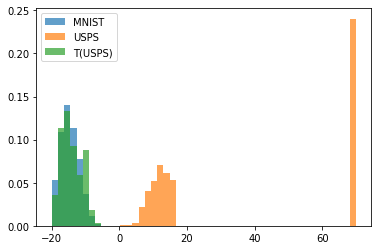

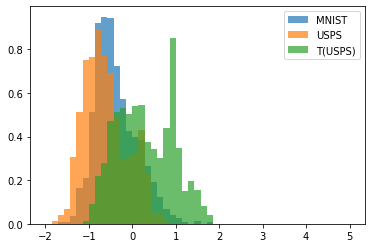

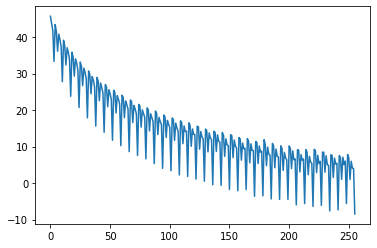

25700 tf.Tensor(7.104993133656443, shape=(), dtype=float64)
tf.Tensor(7.104993133656443, shape=(), dtype=float64)


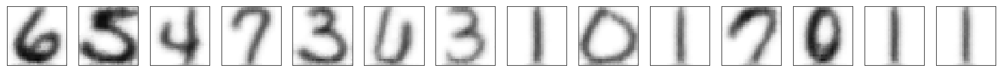

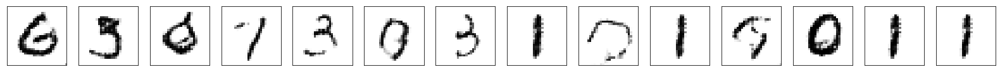

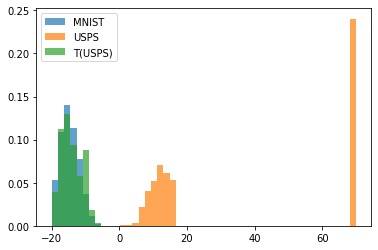

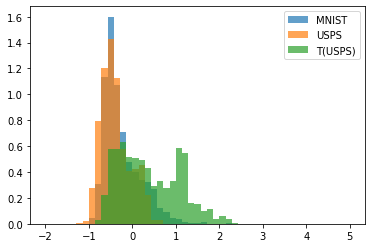

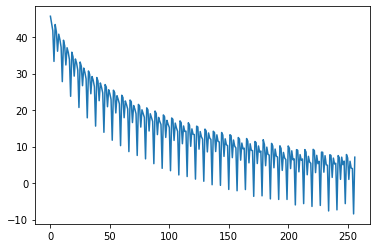

25800 tf.Tensor(6.736980104105783, shape=(), dtype=float64)
tf.Tensor(6.736980104105783, shape=(), dtype=float64)


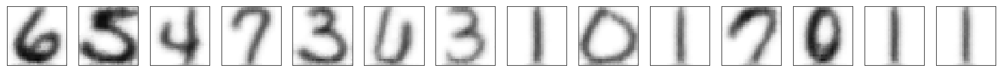

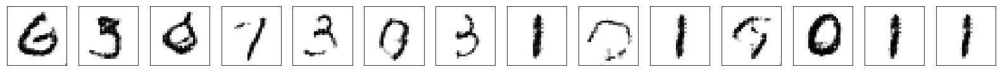

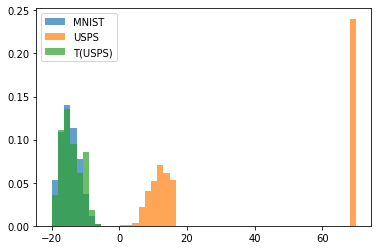

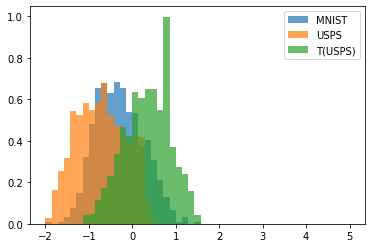

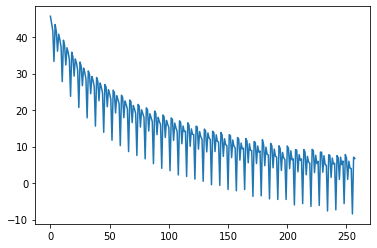

25900 tf.Tensor(1.5846748755361908, shape=(), dtype=float64)
tf.Tensor(1.5846748755361908, shape=(), dtype=float64)


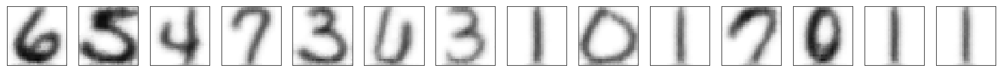

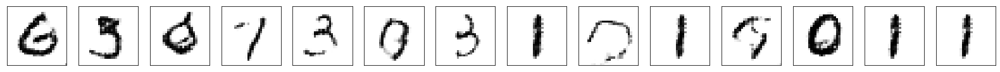

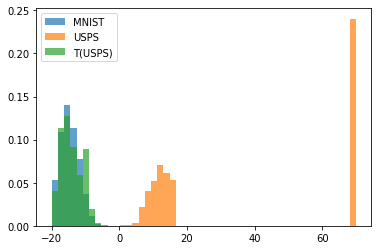

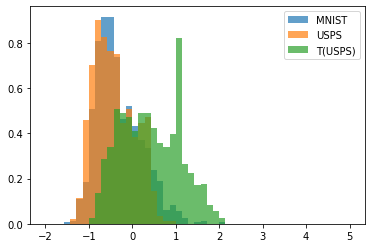

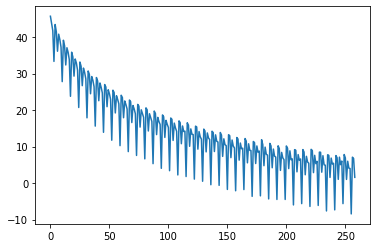

26000 tf.Tensor(6.19923719221579, shape=(), dtype=float64)
tf.Tensor(6.19923719221579, shape=(), dtype=float64)


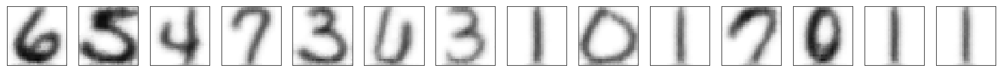

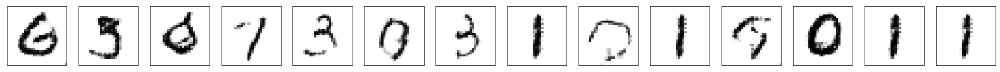

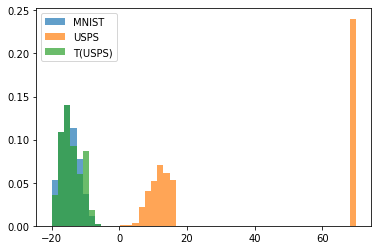

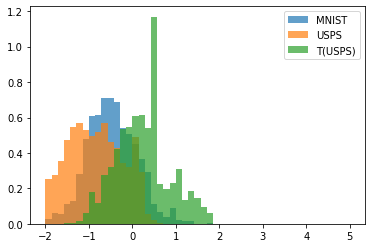

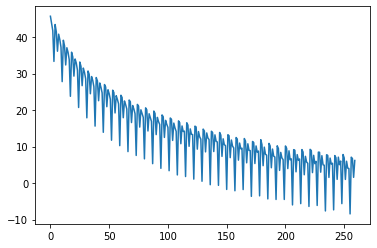

saving weights
26100 tf.Tensor(3.880720392484374, shape=(), dtype=float64)
tf.Tensor(3.880720392484374, shape=(), dtype=float64)


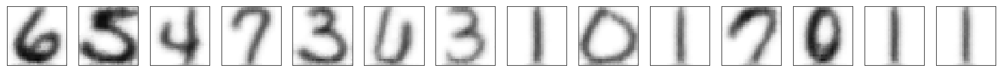

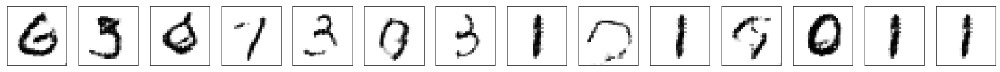

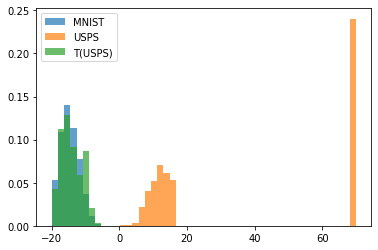

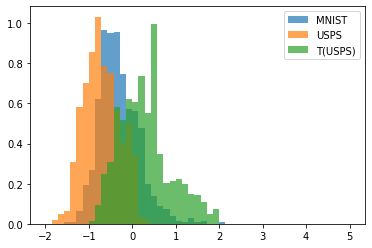

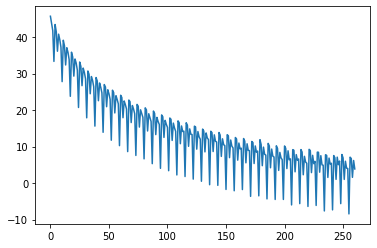

26200 tf.Tensor(3.533473292200167, shape=(), dtype=float64)
tf.Tensor(3.533473292200167, shape=(), dtype=float64)


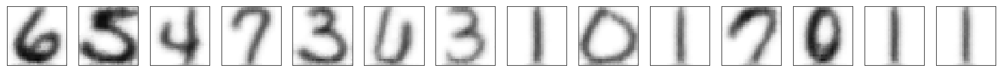

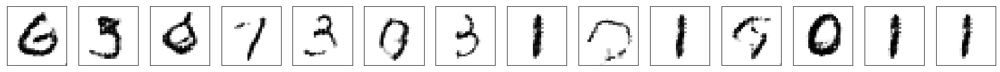

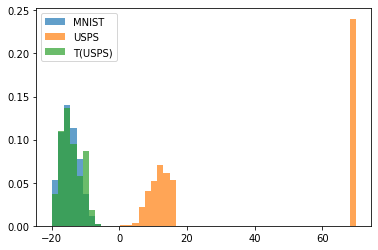

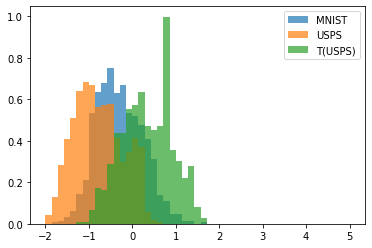

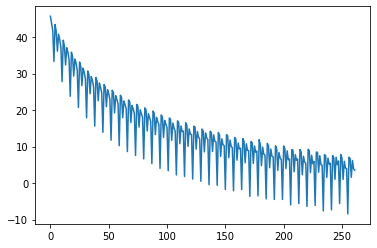

26300 tf.Tensor(-8.392290538147314, shape=(), dtype=float64)
tf.Tensor(-8.392290538147314, shape=(), dtype=float64)


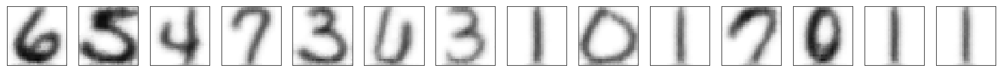

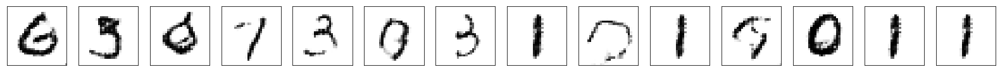

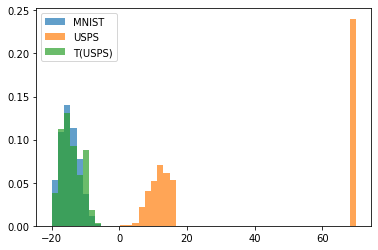

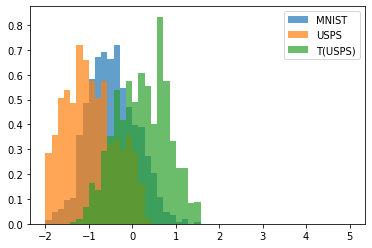

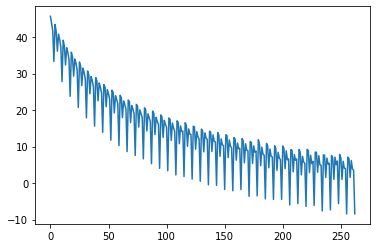

26400 tf.Tensor(7.181933905003429, shape=(), dtype=float64)
tf.Tensor(7.181933905003429, shape=(), dtype=float64)


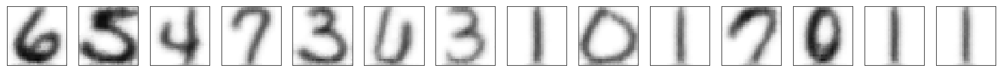

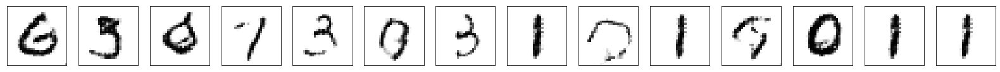

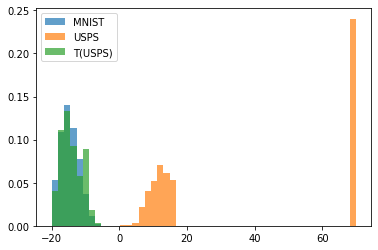

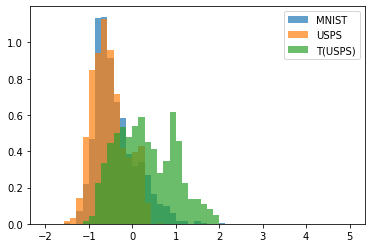

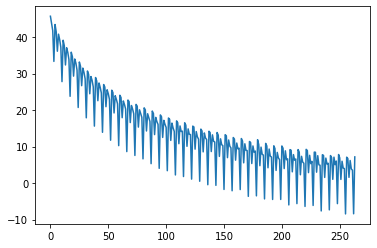

26500 tf.Tensor(6.722287408842611, shape=(), dtype=float64)
tf.Tensor(6.722287408842611, shape=(), dtype=float64)


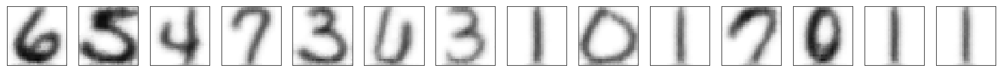

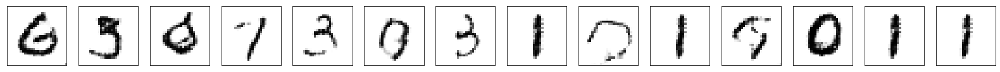

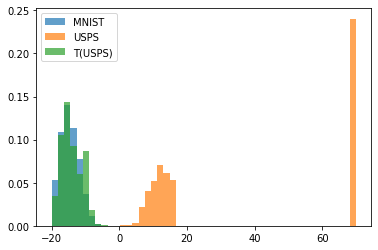

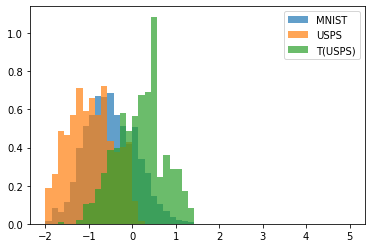

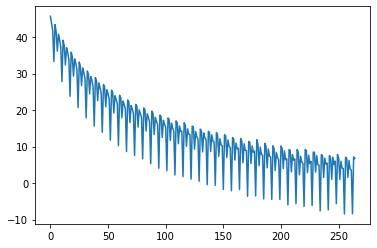

26600 tf.Tensor(1.3147070469412085, shape=(), dtype=float64)
tf.Tensor(1.3147070469412085, shape=(), dtype=float64)


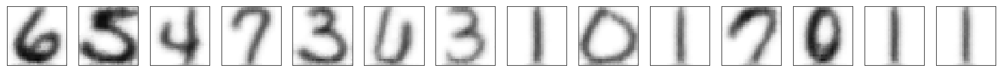

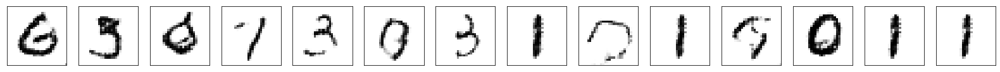

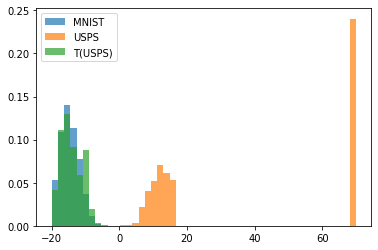

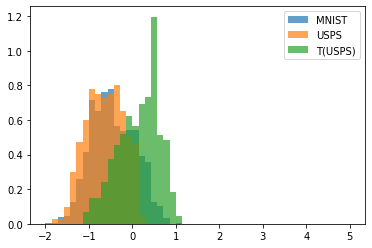

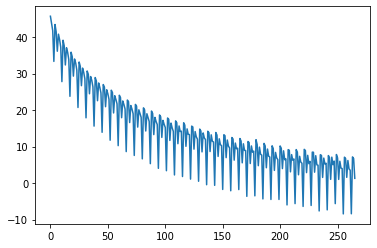

26700 tf.Tensor(6.316096272644302, shape=(), dtype=float64)
tf.Tensor(6.316096272644302, shape=(), dtype=float64)


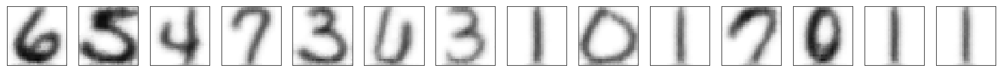

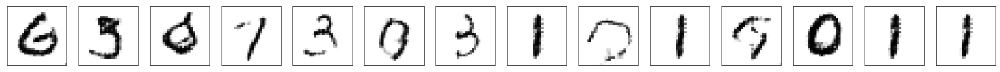

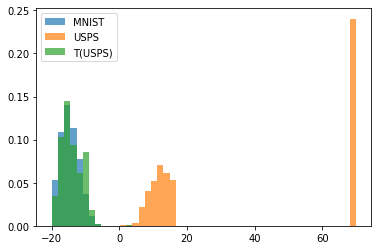

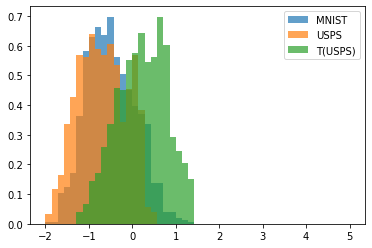

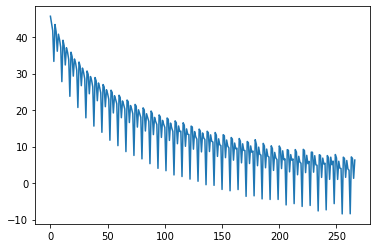

26800 tf.Tensor(4.140468016627999, shape=(), dtype=float64)
tf.Tensor(4.140468016627999, shape=(), dtype=float64)


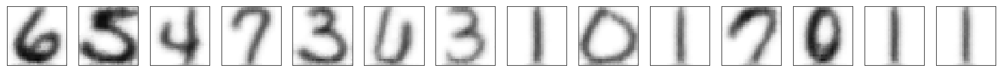

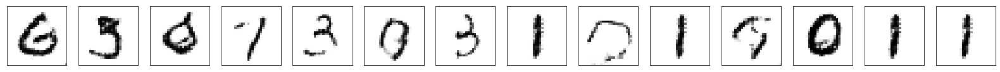

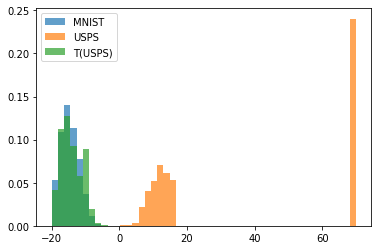

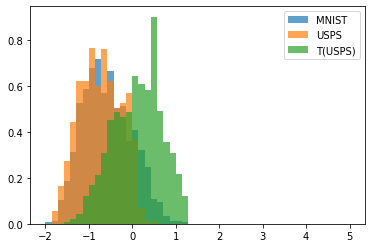

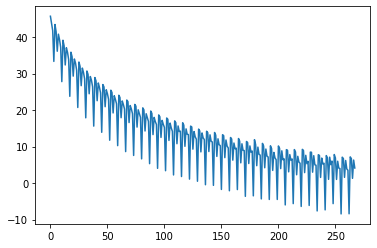

26900 tf.Tensor(4.15562071432003, shape=(), dtype=float64)
tf.Tensor(4.15562071432003, shape=(), dtype=float64)


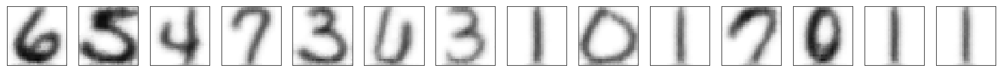

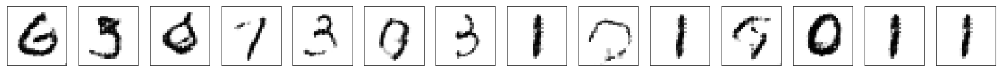

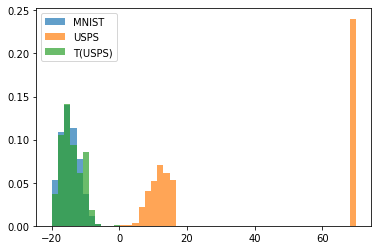

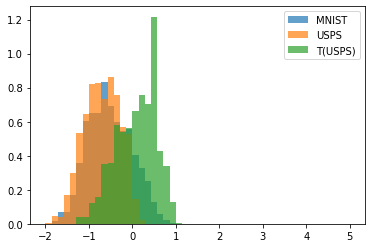

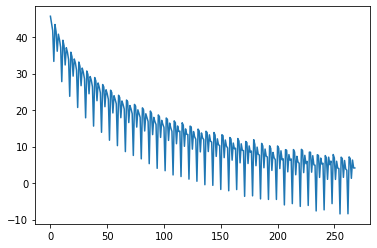

27000 tf.Tensor(-8.409075274481822, shape=(), dtype=float64)
tf.Tensor(-8.409075274481822, shape=(), dtype=float64)


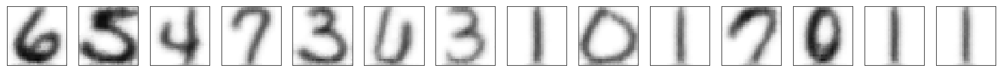

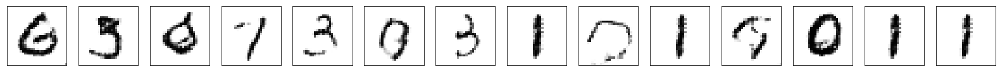

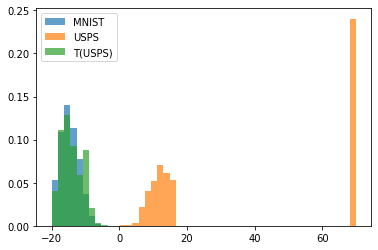

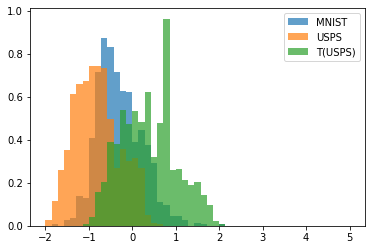

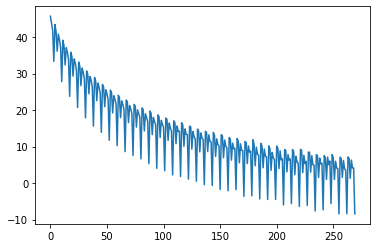

saving weights
27100 tf.Tensor(6.901924361990705, shape=(), dtype=float64)
tf.Tensor(6.901924361990705, shape=(), dtype=float64)


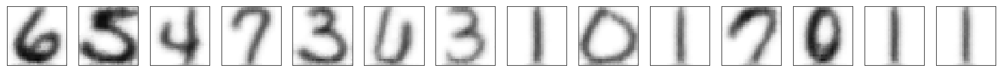

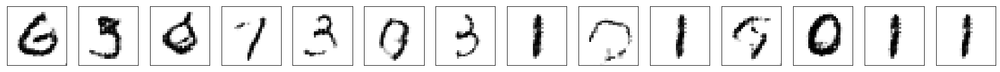

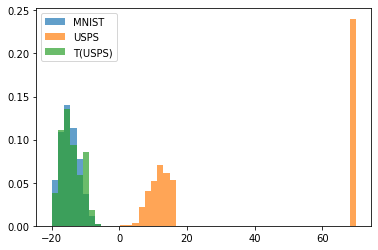

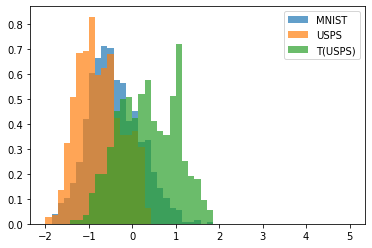

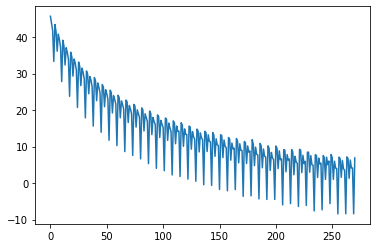

27200 tf.Tensor(6.529094752366181, shape=(), dtype=float64)
tf.Tensor(6.529094752366181, shape=(), dtype=float64)


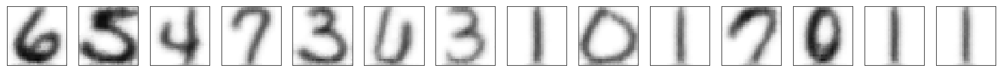

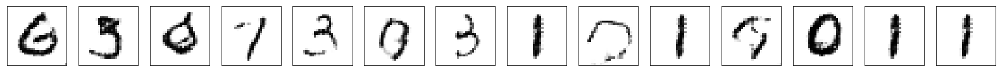

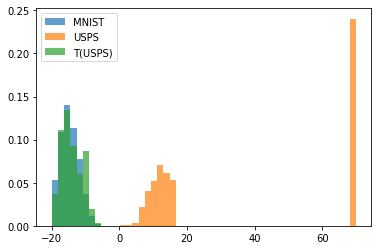

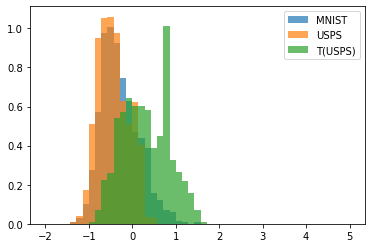

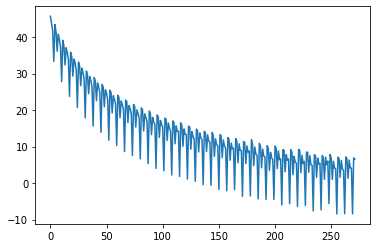

27300 tf.Tensor(1.4345623808697638, shape=(), dtype=float64)
tf.Tensor(1.4345623808697638, shape=(), dtype=float64)


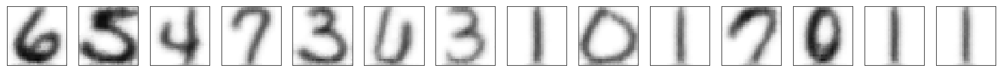

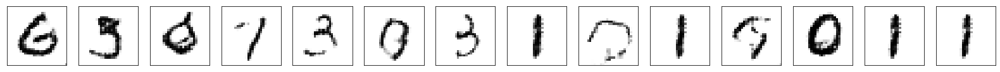

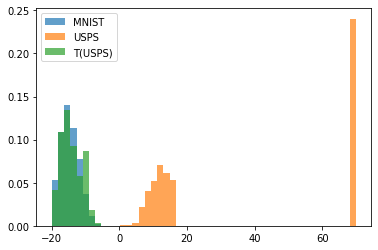

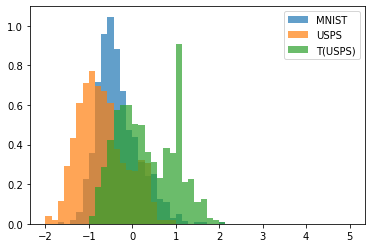

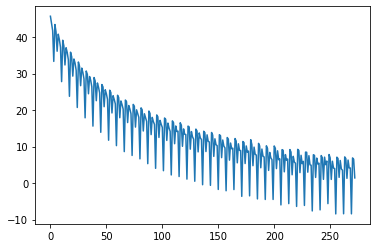

27400 tf.Tensor(6.24899904762794, shape=(), dtype=float64)
tf.Tensor(6.24899904762794, shape=(), dtype=float64)


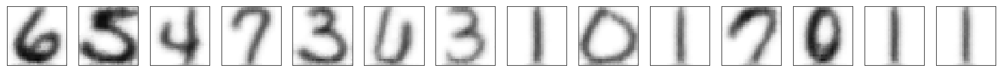

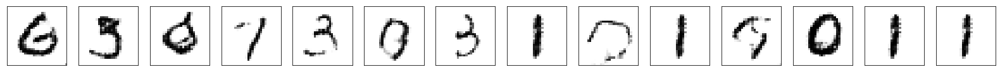

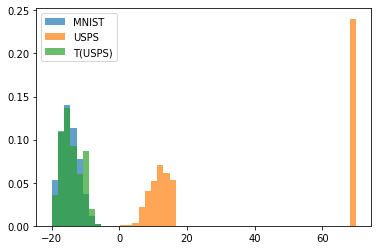

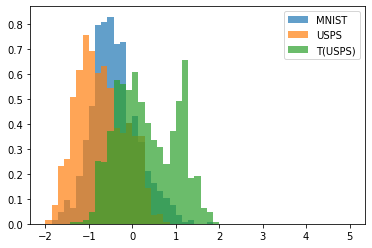

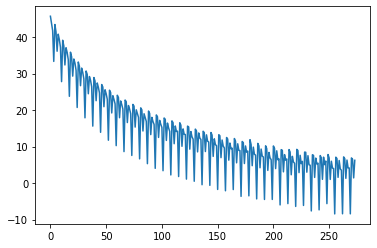

27500 tf.Tensor(5.0837891255016885, shape=(), dtype=float64)
tf.Tensor(5.0837891255016885, shape=(), dtype=float64)


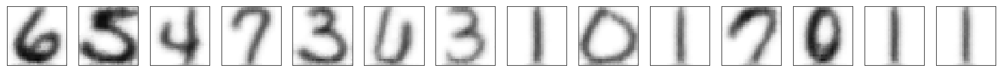

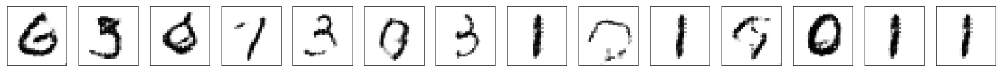

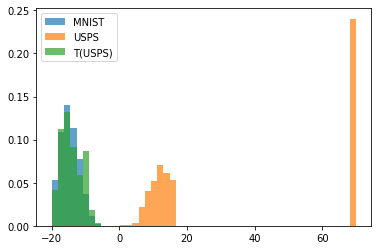

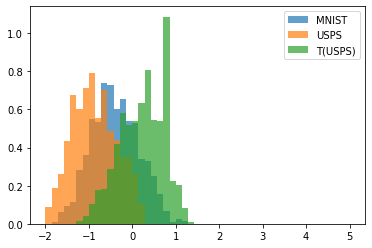

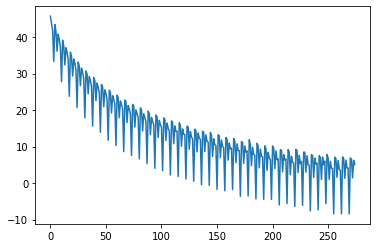

27600 tf.Tensor(4.527576553767407, shape=(), dtype=float64)
tf.Tensor(4.527576553767407, shape=(), dtype=float64)


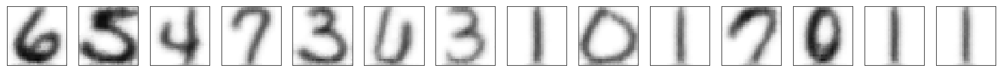

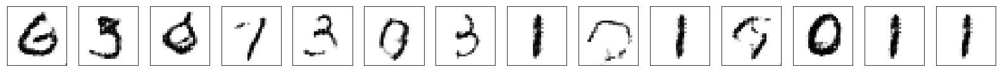

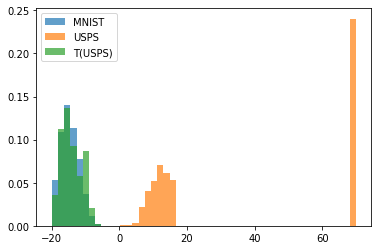

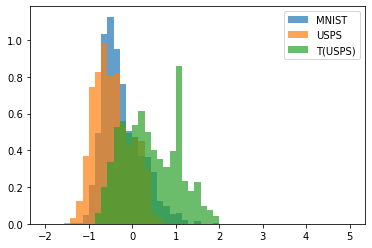

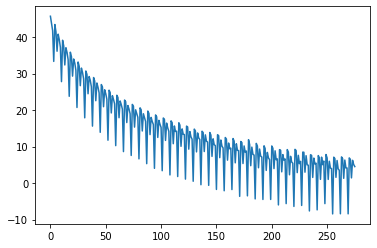

27700 tf.Tensor(-8.54959705060293, shape=(), dtype=float64)
tf.Tensor(-8.54959705060293, shape=(), dtype=float64)


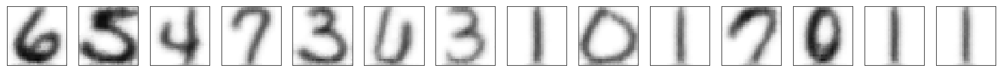

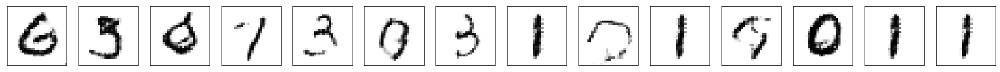

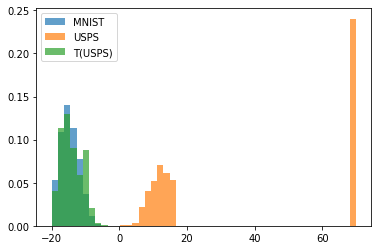

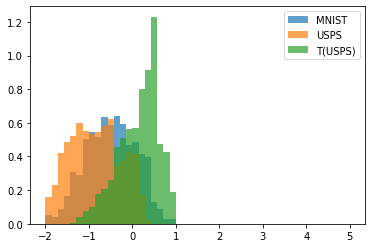

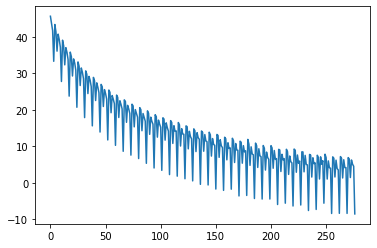

27800 tf.Tensor(6.017840670331147, shape=(), dtype=float64)
tf.Tensor(6.017840670331147, shape=(), dtype=float64)


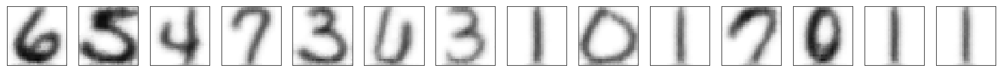

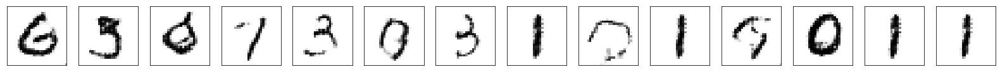

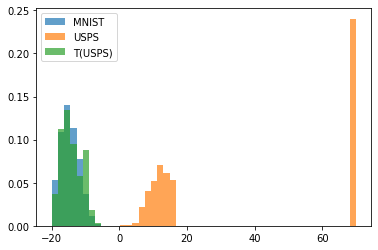

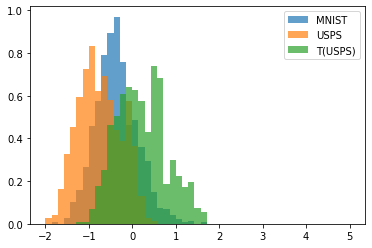

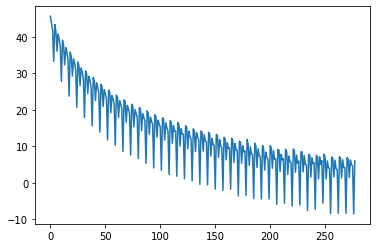

27900 tf.Tensor(5.578500323944532, shape=(), dtype=float64)
tf.Tensor(5.578500323944532, shape=(), dtype=float64)


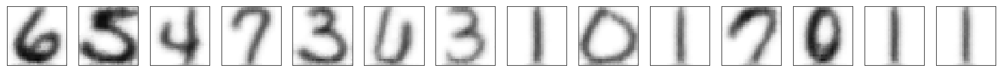

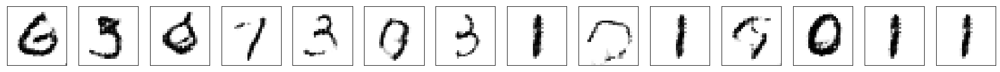

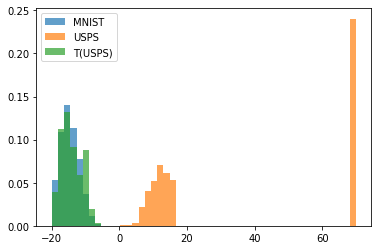

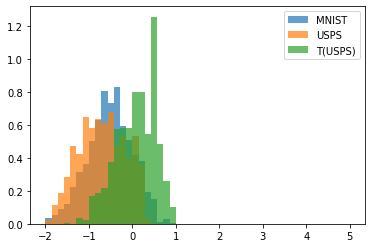

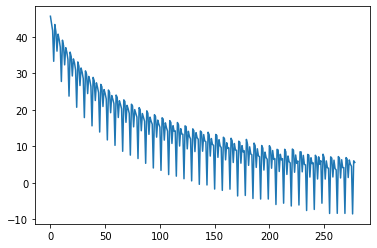

28000 tf.Tensor(-0.246769738853164, shape=(), dtype=float64)
tf.Tensor(-0.246769738853164, shape=(), dtype=float64)


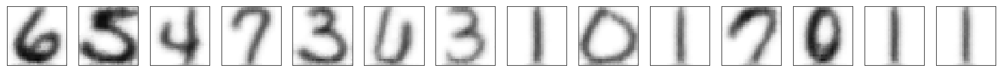

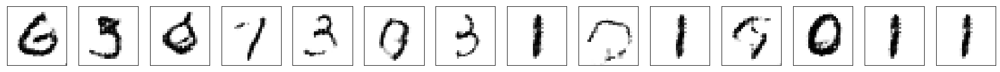

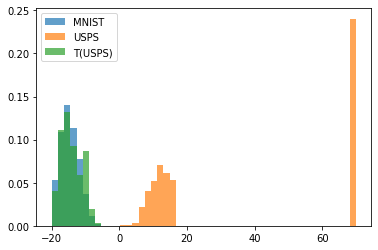

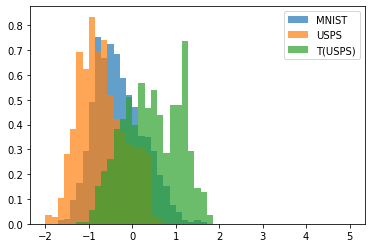

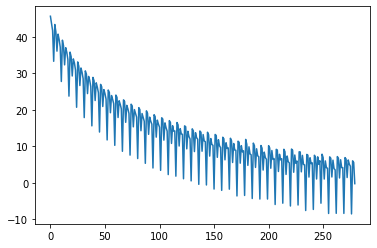

saving weights


In [ ]:
model_ab, model_t = fit_lrmf(build_nvp_dim, data_a, data_b,
                             const=const, show_every=100,
                             names=['MNIST', 'USPS', 'T(USPS)'],
                             save_path='/content/drive/My Drive/vaegan/lrmf_16',
                             restore_on_start=True)

In [ ]:
def restore_lrmf(build_model, path):
  model_ab = build_model()
  model_t = build_model()
  ckpt = tf.train.Checkpoint(m_ab=model_ab, m_t=model_t)
  ckpt_mng = tf.train.CheckpointManager(ckpt, path, 1)
  print(ckpt_mng.latest_checkpoint)
  ckpt.restore(ckpt_mng.latest_checkpoint).expect_partial()
  return model_ab, model_t

model_ab, model_t = restore_lrmf(build_nvp_dim, '/scratch2/run/lrmf/vaegan/vaegan/lrmf_16')

/scratch2/run/lrmf/vaegan/vaegan/lrmf_16/ckpt-30


0


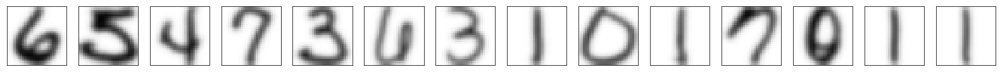

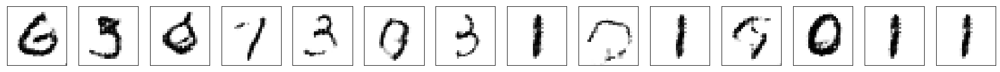

14


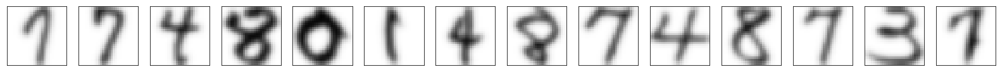

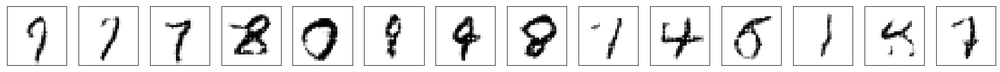

28


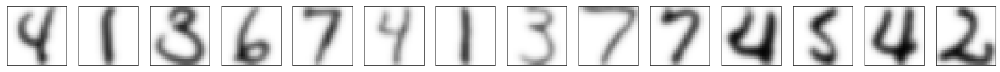

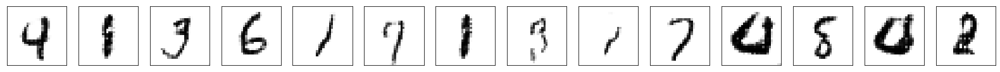

42


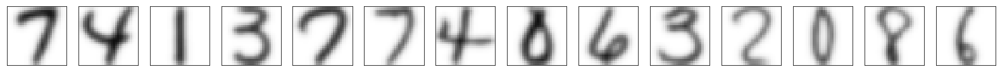

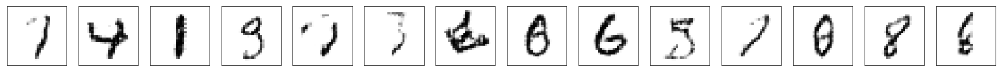

56


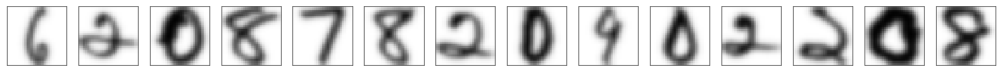

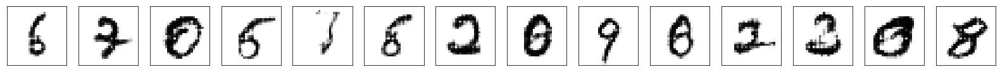

70


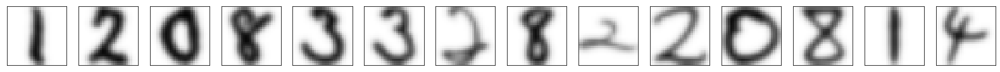

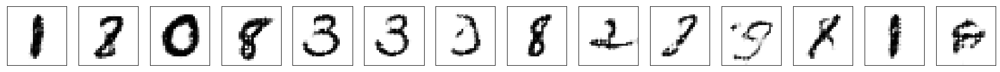

84


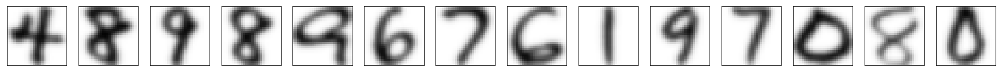

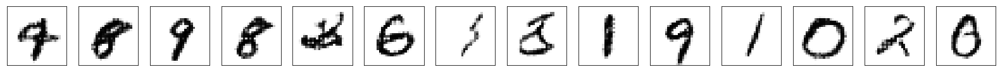

98


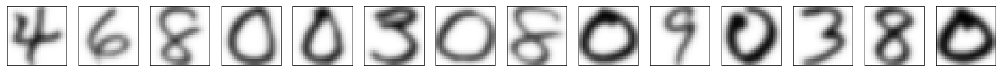

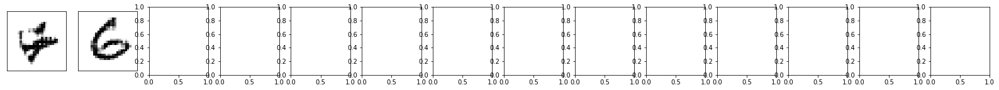

In [ ]:
gen_t = model_t.bijector.forward(data_b[:100]).numpy()
gen_t_imgs = model.decode(gen_t)
for i in range(0, 100, 14):
  print(i)
  show_panel(usps_array[i:i+14], cmap='Greys')
  show_panel(gen_t_imgs[i:i+14], cmap='Greys')

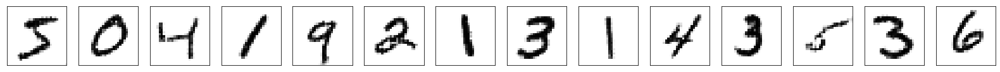

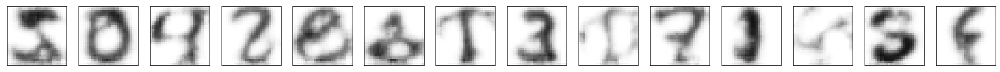

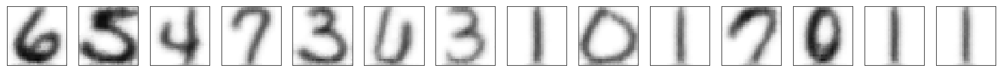

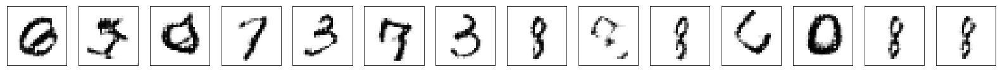

In [ ]:
mu_a, cov_a = tf.reduce_mean(data_a, axis=0), tfp.stats.covariance(data_a)
mu_b, cov_b = tf.reduce_mean(data_b, axis=0), tfp.stats.covariance(data_b)

w_a = tf.linalg.sqrtm(tf.linalg.inv(cov_a))
v_b = tf.linalg.sqrtm(cov_b)

data_a_tr_coral = tf.transpose(v_b @ w_a @ tf.transpose(data_a - mu_a[None])) + mu_b[None]

w_b = tf.linalg.sqrtm(tf.linalg.inv(cov_b))
v_a = tf.linalg.sqrtm(cov_a)
data_b_tr_coral = tf.transpose(v_a @ w_b @ tf.transpose(data_b - mu_b[None])) + mu_a[None]

show_panel(model.decode(data_a[:14]))
show_panel(model.decode(data_a_tr_coral[:14]))
show_panel(model.decode(data_b[:14]))
show_panel(model.decode(data_b_tr_coral[:14]))

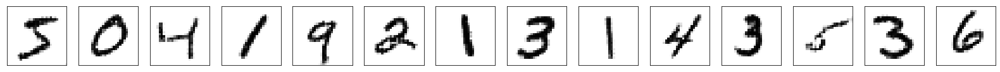

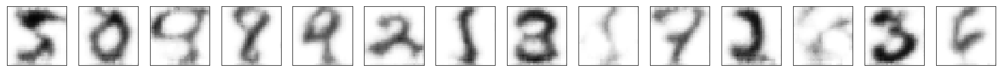

In [ ]:
show_panel(model.decode(data_a[:14]))
show_panel(model.decode(model_t.bijector.inverse(data_a[:14])))

In [ ]:
usps_labels = np.array([pair[1] for pair in usps_tv_dataset])
mnist_labels = np.array([pair[1] for pair in mnist_tv_dataset])

print(usps_labels[:10], mnist_labels[:10])
print(mnist_array.shape, mnist_labels.shape, usps_array.shape, usps_labels.shape)

[6 5 4 7 3 6 3 1 0 1] [5 0 4 1 9 2 1 3 1 4]
(60000, 28, 28, 1) (60000,) (7291, 28, 28, 1) (7291,)


In [ ]:
tfk = tf.keras
tfkl = tf.keras.layers

mnist_clf = tfk.Sequential([
  tfkl.Conv2D(32, (3, 3), activation='relu', input_shape=(28, 28, 1)),
  tfkl.Conv2D(32, (3, 3), activation='relu'),
  tfkl.MaxPooling2D(pool_size=(2, 2)),
  tfkl.Dropout(0.25),
  tfkl.Flatten(),
  tfkl.Dense(256, activation='relu'),
  tfkl.Dropout(0.5),
  tfkl.Dense(10, activation='softmax')
])

usps_clf = tfk.Sequential([
  tfkl.Conv2D(32, (3, 3), activation='relu', input_shape=(28, 28, 1)),
  tfkl.Conv2D(32, (3, 3), activation='relu'),
  tfkl.MaxPooling2D(pool_size=(2, 2)),
  tfkl.Dropout(0.25),
  tfkl.Flatten(),
  tfkl.Dense(256, activation='relu'),
  tfkl.Dropout(0.5),
  tfkl.Dense(10, activation='softmax')
])

mnist_clf.compile(loss='sparse_categorical_crossentropy', metrics=['accuracy'])
usps_clf.compile(loss='sparse_categorical_crossentropy', metrics=['accuracy'])

mnist_clf.fit(mnist_array, mnist_labels, epochs=3, validation_split=0.1)
usps_clf.fit(usps_array, usps_labels, epochs=3, validation_split=0.1)

Train on 54000 samples, validate on 6000 samples
Epoch 1/3
54000/54000 [==============================] - 4s 76us/sample - loss: 0.1679 - accuracy: 0.9484 - val_loss: 0.0531 - val_accuracy: 0.9847
Epoch 2/3
54000/54000 [==============================] - 4s 69us/sample - loss: 0.0777 - accuracy: 0.9774 - val_loss: 0.0443 - val_accuracy: 0.9865
Epoch 3/3
54000/54000 [==============================] - 4s 68us/sample - loss: 0.0681 - accuracy: 0.9800 - val_loss: 0.0467 - val_accuracy: 0.9867
Train on 6561 samples, validate on 730 samples
Epoch 1/3
6561/6561 [==============================] - 1s 122us/sample - loss: 0.4697 - accuracy: 0.8491 - val_loss: 0.1773 - val_accuracy: 0.9479
Epoch 2/3
6561/6561 [==============================] - 0s 74us/sample - loss: 0.1717 - accuracy: 0.9524 - val_loss: 0.1779 - val_accuracy: 0.9438
Epoch 3/3
6561/6561 [==============================] - 0s 70us/sample - loss: 0.1189 - accuracy: 0.9646 - val_loss: 0.1000 - val_accuracy: 0.9671


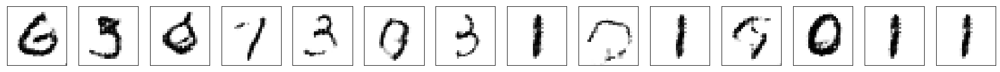

In [ ]:
data_b_tr_lmrf = batch_apply(model_t.bijector.forward, data_b, 256)
usps2mnist_imgs_lmrf = batch_apply(model.decode, data_b_tr_lmrf, 256).numpy()
show_panel(usps2mnist_imgs_lmrf[:16], cmap='Greys')

In [ ]:
mnist_tr_clf = tfk.Sequential([
  tfkl.Conv2D(32, (3, 3), activation='relu', input_shape=(28, 28, 1)),
  tfkl.Conv2D(32, (3, 3), activation='relu'),
  tfkl.MaxPooling2D(pool_size=(2, 2)),
  tfkl.Dropout(0.25),
  tfkl.Flatten(),
  tfkl.Dense(256, activation='relu'),
  tfkl.Dropout(0.5),
  tfkl.Dense(10, activation='softmax')
])

mnist_tr_clf.compile(loss='sparse_categorical_crossentropy', metrics=['accuracy'])

mnist_tr_clf.fit(usps2mnist_imgs_lmrf, usps_labels, epochs=5, validation_split=0.1)
mnist_tr_clf.evaluate(mnist_array, mnist_labels)

Train on 6561 samples, validate on 730 samples
Epoch 1/5
6561/6561 [==============================] - 1s 125us/sample - loss: 0.6270 - accuracy: 0.8000 - val_loss: 0.3568 - val_accuracy: 0.8986
Epoch 2/5
6561/6561 [==============================] - 0s 69us/sample - loss: 0.3302 - accuracy: 0.8912 - val_loss: 0.2404 - val_accuracy: 0.9164
Epoch 3/5
6561/6561 [==============================] - 0s 70us/sample - loss: 0.2593 - accuracy: 0.9183 - val_loss: 0.2076 - val_accuracy: 0.9260
Epoch 4/5
6561/6561 [==============================] - 0s 69us/sample - loss: 0.2089 - accuracy: 0.9320 - val_loss: 0.2243 - val_accuracy: 0.9260
Epoch 5/5
60000/60000 [==============================] - 2s 26us/sample - loss: 2.3127 - accuracy: 0.5573


[2.3127191573143007, 0.5573]

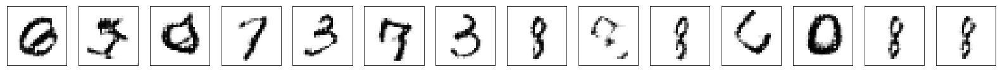

In [ ]:
usps2mnist_imgs_coral = batch_apply(model.decode, data_b_tr_coral, 256).numpy()
show_panel(usps2mnist_imgs_coral[:16], cmap='Greys')

In [ ]:
mnist_tr_clf_coral = tfk.Sequential([
  tfkl.Conv2D(32, (3, 3), activation='relu', input_shape=(28, 28, 1)),
  tfkl.Conv2D(32, (3, 3), activation='relu'),
  tfkl.MaxPooling2D(pool_size=(2, 2)),
  tfkl.Dropout(0.25),
  tfkl.Flatten(),
  tfkl.Dense(256, activation='relu'),
  tfkl.Dropout(0.5),
  tfkl.Dense(10, activation='softmax')
])

mnist_tr_clf_coral.compile(loss='sparse_categorical_crossentropy', metrics=['accuracy'])

mnist_tr_clf_coral.fit(usps2mnist_imgs_coral, usps_labels, epochs=5, validation_split=0.1)
mnist_tr_clf_coral.evaluate(mnist_array, mnist_labels)

Train on 6561 samples, validate on 730 samples
Epoch 1/5
6561/6561 [==============================] - 1s 133us/sample - loss: 0.8034 - accuracy: 0.7436 - val_loss: 0.4155 - val_accuracy: 0.8753
Epoch 2/5
6561/6561 [==============================] - 0s 70us/sample - loss: 0.3762 - accuracy: 0.8822 - val_loss: 0.2410 - val_accuracy: 0.9247
Epoch 3/5
6561/6561 [==============================] - 0s 70us/sample - loss: 0.2908 - accuracy: 0.9092 - val_loss: 0.2123 - val_accuracy: 0.9301
Epoch 4/5
6561/6561 [==============================] - 0s 70us/sample - loss: 0.2325 - accuracy: 0.9271 - val_loss: 0.2098 - val_accuracy: 0.9425
Epoch 5/5
60000/60000 [==============================] - 2s 27us/sample - loss: 2.3691 - accuracy: 0.4820


[2.3690916146914165, 0.48203334]

In [ ]:
coral_pred = np.argmax(mnist_tr_clf_coral.predict(mnist_array, batch_size=16), axis=1)
lrmf_pred = np.argmax(mnist_tr_clf.predict(mnist_array, batch_size=16), axis=1)

In [ ]:
coral_correct, lrmf_correct = (coral_pred == mnist_labels, lrmf_pred == mnist_labels)
print(np.mean(coral_correct), np.mean(lrmf_correct))

0.4820333333333333 0.5573


In [ ]:
print(np.mean(coral_correct), np.mean(lrmf_correct))

0.4820333333333333 0.5573


In [ ]:
import scipy.stats
# Welch’s t-test
print(scipy.stats.ttest_ind(coral_correct, lrmf_correct, equal_var=False))

Ttest_indResult(statistic=-26.167453858008773, pvalue=1.655613680188154e-150)


In [ ]:
mnist_vs_lrmf_clf = tfk.Sequential([
  tfkl.Conv2D(32, (3, 3), activation='relu', input_shape=(28, 28, 1)),
  tfkl.Conv2D(32, (3, 3), activation='relu'),
  tfkl.MaxPooling2D(pool_size=(2, 2)),
  tfkl.Dropout(0.25),
  tfkl.Flatten(),
  tfkl.Dense(256, activation='relu'),
  tfkl.Dropout(0.5),
  tfkl.Dense(10, activation='softmax')
])

mnist_vs_lrmf_clf.compile(loss='sparse_categorical_crossentropy', metrics=['accuracy'])

N = len(usps2mnist_imgs_lmrf)
idx = np.random.permutation(N*2)
mnist_vs_lrmf_X_lmrf = np.concatenate([mnist_array[:N], usps2mnist_imgs_lmrf])[idx]
mnist_vs_lrmf_y_lmrf = np.concatenate([np.ones(N), np.zeros(N)])[idx]
mnist_vs_lrmf_clf.fit(mnist_vs_lrmf_X_lmrf, mnist_vs_lrmf_y_lmrf, epochs=10, validation_split=0.1)

Train on 13123 samples, validate on 1459 samples
Epoch 1/10
13123/13123 [==============================] - 1s 101us/sample - loss: 0.3751 - accuracy: 0.8254 - val_loss: 0.4848 - val_accuracy: 0.7964
Epoch 2/10
13123/13123 [==============================] - 1s 70us/sample - loss: 0.1166 - accuracy: 0.9579 - val_loss: 0.1623 - val_accuracy: 0.9369
Epoch 3/10
13123/13123 [==============================] - 1s 70us/sample - loss: 0.0674 - accuracy: 0.9764 - val_loss: 0.0697 - val_accuracy: 0.9794
Epoch 4/10
13123/13123 [==============================] - 1s 69us/sample - loss: 0.0505 - accuracy: 0.9841 - val_loss: 0.1364 - val_accuracy: 0.9507
Epoch 5/10
13123/13123 [==============================] - 1s 71us/sample - loss: 0.0443 - accuracy: 0.9849 - val_loss: 0.0444 - val_accuracy: 0.9863
Epoch 6/10
13123/13123 [==============================] - 1s 69us/sample - loss: 0.0371 - accuracy: 0.9886 - val_loss: 0.0610 - val_accuracy: 0.9808
Epoch 7/10
13123/13123 [==============================] 

In [ ]:
mnist_vs_lrmf_coral = tfk.Sequential([
  tfkl.Conv2D(32, (3, 3), activation='relu', input_shape=(28, 28, 1)),
  tfkl.Conv2D(32, (3, 3), activation='relu'),
  tfkl.MaxPooling2D(pool_size=(2, 2)),
  tfkl.Dropout(0.25),
  tfkl.Flatten(),
  tfkl.Dense(256, activation='relu'),
  tfkl.Dropout(0.5),
  tfkl.Dense(10, activation='softmax')
])

mnist_vs_lrmf_coral.compile(loss='sparse_categorical_crossentropy', metrics=['accuracy'])

N = len(usps2mnist_imgs_coral)
idx = np.random.permutation(N*2)
mnist_vs_lrmf_X_coral = np.concatenate([mnist_array[:N], usps2mnist_imgs_coral])[idx]
mnist_vs_lrmf_y_coral = np.concatenate([np.ones(N), np.zeros(N)])[idx]
mnist_vs_lrmf_coral.fit(mnist_vs_lrmf_X_coral, mnist_vs_lrmf_y_coral, epochs=10, validation_split=0.1)

Train on 13123 samples, validate on 1459 samples
Epoch 1/10
13123/13123 [==============================] - 1s 96us/sample - loss: 0.4022 - accuracy: 0.8056 - val_loss: 0.5357 - val_accuracy: 0.7505
Epoch 2/10
13123/13123 [==============================] - 1s 70us/sample - loss: 0.1217 - accuracy: 0.9523 - val_loss: 0.2283 - val_accuracy: 0.9102
Epoch 3/10
13123/13123 [==============================] - 1s 69us/sample - loss: 0.0699 - accuracy: 0.9749 - val_loss: 0.0383 - val_accuracy: 0.9890
Epoch 4/10
13123/13123 [==============================] - 1s 72us/sample - loss: 0.0518 - accuracy: 0.9818 - val_loss: 0.0261 - val_accuracy: 0.9911
Epoch 5/10
13123/13123 [==============================] - 1s 69us/sample - loss: 0.0427 - accuracy: 0.9860 - val_loss: 0.0181 - val_accuracy: 0.9938
Epoch 6/10
13123/13123 [==============================] - 1s 69us/sample - loss: 0.0405 - accuracy: 0.9864 - val_loss: 0.0152 - val_accuracy: 0.9945
Epoch 7/10
13123/13123 [==============================] -

In [ ]:
coral_vs_mnist_pred = np.argmax(mnist_vs_lrmf_coral.predict(mnist_vs_lrmf_X_coral, batch_size=16), axis=1)
lrmf_vs_mnist_pred = np.argmax(mnist_vs_lrmf_clf.predict(mnist_vs_lrmf_X_lmrf, batch_size=16), axis=1)

In [ ]:
coral_vs_mnist_correct, lrmf_vs_mnist_correct = (coral_vs_mnist_pred == mnist_vs_lrmf_y_coral, lrmf_vs_mnist_pred == mnist_vs_lrmf_y_lmrf)
print(np.mean(coral_vs_mnist_correct), np.mean(lrmf_vs_mnist_correct))
print(scipy.stats.ttest_ind(coral_vs_mnist_correct, lrmf_vs_mnist_correct, equal_var=False))
# classifier trained on coral-vs-mnist applied to images transformed using coral
# performs better then
# classifier trained on lrmf-vs-mnist applied to images transformed using lrmf
# i.e. coral is easier to discriminate

0.9980112467425594 0.998285557536689
Ttest_indResult(statistic=-0.5448197865861334, pvalue=0.5858816576762651)


In [ ]:
lrmf_vs_mnist_cross_pred = np.argmax(mnist_vs_lrmf_coral.predict(mnist_vs_lrmf_X_lmrf, batch_size=16), axis=1)
coral_vs_mnist_cross_pred = np.argmax(mnist_vs_lrmf_clf.predict(mnist_vs_lrmf_X_coral, batch_size=16), axis=1)
coral_vs_mnist_cross_correct, lrmf_vs_mnist_cross_correct = (coral_vs_mnist_cross_pred == mnist_vs_lrmf_y_coral, lrmf_vs_mnist_cross_pred == mnist_vs_lrmf_y_lmrf)
print(np.mean(coral_vs_mnist_cross_correct), np.mean(lrmf_vs_mnist_cross_correct))
print(scipy.stats.ttest_ind(coral_vs_mnist_cross_correct, lrmf_vs_mnist_cross_correct, equal_var=False))
# classifier trained on coral-vs-mnist applied to images transformed using lrmf
# performs worse then
# classifier trained on lrmf-vs-mnist applied to images transformed using coral
# i.e. lrmf-vs-mnist is a harder task

0.9812097106021122 0.9550130297627212
Ttest_indResult(statistic=12.765989275928169, pvalue=3.3131147658153704e-37)


In [ ]:
data_a.shape, data_b.shape

(TensorShape([60000, 32]), TensorShape([7291, 32]))

In [ ]:
import scipy.spatial.distance
import scipy.optimize

idx = np.random.choice(len(data_a), size=len(data_b), replace=False)
data_a_sub = data_a.numpy()[idx, :]
data_b_sub = data_b.numpy()
print([(x.shape, x.dtype) for x in [data_a_sub, data_b_sub]])
cost = scipy.spatial.distance.cdist(data_a_sub, data_b_sub, 'sqeuclidean')
row_ind, col_ind = scipy.optimize.linear_sum_assignment(cost)
print(row_ind.shape, col_ind.shape)
print(np.max(row_ind), np.max(col_ind))

[((7291, 32), dtype('float64')), ((7291, 32), dtype('float64'))]
(7291,) (7291,)
7290 7290


In [ ]:
data_b_tr_emd = data_a_sub[np.argsort(col_ind)]

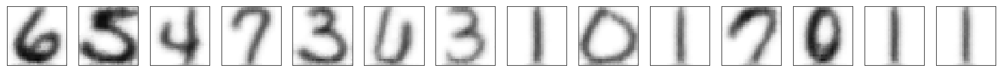

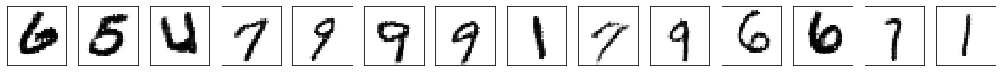

In [ ]:
usps2mnist_imgs_emd = batch_apply(model.decode, data_b_tr_emd, 256).numpy()
show_panel(model.decode(data_b[:14]))
show_panel(usps2mnist_imgs_emd[:16], cmap='Greys')

In [ ]:
usps_labels

array([6, 5, 4, ..., 3, 0, 1])

In [ ]:
tfk = tf.keras
tfkl = tf.keras.layers

mnist_tr_clf_emd = tfk.Sequential([
  tfkl.Conv2D(32, (3, 3), activation='relu', input_shape=(28, 28, 1)),
  tfkl.Conv2D(32, (3, 3), activation='relu'),
  tfkl.MaxPooling2D(pool_size=(2, 2)),
  tfkl.Dropout(0.25),
  tfkl.Flatten(),
  tfkl.Dense(256, activation='relu'),
  tfkl.Dropout(0.5),
  tfkl.Dense(10, activation='softmax')
])

mnist_tr_clf_emd.compile(loss='sparse_categorical_crossentropy', metrics=['accuracy'])

mnist_tr_clf_emd.fit(usps2mnist_imgs_emd, usps_labels, epochs=5, validation_split=0.1)
mnist_tr_clf_emd.evaluate(mnist_array, mnist_labels)

Train on 6561 samples, validate on 730 samples
Epoch 1/5
6561/6561 [==============================] - 1s 140us/sample - loss: 1.4634 - accuracy: 0.5025 - val_loss: 1.2629 - val_accuracy: 0.5589
Epoch 2/5
6561/6561 [==============================] - 0s 70us/sample - loss: 1.1923 - accuracy: 0.5926 - val_loss: 1.1160 - val_accuracy: 0.6274
Epoch 3/5
6561/6561 [==============================] - 0s 70us/sample - loss: 1.1186 - accuracy: 0.6043 - val_loss: 1.0095 - val_accuracy: 0.6438
Epoch 4/5
6561/6561 [==============================] - 0s 70us/sample - loss: 1.0534 - accuracy: 0.6293 - val_loss: 1.0235 - val_accuracy: 0.6507
Epoch 5/5
60000/60000 [==============================] - 2s 26us/sample - loss: 1.7838 - accuracy: 0.4774


[1.7838432834943136, 0.47741666]

In [ ]:
emd_pred = np.argmax(mnist_tr_clf_emd.predict(mnist_array, batch_size=16), axis=1)
emd_correct = emd_pred == mnist_labels
print(np.mean(emd_correct), np.mean(lrmf_correct))

print(scipy.stats.ttest_ind(emd_correct, lrmf_correct, equal_var=False))

0.47741666666666666 0.5573
Ttest_indResult(statistic=-27.77773761524113, pvalue=2.780233876147573e-169)


In [ ]:
import statsmodels.stats.contingency_tables

In [ ]:

table = [[np.sum(np.logical_and(a, b)) for a in [lrmf_correct, ~lrmf_correct]] for b in [coral_correct, ~coral_correct]]
print(np.mean(coral_correct), np.mean(lrmf_correct))
print(table)
print(np.sum(table, axis=0)/len(coral_correct), np.sum(table, axis=1)/len(coral_correct))
print(statsmodels.stats.contingency_tables.mcnemar(table).pvalue)

0.4820333333333333 0.5573
[[24316, 4606], [9122, 21956]]
[0.5573 0.4427] [0.48203333 0.51796667]
0.0


In [ ]:
table = [[np.sum(np.logical_and(a, b)) for a in [lrmf_correct, ~lrmf_correct]] for b in [emd_correct, ~emd_correct]]
print(np.mean(emd_correct), np.mean(lrmf_correct))
print(table)
print(np.sum(table, axis=0)/len(emd_correct), np.sum(table, axis=1)/len(emd_correct))
print(statsmodels.stats.contingency_tables.mcnemar(table).pvalue)

0.47741666666666666 0.5573
[[22277, 6368], [11161, 20194]]
[0.5573 0.4427] [0.47741667 0.52258333]
1.6714862006796013e-290


In [ ]:
a_s, b_s = coral_vs_mnist_cross_correct, lrmf_vs_mnist_cross_correct
table = [[np.sum(np.logical_and(a, b)) for a in [a_s, ~a_s]] for b in [b_s, ~b_s]]
print(np.mean(a_s), np.mean(b_s))
print(table)
print(np.sum(table, axis=0)/len(a_s), np.sum(table, axis=1)/len(a_s))
print(statsmodels.stats.contingency_tables.mcnemar(table).pvalue)

0.9812097106021122 0.9550130297627212
[[13663, 263], [645, 11]]
[0.98120971 0.01879029] [0.95501303 0.04498697]
9.646383545778827e-38
